In [1]:
import pickle
import os
import pandas as pd
import torch

In [2]:
import numpy as np
import dynamic_portfolio as dp
from TARN_MAPPO.enviroment import EnvConfig, Stock_Env
from TARN_MAPPO.agent import MAPPO, EarlyStopping


In [3]:
with open("./data/train_daily_v3.pkl", "rb") as f:
    train_scaled = pickle.load(f)
print("현재 작업 디렉토리:", os.getcwd())

train_df = pd.read_csv("data/train_v3.csv", index_col=0)
train_df.set_index("date", inplace=True)
feature_dim = 14
train_scaled_tensor = torch.load("data/daily_data_v3.pt")

현재 작업 디렉토리: /workspace/base_line_model/Task_1_FinRL_DeepSeek_Stock


/tmp/ipykernel_4033533/3209765067.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  train_scaled_tensor = torch.load("data/daily_data_v3.pt")


In [4]:
from datasets import load_dataset
dataset = load_dataset("benstaf/nasdaq_2013_2023", data_files="train_data_deepseek_sentiment_2013_2018.csv")
train = pd.DataFrame(dataset['train'])

/opt/conda/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Repo card metadata block was not found. Setting CardData to empty.


In [5]:
train.drop("Unnamed: 0", axis=1, inplace=True)
train_df.rename(columns = {"low": "low_norm", "high": "high_norm", "open": "open_norm", "close": "close_norm"}, inplace=True)

In [6]:
imp = train[["date", "tic", "close", "high", "low", "open"]]

In [7]:
train_df = train_df.merge(imp, on=["date", "tic"], how="left").dropna()

In [8]:
train_df.set_index("date", inplace=True)

In [9]:

def get_hyperparameters(feature_dim):
    return {
        "dcc_dropout": 0.2,
        "sac_dropout": 0.01,
        "sac_heads": 2,
        "ddc_configs": [
            {"in_channels": feature_dim, "out_channels": 8, "kernel_size": 3, "stride": 1, "padding": (3-1)//2, "dilation": 1, "sac_scale": 4**0.5, "residual_out_channels" : 8, "residual_kernal": 1},
            {"in_channels": 8, "out_channels": 16, "kernel_size": 3, "stride": 1, "padding": 2, "dilation": 2, "sac_scale": 8**0.5, "residual_out_channels" : 16, "residual_kernal": 1 },
            {"in_channels": 16, "out_channels": 16, "kernel_size": 3, "stride": 1, "padding": 4, "dilation": 4, "sac_scale": 8**0.5}
        ],
        "final_conv_config": {"in_channels" : 16, "out_channels": 8, "kernel_size": 20, "stride": 1, "padding": 0}
    }

In [10]:
hyperparameters = get_hyperparameters(feature_dim)
config = EnvConfig(train_scaled_tensor, train_df, train_scaled, hyperparameters)

In [11]:
env = Stock_Env(config)
early_stopping_reward = EarlyStopping(patience=config.patience, min_delta=0.0001)

print("학습 환경 및 에이전트 생성 완료")
print("학습 시작")
# Initialize agents
agent = MAPPO(env)


학습 환경 및 에이전트 생성 완료
학습 시작


In [12]:
dynamic_dict = {
            "GTAA": dp.cal_gtaa, 
            "DM": dp.cal_dm,  
            "PAA": dp.cal_paa, 
            "DAA": dp.cal_daa,
            "Sentiment": dp.cal_sentiment,
            "risk": dp.cal_risk}

In [13]:
n_weight = env.n_weight()


In [14]:
## 동적 자산 전략입니다.
def cal_gtaa(data, before_asset_dict, portfolio_weight):
    """GTAA 코드입니다.
    day 기준 SMA 10달전 가격과 비교하여 양수인것들중 volume이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 남은 weight를 cash에 투자합니다.
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["close"] > data_imp["SMA_220"]]
    data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_sentiment(data, before_asset_dict, portfolio_weight):
    """GTAA 코드입니다.
    day 기준 긍정 뉴스인 주식에 투자하되 volume이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 남은 weight를 cash에 투자합니다.
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["sentiment_weight_5"] > 1]
    data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_risk(data, before_asset_dict, portfolio_weight):
    """GTAA 코드입니다.
    day 기준 긍정 뉴스인 주식에 투자하되 volume이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 남은 weight를 cash에 투자합니다.
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["risk_weight_5"] < 3]
    data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_dm(data, before_asset_dict, portfolio_weight):
    """듀얼 모멘텀 전략 코드입니다.
    day기준 12개월 누적 수익률이 무위험 수익률보다 높은 자산에 투자함
    수익률이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 현금을 보유합니다. 
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
        
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["momentum_product"] > 1]
    data_imp = data_imp.sort_values(by="momentum_product", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_daa(data, before_asset_dict, portfolio_weight):
    """daa 전략 코드입니다.
    day 기준 모멘텀 스코어가 높은 자산에 투자함 수익률이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 현금을 보유합니다. 
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
        
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["mom_score"] > 0]
    data_imp = data_imp.sort_values(by="mom_score", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_paa(data, before_asset_dict, portfolio_weight):
    """paa 전략 코드입니다.
    day 기준 paa_score가 높은 자산에 투자함 수익률이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 현금을 보유합니다. 
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
        
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["paa_score"] > 0]
    data_imp = data_imp.sort_values(by="paa_score", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_return(data, future_data, save_return_dict, weights):
    """"
    미래 수익률을 구하는 코드입니다.
    """
    for ticker in weights.keys():
        now_price = data[data["tic"]==ticker]["close"][0]
        future_price = future_data[future_data["tic"]==ticker]["close"][0]
        future_return = future_price/now_price - 1
        weighted_future_return = future_return * weights[ticker]
        save_return_dict[ticker] = weighted_future_return
    return save_return_dict
    

def cal_asset_weight(ticker_weights, asset_dict, portfolio_weight):
    """
    자산별 weight를 뽑는 코드입니다.
    Args:
        ticker_weights (dict): 전략에서 나온 ticker 별 weight입니다.
        asset_dict (dict): asset별 weight를 저장할 Dictionary입니다.
        portfolio_weight (float): portfolio별 weight입니다.
    """
    for ticker, weight in ticker_weights.items():
        asset_dict[ticker] += weight*portfolio_weight
    return asset_dict


def calculate_buy_sell_dict(before_asset_dict, after_asset_dict):
    """
    매수 및 매도 비중을 구하기 위한 코드입니다.
    Args:
    - before_asset_dict (dict): 전 리밸런싱 거래 비중
    - after_asset_dict (dict): 현재 리밸런싱 거래 비중
    
    Returns:
    - buy_ticker_dict (dict): 매수 비중
    - sell_ticker_dict (dict): 매도 비중
    """
    buy_ticker_dict = {}
    sell_ticker_dict = {}

    for ticker in before_asset_dict.keys():
        before_weight = before_asset_dict.get(ticker, 0)
        after_weight = after_asset_dict.get(ticker, 0)

        if after_weight > before_weight:  # 매수
            buy_ticker_dict[ticker] = after_weight - before_weight
        elif after_weight < before_weight:  # 매도
            sell_ticker_dict[ticker] = before_weight - after_weight

    return buy_ticker_dict, sell_ticker_dict


def calculate_total_transaction_fee(today_data, buy_ticker_dict, sell_ticker_dict, invest_money):
    """
    매수 및 매도에 따른 거래 비용을 계산하는 코드입니다.
    Args:
    - today_data (pd.DataFrame): 현재 날짜의 데이터
    - buy_ticker_dict (dict): 매수 비중
    - sell_ticker_dict (dict): 매도 비중
    - invest_money (float): 총 투자 금액
    
    Returns:
    - total_transaction_fee (float): 총 거래 비용
    """
    transaction_fee_rate = 0.001  # 거래 수수료 비율
    # transaction_fee_rate = 0.0  # 거래 수수료 비율
    # print("transaction_fee_rate", transaction_fee_rate)
    total_transaction_fee = 0.0

    # 매수 거래 비용 계산
    for ticker, weight in buy_ticker_dict.items():
        # print(ticker, weight)
        price = today_data[today_data["tic"] == ticker]["close"].values[0]
        investment = invest_money * weight
        invest_count = int(investment / price)  # 정수 단위로 매수 가능한 수량
        actual_investment = invest_count * price  # 실제 투자 금액
        total_transaction_fee += actual_investment * transaction_fee_rate

    # 매도 거래 비용 계산
    for ticker, weight in sell_ticker_dict.items():
        # print(today_data[today_data["tic"] == ticker])
        price = today_data[today_data["tic"] == ticker]["close"].values[0]
        investment = invest_money * weight
        invest_count = int(investment / price)  # 정수 단위로 매도 가능한 수량
        actual_investment = invest_count * price  # 실제 매도 금액
        total_transaction_fee += actual_investment * transaction_fee_rate

    return total_transaction_fee


def calculate_rebalancing_investment(today_data, future_data, before_asset_dict, after_asset_dict, invest_money):
    """
    리밸런싱 후 투자 결과를 계산하는 코드입니다.
    Args:
    - today_data (pd.DataFrame): 현재 날짜의 데이터
    - future_data (pd.DataFrame): 미래 날짜의 데이터
    - before_asset_dict (dict): 전 리밸런싱 거래 비중
    - after_asset_dict (dict): 현재 리밸런싱 거래 비중
    - invest_money (float): 총 투자 금액
    
    Returns:
    - asset_invest_dict (dict): 자산별 최종 투자 금액
    - remain_money (float): 남은 잔여 투자 금액
    """
    # 매수 및 매도 비중 계산
    # print("before_asset_dict", before_asset_dict)
    print("after_asset_dict", after_asset_dict)
    buy_ticker_dict, sell_ticker_dict = calculate_buy_sell_dict(before_asset_dict, after_asset_dict)
    # print("buy_ticker_dict", before_asset_dict)
    # print("sell_ticker_dict", after_asset_dict)
    # print(today_data)
    # print(sell_ticker_dict)
    # 거래 비용 계산
    total_transaction_fee = calculate_total_transaction_fee(today_data, buy_ticker_dict, sell_ticker_dict, invest_money)

    # 거래 비용을 차감한 투자 가능 금액
    asset_invest_dict = {}
    remain_money = 0.0  # 잔여 투자 금액

    remain_invest_money = invest_money * (1-sum(after_asset_dict.values())) # 기존 투자금
    
    for ticker, weight in after_asset_dict.items():
        if weight == 0:
            # asset_invest_dict[ticker] = 0
            continue
        now_price = today_data[today_data["tic"] == ticker]["close"].values[0]
        future_price = future_data[future_data["tic"] == ticker]["close"].values[0]
        # future_return = future_price / now_price  # 미래 수익률

        # 티커별 투자 가능 금액 및 실제 투자 금액 계산
        ticker_investment = invest_money * weight
        invest_count = int(ticker_investment / now_price)  # 정수 단위로 매수 가능 수량
        actual_investment = invest_count * now_price  # 실제 투자 금액
        remain_money += ticker_investment - actual_investment  # 남은 잔여 금액
        
        future_investment = invest_count * future_price  # 미래 가치
        # 자산별 최종 금액 저장
        asset_invest_dict[ticker] = future_investment
    
    total_investment = sum(asset_invest_dict.values())
    backtesting_investment = total_investment - total_transaction_fee + remain_money + remain_invest_money

    return backtesting_investment, total_transaction_fee


In [15]:
import copy
def calculate_n_weight_action_return(n_weight, day, next_day, daily_nweight_money, before_asset_dict):
    """
    n_weight 동적 자산배분 return을 구하는 코드입니다.
    """
        
    real_data_day = env.real_data.loc[day]
    future_data = env.real_data.loc[next_day]
    # print(future_data)

    # before_asset_dict = copy.deepcopy(n_weight)
    after_asset_dict = {tick : 0 for tick in env.real_data.tic.unique()}
    for strategy, portfolio_weight in n_weight.items():
        after_asset_dict = env.dynamic_dict[strategy](real_data_day, after_asset_dict, portfolio_weight)
    # print(real_data_day)
    # print(future_data)
    backtesting_investment, total_transaction_fee = calculate_rebalancing_investment(real_data_day, future_data, 
                                                                    before_asset_dict, after_asset_dict, daily_nweight_money)
    
    
    return backtesting_investment, total_transaction_fee, after_asset_dict

In [16]:
def calculate_all_weight_action_return(all_weight, day, next_day, daily_all_weight_money, before_asset_dict):
    """
    all weight 동적 자산배분 return을 구하는 코드입니다.
    """
    # before_asset_dict = copy.deepcopy(n_weight)
    # print("before_asset_dict", before_asset_dict)
    real_data_day = env.real_data.loc[day]
    future_data = env.real_data.loc[next_day] 
    transaction_fees_dict = {}
    # 변화하는 자산을 구하기위한 빈 dict
    after_asset_dict =  {dm : {tick : 0 for tick in env.real_data.tic.unique()} for dm in list(dynamic_dict.keys())}
    # 전략별 Weihgt를 돌면서
    for strategy, portfolio_weight in all_weight.items():
        # 전략별 자산 이전 자산 비중 가져옴
        before_asset_dict_dm = copy.deepcopy(before_asset_dict[strategy])
        # 전략별 자산 비중을 구하기 위한 빈 dict
        after_asset_dict_dm = {tick : 0 for tick in env.real_data.tic.unique()}
        # 전략별 자산 비중 구함
        after_asset_dict_dm = dynamic_dict[strategy](real_data_day, after_asset_dict_dm, portfolio_weight)
        # 전략별 자산 비중 결과 도출
        backtesting_investment, total_transaction_fee = calculate_rebalancing_investment(real_data_day, future_data, before_asset_dict_dm, after_asset_dict_dm, daily_all_weight_money[strategy])
        # 투자금
        daily_all_weight_money[strategy] = backtesting_investment
        transaction_fees_dict[strategy] = total_transaction_fee
        after_asset_dict[strategy] = after_asset_dict_dm
        # print("after_asset_dict", after_asset_dict)

    return daily_all_weight_money, transaction_fees_dict, after_asset_dict

In [17]:
def make_daily_invest_data(empty_df, asset_weight, invest_money, daily_data, total_transaction_fee,  day, next_day):
    cash_weight = 1- sum(asset_weight.values())
    invest_weight = sum(asset_weight.values())
    print("invest_weight", invest_weight)
    invest_money = invest_money - total_transaction_fee
    cash_money = invest_money * cash_weight
    # invest_money_remain = invest_money * invest_weight
    
    daily_data_inx = env.real_data.loc[day:next_day]
    # next_day = daily_data_inx.index.unique()[-2]
    # daily_data_inx = self.real_data.loc[day:next_day]

    
    save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)
    # print("after invest_money : ", invest_money_remain)
    # print("cash_money : ", cash_money)
    # print("total_invest_money : ", cash_money + invest_money_remain)
    # print(daily_data.TICKER.nunique())
    # print(len(asset_weight.keys()))
    # print(asset_weight)

    for tic, weight in asset_weight.items():
        imp = daily_data[daily_data["tic"] == tic]
        daily_return = imp["close"].pct_change().fillna(0)
        daily_return = daily_return.loc[day:next_day]
        
        print("daily_return", daily_return)
        test = weight * (1+daily_return).cumprod() * invest_money
        save_data["invest"] += test.values
    save_data["invest"] += cash_money
    # print(save_data)
    empty_df = pd.concat([empty_df, save_data], axis=0)
    return empty_df, imp, save_data


In [18]:
dynamic_dict = {
            "GTAA": cal_gtaa, 
            "DM": cal_dm,  
            "PAA": cal_paa, 
            "DAA": cal_daa,
            "Sentiment": cal_sentiment,
            "risk": cal_risk}

In [19]:
# all weight
idx = 0
window_size = 20

all_weight_invest_dict = {dm : 10000000 for dm in dynamic_dict.keys()}
all_weight_invest_rewards = {dm : [10000000] for dm in dynamic_dict.keys()}


before_weight_tick = {dm : {tick : 0 for tick in env.real_data.tic.unique()} for dm in list(dynamic_dict.keys())}
all_weight_df = pd.DataFrame()
all_weight = env.all_weight()

for day in env.days[::window_size]:
    if idx + window_size <= len(env.days):
        next_day = env.days[idx+window_size-1]
        
    else:
        next_day = env.real_data.index.unique()[-1]
    idx += window_size
    print("day", day)

    total_inveset_money, total_transaction_fee_dict, after_asset_dict = calculate_all_weight_action_return(all_weight, day, next_day, all_weight_invest_dict, before_weight_tick)

    before_weight_tick = copy.deepcopy(after_asset_dict)

    dm_df = pd.DataFrame()
    # 자산 비중을 돈다
    for dm, all_weight_asset in all_weight.items():
        imp_df = pd.DataFrame()
        # 비중을 가져옴
        # 거래비용 가져옴
        dm_fee = total_transaction_fee_dict[dm]
        # 자산 비중을 구하기 위한 빈 dict
        # 전략별 티커 투자 비중
        before_asset_dict_dm = after_asset_dict[dm]
        dm_invest_money = total_inveset_money[dm]

        imp_df, tmp, save_data =  make_daily_invest_data(imp_df,  before_asset_dict_dm, dm_invest_money, env.real_data, dm_fee, day, next_day)
        imp_df.columns = [f"{dm}"]

        # n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)

        dm_df = pd.concat([dm_df, imp_df], axis=1)
    all_weight_df = pd.concat([all_weight_df, dm_df])
    
    all_weight_invest_dict = all_weight_df.iloc[-1].to_dict()
    
    for dm, all_weight_dict in all_weight_invest_dict.items():
        all_weight_invest_rewards[dm].append(all_weight_dict)

        
        # n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)

        # print("daily_nweight_money", daily_nweight_money)

    # backtesting_investment, total_transaction_fee, after_asset_dict = calculate_all_weight_action_return(all_weight, day, next_day, all_weight_invest_dict, before_weight_tick)
    # print("backtesting_investment", backtesting_investment)
    # dm_df = pd.DataFrame()
    # for dm, all_weight_asset in all_weight_dict.items():
    #     imp_df = pd.DataFrame()
    # daily_nweight_money = n_rewards[-1]


day 2013-01-02
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.1, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.1, 'COST': 0, 'CPRT': 0, 'CSCO': 0.1, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.1, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0.1, 'GOOGL': 0.1, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.1, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0.1, 'NFLX': 0.1, 'NVDA': 0, 'NXPI': 0, 'ODFL': 0, 'ON': 0, 'ORLY': 0, 'PANW': 0, 'PAYX': 0, 'PCAR': 0, 'PEP': 0, 'QCOM': 0, 'REGN': 0, 'ROST': 0, 'SBUX': 0, 'SIRI': 0, 'SNPS': 0, 'TMUS': 0, 'TSLA': 0.1, 'TXN': 0, 'VRSK': 0, 'VRTX': 0, 'WBA': 0, 'WBD': 0, 'WDAY': 0, 'XEL': 0}
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'AD

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.003997
2013-01-04    0.010463
2013-01-07   -0.000142
2013-01-08    0.008370
2013-01-09    0.014772
2013-01-10    0.001802
2013-01-11    0.007888
2013-01-14    0.001785
2013-01-15    0.001371
2013-01-16   -0.005749
2013-01-17    0.012665
2013-01-18   -0.006525
2013-01-22   -0.005063
2013-01-23   -0.001238
2013-01-24    0.001652
2013-01-25    0.010723
2013-01-28    0.005713
2013-01-29    0.002434
2013-01-30   -0.005262
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.020964
2013-01-04   -0.010248
2013-01-07   -0.016226
2013-01-08   -0.008168
2013-01-09    0.005702
2013-01-10    0.018425
2013-01-11    0.011597
2013-01-14   -0.015592
2013-01-15   -0.020497
2013-01-16    0.011731
2013-01-17    0.070981
2013-01-18    0.011997
2013-01-22    0.010843
2013-01-23   -0.009726
2013-01-24    0.028163
2013-01-25    0.040034
2013-01-28    0.019314
2013-01-29   -0.002650
2013-01-30   -0.000664
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.001536
2013-01-04   -0.004873
2013-01-07   -0.002577
2013-01-08   -0.002584
2013-01-09    0.018135
2013-01-10    0.005089
2013-01-11   -0.007722
2013-01-14   -0.002679
2013-01-15    0.001791
2013-01-16    0.000255
2013-01-17    0.007787
2013-01-18   -0.001520
2013-01-22   -0.000127
2013-01-23    0.001649
2013-01-24    0.003420
2013-01-25    0.018430
2013-01-28    0.019336
2013-01-29   -0.008998
2013-01-30    0.001595
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.011163
2013-01-04   -0.000525
2013-01-07   -0.004465
2013-01-08    0.006860
2013-01-09    0.006814
2013-01-10    0.002082
2013-01-11   -0.001039
2013-01-14    0.011960
2013-01-15    0.007194
2013-01-16   -0.000510
2013-01-17    0.019653
2013-01-18    0.008010
2013-01-22   -0.011423
2013-01-23    0.004773
2013-01-24   -0.010500
2013-01-25    0.004548
2013-01-28   -0.004779
2013-01-29   -0.011625
2013-01-30   -0.002045
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.015430
2013-01-04   -0.000275
2013-01-07   -0.007426
2013-01-08    0.005819
2013-01-09    0.010193
2013-01-10   -0.004090
2013-01-11    0.007667
2013-01-14    0.000815
2013-01-15   -0.003258
2013-01-16    0.000545
2013-01-17    0.016335
2013-01-18    0.004554
2013-01-22   -0.025333
2013-01-23    0.008482
2013-01-24    0.020076
2013-01-25    0.036968
2013-01-28   -0.003334
2013-01-29    0.000000
2013-01-30   -0.003345
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.000687
2013-01-04   -0.001605
2013-01-07   -0.004134
2013-01-08   -0.005072
2013-01-09    0.000232
2013-01-10    0.009036
2013-01-11   -0.007118
2013-01-14    0.000000
2013-01-15   -0.001850
2013-01-16   -0.000927
2013-01-17    0.001855
2013-01-18    0.007176
2013-01-22    0.011722
2013-01-23    0.001817
2013-01-24    0.002041
2013-01-25    0.006110
2013-01-28    0.000675
2013-01-29    0.011912
2013-01-30    0.002000
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.020964
2013-01-04   -0.010248
2013-01-07   -0.016226
2013-01-08   -0.008168
2013-01-09    0.005702
2013-01-10    0.018425
2013-01-11    0.011597
2013-01-14   -0.015592
2013-01-15   -0.020497
2013-01-16    0.011731
2013-01-17    0.070981
2013-01-18    0.011997
2013-01-22    0.010843
2013-01-23   -0.009726
2013-01-24    0.028163
2013-01-25    0.040034
2013-01-28    0.019314
2013-01-29   -0.002650
2013-01-30   -0.000664
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03    0.005224
2013-01-04   -0.006420
2013-01-07   -0.005538
2013-01-08   -0.006807
2013-01-09    0.022118
2013-01-10    0.021640
2013-01-11    0.024463
2013-01-14    0.006697
2013-01-15   -0.020248
2013-01-16    0.020372
2013-01-17    0.007234
2013-01-18   -0.010629
2013-01-22    0.000000
2013-01-23   -0.000580
2013-01-24   -0.014236
2013-01-25    0.006779
2013-01-28    0.009367
2013-01-29    0.002610
2013-01-30    0.013885
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.001536
2013-01-04   -0.004873
2013-01-07   -0.002577
2013-01-08   -0.002584
2013-01-09    0.018135
2013-01-10    0.005089
2013-01-11   -0.007722
2013-01-14   -0.002679
2013-01-15    0.001791
2013-01-16    0.000255
2013-01-17    0.007787
2013-01-18   -0.001520
2013-01-22   -0.000127
2013-01-23    0.001649
2013-01-24    0.003420
2013-01-25    0.018430
2013-01-28    0.019336
2013-01-29   -0.008998
2013-01-30    0.001595
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.011163
2013-01-04   -0.000525
2013-01-07   -0.004465
2013-01-08    0.006860
2013-01-09    0.006814
2013-01-10    0.002082
2013-01-11   -0.001039
2013-01-14    0.011960
2013-01-15    0.007194
2013-01-16   -0.000510
2013-01-17    0.019653
2013-01-18    0.008010
2013-01-22   -0.011423
2013-01-23    0.004773
2013-01-24   -0.010500
2013-01-25    0.004548
2013-01-28   -0.004779
2013-01-29   -0.011625
2013-01-30   -0.002045
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.015430
2013-01-04   -0.000275
2013-01-07   -0.007426
2013-01-08    0.005819
2013-01-09    0.010193
2013-01-10   -0.004090
2013-01-11    0.007667
2013-01-14    0.000815
2013-01-15   -0.003258
2013-01-16    0.000545
2013-01-17    0.016335
2013-01-18    0.004554
2013-01-22   -0.025333
2013-01-23    0.008482
2013-01-24    0.020076
2013-01-25    0.036968
2013-01-28   -0.003334
2013-01-29    0.000000
2013-01-30   -0.003345
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.000687
2013-01-04   -0.001605
2013-01-07   -0.004134
2013-01-08   -0.005072
2013-01-09    0.000232
2013-01-10    0.009036
2013-01-11   -0.007118
2013-01-14    0.000000
2013-01-15   -0.001850
2013-01-16   -0.000927
2013-01-17    0.001855
2013-01-18    0.007176
2013-01-22    0.011722
2013-01-23    0.001817
2013-01-24    0.002041
2013-01-25    0.006110
2013-01-28    0.000675
2013-01-29    0.011912
2013-01-30    0.002000
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.001853
2013-02-01    0.017686
2013-02-04   -0.016035
2013-02-05    0.008099
2013-02-06   -0.012957
2013-02-07    0.001475
2013-02-08    0.009229
2013-02-11   -0.007783
2013-02-12   -0.002255
2013-02-13   -0.001278
2013-02-14    0.003837
2013-02-15    0.001470
2013-02-19   -0.002642
2013-02-20   -0.008047
2013-02-21   -0.003858
2013-02-22    0.004668
2013-02-25   -0.010577
2013-02-26   -0.006394
2013-02-27    0.012871
2013-02-28    0.005560
Name: close, dtype: float64
daily_return date
2013-01-31    0.061484
2013-02-01   -0.003063
2013-02-04   -0.006425
2013-02-05    0.025583
2013-02-06    0.002741
2013-02-07   -0.015856
2013-02-08    0.000000
2013-02-11   -0.004444
2013-02-12   -0.005859
2013-02-13    0.003087
2013-02-14    0.005596
2013-02-15    0.010573
2013-02-19   -0.011839
2013-02-20   -0.026191
2013-02-21   -0.010587
2013-02-22   -0.004627
2013-02-25   -0.003196
2013-02-26    0.006995
2013-02-27    0.018524
2013-02-28   -0.029838
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31    0.071404
2013-02-01    0.017219
2013-02-04    0.006897
2013-02-05    0.005915
2013-02-06   -0.001857
2013-02-07   -0.000310
2013-02-08    0.015198
2013-02-11    0.009166
2013-02-12   -0.000303
2013-02-13   -0.008177
2013-02-14   -0.005801
2013-02-15    0.005221
2013-02-19   -0.003972
2013-02-20   -0.026687
2013-02-21   -0.010085
2013-02-22    0.014963
2013-02-25   -0.021330
2013-02-26   -0.004808
2013-02-27    0.013527
2013-02-28   -0.000953
Name: close, dtype: float64
daily_return date
2013-01-31    0.003888
2013-02-01    0.020140
2013-02-04   -0.012908
2013-02-05    0.032308
2013-02-06   -0.001490
2013-02-07   -0.007463
2013-02-08    0.023308
2013-02-11    0.003674
2013-02-12    0.000000
2013-02-13    0.008053
2013-02-14    0.008715
2013-02-15   -0.004348
2013-02-19    0.010917
2013-02-20   -0.021598
2013-02-21   -0.025018
2013-02-22    0.024151
2013-02-25   -0.025056
2013-02-26    0.030235
2013-02-27    0.008070
2013-02-28   -0.002183
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.032725
2013-02-01    0.004981
2013-02-04   -0.009087
2013-02-05   -0.001042
2013-02-06    0.001461
2013-02-07   -0.011042
2013-02-08   -0.000843
2013-02-11    0.000000
2013-02-12   -0.000211
2013-02-13    0.007469
2013-02-14   -0.011775
2013-02-15    0.007502
2013-02-19    0.000219
2013-02-20   -0.010511
2013-02-21   -0.011507
2013-02-22    0.011417
2013-02-25   -0.007525
2013-02-26    0.000892
2013-02-27    0.016711
2013-02-28   -0.004164
Name: close, dtype: float64
daily_return date
2013-01-31    0.006448
2013-02-01    0.007817
2013-02-04   -0.009981
2013-02-05    0.010467
2013-02-06    0.023005
2013-02-07   -0.004224
2013-02-08    0.025827
2013-02-11   -0.002919
2013-02-12    0.009088
2013-02-13    0.002780
2013-02-14   -0.007956
2013-02-15    0.025214
2013-02-19   -0.011438
2013-02-20   -0.012229
2013-02-21   -0.013170
2013-02-22    0.011070
2013-02-25   -0.018491
2013-02-26    0.003904
2013-02-27    0.025125
2013-02-28    0.001686
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.001853
2013-02-01    0.017686
2013-02-04   -0.016035
2013-02-05    0.008099
2013-02-06   -0.012957
2013-02-07    0.001475
2013-02-08    0.009229
2013-02-11   -0.007783
2013-02-12   -0.002255
2013-02-13   -0.001278
2013-02-14    0.003837
2013-02-15    0.001470
2013-02-19   -0.002642
2013-02-20   -0.008047
2013-02-21   -0.003858
2013-02-22    0.004668
2013-02-25   -0.010577
2013-02-26   -0.006394
2013-02-27    0.012871
2013-02-28    0.005560
Name: close, dtype: float64
daily_return date
2013-01-31    0.061484
2013-02-01   -0.003063
2013-02-04   -0.006425
2013-02-05    0.025583
2013-02-06    0.002741
2013-02-07   -0.015856
2013-02-08    0.000000
2013-02-11   -0.004444
2013-02-12   -0.005859
2013-02-13    0.003087
2013-02-14    0.005596
2013-02-15    0.010573
2013-02-19   -0.011839
2013-02-20   -0.026191
2013-02-21   -0.010587
2013-02-22   -0.004627
2013-02-25   -0.003196
2013-02-26    0.006995
2013-02-27    0.018524
2013-02-28   -0.029838
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31    0.003873
2013-02-01    0.001543
2013-02-04   -0.010529
2013-02-05    0.013756
2013-02-06   -0.008961
2013-02-07   -0.001550
2013-02-08    0.006210
2013-02-11    0.000000
2013-02-12    0.000514
2013-02-13   -0.006425
2013-02-14    0.000259
2013-02-15    0.008534
2013-02-19   -0.000513
2013-02-20   -0.006414
2013-02-21   -0.019623
2013-02-22   -0.001580
2013-02-25   -0.034028
2013-02-26    0.004642
2013-02-27   -0.016037
2013-02-28    0.014365
Name: close, dtype: float64
daily_return date
2013-01-31    0.003991
2013-02-01   -0.001105
2013-02-04   -0.005305
2013-02-05   -0.003333
2013-02-06    0.004507
2013-02-07   -0.001794
2013-02-08    0.001573
2013-02-11    0.003590
2013-02-12    0.003801
2013-02-13    0.000668
2013-02-14   -0.003561
2013-02-15    0.008041
2013-02-19    0.009528
2013-02-20    0.000220
2013-02-21   -0.004608
2013-02-22    0.018077
2013-02-25   -0.010827
2013-02-26    0.014230
2013-02-27    0.007123
2013-02-28    0.002786
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.001728
2013-02-01    0.041551
2013-02-04   -0.022760
2013-02-05    0.000916
2013-02-06   -0.006667
2013-02-07   -0.009212
2013-02-08   -0.006774
2013-02-11    0.001739
2013-02-12    0.000667
2013-02-13   -0.009338
2013-02-14    0.007945
2013-02-15   -0.029526
2013-02-19    0.018172
2013-02-20   -0.024473
2013-02-21   -0.021206
2013-02-22    0.014585
2013-02-25   -0.026797
2013-02-26    0.026101
2013-02-27    0.003354
2013-02-28   -0.011283
Name: close, dtype: float64
daily_return date
2013-01-31    0.020542
2013-02-01    0.013699
2013-02-04   -0.029785
2013-02-05    0.006538
2013-02-06    0.006496
2013-02-07   -0.019080
2013-02-08    0.010298
2013-02-11    0.002265
2013-02-12   -0.007344
2013-02-13    0.000854
2013-02-14    0.013364
2013-02-15   -0.014029
2013-02-19    0.011383
2013-02-20   -0.024479
2013-02-21   -0.028843
2013-02-22    0.012474
2013-02-25   -0.033441
2013-02-26    0.005463
2013-02-27    0.016903
2013-02-28    0.015731
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01   -0.009860
2013-03-04   -0.004497
2013-03-05    0.026137
2013-03-06    0.020126
2013-03-07    0.008631
2013-03-08    0.017421
2013-03-11    0.007209
2013-03-12   -0.017000
2013-03-13   -0.002427
2013-03-14    0.012470
2013-03-15   -0.007510
2013-03-18   -0.020279
2013-03-19   -0.002471
2013-03-20    0.009600
2013-03-21   -0.017485
2013-03-22    0.018733
2013-03-25    0.007355
2013-03-26    0.022209
2013-03-27   -0.008333
2013-03-28    0.005702
Name: close, dtype: float64
daily_return date
2013-03-01   -0.008753
2013-03-04   -0.001471
2013-03-05    0.012527
2013-03-06   -0.005095
2013-03-07   -0.008778
2013-03-08   -0.000738
2013-03-11   -0.001477
2013-03-12   -0.008876
2013-03-13    0.017164
2013-03-14    0.003668
2013-03-15   -0.027047
2013-03-18   -0.019534
2013-03-19   -0.006896
2013-03-20    0.016976
2013-03-21   -0.016692
2013-03-22    0.023149
2013-03-25    0.004525
2013-03-26    0.006006
2013-03-27    0.000746
2013-03-28    0.005220
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.000220
2013-03-04    0.005281
2013-03-05    0.007222
2013-03-06   -0.006085
2013-03-07    0.001312
2013-03-08   -0.003275
2013-03-11   -0.002409
2013-03-12    0.007905
2013-03-13   -0.001089
2013-03-14    0.014613
2013-03-15   -0.001290
2013-03-18   -0.006027
2013-03-19    0.003898
2013-03-20   -0.003883
2013-03-21    0.038328
2013-03-22    0.025026
2013-03-25    0.009562
2013-03-26   -0.004232
2013-03-27   -0.003846
2013-03-28    0.015441
Name: close, dtype: float64
daily_return date
2013-03-01    0.014188
2013-03-04    0.007469
2013-03-05    0.007943
2013-03-06    0.006655
2013-03-07   -0.005683
2013-03-08    0.005307
2013-03-11    0.010210
2013-03-12    0.010968
2013-03-13    0.000568
2013-03-14    0.003577
2013-03-15    0.000000
2013-03-18   -0.007127
2013-03-19    0.000513
2013-03-20    0.014179
2013-03-21   -0.008703
2013-03-22    0.008213
2013-03-25   -0.010000
2013-03-26    0.004937
2013-03-27    0.031566
2013-03-28    0.054412
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.001283
2013-03-04    0.019819
2013-03-05   -0.002707
2013-03-06   -0.005720
2013-03-07   -0.005753
2013-03-08    0.010493
2013-03-11   -0.005823
2013-03-12    0.012788
2013-03-13   -0.003181
2013-03-14   -0.004931
2013-03-15   -0.011272
2013-03-18   -0.000688
2013-03-19    0.004327
2013-03-20    0.009401
2013-03-21    0.004269
2013-03-22    0.015359
2013-03-25    0.003425
2013-03-26    0.004741
2013-03-27    0.006323
2013-03-28   -0.004970
Name: close, dtype: float64
daily_return date
2013-03-01   -0.004101
2013-03-04   -0.015000
2013-03-05   -0.003882
2013-03-06    0.004496
2013-03-07   -0.040585
2013-03-08   -0.009331
2013-03-11    0.015385
2013-03-12   -0.004020
2013-03-13    0.052158
2013-03-14    0.006787
2013-03-15    0.003810
2013-03-18    0.003504
2013-03-19    0.009892
2013-03-20   -0.005762
2013-03-21   -0.019704
2013-03-22    0.007390
2013-03-25    0.001467
2013-03-26    0.005274
2013-03-27   -0.003498
2013-03-28    0.002340
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01   -0.001710
2013-03-04    0.016056
2013-03-05    0.004214
2013-03-06    0.000000
2013-03-07   -0.005665
2013-03-08    0.002110
2013-03-11   -0.002316
2013-03-12   -0.001900
2013-03-13    0.003172
2013-03-14    0.005059
2013-03-15    0.004614
2013-03-18   -0.004384
2013-03-19    0.000210
2013-03-20    0.007548
2013-03-21   -0.008947
2013-03-22    0.004828
2013-03-25   -0.004179
2013-03-26    0.007764
2013-03-27    0.002498
2013-03-28    0.009968
Name: close, dtype: float64
daily_return date
2013-03-01   -0.009860
2013-03-04   -0.004497
2013-03-05    0.026137
2013-03-06    0.020126
2013-03-07    0.008631
2013-03-08    0.017421
2013-03-11    0.007209
2013-03-12   -0.017000
2013-03-13   -0.002427
2013-03-14    0.012470
2013-03-15   -0.007510
2013-03-18   -0.020279
2013-03-19   -0.002471
2013-03-20    0.009600
2013-03-21   -0.017485
2013-03-22    0.018733
2013-03-25    0.007355
2013-03-26    0.022209
2013-03-27   -0.008333
2013-03-28    0.005702
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.009157
2013-03-04   -0.008795
2013-03-05    0.018028
2013-03-06   -0.003320
2013-03-07   -0.016658
2013-03-08   -0.015669
2013-03-11    0.003585
2013-03-12   -0.007431
2013-03-13    0.003311
2013-03-14    0.030277
2013-03-15   -0.013649
2013-03-18   -0.014826
2013-03-19   -0.002150
2013-03-20    0.005027
2013-03-21   -0.010719
2013-03-22   -0.013002
2013-03-25    0.005269
2013-03-26   -0.025044
2013-03-27   -0.010454
2013-03-28    0.026109
Name: close, dtype: float64
daily_return date
2013-03-01   -0.015195
2013-03-04   -0.004748
2013-03-05    0.023554
2013-03-06    0.011069
2013-03-07    0.007491
2013-03-08    0.008579
2013-03-11   -0.000284
2013-03-12    0.005389
2013-03-13    0.015232
2013-03-14    0.018616
2013-03-15   -0.018004
2013-03-18   -0.020555
2013-03-19    0.001135
2013-03-20    0.017847
2013-03-21   -0.005037
2013-03-22    0.006749
2013-03-25   -0.007821
2013-03-26    0.007602
2013-03-27   -0.004191
2013-03-28    0.007856
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.009447
2013-03-04    0.026437
2013-03-05    0.006162
2013-03-06    0.000682
2013-03-07    0.000181
2013-03-08    0.002628
2013-03-11    0.005757
2013-03-12   -0.004179
2013-03-13   -0.009016
2013-03-14   -0.003326
2013-03-15    0.000491
2013-03-18   -0.023392
2013-03-19   -0.018168
2013-03-20    0.005013
2013-03-21   -0.005221
2013-03-22    0.020351
2013-03-25   -0.003252
2013-03-26   -0.001509
2013-03-27    0.000389
2013-03-28   -0.009642
Name: close, dtype: float64
daily_return date
2013-03-01   -0.009594
2013-03-04   -0.019148
2013-03-05    0.014928
2013-03-06    0.005205
2013-03-07    0.018460
2013-03-08    0.018567
2013-03-11   -0.005208
2013-03-12    0.009817
2013-03-13   -0.005617
2013-03-14    0.025853
2013-03-15    0.015671
2013-03-18   -0.025855
2013-03-19   -0.034461
2013-03-20   -0.003547
2013-03-21   -0.006229
2013-03-22    0.012984
2013-03-25   -0.007956
2013-03-26    0.017599
2013-03-27    0.017075
2013-03-28   -0.001076
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01    0.002601
2013-04-02    0.004590
2013-04-03   -0.008542
2013-04-04    0.004408
2013-04-05    0.005984
2013-04-08    0.001785
2013-04-09    0.001188
2013-04-10    0.008303
2013-04-11    0.003333
2013-04-12    0.002932
2013-04-15   -0.008769
2013-04-16    0.004915
2013-04-17   -0.006260
2013-04-18    0.005118
2013-04-19    0.003134
2013-04-22    0.001367
2013-04-23    0.012673
2013-04-24   -0.009434
2013-04-25   -0.006414
2013-04-26    0.008411
Name: close, dtype: float64
daily_return date
2013-04-01    0.000779
2013-04-02    0.028116
2013-04-03   -0.012362
2013-04-04   -0.000307
2013-04-05   -0.012112
2013-04-08    0.004242
2013-04-09   -0.004945
2013-04-10    0.026764
2013-04-11    0.009680
2013-04-12    0.033706
2013-04-15   -0.039901
2013-04-16    0.017006
2013-04-17    0.009647
2013-04-18   -0.026558
2013-04-19    0.023205
2013-04-22    0.058690
2013-04-23   -0.011338
2013-04-24   -0.030927
2013-04-25    0.047628
2013-04-26   -0.011157
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.002828
2013-04-02    0.017673
2013-04-03   -0.012258
2013-04-04    0.000000
2013-04-05   -0.005265
2013-04-08    0.011720
2013-04-09   -0.011678
2013-04-10   -0.000378
2013-04-11    0.002458
2013-04-12    0.001132
2013-04-15   -0.018091
2013-04-16    0.012859
2013-04-17   -0.007390
2013-04-18   -0.011072
2013-04-19    0.008108
2013-04-22    0.006798
2013-04-23    0.019874
2013-04-24    0.005408
2013-04-25    0.012056
2013-04-26    0.001283
Name: close, dtype: float64
daily_return date
2013-04-01   -0.012256
2013-04-02   -0.007681
2013-04-03   -0.014588
2013-04-04    0.008761
2013-04-05   -0.002695
2013-04-08    0.002703
2013-04-09    0.000000
2013-04-10    0.021264
2013-04-11   -0.002053
2013-04-12   -0.007640
2013-04-15   -0.031093
2013-04-16    0.017421
2013-04-17   -0.024632
2013-04-18   -0.011703
2013-04-19    0.022749
2013-04-22    0.012492
2013-04-23    0.027084
2013-04-24   -0.000586
2013-04-25    0.012606
2013-04-26    0.001448
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.031931
2013-04-02   -0.018187
2013-04-03   -0.028257
2013-04-04    0.017771
2013-04-05   -0.014603
2013-04-08    0.020619
2013-04-09    0.006313
2013-04-10    0.023526
2013-04-11    0.007049
2013-04-12   -0.003043
2013-04-15   -0.047619
2013-04-16    0.019231
2013-04-17   -0.032075
2013-04-18   -0.021118
2013-04-19    0.045470
2013-04-22    0.015873
2013-04-23   -0.000313
2013-04-24    0.001563
2013-04-25    0.006554
2013-04-26    0.002791
Name: close, dtype: float64
daily_return date
2013-04-01   -0.008902
2013-04-02   -0.008982
2013-04-03   -0.006797
2013-04-04    0.005323
2013-04-05   -0.001513
2013-04-08    0.013637
2013-04-09   -0.005979
2013-04-10    0.038346
2013-04-11   -0.000724
2013-04-12   -0.012319
2013-04-15   -0.023478
2013-04-16    0.011270
2013-04-17   -0.030461
2013-04-18   -0.009961
2013-04-19    0.000774
2013-04-22    0.011601
2013-04-23    0.026759
2013-04-24    0.014892
2013-04-25    0.038151
2013-04-26   -0.000706
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01    0.002601
2013-04-02    0.004590
2013-04-03   -0.008542
2013-04-04    0.004408
2013-04-05    0.005984
2013-04-08    0.001785
2013-04-09    0.001188
2013-04-10    0.008303
2013-04-11    0.003333
2013-04-12    0.002932
2013-04-15   -0.008769
2013-04-16    0.004915
2013-04-17   -0.006260
2013-04-18    0.005118
2013-04-19    0.003134
2013-04-22    0.001367
2013-04-23    0.012673
2013-04-24   -0.009434
2013-04-25   -0.006414
2013-04-26    0.008411
Name: close, dtype: float64
daily_return date
2013-04-01    0.000779
2013-04-02    0.028116
2013-04-03   -0.012362
2013-04-04   -0.000307
2013-04-05   -0.012112
2013-04-08    0.004242
2013-04-09   -0.004945
2013-04-10    0.026764
2013-04-11    0.009680
2013-04-12    0.033706
2013-04-15   -0.039901
2013-04-16    0.017006
2013-04-17    0.009647
2013-04-18   -0.026558
2013-04-19    0.023205
2013-04-22    0.058690
2013-04-23   -0.011338
2013-04-24   -0.030927
2013-04-25    0.047628
2013-04-26   -0.011157
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.012256
2013-04-02   -0.007681
2013-04-03   -0.014588
2013-04-04    0.008761
2013-04-05   -0.002695
2013-04-08    0.002703
2013-04-09    0.000000
2013-04-10    0.021264
2013-04-11   -0.002053
2013-04-12   -0.007640
2013-04-15   -0.031093
2013-04-16    0.017421
2013-04-17   -0.024632
2013-04-18   -0.011703
2013-04-19    0.022749
2013-04-22    0.012492
2013-04-23    0.027084
2013-04-24   -0.000586
2013-04-25    0.012606
2013-04-26    0.001448
Name: close, dtype: float64
daily_return date
2013-04-01   -0.003349
2013-04-02    0.018723
2013-04-03   -0.000943
2013-04-04    0.000475
2013-04-05   -0.020437
2013-04-08   -0.001941
2013-04-09    0.019446
2013-04-10    0.023844
2013-04-11    0.010247
2013-04-12   -0.006916
2013-04-15   -0.022748
2013-04-16    0.005225
2013-04-17   -0.025047
2013-04-18   -0.002424
2013-04-19   -0.005831
2013-04-22    0.006354
2013-04-23    0.015542
2013-04-24   -0.024869
2013-04-25    0.012261
2013-04-26    0.001454
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.002673
2013-04-02   -0.003299
2013-04-03   -0.004965
2013-04-04    0.011643
2013-04-05    0.001027
2013-04-08    0.010675
2013-04-09   -0.004671
2013-04-10    0.013061
2013-04-11    0.005842
2013-04-12    0.001001
2013-04-15   -0.018207
2013-04-16    0.009578
2013-04-17   -0.003431
2013-04-18    0.002228
2013-04-19    0.009297
2013-04-22    0.008610
2013-04-23    0.005360
2013-04-24    0.005134
2013-04-25   -0.002750
2013-04-26   -0.004334
Name: close, dtype: float64
daily_return date
2013-04-01   -0.031931
2013-04-02   -0.018187
2013-04-03   -0.028257
2013-04-04    0.017771
2013-04-05   -0.014603
2013-04-08    0.020619
2013-04-09    0.006313
2013-04-10    0.023526
2013-04-11    0.007049
2013-04-12   -0.003043
2013-04-15   -0.047619
2013-04-16    0.019231
2013-04-17   -0.032075
2013-04-18   -0.021118
2013-04-19    0.045470
2013-04-22    0.015873
2013-04-23   -0.000313
2013-04-24    0.001563
2013-04-25    0.006554
2013-04-26    0.002791
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.008314
2013-04-30    0.007558
2013-05-01   -0.002500
2013-05-02    0.007520
2013-05-03    0.017869
2013-05-06    0.018223
2013-05-07   -0.000873
2013-05-08    0.006554
2013-05-09    0.006511
2013-05-10    0.008840
2013-05-13   -0.011541
2013-05-14    0.001946
2013-05-15    0.007553
2013-05-16   -0.004070
2013-05-17    0.011183
2013-05-20   -0.003190
2013-05-21   -0.006614
2013-05-22   -0.021693
2013-05-23   -0.001317
2013-05-24   -0.002638
Name: close, dtype: float64
daily_return date
2013-04-29    0.008260
2013-04-30    0.002979
2013-05-01   -0.007722
2013-05-02    0.008531
2013-05-03    0.027304
2013-05-06   -0.007945
2013-05-07   -0.000437
2013-05-08   -0.001311
2013-05-09    0.021003
2013-05-10    0.000428
2013-05-13    0.000714
2013-05-14    0.010417
2013-05-15    0.013134
2013-05-16   -0.010594
2013-05-17    0.014230
2013-05-20   -0.013057
2013-05-21   -0.000281
2013-05-22   -0.010840
2013-05-23   -0.004697
2013-05-24   -0.001144
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29   -0.019897
2013-04-30    0.016297
2013-05-01   -0.021985
2013-05-02    0.017403
2013-05-03    0.021778
2013-05-06   -0.009029
2013-05-07    0.007860
2013-05-08    0.003686
2013-05-09    0.005721
2013-05-10    0.013338
2013-05-13    0.003338
2013-05-14    0.014442
2013-05-15   -0.006596
2013-05-16   -0.009154
2013-05-17    0.021884
2013-05-20   -0.008410
2013-05-21    0.004596
2013-05-22   -0.021945
2013-05-23   -0.004411
2013-05-24   -0.000229
Name: close, dtype: float64
daily_return date
2013-04-29    0.011024
2013-04-30    0.025231
2013-05-01   -0.011254
2013-05-02   -0.075297
2013-05-03    0.008927
2013-05-06   -0.002949
2013-05-07    0.006051
2013-05-08    0.008554
2013-05-09   -0.004771
2013-05-10    0.010519
2013-05-13   -0.009619
2013-05-14    0.015966
2013-05-15   -0.005893
2013-05-16    0.002108
2013-05-17    0.004864
2013-05-20   -0.009288
2013-05-21   -0.005018
2013-05-22   -0.036762
2013-05-23    0.011849
2013-05-24    0.005583
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.013919
2013-04-30   -0.002890
2013-05-01   -0.005797
2013-05-02    0.007289
2013-05-03    0.005065
2013-05-06   -0.003600
2013-05-07    0.003613
2013-05-08    0.000720
2013-05-09   -0.007194
2013-05-10    0.010145
2013-05-13    0.003587
2013-05-14    0.007148
2013-05-15    0.004258
2013-05-16    0.014841
2013-05-17    0.012535
2013-05-20    0.004127
2013-05-21    0.008219
2013-05-22   -0.005435
2013-05-23    0.004781
2013-05-24   -0.001360
Name: close, dtype: float64
daily_return date
2013-04-29   -0.000197
2013-04-30   -0.008660
2013-05-01    0.004268
2013-05-02    0.019373
2013-05-03    0.014351
2013-05-06    0.004015
2013-05-07    0.044368
2013-05-08    0.003191
2013-05-09    0.000818
2013-05-10   -0.000636
2013-05-13    0.014447
2013-05-14    0.019077
2013-05-15    0.006592
2013-05-16   -0.008033
2013-05-17   -0.012939
2013-05-20   -0.006510
2013-05-21    0.023247
2013-05-22   -0.009298
2013-05-23    0.005313
2013-05-24   -0.006077
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.008260
2013-04-30    0.002979
2013-05-01   -0.007722
2013-05-02    0.008531
2013-05-03    0.027304
2013-05-06   -0.007945
2013-05-07   -0.000437
2013-05-08   -0.001311
2013-05-09    0.021003
2013-05-10    0.000428
2013-05-13    0.000714
2013-05-14    0.010417
2013-05-15    0.013134
2013-05-16   -0.010594
2013-05-17    0.014230
2013-05-20   -0.013057
2013-05-21   -0.000281
2013-05-22   -0.010840
2013-05-23   -0.004697
2013-05-24   -0.001144
Name: close, dtype: float64
daily_return date
2013-04-29    0.024122
2013-04-30    0.030620
2013-05-01   -0.030218
2013-05-02    0.008903
2013-05-03    0.025694
2013-05-06    0.002024
2013-05-07   -0.001515
2013-05-08    0.011128
2013-05-09   -0.005753
2013-05-10    0.000000
2013-05-13   -0.021384
2013-05-14    0.013368
2013-05-15    0.000254
2013-05-16    0.008876
2013-05-17   -0.067119
2013-05-20   -0.003234
2013-05-21    0.013247
2013-05-22   -0.024280
2013-05-23   -0.003008
2013-05-24   -0.010422
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29   -0.019897
2013-04-30    0.016297
2013-05-01   -0.021985
2013-05-02    0.017403
2013-05-03    0.021778
2013-05-06   -0.009029
2013-05-07    0.007860
2013-05-08    0.003686
2013-05-09    0.005721
2013-05-10    0.013338
2013-05-13    0.003338
2013-05-14    0.014442
2013-05-15   -0.006596
2013-05-16   -0.009154
2013-05-17    0.021884
2013-05-20   -0.008410
2013-05-21    0.004596
2013-05-22   -0.021945
2013-05-23   -0.004411
2013-05-24   -0.000229
Name: close, dtype: float64
daily_return date
2013-04-29    0.011024
2013-04-30    0.025231
2013-05-01   -0.011254
2013-05-02   -0.075297
2013-05-03    0.008927
2013-05-06   -0.002949
2013-05-07    0.006051
2013-05-08    0.008554
2013-05-09   -0.004771
2013-05-10    0.010519
2013-05-13   -0.009619
2013-05-14    0.015966
2013-05-15   -0.005893
2013-05-16    0.002108
2013-05-17    0.004864
2013-05-20   -0.009288
2013-05-21   -0.005018
2013-05-22   -0.036762
2013-05-23    0.011849
2013-05-24    0.005583
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29   -0.002510
2013-04-30   -0.004918
2013-05-01   -0.002773
2013-05-02    0.020013
2013-05-03    0.023759
2013-05-06    0.002677
2013-05-07   -0.002284
2013-05-08    0.014096
2013-05-09    0.003033
2013-05-10    0.037844
2013-05-13    0.015717
2013-05-14    0.017622
2013-05-15    0.018467
2013-05-16   -0.007037
2013-05-17    0.016973
2013-05-20    0.035445
2013-05-21   -0.019632
2013-05-22   -0.033815
2013-05-23    0.006980
2013-05-24   -0.003086
Name: close, dtype: float64
daily_return date
2013-04-29    0.016995
2013-04-30    0.011363
2013-05-01   -0.019828
2013-05-02    0.018944
2013-05-03    0.030987
2013-05-06    0.007299
2013-05-07    0.000000
2013-05-08    0.005116
2013-05-09   -0.004877
2013-05-10   -0.001918
2013-05-13   -0.004270
2013-05-14   -0.001287
2013-05-15   -0.012236
2013-05-16    0.005216
2013-05-17    0.027676
2013-05-20    0.014517
2013-05-21   -0.006843
2013-05-22   -0.010232
2013-05-23   -0.006962
2013-05-24    0.002124
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.009971
2013-05-29   -0.000291
2013-05-30    0.098460
2013-05-31   -0.002379
2013-06-03   -0.011397
2013-06-04    0.013405
2013-06-05   -0.021164
2013-06-06   -0.006757
2013-06-07    0.014694
2013-06-10   -0.012336
2013-06-11   -0.014662
2013-06-12   -0.008542
2013-06-13    0.037462
2013-06-14    0.012935
2013-06-17    0.013301
2013-06-18    0.017327
2013-06-19   -0.017549
2013-06-20   -0.026530
2013-06-21    0.008635
2013-06-24   -0.018459
Name: close, dtype: float64
daily_return date
2013-05-28    0.016101
2013-05-29   -0.013771
2013-05-30   -0.002295
2013-05-31   -0.017446
2013-06-03    0.004683
2013-06-04   -0.004661
2013-06-05   -0.008781
2013-06-06    0.013583
2013-06-07   -0.000777
2013-06-10   -0.000972
2013-06-11   -0.008950
2013-06-12    0.000785
2013-06-13    0.001765
2013-06-14   -0.005287
2013-06-17    0.003347
2013-06-18    0.000196
2013-06-19   -0.015496
2013-06-20   -0.038055
2013-06-21   -0.002693
2013-06-24   -0.019315
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.003847
2013-05-29   -0.016372
2013-05-30   -0.009473
2013-05-31   -0.020111
2013-06-03    0.011402
2013-06-04   -0.001984
2013-06-05   -0.013465
2013-06-06    0.017587
2013-06-07   -0.004591
2013-06-10   -0.002442
2013-06-11   -0.002629
2013-06-12   -0.005636
2013-06-13    0.013528
2013-06-14    0.001082
2013-06-17    0.006306
2013-06-18    0.003492
2013-06-19   -0.016951
2013-06-20   -0.023868
2013-06-21    0.010134
2013-06-24    0.009112
Name: close, dtype: float64
daily_return date
2013-05-28    0.013019
2013-05-29   -0.012048
2013-05-30   -0.004878
2013-05-31   -0.063453
2013-06-03    0.038674
2013-06-04   -0.006999
2013-06-05   -0.021427
2013-06-06   -0.008355
2013-06-07   -0.062173
2013-06-10   -0.002478
2013-06-11   -0.023292
2013-06-12   -0.022894
2013-06-13    0.016596
2013-06-14   -0.004802
2013-06-17    0.015439
2013-06-18    0.010453
2013-06-19   -0.009718
2013-06-20   -0.015195
2013-06-21   -0.006750
2013-06-24   -0.024595
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28   -0.006812
2013-05-29   -0.013169
2013-05-30    0.005838
2013-05-31   -0.011885
2013-06-03    0.030769
2013-06-04   -0.026323
2013-06-05   -0.013935
2013-06-06   -0.005370
2013-06-07    0.007389
2013-06-10   -0.004513
2013-06-11   -0.014735
2013-06-12   -0.015818
2013-06-13    0.013150
2013-06-14    0.010095
2013-06-17    0.024272
2013-06-18    0.010594
2013-06-19   -0.004138
2013-06-20   -0.017174
2013-06-21    0.010147
2013-06-24   -0.001953
Name: close, dtype: float64
daily_return date
2013-05-28    0.025517
2013-05-29   -0.004707
2013-05-30    0.030405
2013-05-31   -0.003279
2013-06-03    0.015132
2013-06-04    0.007129
2013-06-05   -0.025097
2013-06-06   -0.013201
2013-06-07    0.036120
2013-06-10   -0.001937
2013-06-11   -0.017465
2013-06-12    0.003950
2013-06-13    0.022951
2013-06-14   -0.012180
2013-06-17    0.024011
2013-06-18    0.012040
2013-06-19   -0.016907
2013-06-20   -0.040127
2013-06-21    0.000663
2013-06-24   -0.006631
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.016101
2013-05-29   -0.013771
2013-05-30   -0.002295
2013-05-31   -0.017446
2013-06-03    0.004683
2013-06-04   -0.004661
2013-06-05   -0.008781
2013-06-06    0.013583
2013-06-07   -0.000777
2013-06-10   -0.000972
2013-06-11   -0.008950
2013-06-12    0.000785
2013-06-13    0.001765
2013-06-14   -0.005287
2013-06-17    0.003347
2013-06-18    0.000196
2013-06-19   -0.015496
2013-06-20   -0.038055
2013-06-21   -0.002693
2013-06-24   -0.019315
Name: close, dtype: float64
daily_return date
2013-05-28    0.023890
2013-05-29   -0.007764
2013-05-30   -0.000418
2013-05-31   -0.005860
2013-06-03   -0.042528
2013-06-04   -0.033643
2013-06-05   -0.025667
2013-06-06    0.033115
2013-06-07    0.017315
2013-06-10   -0.012577
2013-06-11    0.003781
2013-06-12   -0.073891
2013-06-13    0.014670
2013-06-14    0.011499
2013-06-17   -0.020001
2013-06-18    0.014681
2013-06-19   -0.033207
2013-06-20   -0.020707
2013-06-21   -0.002555
2013-06-24    0.006982
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.003847
2013-05-29   -0.016372
2013-05-30   -0.009473
2013-05-31   -0.020111
2013-06-03    0.011402
2013-06-04   -0.001984
2013-06-05   -0.013465
2013-06-06    0.017587
2013-06-07   -0.004591
2013-06-10   -0.002442
2013-06-11   -0.002629
2013-06-12   -0.005636
2013-06-13    0.013528
2013-06-14    0.001082
2013-06-17    0.006306
2013-06-18    0.003492
2013-06-19   -0.016951
2013-06-20   -0.023868
2013-06-21    0.010134
2013-06-24    0.009112
Name: close, dtype: float64
daily_return date
2013-05-28    0.013019
2013-05-29   -0.012048
2013-05-30   -0.004878
2013-05-31   -0.063453
2013-06-03    0.038674
2013-06-04   -0.006999
2013-06-05   -0.021427
2013-06-06   -0.008355
2013-06-07   -0.062173
2013-06-10   -0.002478
2013-06-11   -0.023292
2013-06-12   -0.022894
2013-06-13    0.016596
2013-06-14   -0.004802
2013-06-17    0.015439
2013-06-18    0.010453
2013-06-19   -0.009718
2013-06-20   -0.015195
2013-06-21   -0.006750
2013-06-24   -0.024595
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.027439
2013-05-29    0.000809
2013-05-30    0.021563
2013-05-31   -0.004486
2013-06-03   -0.009276
2013-06-04   -0.018192
2013-06-05   -0.015804
2013-06-06   -0.004153
2013-06-07    0.018905
2013-06-10   -0.018554
2013-06-11   -0.017793
2013-06-12   -0.011322
2013-06-13    0.027197
2013-06-14   -0.022018
2013-06-17    0.009689
2013-06-18   -0.008467
2013-06-19    0.010817
2013-06-20   -0.026753
2013-06-21   -0.010127
2013-06-24   -0.021339
Name: close, dtype: float64
daily_return date
2013-05-28   -0.024104
2013-05-29   -0.007947
2013-05-30   -0.002165
2013-05-31   -0.005858
2013-06-03    0.006984
2013-06-04   -0.001951
2013-06-05   -0.009555
2013-06-06    0.001316
2013-06-07    0.010510
2013-06-10   -0.005201
2013-06-11   -0.011979
2013-06-12   -0.003528
2013-06-13    0.015929
2013-06-14   -0.008928
2013-06-17    0.001318
2013-06-18    0.007242
2013-06-19   -0.024183
2013-06-20   -0.035722
2013-06-21    0.013660
2013-06-24   -0.004797
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.017661
2013-06-26    0.029524
2013-06-27    0.005473
2013-06-28   -0.008056
2013-07-01    0.014925
2013-07-02   -0.004542
2013-07-03    0.008473
2013-07-05    0.012495
2013-07-08   -0.007872
2013-07-09    0.013511
2013-07-10   -0.000212
2013-07-11    0.015661
2013-07-12    0.008335
2013-07-15   -0.005580
2013-07-16   -0.013092
2013-07-17    0.011581
2013-07-18    0.003122
2013-07-19   -0.002490
2013-07-22    0.004369
2013-07-23   -0.004350
Name: close, dtype: float64
daily_return date
2013-06-25    0.011129
2013-06-26    0.012354
2013-06-27    0.006656
2013-06-28   -0.006833
2013-07-01    0.006880
2013-07-02   -0.001322
2013-07-03    0.008166
2013-07-05    0.011603
2013-07-08   -0.009738
2013-07-09    0.010927
2013-07-10    0.010160
2013-07-11    0.027178
2013-07-12    0.007291
2013-07-15    0.001034
2013-07-16    0.002480
2013-07-17    0.002885
2013-07-18   -0.006576
2013-07-19   -0.007447
2013-07-22   -0.000834
2013-07-23    0.009178
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.002496
2013-06-26    0.033410
2013-06-27   -0.006125
2013-06-28   -0.003334
2013-07-01   -0.011859
2013-07-02   -0.014668
2013-07-03   -0.002602
2013-07-05    0.019100
2013-07-08    0.005531
2013-07-09    0.001528
2013-07-10    0.037933
2013-07-11    0.011758
2013-07-12    0.009781
2013-07-15    0.001726
2013-07-16   -0.003829
2013-07-17    0.002499
2013-07-18    0.004410
2013-07-19    0.044096
2013-07-22   -0.004022
2013-07-23   -0.021386
Name: close, dtype: float64
daily_return date
2013-06-25    0.005469
2013-06-26    0.020140
2013-06-27   -0.000072
2013-06-28    0.000504
2013-07-01    0.015881
2013-07-02    0.005778
2013-07-03    0.001057
2013-07-05    0.006513
2013-07-08    0.016475
2013-07-09    0.003235
2013-07-10    0.002744
2013-07-11    0.025074
2013-07-12    0.026330
2013-07-15   -0.003186
2013-07-16    0.000979
2013-07-17    0.005931
2013-07-18   -0.014837
2013-07-19    0.003683
2013-07-22   -0.005733
2013-07-23   -0.007974
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.016918
2013-06-26    0.005102
2013-06-27    0.012359
2013-06-28    0.005669
2013-07-01    0.012139
2013-07-02    0.019062
2013-07-03    0.000841
2013-07-05    0.009870
2013-07-08    0.012477
2013-07-09    0.005545
2013-07-10   -0.003676
2013-07-11    0.000410
2013-07-12    0.007377
2013-07-15   -0.005085
2013-07-16   -0.004498
2013-07-17    0.004313
2013-07-18    0.003681
2013-07-19   -0.026080
2013-07-22   -0.006067
2013-07-23    0.005052
Name: close, dtype: float64
daily_return date
2013-06-25    0.002813
2013-06-26    0.010519
2013-06-27    0.013185
2013-06-28   -0.008219
2013-07-01    0.008978
2013-07-02   -0.002738
2013-07-03    0.001373
2013-07-05    0.035641
2013-07-08   -0.003309
2013-07-09    0.007304
2013-07-10    0.006592
2013-07-11    0.013752
2013-07-12    0.009044
2013-07-15    0.008323
2013-07-16   -0.001905
2013-07-17   -0.001272
2013-07-18    0.003185
2013-07-19    0.001270
2013-07-22   -0.007609
2013-07-23   -0.004473
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.017661
2013-06-26    0.029524
2013-06-27    0.005473
2013-06-28   -0.008056
2013-07-01    0.014925
2013-07-02   -0.004542
2013-07-03    0.008473
2013-07-05    0.012495
2013-07-08   -0.007872
2013-07-09    0.013511
2013-07-10   -0.000212
2013-07-11    0.015661
2013-07-12    0.008335
2013-07-15   -0.005580
2013-07-16   -0.013092
2013-07-17    0.011581
2013-07-18    0.003122
2013-07-19   -0.002490
2013-07-22    0.004369
2013-07-23   -0.004350
Name: close, dtype: float64
daily_return date
2013-06-25    0.011129
2013-06-26    0.012354
2013-06-27    0.006656
2013-06-28   -0.006833
2013-07-01    0.006880
2013-07-02   -0.001322
2013-07-03    0.008166
2013-07-05    0.011603
2013-07-08   -0.009738
2013-07-09    0.010927
2013-07-10    0.010160
2013-07-11    0.027178
2013-07-12    0.007291
2013-07-15    0.001034
2013-07-16    0.002480
2013-07-17    0.002885
2013-07-18   -0.006576
2013-07-19   -0.007447
2013-07-22   -0.000834
2013-07-23    0.009178
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.024691
2013-06-26   -0.002410
2013-06-27   -0.014493
2013-06-28    0.000000
2013-07-01    0.004902
2013-07-02   -0.031707
2013-07-03    0.022670
2013-07-05    0.002463
2013-07-08   -0.017199
2013-07-09    0.012500
2013-07-10   -0.017284
2013-07-11    0.118090
2013-07-12   -0.029213
2013-07-15    0.018519
2013-07-16    0.006818
2013-07-17   -0.011287
2013-07-18    0.059361
2013-07-19   -0.131465
2013-07-22   -0.032258
2013-07-23   -0.061538
Name: close, dtype: float64
daily_return date
2013-06-25    0.002496
2013-06-26    0.033410
2013-06-27   -0.006125
2013-06-28   -0.003334
2013-07-01   -0.011859
2013-07-02   -0.014668
2013-07-03   -0.002602
2013-07-05    0.019100
2013-07-08    0.005531
2013-07-09    0.001528
2013-07-10    0.037933
2013-07-11    0.011758
2013-07-12    0.009781
2013-07-15    0.001726
2013-07-16   -0.003829
2013-07-17    0.002499
2013-07-18    0.004410
2013-07-19    0.044096
2013-07-22   -0.004022
2013-07-23   -0.021386
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25   -0.006535
2013-06-26    0.046598
2013-06-27    0.001823
2013-06-28    0.030602
2013-07-01    0.012454
2013-07-02   -0.005645
2013-07-03    0.003923
2013-07-05    0.019080
2013-07-08   -0.016152
2013-07-09    0.005457
2013-07-10    0.002007
2013-07-11    0.016386
2013-07-12    0.013614
2013-07-15   -0.008880
2013-07-16   -0.006597
2013-07-17    0.010096
2013-07-18   -0.008796
2013-07-19    0.032046
2013-07-22    0.006080
2013-07-23   -0.038935
Name: close, dtype: float64
daily_return date
2013-06-25    0.005664
2013-06-26    0.012340
2013-06-27    0.003453
2013-06-28    0.005204
2013-07-01    0.017008
2013-07-02    0.000393
2013-07-03    0.005160
2013-07-05    0.011545
2013-07-08    0.039139
2013-07-09    0.009486
2013-07-10   -0.005284
2013-07-11    0.020206
2013-07-12    0.011029
2013-07-15   -0.009485
2013-07-16   -0.010541
2013-07-17    0.005133
2013-07-18   -0.007809
2013-07-19   -0.003680
2013-07-22    0.004675
2013-07-23   -0.005208
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.019144
2013-07-25    0.000271
2013-07-26   -0.003252
2013-07-29   -0.005166
2013-07-30    0.007106
2013-07-31   -0.004613
2013-08-01    0.019629
2013-08-02    0.002407
2013-08-05   -0.012537
2013-08-06   -0.004322
2013-08-07    0.011666
2013-08-08    0.000805
2013-08-09   -0.013130
2013-08-12    0.023622
2013-08-13    0.008488
2013-08-14   -0.021041
2013-08-15   -0.032241
2013-08-16    0.006385
2013-08-19    0.000000
2013-08-20    0.014897
Name: close, dtype: float64
daily_return date
2013-07-24   -0.006095
2013-07-25    0.003759
2013-07-26   -0.003745
2013-07-29    0.000000
2013-07-30   -0.003956
2013-07-31    0.007349
2013-08-01    0.001774
2013-08-02    0.007479
2013-08-05   -0.011526
2013-08-06   -0.001581
2013-08-07   -0.008116
2013-08-08    0.007184
2013-08-09    0.005548
2013-08-12    0.004926
2013-08-13    0.008039
2013-08-14   -0.005543
2013-08-15   -0.010353
2013-08-16    0.005633
2013-08-19   -0.003000
2013-08-20    0.009631
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.010075
2013-07-25   -0.003817
2013-07-26   -0.007493
2013-07-29    0.004890
2013-07-30   -0.001792
2013-07-31    0.004190
2013-08-01    0.007835
2013-08-02    0.008704
2013-08-05    0.005864
2013-08-06   -0.004748
2013-08-07    0.001258
2013-08-08   -0.016340
2013-08-09   -0.014993
2013-08-12    0.000865
2013-08-13   -0.000691
2013-08-14   -0.016170
2013-08-15   -0.017490
2013-08-16    0.000984
2013-08-19    0.001609
2013-08-20    0.006781
Name: close, dtype: float64
daily_return date
2013-07-24   -0.004922
2013-07-25    0.000927
2013-07-26    0.000000
2013-07-29   -0.005559
2013-07-30    0.010248
2013-07-31   -0.000615
2013-08-01    0.021224
2013-08-02    0.000301
2013-08-05   -0.000602
2013-08-06   -0.011751
2013-08-07   -0.009146
2013-08-08    0.008923
2013-08-09    0.006404
2013-08-12    0.005455
2013-08-13    0.003315
2013-08-14   -0.005107
2013-08-15   -0.016908
2013-08-16   -0.003378
2013-08-19   -0.000616
2013-08-20    0.008942
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.012955
2013-07-25    0.010362
2013-07-26   -0.025752
2013-07-29   -0.009591
2013-07-30    0.002598
2013-07-31    0.013899
2013-08-01    0.022073
2013-08-02   -0.008638
2013-08-05    0.018574
2013-08-06   -0.003377
2013-08-07   -0.009939
2013-08-08    0.005704
2013-08-09   -0.004083
2013-08-12    0.012301
2013-08-13    0.007426
2013-08-14   -0.008711
2013-08-15   -0.027490
2013-08-16   -0.004634
2013-08-19   -0.002328
2013-08-20    0.017499
Name: close, dtype: float64
daily_return date
2013-07-24   -0.009840
2013-07-25    0.001863
2013-07-26    0.000000
2013-07-29   -0.006819
2013-07-30    0.015605
2013-07-31    0.003073
2013-08-01    0.010417
2013-08-02   -0.010309
2013-08-05   -0.013480
2013-08-06    0.003727
2013-08-07   -0.016708
2013-08-08   -0.015103
2013-08-09    0.001278
2013-08-12   -0.001276
2013-08-13    0.005111
2013-08-14    0.000000
2013-08-15   -0.026065
2013-08-16    0.019582
2013-08-19   -0.004482
2013-08-20    0.007120
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.019144
2013-07-25    0.000271
2013-07-26   -0.003252
2013-07-29   -0.005166
2013-07-30    0.007106
2013-07-31   -0.004613
2013-08-01    0.019629
2013-08-02    0.002407
2013-08-05   -0.012537
2013-08-06   -0.004322
2013-08-07    0.011666
2013-08-08    0.000805
2013-08-09   -0.013130
2013-08-12    0.023622
2013-08-13    0.008488
2013-08-14   -0.021041
2013-08-15   -0.032241
2013-08-16    0.006385
2013-08-19    0.000000
2013-08-20    0.014897
Name: close, dtype: float64
daily_return date
2013-07-24   -0.006095
2013-07-25    0.003759
2013-07-26   -0.003745
2013-07-29    0.000000
2013-07-30   -0.003956
2013-07-31    0.007349
2013-08-01    0.001774
2013-08-02    0.007479
2013-08-05   -0.011526
2013-08-06   -0.001581
2013-08-07   -0.008116
2013-08-08    0.007184
2013-08-09    0.005548
2013-08-12    0.004926
2013-08-13    0.008039
2013-08-14   -0.005543
2013-08-15   -0.010353
2013-08-16    0.005633
2013-08-19   -0.003000
2013-08-20    0.009631
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.010075
2013-07-25   -0.003817
2013-07-26   -0.007493
2013-07-29    0.004890
2013-07-30   -0.001792
2013-07-31    0.004190
2013-08-01    0.007835
2013-08-02    0.008704
2013-08-05    0.005864
2013-08-06   -0.004748
2013-08-07    0.001258
2013-08-08   -0.016340
2013-08-09   -0.014993
2013-08-12    0.000865
2013-08-13   -0.000691
2013-08-14   -0.016170
2013-08-15   -0.017490
2013-08-16    0.000984
2013-08-19    0.001609
2013-08-20    0.006781
Name: close, dtype: float64
daily_return date
2013-07-24   -0.004922
2013-07-25    0.000927
2013-07-26    0.000000
2013-07-29   -0.005559
2013-07-30    0.010248
2013-07-31   -0.000615
2013-08-01    0.021224
2013-08-02    0.000301
2013-08-05   -0.000602
2013-08-06   -0.011751
2013-08-07   -0.009146
2013-08-08    0.008923
2013-08-09    0.006404
2013-08-12    0.005455
2013-08-13    0.003315
2013-08-14   -0.005107
2013-08-15   -0.016908
2013-08-16   -0.003378
2013-08-19   -0.000616
2013-08-20    0.008942
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24    0.010417
2013-07-25   -0.003527
2013-07-26   -0.005990
2013-07-29   -0.009586
2013-07-30    0.011615
2013-07-31   -0.032532
2013-08-01   -0.031647
2013-08-02    0.022177
2013-08-05    0.006566
2013-08-06   -0.010210
2013-08-07   -0.000287
2013-08-08    0.020350
2013-08-09    0.007022
2013-08-12    0.002789
2013-08-13    0.020306
2013-08-14    0.001636
2013-08-15   -0.019053
2013-08-16   -0.002775
2013-08-19   -0.014747
2013-08-20    0.007907
Name: close, dtype: float64
daily_return date
2013-07-24   -0.015286
2013-07-25   -0.012290
2013-07-26    0.014407
2013-07-29    0.004950
2013-07-30   -0.003212
2013-07-31   -0.004296
2013-08-01    0.004315
2013-08-02    0.000645
2013-08-05   -0.004079
2013-08-06   -0.012934
2013-08-07    0.003753
2013-08-08    0.001100
2013-08-09   -0.011424
2013-08-12   -0.006889
2013-08-13   -0.008503
2013-08-14    0.001354
2013-08-15   -0.013297
2013-08-16   -0.010735
2013-08-19   -0.014546
2013-08-20    0.003280
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21    0.002575
2013-08-22    0.001194
2013-08-23   -0.003857
2013-08-26    0.003892
2013-08-27   -0.028590
2013-08-28    0.004728
2013-08-29    0.001630
2013-08-30   -0.009111
2013-09-03    0.002792
2013-09-04    0.020692
2013-09-05   -0.006858
2013-09-06    0.005957
2013-09-09    0.015957
2013-09-10   -0.022779
2013-09-11   -0.054444
2013-09-12    0.010648
2013-09-13   -0.016480
2013-09-16   -0.031792
2013-09-17    0.011553
2013-09-18    0.020557
Name: close, dtype: float64
daily_return date
2013-08-21    0.001553
2013-08-22    0.011963
2013-08-23    0.001970
2013-08-26    0.006336
2013-08-27   -0.012158
2013-08-28    0.000659
2013-08-29    0.008785
2013-08-30   -0.003919
2013-09-03    0.002842
2013-09-04    0.022886
2013-09-05   -0.004262
2013-09-06    0.002996
2013-09-09    0.008108
2013-09-10    0.016296
2013-09-11    0.003748
2013-09-12   -0.011618
2013-09-13    0.002519
2013-09-16    0.007956
2013-09-17    0.000000
2013-09-18    0.092231
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.000643
2013-08-22    0.007074
2013-08-23   -0.002554
2013-08-26   -0.010884
2013-08-27   -0.024595
2013-08-28   -0.007299
2013-08-29    0.012032
2013-08-30   -0.008587
2013-09-03    0.006662
2013-09-04    0.033753
2013-09-05    0.003841
2013-09-06   -0.010842
2013-09-09    0.005158
2013-09-10    0.025016
2013-09-11   -0.003129
2013-09-12    0.000000
2013-09-13   -0.001255
2013-09-16    0.002514
2013-09-17   -0.003135
2013-09-18    0.019497
Name: close, dtype: float64
daily_return date
2013-08-21   -0.005510
2013-08-22    0.005540
2013-08-23    0.005510
2013-08-26   -0.019178
2013-08-27   -0.053073
2013-08-28    0.008850
2013-08-29   -0.011696
2013-08-30   -0.032544
2013-09-03    0.000000
2013-09-04    0.012232
2013-09-05    0.030212
2013-09-06    0.046921
2013-09-09    0.033613
2013-09-10    0.048780
2013-09-11   -0.012920
2013-09-12   -0.018325
2013-09-13    0.021333
2013-09-16   -0.002611
2013-09-17    0.007853
2013-09-18    0.020779
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21    0.007407
2013-08-22    0.016340
2013-08-23   -0.000473
2013-08-26    0.004542
2013-08-27   -0.022087
2013-08-28    0.009921
2013-08-29    0.021077
2013-08-30   -0.005184
2013-09-03    0.041170
2013-09-04    0.039677
2013-09-05   -0.012533
2013-09-06   -0.011067
2013-09-09    0.016343
2013-09-10   -0.000743
2013-09-11    0.033145
2013-09-12   -0.009142
2013-09-13    0.002563
2013-09-16    0.020706
2013-09-17    0.002004
2013-09-18    0.026245
Name: close, dtype: float64
daily_return date
2013-08-21    0.007966
2013-08-22    0.012710
2013-08-23    0.002184
2013-08-26   -0.004915
2013-08-27   -0.014681
2013-08-28   -0.001058
2013-08-29    0.006463
2013-08-30   -0.002254
2013-09-03    0.004582
2013-09-04    0.010203
2013-09-05    0.005617
2013-09-06    0.001409
2013-09-09    0.006787
2013-09-10    0.012261
2013-09-11    0.004153
2013-09-12   -0.011991
2013-09-13   -0.003063
2013-09-16    0.000952
2013-09-17    0.002583
2013-09-18    0.025612
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21    0.002575
2013-08-22    0.001194
2013-08-23   -0.003857
2013-08-26    0.003892
2013-08-27   -0.028590
2013-08-28    0.004728
2013-08-29    0.001630
2013-08-30   -0.009111
2013-09-03    0.002792
2013-09-04    0.020692
2013-09-05   -0.006858
2013-09-06    0.005957
2013-09-09    0.015957
2013-09-10   -0.022779
2013-09-11   -0.054444
2013-09-12    0.010648
2013-09-13   -0.016480
2013-09-16   -0.031792
2013-09-17    0.011553
2013-09-18    0.020557
Name: close, dtype: float64
daily_return date
2013-08-21    0.001553
2013-08-22    0.011963
2013-08-23    0.001970
2013-08-26    0.006336
2013-08-27   -0.012158
2013-08-28    0.000659
2013-08-29    0.008785
2013-08-30   -0.003919
2013-09-03    0.002842
2013-09-04    0.022886
2013-09-05   -0.004262
2013-09-06    0.002996
2013-09-09    0.008108
2013-09-10    0.016296
2013-09-11    0.003748
2013-09-12   -0.011618
2013-09-13    0.002519
2013-09-16    0.007956
2013-09-17    0.000000
2013-09-18    0.092231
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.005510
2013-08-22    0.005540
2013-08-23    0.005510
2013-08-26   -0.019178
2013-08-27   -0.053073
2013-08-28    0.008850
2013-08-29   -0.011696
2013-08-30   -0.032544
2013-09-03    0.000000
2013-09-04    0.012232
2013-09-05    0.030212
2013-09-06    0.046921
2013-09-09    0.033613
2013-09-10    0.048780
2013-09-11   -0.012920
2013-09-12   -0.018325
2013-09-13    0.021333
2013-09-16   -0.002611
2013-09-17    0.007853
2013-09-18    0.020779
Name: close, dtype: float64
daily_return date
2013-08-21   -0.008996
2013-08-22    0.015672
2013-08-23   -0.006492
2013-08-26    0.077178
2013-08-27   -0.040615
2013-08-28    0.000641
2013-08-29   -0.003113
2013-08-30    0.000735
2013-09-03    0.019001
2013-09-04    0.018107
2013-09-05   -0.000796
2013-09-06   -0.017002
2013-09-09    0.005946
2013-09-10   -0.004567
2013-09-11    0.007287
2013-09-12    0.013307
2013-09-13    0.014102
2013-09-16    0.018425
2013-09-17   -0.012374
2013-09-18    0.015467
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.007552
2013-08-22    0.010012
2013-08-23    0.004560
2013-08-26   -0.003947
2013-08-27   -0.005349
2013-08-28   -0.000996
2013-08-29   -0.010169
2013-08-30   -0.008663
2013-09-03   -0.005080
2013-09-04    0.010212
2013-09-05   -0.006672
2013-09-06   -0.005088
2013-09-09    0.006342
2013-09-10    0.007725
2013-09-11    0.018963
2013-09-12    0.001188
2013-09-13    0.001582
2013-09-16    0.013031
2013-09-17   -0.000780
2013-09-18    0.015799
Name: close, dtype: float64
daily_return date
2013-08-21    0.007407
2013-08-22    0.016340
2013-08-23   -0.000473
2013-08-26    0.004542
2013-08-27   -0.022087
2013-08-28    0.009921
2013-08-29    0.021077
2013-08-30   -0.005184
2013-09-03    0.041170
2013-09-04    0.039677
2013-09-05   -0.012533
2013-09-06   -0.011067
2013-09-09    0.016343
2013-09-10   -0.000743
2013-09-11    0.033145
2013-09-12   -0.009142
2013-09-13    0.002563
2013-09-16    0.020706
2013-09-17    0.002004
2013-09-18    0.026245
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19    0.000096
2013-09-20    0.013715
2013-09-23   -0.015332
2013-09-24    0.008475
2013-09-25   -0.004711
2013-09-26    0.017496
2013-09-27   -0.006633
2013-09-30   -0.010664
2013-10-01    0.026580
2013-10-02   -0.001371
2013-10-03   -0.017940
2013-10-04    0.013598
2013-10-07   -0.028241
2013-10-08   -0.021933
2013-10-09   -0.016489
2013-10-10    0.023271
2013-10-11    0.018744
2013-10-14   -0.000611
2013-10-15   -0.013840
2013-10-16    0.013349
Name: close, dtype: float64
daily_return date
2013-09-19   -0.008014
2013-09-20   -0.006809
2013-09-23   -0.001394
2013-09-24    0.000698
2013-09-25    0.008139
2013-09-26    0.011765
2013-09-27   -0.014022
2013-09-30    0.000347
2013-10-01    0.014332
2013-10-02   -0.006951
2013-10-03   -0.022031
2013-10-04    0.008330
2013-10-07   -0.015010
2013-10-08   -0.012286
2013-10-09   -0.000837
2013-10-10    0.025018
2013-10-11    0.006189
2013-10-14   -0.002902
2013-10-15   -0.017460
2013-10-16    0.011255
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19   -0.002978
2013-09-20   -0.007764
2013-09-23   -0.012038
2013-09-24    0.000406
2013-09-25    0.003248
2013-09-26    0.001012
2013-09-27    0.001213
2013-09-30   -0.008681
2013-10-01    0.011405
2013-10-02   -0.000605
2013-10-03   -0.016925
2013-10-04    0.013527
2013-10-07   -0.008898
2013-10-08   -0.001632
2013-10-09   -0.005927
2013-10-10    0.020559
2013-10-11    0.011886
2013-10-14    0.003783
2013-10-15   -0.005951
2013-10-16    0.017159
Name: close, dtype: float64
daily_return date
2013-09-19   -0.013504
2013-09-20   -0.019452
2013-09-23   -0.004408
2013-09-24    0.003690
2013-09-25   -0.002206
2013-09-26   -0.002211
2013-09-27    0.000739
2013-09-30   -0.002952
2013-10-01    0.006662
2013-10-02   -0.017647
2013-10-03   -0.008234
2013-10-04    0.011321
2013-10-07   -0.015672
2013-10-08   -0.012130
2013-10-09    0.023024
2013-10-10    0.026257
2013-10-11    0.027047
2013-10-14    0.017082
2013-10-15   -0.013296
2013-10-16    0.010638
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19   -0.013503
2013-09-20    0.008483
2013-09-23   -0.009750
2013-09-24   -0.007336
2013-09-25    0.008751
2013-09-26    0.004434
2013-09-27   -0.001344
2013-09-30   -0.001730
2013-10-01    0.009434
2013-10-02   -0.017356
2013-10-03   -0.012422
2013-10-04    0.013561
2013-10-07   -0.014543
2013-10-08   -0.024400
2013-10-09   -0.002622
2013-10-10    0.034783
2013-10-11    0.019934
2013-10-14    0.008431
2013-10-15   -0.013300
2013-10-16   -0.000385
Name: close, dtype: float64
daily_return date
2013-09-19   -0.002474
2013-09-20   -0.008061
2013-09-23   -0.008960
2013-09-24    0.003784
2013-09-25   -0.003351
2013-09-26   -0.002732
2013-09-27   -0.011802
2013-09-30    0.003412
2013-10-01    0.001276
2013-10-02   -0.006580
2013-10-03   -0.010257
2013-10-04    0.014465
2013-10-07   -0.007448
2013-10-08   -0.020154
2013-10-09   -0.000219
2013-10-10    0.021011
2013-10-11    0.007074
2013-10-14    0.006173
2013-10-15   -0.011424
2013-10-16    0.010914
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19    0.005089
2013-09-20   -0.030380
2013-09-23   -0.010444
2013-09-24    0.002639
2013-09-25    0.028947
2013-09-26   -0.005115
2013-09-27   -0.007712
2013-09-30   -0.012953
2013-10-01    0.013123
2013-10-02    0.010363
2013-10-03    0.000000
2013-10-04    0.002564
2013-10-07   -0.012788
2013-10-08   -0.036269
2013-10-09   -0.018817
2013-10-10    0.038356
2013-10-11    0.010554
2013-10-14    0.036554
2013-10-15    0.012594
2013-10-16    0.017413
Name: close, dtype: float64
daily_return date
2013-09-19   -0.002893
2013-09-20   -0.002816
2013-09-23   -0.015404
2013-09-24   -0.002347
2013-09-25   -0.020039
2013-09-26    0.003289
2013-09-27    0.003013
2013-09-30   -0.011220
2013-10-01    0.023767
2013-10-02   -0.013266
2013-10-03   -0.017159
2013-10-04    0.016108
2013-10-07   -0.023824
2013-10-08   -0.022319
2013-10-09   -0.013734
2013-10-10    0.034249
2013-10-11    0.008825
2013-10-14    0.006223
2013-10-15   -0.001255
2013-10-16    0.025485
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19    0.005557
2013-09-20    0.002389
2013-09-23   -0.006231
2013-09-24    0.009260
2013-09-25   -0.008618
2013-09-26    0.014328
2013-09-27    0.003321
2013-09-30   -0.003961
2013-10-01    0.027024
2013-10-02    0.028037
2013-10-03   -0.016929
2013-10-04    0.012256
2013-10-07   -0.019291
2013-10-08   -0.041808
2013-10-09   -0.009117
2013-10-10    0.024428
2013-10-11   -0.002527
2013-10-14    0.006926
2013-10-15    0.003813
2013-10-16    0.013402
Name: close, dtype: float64
daily_return date
2013-09-19   -0.002978
2013-09-20   -0.007764
2013-09-23   -0.012038
2013-09-24    0.000406
2013-09-25    0.003248
2013-09-26    0.001012
2013-09-27    0.001213
2013-09-30   -0.008681
2013-10-01    0.011405
2013-10-02   -0.000605
2013-10-03   -0.016925
2013-10-04    0.013527
2013-10-07   -0.008898
2013-10-08   -0.001632
2013-10-09   -0.005927
2013-10-10    0.020559
2013-10-11    0.011886
2013-10-14    0.003783
2013-10-15   -0.005951
2013-10-16    0.017159
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19    0.016399
2013-09-20   -0.010354
2013-09-23    0.049700
2013-09-24   -0.003139
2013-09-25   -0.015478
2013-09-26    0.009740
2013-09-27   -0.007136
2013-09-30   -0.012429
2013-10-01    0.023513
2013-10-02    0.003279
2013-10-03   -0.012562
2013-10-04   -0.000786
2013-10-07    0.009772
2013-10-08   -0.013962
2013-10-09    0.011748
2013-10-10    0.006268
2013-10-11    0.006474
2013-10-14    0.006555
2013-10-15    0.005322
2013-10-16    0.004873
Name: close, dtype: float64
daily_return date
2013-09-19   -0.013503
2013-09-20    0.008483
2013-09-23   -0.009750
2013-09-24   -0.007336
2013-09-25    0.008751
2013-09-26    0.004434
2013-09-27   -0.001344
2013-09-30   -0.001730
2013-10-01    0.009434
2013-10-02   -0.017356
2013-10-03   -0.012422
2013-10-04    0.013561
2013-10-07   -0.014543
2013-10-08   -0.024400
2013-10-09   -0.002622
2013-10-10    0.034783
2013-10-11    0.019934
2013-10-14    0.008431
2013-10-15   -0.013300
2013-10-16   -0.000385
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.011930
2013-10-18    0.004161
2013-10-21    0.003453
2013-10-22    0.002753
2013-10-23   -0.004118
2013-10-24   -0.103377
2013-10-25   -0.016910
2013-10-28    0.001564
2013-10-29    0.004684
2013-10-30   -0.021756
2013-10-31    0.030183
2013-11-01    0.002313
2013-11-04    0.005385
2013-11-05    0.000000
2013-11-06    0.009946
2013-11-07   -0.016667
2013-11-08   -0.006163
2013-11-11    0.007752
2013-11-12   -0.017692
2013-11-13    0.005482
Name: close, dtype: float64
daily_return date
2013-10-17   -0.009352
2013-10-18   -0.002905
2013-10-21   -0.001529
2013-10-22   -0.002845
2013-10-23   -0.010899
2013-10-24    0.020337
2013-10-25    0.004421
2013-10-28   -0.014721
2013-10-29    0.005053
2013-10-30   -0.016104
2013-10-31   -0.007258
2013-11-01    0.030066
2013-11-04   -0.016658
2013-11-05   -0.034691
2013-11-06   -0.016328
2013-11-07   -0.011247
2013-11-08    0.004629
2013-11-11   -0.007965
2013-11-12    0.011178
2013-11-13    0.002335
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.005927
2013-10-18    0.002947
2013-10-21    0.001888
2013-10-22   -0.002304
2013-10-23   -0.024349
2013-10-24    0.010112
2013-10-25   -0.004260
2013-10-28    0.015615
2013-10-29    0.035594
2013-10-30   -0.007931
2013-10-31    0.010660
2013-11-01    0.007708
2013-11-04   -0.010467
2013-11-05    0.012816
2013-11-06    0.002812
2013-11-07   -0.015822
2013-11-08    0.013431
2013-11-11   -0.002811
2013-11-12    0.003826
2013-11-13    0.010030
Name: close, dtype: float64
daily_return date
2013-10-17    0.004883
2013-10-18    0.001485
2013-10-21    0.006874
2013-10-22    0.010040
2013-10-23   -0.004506
2013-10-24    0.003994
2013-10-25    0.001326
2013-10-28    0.002119
2013-10-29    0.008987
2013-10-30   -0.026850
2013-10-31    0.009825
2013-11-01    0.003732
2013-11-04    0.002656
2013-11-05    0.000000
2013-11-06    0.004238
2013-11-07   -0.006594
2013-11-08    0.009027
2013-11-11   -0.003289
2013-11-12   -0.000528
2013-11-13    0.009641
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.013738
2013-10-18   -0.008027
2013-10-21   -0.011138
2013-10-22    0.022616
2013-10-23   -0.004647
2013-10-24    0.004582
2013-10-25    0.001033
2013-10-28    0.017280
2013-10-29   -0.000507
2013-10-30   -0.011753
2013-10-31   -0.006332
2013-11-01    0.021957
2013-11-04   -0.011880
2013-11-05   -0.018247
2013-11-06   -0.015720
2013-11-07   -0.020295
2013-11-08    0.019634
2013-11-11   -0.000353
2013-11-12    0.000089
2013-11-13    0.007275
Name: close, dtype: float64
daily_return date
2013-10-17    0.000902
2013-10-18    0.058436
2013-10-21   -0.007570
2013-10-22    0.018686
2013-10-23   -0.017381
2013-10-24    0.016679
2013-10-25    0.093856
2013-10-28   -0.014392
2013-10-29    0.012676
2013-10-30   -0.004466
2013-10-31    0.008170
2013-11-01   -0.013817
2013-11-04   -0.000724
2013-11-05    0.000418
2013-11-06   -0.007551
2013-11-07   -0.035432
2013-11-08    0.019647
2013-11-11    0.011618
2013-11-12   -0.013686
2013-11-13    0.019140
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.024546
2013-10-18   -0.008903
2013-10-21   -0.007472
2013-10-22    0.030979
2013-10-23    0.002075
2013-10-24   -0.007566
2013-10-25    0.012198
2013-10-28    0.008602
2013-10-29   -0.000157
2013-10-30   -0.021384
2013-10-31   -0.019120
2013-11-01   -0.004464
2013-11-04   -0.012464
2013-11-05    0.016620
2013-11-06   -0.022863
2013-11-07   -0.030569
2013-11-08    0.023790
2013-11-11   -0.008027
2013-11-12    0.003535
2013-11-13    0.002037
Name: close, dtype: float64
daily_return date
2013-10-17   -0.002946
2013-10-18    0.015599
2013-10-21    0.037052
2013-10-22   -0.010542
2013-10-23   -0.008981
2013-10-24    0.013537
2013-10-25   -0.008840
2013-10-28   -0.009992
2013-10-29    0.008838
2013-10-30   -0.000907
2013-10-31   -0.013776
2013-11-01   -0.001262
2013-11-04    0.017169
2013-11-05    0.010891
2013-11-06   -0.022352
2013-11-07   -0.033222
2013-11-08    0.049184
2013-11-11    0.021711
2013-11-12    0.002727
2013-11-13    0.022474
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.006765
2013-10-18    0.008702
2013-10-21    0.024504
2013-10-22   -0.002858
2013-10-23    0.009791
2013-10-24    0.013239
2013-10-25   -0.011186
2013-10-28    0.007453
2013-10-29   -0.024911
2013-10-30    0.015910
2013-10-31   -0.004192
2013-11-01   -0.005108
2013-11-04    0.012922
2013-11-05   -0.002468
2013-11-06   -0.002833
2013-11-07   -0.016183
2013-11-08    0.015747
2013-11-11   -0.002901
2013-11-12    0.001849
2013-11-13    0.001192
Name: close, dtype: float64
daily_return date
2013-10-17    0.003082
2013-10-18    0.010755
2013-10-21    0.008550
2013-10-22    0.001695
2013-10-23   -0.002069
2013-10-24    0.021674
2013-10-25   -0.007379
2013-10-28    0.002230
2013-10-29    0.017245
2013-10-30   -0.013853
2013-10-31    0.002218
2013-11-01    0.007193
2013-11-04    0.014283
2013-11-05   -0.010832
2013-11-06    0.001643
2013-11-07   -0.031159
2013-11-08    0.031409
2013-11-11    0.024435
2013-11-12    0.001068
2013-11-13    0.023293
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.019648
2013-10-18    0.004257
2013-10-21   -0.004016
2013-10-22    0.013441
2013-10-23    0.028293
2013-10-24    0.004299
2013-10-25    0.011986
2013-10-28    0.000423
2013-10-29   -0.000634
2013-10-30   -0.003596
2013-10-31   -0.005521
2013-11-01    0.004270
2013-11-04    0.003189
2013-11-05   -0.013138
2013-11-06    0.014543
2013-11-07   -0.010483
2013-11-08    0.000000
2013-11-11    0.018378
2013-11-12    0.005733
2013-11-13   -0.001056
Name: close, dtype: float64
daily_return date
2013-10-17    0.050549
2013-10-18    0.262356
2013-10-21    0.004657
2013-10-22   -0.027124
2013-10-23    0.014823
2013-10-24   -0.016345
2013-10-25   -0.010076
2013-10-28    0.000893
2013-10-29    0.021231
2013-10-30   -0.008036
2013-10-31    0.004931
2013-11-01   -0.005433
2013-11-04    0.022555
2013-11-05   -0.023781
2013-11-06    0.007767
2013-11-07   -0.008057
2013-11-08    0.028430
2013-11-11    0.006010
2013-11-12   -0.001536
2013-11-13   -0.002051
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14   -0.006603
2013-11-15    0.003149
2013-11-18   -0.013078
2013-11-19   -0.014664
2013-11-20    0.003048
2013-11-21    0.005184
2013-11-22    0.003201
2013-11-25    0.009573
2013-11-26   -0.004390
2013-11-27    0.003704
2013-11-29   -0.002284
2013-12-02   -0.000352
2013-12-03   -0.006342
2013-12-04   -0.006206
2013-12-05   -0.018020
2013-12-06    0.010174
2013-12-09   -0.002878
2013-12-10   -0.002164
2013-12-11   -0.012292
2013-12-12   -0.011896
Name: close, dtype: float64
daily_return date
2013-11-14    0.000198
2013-11-15    0.006553
2013-11-18   -0.011442
2013-11-19   -0.013171
2013-11-20   -0.007482
2013-11-21    0.014059
2013-11-22   -0.000201
2013-11-25   -0.002010
2013-11-26    0.005236
2013-11-27   -0.027644
2013-11-29   -0.006593
2013-12-02    0.003733
2013-12-03    0.023967
2013-12-04   -0.009143
2013-12-05    0.001025
2013-12-06    0.009218
2013-12-09   -0.005277
2013-12-10   -0.002041
2013-12-11   -0.004907
2013-12-12   -0.011506
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14   -0.005650
2013-11-15   -0.005682
2013-11-18   -0.008571
2013-11-19   -0.014409
2013-11-20    0.000000
2013-11-21   -0.014620
2013-11-22   -0.008902
2013-11-25    0.014970
2013-11-26    0.017699
2013-11-27    0.031884
2013-11-29    0.022472
2013-12-02    0.005495
2013-12-03   -0.010929
2013-12-04   -0.013812
2013-12-05    0.019608
2013-12-06    0.005495
2013-12-09   -0.008197
2013-12-10    0.024793
2013-12-11   -0.010753
2013-12-12    0.002717
Name: close, dtype: float64
daily_return date
2013-11-14    0.016560
2013-11-15   -0.003726
2013-11-18    0.009132
2013-11-19   -0.004913
2013-11-20    0.000866
2013-11-21   -0.028643
2013-11-22    0.006949
2013-11-25    0.008228
2013-11-26   -0.002545
2013-11-27    0.001320
2013-11-29    0.002284
2013-12-02    0.003418
2013-12-03   -0.008911
2013-12-04   -0.003349
2013-12-05    0.002476
2013-12-06    0.006793
2013-12-09   -0.001227
2013-12-10    0.001053
2013-12-11   -0.009203
2013-12-12   -0.004246
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.006269
2013-11-15    0.031610
2013-11-18   -0.015586
2013-11-19    0.017366
2013-11-20    0.002689
2013-11-21    0.025638
2013-11-22    0.131482
2013-11-25    0.035922
2013-11-26   -0.022577
2013-11-27    0.016010
2013-11-29   -0.009733
2013-12-02    0.013300
2013-12-03   -0.024013
2013-12-04   -0.006742
2013-12-05   -0.003149
2013-12-06    0.020988
2013-12-09   -0.016226
2013-12-10   -0.003320
2013-12-11   -0.025208
2013-12-12   -0.000611
Name: close, dtype: float64
daily_return date
2013-11-14    0.011777
2013-11-15    0.001837
2013-11-18   -0.010180
2013-11-19   -0.008431
2013-11-20    0.025634
2013-11-21    0.010479
2013-11-22   -0.000103
2013-11-25    0.000155
2013-11-26    0.016227
2013-11-27    0.007818
2013-11-29    0.004330
2013-12-02   -0.003212
2013-12-03   -0.010114
2013-12-04    0.004412
2013-12-05   -0.006161
2013-12-06    0.005118
2013-12-09   -0.001457
2013-12-10    0.008688
2013-12-11   -0.009092
2013-12-12   -0.002436
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.004628
2013-11-15    0.004445
2013-11-18   -0.007885
2013-11-19    0.002596
2013-11-20   -0.007037
2013-11-21    0.009205
2013-11-22    0.010655
2013-11-25   -0.000320
2013-11-26    0.000080
2013-11-27    0.001598
2013-11-29    0.000399
2013-12-02   -0.013872
2013-12-03    0.001051
2013-12-04   -0.006865
2013-12-05   -0.016427
2013-12-06    0.009177
2013-12-09   -0.003277
2013-12-10   -0.013316
2013-12-11   -0.012246
2013-12-12   -0.002951
Name: close, dtype: float64
daily_return date
2013-11-14    0.013291
2013-11-15    0.016240
2013-11-18    0.013829
2013-11-19   -0.014247
2013-11-20    0.001845
2013-11-21    0.008594
2013-11-22   -0.000609
2013-11-25   -0.010353
2013-11-26    0.042769
2013-11-27    0.018294
2013-11-29   -0.002318
2013-12-02    0.008713
2013-12-03    0.014397
2013-12-04    0.006529
2013-12-05   -0.005358
2013-12-06    0.013893
2013-12-09   -0.003076
2013-12-10   -0.008135
2013-12-11   -0.004808
2013-12-12   -0.001421
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.013551
2013-11-15   -0.000453
2013-11-18   -0.018363
2013-11-19   -0.023557
2013-11-20    0.001419
2013-11-21    0.028106
2013-11-22    0.053526
2013-11-25   -0.010249
2013-11-26   -0.002423
2013-11-27    0.003534
2013-11-29   -0.004181
2013-12-02    0.003757
2013-12-03    0.007706
2013-12-04    0.011361
2013-12-05   -0.007561
2013-12-06    0.010448
2013-12-09    0.007755
2013-12-10    0.000214
2013-12-11   -0.022227
2013-12-12   -0.005246
Name: close, dtype: float64
daily_return date
2013-11-14    0.005706
2013-11-15    0.005253
2013-11-18    0.010033
2013-11-19   -0.006416
2013-11-20   -0.010415
2013-11-21    0.002526
2013-11-22    0.001470
2013-11-25   -0.003145
2013-11-26   -0.002313
2013-11-27   -0.007799
2013-11-29   -0.000212
2013-12-02   -0.009137
2013-12-03    0.005147
2013-12-04   -0.000214
2013-12-05   -0.008109
2013-12-06    0.013339
2013-12-09   -0.008068
2013-12-10   -0.011986
2013-12-11   -0.008232
2013-12-12    0.002403
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.016560
2013-11-15   -0.003726
2013-11-18    0.009132
2013-11-19   -0.004913
2013-11-20    0.000866
2013-11-21   -0.028643
2013-11-22    0.006949
2013-11-25    0.008228
2013-11-26   -0.002545
2013-11-27    0.001320
2013-11-29    0.002284
2013-12-02    0.003418
2013-12-03   -0.008911
2013-12-04   -0.003349
2013-12-05    0.002476
2013-12-06    0.006793
2013-12-09   -0.001227
2013-12-10    0.001053
2013-12-11   -0.009203
2013-12-12   -0.004246
Name: close, dtype: float64
daily_return date
2013-11-14    0.031385
2013-11-15    0.004818
2013-11-18   -0.008099
2013-11-19   -0.003386
2013-11-20   -0.006494
2013-11-21    0.017514
2013-11-22    0.009189
2013-11-25    0.011630
2013-11-26    0.012558
2013-11-27    0.014002
2013-11-29    0.017869
2013-12-02   -0.003353
2013-12-03   -0.019475
2013-12-04    0.003380
2013-12-05   -0.003809
2013-12-06    0.006398
2013-12-09   -0.005324
2013-12-10    0.007509
2013-12-11   -0.014415
2013-12-12   -0.002460
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13    0.049000
2013-12-16   -0.011521
2013-12-17    0.006569
2013-12-18    0.016211
2013-12-19   -0.004558
2013-12-20    0.023725
2013-12-23    0.005489
2013-12-24    0.004852
2013-12-26   -0.006237
2013-12-27    0.003037
2013-12-30    0.000807
2013-12-31    0.014925
2014-01-02   -0.021264
2014-01-03   -0.007107
2014-01-06   -0.007158
2014-01-07    0.023275
2014-01-08    0.011272
2014-01-09    0.016720
2014-01-10    0.007635
2014-01-13    0.001943
Name: close, dtype: float64
daily_return date
2013-12-13   -0.001962
2013-12-16    0.003713
2013-12-17   -0.003263
2013-12-18    0.015059
2013-12-19   -0.002795
2013-12-20    0.007331
2013-12-23   -0.006635
2013-12-24    0.003879
2013-12-26   -0.003649
2013-12-27    0.001723
2013-12-30    0.003010
2013-12-31    0.002144
2014-01-02   -0.013051
2014-01-03   -0.000434
2014-01-06   -0.000651
2014-01-07    0.006510
2014-01-08   -0.006037
2014-01-09    0.003905
2014-01-10    0.019879
2014-01-13   -0.011229
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.014211
2013-12-16    0.001362
2013-12-17   -0.003514
2013-12-18    0.021272
2013-12-19    0.011807
2013-12-20    0.007045
2013-12-23    0.008308
2013-12-24    0.004445
2013-12-26    0.008850
2013-12-27    0.006419
2013-12-30   -0.006697
2013-12-31    0.002783
2014-01-02   -0.014301
2014-01-03   -0.003465
2014-01-06   -0.020535
2014-01-07   -0.008430
2014-01-08    0.002685
2014-01-09    0.005690
2014-01-10    0.010317
2014-01-13   -0.007796
Name: close, dtype: float64
daily_return date
2013-12-13   -0.002185
2013-12-16    0.097481
2013-12-17    0.069062
2013-12-18   -0.003001
2013-12-19   -0.032173
2013-12-20    0.004082
2013-12-23    0.007938
2013-12-24    0.010757
2013-12-26    0.001901
2013-12-27    0.001138
2013-12-30   -0.001516
2013-12-31    0.003416
2014-01-02   -0.004350
2014-01-03    0.003799
2014-01-06   -0.006812
2014-01-07    0.009526
2014-01-08    0.014908
2014-01-09   -0.010227
2014-01-10    0.001315
2014-01-13   -0.012383
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.003409
2013-12-16   -0.001368
2013-12-17   -0.009516
2013-12-18    0.001768
2013-12-19   -0.009360
2013-12-20    0.006970
2013-12-23    0.010614
2013-12-24    0.006621
2013-12-26   -0.000832
2013-12-27    0.010139
2013-12-30    0.005094
2013-12-31    0.019228
2014-01-02   -0.014624
2014-01-03   -0.010315
2014-01-06    0.012222
2014-01-07    0.022815
2014-01-08   -0.014412
2014-01-09   -0.000588
2014-01-10    0.003015
2014-01-13   -0.016127
Name: close, dtype: float64
daily_return date
2013-12-13    0.006986
2013-12-16    0.004693
2013-12-17   -0.003859
2013-12-18    0.024873
2013-12-19    0.010145
2013-12-20    0.003151
2013-12-23    0.000981
2013-12-24    0.005687
2013-12-26    0.004485
2013-12-27    0.005436
2013-12-30    0.005330
2013-12-31    0.001928
2014-01-02   -0.010005
2014-01-03   -0.007386
2014-01-06   -0.000979
2014-01-07    0.035476
2014-01-08   -0.001514
2014-01-09    0.002465
2014-01-10    0.012481
2014-01-13   -0.025775
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.001685
2013-12-16    0.006492
2013-12-17   -0.003483
2013-12-18    0.023819
2013-12-19    0.004299
2013-12-20    0.006798
2013-12-23   -0.000375
2013-12-24    0.003503
2013-12-26    0.006607
2013-12-27   -0.000371
2013-12-30    0.004460
2013-12-31   -0.003453
2014-01-02   -0.011634
2014-01-03    0.010894
2014-01-06   -0.011395
2014-01-07    0.012154
2014-01-08   -0.005323
2014-01-09    0.003485
2014-01-10   -0.003473
2014-01-13   -0.016179
Name: close, dtype: float64
daily_return date
2013-12-13    0.049000
2013-12-16   -0.011521
2013-12-17    0.006569
2013-12-18    0.016211
2013-12-19   -0.004558
2013-12-20    0.023725
2013-12-23    0.005489
2013-12-24    0.004852
2013-12-26   -0.006237
2013-12-27    0.003037
2013-12-30    0.000807
2013-12-31    0.014925
2014-01-02   -0.021264
2014-01-03   -0.007107
2014-01-06   -0.007158
2014-01-07    0.023275
2014-01-08    0.011272
2014-01-09    0.016720
2014-01-10    0.007635
2014-01-13    0.001943
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.003642
2013-12-16   -0.000357
2013-12-17   -0.009989
2013-12-18    0.015585
2013-12-19   -0.001153
2013-12-20    0.012700
2013-12-23   -0.007279
2013-12-24   -0.008392
2013-12-26    0.018797
2013-12-27    0.006645
2013-12-30    0.003214
2013-12-31   -0.012209
2014-01-02    0.015077
2014-01-03   -0.011485
2014-01-06   -0.008649
2014-01-07    0.025996
2014-01-08   -0.004724
2014-01-09    0.025975
2014-01-10   -0.007570
2014-01-13   -0.013476
Name: close, dtype: float64
daily_return date
2013-12-13    0.007843
2013-12-16    0.012310
2013-12-17   -0.003394
2013-12-18    0.021437
2013-12-19   -0.001945
2013-12-20    0.017738
2013-12-23    0.001790
2013-12-24   -0.009233
2013-12-26    0.013001
2013-12-27   -0.015604
2013-12-30   -0.011832
2013-12-31    0.013778
2014-01-02   -0.002056
2014-01-03   -0.003845
2014-01-06   -0.007088
2014-01-07    0.011178
2014-01-08    0.009773
2014-01-09   -0.002264
2014-01-10   -0.008354
2014-01-13   -0.016798
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.006034
2013-12-16    0.009865
2013-12-17   -0.010708
2013-12-18    0.018989
2013-12-19   -0.008758
2013-12-20    0.011656
2013-12-23   -0.003159
2013-12-24    0.006711
2013-12-26    0.010741
2013-12-27    0.003481
2013-12-30   -0.005843
2013-12-31    0.014876
2014-01-02   -0.021534
2014-01-03   -0.008878
2014-01-06   -0.003545
2014-01-07   -0.011423
2014-01-08   -0.010987
2014-01-09   -0.007470
2014-01-10    0.023929
2014-01-13   -0.009612
Name: close, dtype: float64
daily_return date
2013-12-13    0.009687
2013-12-16    0.011070
2013-12-17    0.008029
2013-12-18   -0.008689
2013-12-19   -0.010957
2013-12-20    0.001477
2013-12-23    0.011799
2013-12-24    0.006560
2013-12-26   -0.002896
2013-12-27    0.011619
2013-12-30    0.004307
2013-12-31    0.002144
2014-01-02   -0.000713
2014-01-03    0.011420
2014-01-06    0.007057
2014-01-07    0.004905
2014-01-08    0.005579
2014-01-09   -0.006935
2014-01-10    0.011872
2014-01-13   -0.015183
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.042771
2014-01-15    0.012546
2014-01-16    0.010167
2014-01-17    0.002202
2014-01-21    0.019928
2014-01-22    0.006000
2014-01-23    0.006576
2014-01-24   -0.024461
2014-01-27   -0.008254
2014-01-28    0.006438
2014-01-29   -0.009830
2014-01-30    0.009139
2014-01-31   -0.008432
2014-02-03   -0.011968
2014-02-04    0.003825
2014-02-05    0.008257
2014-02-06   -0.014173
2014-02-07    0.018530
2014-02-10    0.010195
2014-02-11    0.016301
Name: close, dtype: float64
daily_return date
2014-01-14    0.048648
2014-01-15   -0.002521
2014-01-16   -0.009167
2014-01-17    0.011837
2014-01-21    0.043768
2014-01-22    0.000129
2014-01-23    0.014233
2014-01-24   -0.036068
2014-01-27   -0.018841
2014-01-28    0.026084
2014-01-29   -0.000622
2014-01-30    0.041970
2014-01-31   -0.017720
2014-02-03   -0.039182
2014-02-04    0.025933
2014-02-05   -0.026770
2014-02-06    0.003601
2014-02-07    0.048271
2014-02-10    0.007669
2014-02-11    0.005850
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.012461
2014-01-15    0.023859
2014-01-16   -0.009802
2014-01-17    0.000000
2014-01-21   -0.004296
2014-01-22    0.008066
2014-01-23   -0.012281
2014-01-24   -0.012811
2014-01-27    0.001718
2014-01-28    0.016384
2014-01-29   -0.005436
2014-01-30    0.021296
2014-01-31    0.004798
2014-02-03   -0.030854
2014-02-04    0.014213
2014-02-05   -0.002616
2014-02-06    0.012177
2014-02-07    0.011290
2014-02-10   -0.005307
2014-02-11    0.011959
Name: close, dtype: float64
daily_return date
2014-01-14    0.012721
2014-01-15    0.000086
2014-01-16   -0.005850
2014-01-17    0.006317
2014-01-21   -0.011695
2014-01-22   -0.010267
2014-01-23   -0.008351
2014-01-24   -0.005940
2014-01-27    0.008472
2014-01-28    0.011496
2014-01-29   -0.018797
2014-01-30    0.004455
2014-01-31   -0.003282
2014-02-03   -0.019401
2014-02-04    0.006444
2014-02-05   -0.003427
2014-02-06    0.033934
2014-02-07   -0.001926
2014-02-10   -0.001666
2014-02-11    0.010013
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.020748
2014-01-15    0.012348
2014-01-16    0.005817
2014-01-17   -0.006716
2014-01-21    0.001127
2014-01-22   -0.017448
2014-01-23   -0.009738
2014-01-24   -0.027381
2014-01-27    0.002974
2014-01-28    0.012848
2014-01-29   -0.031030
2014-01-30    0.037664
2014-01-31   -0.005241
2014-02-03   -0.037463
2014-02-04    0.016015
2014-02-05   -0.003192
2014-02-06    0.020016
2014-02-07    0.020212
2014-02-10    0.005578
2014-02-11    0.012242
Name: close, dtype: float64
daily_return date
2014-01-14   -0.003428
2014-01-15   -0.001290
2014-01-16    0.002799
2014-01-17    0.004079
2014-01-21    0.012188
2014-01-22    0.003802
2014-01-23    0.002315
2014-01-24   -0.018056
2014-01-27    0.008766
2014-01-28    0.006994
2014-01-29    0.001684
2014-01-30    0.013658
2014-01-31    0.011816
2014-02-03   -0.010244
2014-02-04    0.003933
2014-02-05   -0.011340
2014-02-06    0.003160
2014-02-07    0.009034
2014-02-10    0.004581
2014-02-11    0.008083
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.016778
2014-01-15   -0.004201
2014-01-16   -0.000177
2014-01-17    0.009626
2014-01-21    0.018618
2014-01-22   -0.006166
2014-01-23   -0.011544
2014-01-24   -0.030685
2014-01-27   -0.003406
2014-01-28    0.021099
2014-01-29   -0.025936
2014-01-30    0.048959
2014-01-31   -0.109972
2014-02-03   -0.034960
2014-02-04    0.005200
2014-02-05   -0.004311
2014-02-06    0.023495
2014-02-07    0.018303
2014-02-10   -0.000582
2014-02-11    0.002549
Name: close, dtype: float64
daily_return date
2014-01-14    0.015587
2014-01-15    0.006848
2014-01-16    0.001407
2014-01-17   -0.008899
2014-01-21   -0.001654
2014-01-22   -0.002249
2014-01-23   -0.011624
2014-01-24   -0.043082
2014-01-27   -0.022323
2014-01-28    0.017573
2014-01-29   -0.011093
2014-01-30    0.004207
2014-01-31   -0.003173
2014-02-03   -0.016681
2014-02-04    0.001165
2014-02-05    0.004527
2014-02-06    0.025238
2014-02-07    0.017332
2014-02-10   -0.007161
2014-02-11    0.004974
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.017101
2014-01-15    0.011775
2014-01-16    0.010052
2014-01-17   -0.005580
2014-01-21    0.023692
2014-01-22    0.006087
2014-01-23   -0.003651
2014-01-24   -0.023932
2014-01-27   -0.031095
2014-01-28    0.016873
2014-01-29   -0.024722
2014-01-30    0.023117
2014-01-31   -0.013026
2014-02-03   -0.027426
2014-02-04    0.011343
2014-02-05   -0.001874
2014-02-06    0.012749
2014-02-07    0.050117
2014-02-10    0.010398
2014-02-11    0.005059
Name: close, dtype: float64
daily_return date
2014-01-14    0.009325
2014-01-15    0.008673
2014-01-16    0.004299
2014-01-17    0.007631
2014-01-21    0.047839
2014-01-22    0.000881
2014-01-23    0.002818
2014-01-24   -0.008957
2014-01-27   -0.003190
2014-01-28   -0.000178
2014-01-29   -0.007646
2014-01-30    0.024075
2014-01-31   -0.006316
2014-02-03   -0.007768
2014-02-04    0.015124
2014-02-05   -0.000701
2014-02-06    0.020172
2014-02-07    0.023212
2014-02-10   -0.007394
2014-02-11    0.024039
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.012721
2014-01-15    0.000086
2014-01-16   -0.005850
2014-01-17    0.006317
2014-01-21   -0.011695
2014-01-22   -0.010267
2014-01-23   -0.008351
2014-01-24   -0.005940
2014-01-27    0.008472
2014-01-28    0.011496
2014-01-29   -0.018797
2014-01-30    0.004455
2014-01-31   -0.003282
2014-02-03   -0.019401
2014-02-04    0.006444
2014-02-05   -0.003427
2014-02-06    0.033934
2014-02-07   -0.001926
2014-02-10   -0.001666
2014-02-11    0.010013
Name: close, dtype: float64
daily_return date
2014-01-14    0.008659
2014-01-15   -0.003600
2014-01-16   -0.006115
2014-01-17   -0.000559
2014-01-21    0.004477
2014-01-22    0.010306
2014-01-23   -0.014613
2014-01-24   -0.028819
2014-01-27   -0.004321
2014-01-28   -0.000289
2014-01-29   -0.008683
2014-01-30    0.008467
2014-01-31   -0.007528
2014-02-03   -0.047841
2014-02-04    0.023284
2014-02-05   -0.009281
2014-02-06    0.011182
2014-02-07    0.013449
2014-02-10    0.000885
2014-02-11    0.018857
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.011096
2014-02-13   -0.000686
2014-02-14    0.007550
2014-02-18    0.000681
2014-02-19    0.005446
2014-02-20    0.011510
2014-02-21    0.013387
2014-02-24    0.000000
2014-02-25   -0.002642
2014-02-26    0.009271
2014-02-27    0.007218
2014-02-28   -0.001303
2014-03-03   -0.001957
2014-03-04    0.014379
2014-03-05   -0.004510
2014-03-06    0.033010
2014-03-07   -0.003133
2014-03-10   -0.006285
2014-03-11   -0.012650
2014-03-12   -0.005765
Name: close, dtype: float64
daily_return date
2014-02-12   -0.002393
2014-02-13   -0.062950
2014-02-14    0.003413
2014-02-18    0.016622
2014-02-19   -0.008061
2014-02-20    0.010733
2014-02-21   -0.051274
2014-02-24   -0.011992
2014-02-25   -0.018126
2014-02-26   -0.000742
2014-02-27    0.023835
2014-02-28    0.021186
2014-03-03   -0.008519
2014-03-04    0.020129
2014-03-05   -0.006317
2014-03-06   -0.006044
2014-03-07    0.002843
2014-03-10    0.012126
2014-03-11   -0.006224
2014-03-12   -0.003679
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.018290
2014-02-13    0.029168
2014-02-14    0.019391
2014-02-18    0.004683
2014-02-19   -0.009758
2014-02-20    0.007207
2014-02-21   -0.003797
2014-02-24    0.008062
2014-02-25   -0.011051
2014-02-26   -0.002794
2014-02-27    0.030964
2014-02-28   -0.018450
2014-03-03   -0.011220
2014-03-04    0.010905
2014-03-05    0.004373
2014-03-06    0.000290
2014-03-07   -0.005804
2014-03-10   -0.007005
2014-03-11   -0.008377
2014-03-12    0.008745
Name: close, dtype: float64
daily_return date
2014-02-12    0.002814
2014-02-13    0.016035
2014-02-14    0.001578
2014-02-18    0.009061
2014-02-19    0.006637
2014-02-20   -0.003296
2014-02-21   -0.005448
2014-02-24   -0.003130
2014-02-25   -0.003140
2014-02-26    0.008130
2014-02-27    0.003737
2014-02-28   -0.004115
2014-03-03   -0.004723
2014-03-04    0.012258
2014-03-05    0.000781
2014-03-06    0.006440
2014-03-07    0.005042
2014-03-10   -0.000579
2014-03-11   -0.005405
2014-03-12    0.004076
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.007312
2014-02-13    0.053601
2014-02-14    0.010122
2014-02-18   -0.005801
2014-02-19   -0.005305
2014-02-20    0.012800
2014-02-21    0.005793
2014-02-24   -0.001571
2014-02-25   -0.002622
2014-02-26    0.004206
2014-02-27   -0.004712
2014-02-28   -0.002631
2014-03-03   -0.013185
2014-03-04    0.006948
2014-03-05    0.017516
2014-03-06    0.010954
2014-03-07    0.013416
2014-03-10   -0.013239
2014-03-11   -0.012900
2014-03-12    0.019864
Name: close, dtype: float64
daily_return date
2014-02-12   -0.002703
2014-02-13    0.002710
2014-02-14   -0.002703
2014-02-18    0.002710
2014-02-19    0.005405
2014-02-20   -0.008065
2014-02-21    0.000000
2014-02-24    0.005420
2014-02-25   -0.005391
2014-02-26    0.002710
2014-02-27    0.002703
2014-02-28    0.000000
2014-03-03   -0.010782
2014-03-04    0.008174
2014-03-05    0.002703
2014-03-06    0.005391
2014-03-07    0.058981
2014-03-10   -0.035443
2014-03-11    0.010499
2014-03-12    0.015584
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12   -0.018748
2014-02-13    0.006141
2014-02-14    0.008025
2014-02-18    0.005607
2014-02-19   -0.016503
2014-02-20    0.007710
2014-02-21    0.000338
2014-02-24    0.004836
2014-02-25   -0.030334
2014-02-26   -0.008196
2014-02-27    0.001164
2014-02-28    0.001395
2014-03-03   -0.001625
2014-03-04    0.039302
2014-03-05    0.005482
2014-03-06    0.018471
2014-03-07   -0.004370
2014-03-10   -0.004938
2014-03-11   -0.004190
2014-03-12    0.007087
Name: close, dtype: float64
daily_return date
2014-02-12    0.014982
2014-02-13    0.002375
2014-02-14   -0.016926
2014-02-18    0.004993
2014-02-19   -0.011478
2014-02-20    0.022530
2014-02-21   -0.007627
2014-02-24    0.017421
2014-02-25   -0.009568
2014-02-26    0.049152
2014-02-27   -0.008401
2014-02-28    0.005213
2014-03-03    0.000648
2014-03-04    0.026077
2014-03-05   -0.004262
2014-03-06    0.008877
2014-03-07   -0.013984
2014-03-10    0.000796
2014-03-11   -0.012420
2014-03-12    0.018704
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12   -0.013225
2014-02-13    0.001341
2014-02-14   -0.001506
2014-02-18    0.024966
2014-02-19   -0.007683
2014-02-20    0.008731
2014-02-21   -0.003429
2014-02-24    0.033759
2014-02-25   -0.012365
2014-02-26   -0.004013
2014-02-27    0.004996
2014-02-28    0.014753
2014-03-03   -0.001106
2014-03-04    0.012024
2014-03-05   -0.014538
2014-03-06    0.006980
2014-03-07   -0.002836
2014-03-10    0.000474
2014-03-11   -0.015474
2014-03-12   -0.010746
Name: close, dtype: float64
daily_return date
2014-02-12    0.011096
2014-02-13   -0.000686
2014-02-14    0.007550
2014-02-18    0.000681
2014-02-19    0.005446
2014-02-20    0.011510
2014-02-21    0.013387
2014-02-24    0.000000
2014-02-25   -0.002642
2014-02-26    0.009271
2014-02-27    0.007218
2014-02-28   -0.001303
2014-03-03   -0.001957
2014-03-04    0.014379
2014-03-05   -0.004510
2014-03-06    0.033010
2014-03-07   -0.003133
2014-03-10   -0.006285
2014-03-11   -0.012650
2014-03-12   -0.005765
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12   -0.000075
2014-02-13    0.015879
2014-02-14   -0.000808
2014-02-18    0.003676
2014-02-19   -0.015788
2014-02-20   -0.011575
2014-02-21   -0.011108
2014-02-24    0.004379
2014-02-25   -0.010406
2014-02-26   -0.009022
2014-02-27    0.019948
2014-02-28   -0.002710
2014-03-03    0.002888
2014-03-04    0.006594
2014-03-05    0.002108
2014-03-06   -0.003025
2014-03-07   -0.000583
2014-03-10    0.000905
2014-03-11    0.009737
2014-03-12    0.000970
Name: close, dtype: float64
daily_return date
2014-02-12    0.018290
2014-02-13    0.029168
2014-02-14    0.019391
2014-02-18    0.004683
2014-02-19   -0.009758
2014-02-20    0.007207
2014-02-21   -0.003797
2014-02-24    0.008062
2014-02-25   -0.011051
2014-02-26   -0.002794
2014-02-27    0.030964
2014-02-28   -0.018450
2014-03-03   -0.011220
2014-03-04    0.010905
2014-03-05    0.004373
2014-03-06    0.000290
2014-03-07   -0.005804
2014-03-10   -0.007005
2014-03-11   -0.008377
2014-03-12    0.008745
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.001621
2014-03-14    0.003573
2014-03-17    0.016181
2014-03-18   -0.015287
2014-03-19   -0.005174
2014-03-20   -0.002763
2014-03-21    0.012388
2014-03-24   -0.007567
2014-03-25    0.017845
2014-03-26    0.000956
2014-03-27    0.012739
2014-03-28    0.026258
2014-03-31   -0.003831
2014-04-01    0.008613
2014-04-02    0.002135
2014-04-03   -0.001217
2014-04-04    0.000609
2014-04-07   -0.033953
2014-04-08    0.018913
2014-04-09    0.004176
Name: close, dtype: float64
daily_return date
2014-03-13   -0.009021
2014-03-14   -0.007152
2014-03-17    0.020301
2014-03-18    0.007702
2014-03-19   -0.003822
2014-03-20    0.006394
2014-03-21    0.024142
2014-03-24   -0.013648
2014-03-25   -0.020126
2014-03-26   -0.014762
2014-03-27   -0.018241
2014-03-28    0.021898
2014-03-31    0.009091
2014-04-01   -0.003218
2014-04-02   -0.005810
2014-04-03   -0.013636
2014-04-04   -0.023041
2014-04-07   -0.008760
2014-04-08    0.013596
2014-04-09    0.003353
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.011106
2014-03-14   -0.011231
2014-03-17    0.003906
2014-03-18    0.008847
2014-03-19   -0.000263
2014-03-20   -0.004819
2014-03-21    0.007888
2014-03-24    0.011860
2014-03-25    0.010757
2014-03-26   -0.009560
2014-03-27   -0.004298
2014-03-28   -0.001116
2014-03-31   -0.000223
2014-04-01    0.009148
2014-04-02    0.001662
2014-04-03   -0.006930
2014-04-04   -0.012936
2014-04-07   -0.015701
2014-04-08   -0.000058
2014-04-09    0.013145
Name: close, dtype: float64
daily_return date
2014-03-13   -0.014399
2014-03-14    0.001640
2014-03-17    0.014585
2014-03-18    0.005134
2014-03-19   -0.012989
2014-03-20    0.012716
2014-03-21   -0.019711
2014-03-24   -0.028299
2014-03-25    0.008737
2014-03-26   -0.029023
2014-03-27    0.009859
2014-03-28    0.005424
2014-03-31    0.013255
2014-04-01    0.002890
2014-04-02   -0.006825
2014-04-03   -0.046274
2014-04-04   -0.018094
2014-04-07   -0.013862
2014-04-08    0.022325
2014-04-09    0.026529
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13    0.008283
2014-03-14    0.004007
2014-03-17    0.003593
2014-03-18   -0.002585
2014-03-19   -0.024322
2014-03-20   -0.003882
2014-03-21    0.002872
2014-03-24   -0.002659
2014-03-25    0.012510
2014-03-26   -0.001012
2014-03-27    0.009732
2014-03-28    0.004016
2014-03-31    0.013200
2014-04-01   -0.005132
2014-04-02    0.000199
2014-04-03    0.003174
2014-04-04    0.004153
2014-04-07   -0.001772
2014-04-08    0.014204
2014-04-09    0.002529
Name: close, dtype: float64
daily_return date
2014-03-13   -0.035714
2014-03-14    0.006873
2014-03-17    0.013462
2014-03-18    0.024883
2014-03-19   -0.011318
2014-03-20    0.010340
2014-03-21   -0.014620
2014-03-24   -0.021699
2014-03-25    0.003033
2014-03-26   -0.015876
2014-03-27   -0.012291
2014-03-28   -0.013611
2014-03-31    0.020895
2014-04-01    0.034756
2014-04-02    0.012129
2014-04-03   -0.011984
2014-04-04    0.022765
2014-04-07   -0.034118
2014-04-08   -0.011145
2014-04-09    0.034575
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.035596
2014-03-14   -0.031290
2014-03-17   -0.002109
2014-03-18    0.001850
2014-03-19   -0.028749
2014-03-20    0.003259
2014-03-21   -0.005819
2014-03-24    0.006262
2014-03-25    0.005547
2014-03-26   -0.004440
2014-03-27    0.022838
2014-03-28    0.005813
2014-03-31    0.011691
2014-04-01    0.009348
2014-04-02   -0.001029
2014-04-03   -0.002704
2014-04-04   -0.023499
2014-04-07   -0.016131
2014-04-08    0.002822
2014-04-09    0.019968
Name: close, dtype: float64
daily_return date
2014-03-13   -0.012206
2014-03-14   -0.003896
2014-03-17    0.012852
2014-03-18    0.012027
2014-03-19   -0.007959
2014-03-20    0.016376
2014-03-21   -0.000974
2014-03-24   -0.013854
2014-03-25    0.009549
2014-03-26    0.003262
2014-03-27   -0.003359
2014-03-28   -0.001522
2014-03-31    0.016661
2014-04-01    0.002249
2014-04-02   -0.003847
2014-04-03   -0.011157
2014-04-04   -0.014647
2014-04-07   -0.009359
2014-04-08   -0.004557
2014-04-09    0.031711
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.001621
2014-03-14    0.003573
2014-03-17    0.016181
2014-03-18   -0.015287
2014-03-19   -0.005174
2014-03-20   -0.002763
2014-03-21    0.012388
2014-03-24   -0.007567
2014-03-25    0.017845
2014-03-26    0.000956
2014-03-27    0.012739
2014-03-28    0.026258
2014-03-31   -0.003831
2014-04-01    0.008613
2014-04-02    0.002135
2014-04-03   -0.001217
2014-04-04    0.000609
2014-04-07   -0.033953
2014-04-08    0.018913
2014-04-09    0.004176
Name: close, dtype: float64
daily_return date
2014-03-13   -0.009021
2014-03-14   -0.007152
2014-03-17    0.020301
2014-03-18    0.007702
2014-03-19   -0.003822
2014-03-20    0.006394
2014-03-21    0.024142
2014-03-24   -0.013648
2014-03-25   -0.020126
2014-03-26   -0.014762
2014-03-27   -0.018241
2014-03-28    0.021898
2014-03-31    0.009091
2014-04-01   -0.003218
2014-04-02   -0.005810
2014-04-03   -0.013636
2014-04-04   -0.023041
2014-04-07   -0.008760
2014-04-08    0.013596
2014-04-09    0.003353
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.011106
2014-03-14   -0.011231
2014-03-17    0.003906
2014-03-18    0.008847
2014-03-19   -0.000263
2014-03-20   -0.004819
2014-03-21    0.007888
2014-03-24    0.011860
2014-03-25    0.010757
2014-03-26   -0.009560
2014-03-27   -0.004298
2014-03-28   -0.001116
2014-03-31   -0.000223
2014-04-01    0.009148
2014-04-02    0.001662
2014-04-03   -0.006930
2014-04-04   -0.012936
2014-04-07   -0.015701
2014-04-08   -0.000058
2014-04-09    0.013145
Name: close, dtype: float64
daily_return date
2014-03-13   -0.014399
2014-03-14    0.001640
2014-03-17    0.014585
2014-03-18    0.005134
2014-03-19   -0.012989
2014-03-20    0.012716
2014-03-21   -0.019711
2014-03-24   -0.028299
2014-03-25    0.008737
2014-03-26   -0.029023
2014-03-27    0.009859
2014-03-28    0.005424
2014-03-31    0.013255
2014-04-01    0.002890
2014-04-02   -0.006825
2014-04-03   -0.046274
2014-04-04   -0.018094
2014-04-07   -0.013862
2014-04-08    0.022325
2014-04-09    0.026529
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.016527
2014-04-11   -0.028937
2014-04-14    0.008020
2014-04-15   -0.011222
2014-04-16    0.000339
2014-04-17   -0.002371
2014-04-21    0.049054
2014-04-22    0.027101
2014-04-23    0.008979
2014-04-24    0.018657
2014-04-25   -0.003679
2014-04-28    0.077225
2014-04-29   -0.020707
2014-04-30   -0.011812
2014-05-01    0.008485
2014-05-02    0.003878
2014-05-05    0.008746
2014-05-06    0.000072
2014-05-07    0.007947
2014-05-08   -0.015123
Name: close, dtype: float64
daily_return date
2014-04-10   -0.027516
2014-04-11   -0.009500
2014-04-14    0.014596
2014-04-15   -0.005138
2014-04-16    0.015700
2014-04-17   -0.001424
2014-04-21    0.015886
2014-04-22    0.019045
2014-04-23    0.007475
2014-04-24    0.003125
2014-04-25   -0.007787
2014-04-28    0.014322
2014-04-29   -0.002901
2014-04-30    0.004073
2014-05-01    0.006762
2014-05-02   -0.001535
2014-05-05    0.008264
2014-05-06   -0.012390
2014-05-07   -0.001351
2014-05-08   -0.012370
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.008698
2014-04-11   -0.019808
2014-04-14    0.006917
2014-04-15    0.011315
2014-04-16    0.004662
2014-04-17    0.011666
2014-04-21   -0.003276
2014-04-22    0.003550
2014-04-23   -0.000524
2014-04-24    0.004325
2014-04-25   -0.012529
2014-04-28    0.000264
2014-04-29    0.017310
2014-04-30    0.012599
2014-05-01   -0.004361
2014-05-02   -0.001031
2014-05-05    0.004256
2014-05-06   -0.010402
2014-05-07    0.005191
2014-05-08    0.005035
Name: close, dtype: float64
daily_return date
2014-04-10   -0.051969
2014-04-11   -0.016968
2014-04-14    0.014162
2014-04-15    0.021602
2014-04-16    0.015592
2014-04-17    0.019769
2014-04-21   -0.001856
2014-04-22    0.012603
2014-04-23   -0.015915
2014-04-24   -0.010574
2014-04-25   -0.015088
2014-04-28   -0.008085
2014-04-29    0.020378
2014-04-30    0.009460
2014-05-01    0.008330
2014-05-02   -0.015283
2014-05-05   -0.003356
2014-05-06   -0.010311
2014-05-07   -0.005741
2014-05-08    0.001283
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.014321
2014-04-11   -0.017595
2014-04-14    0.001900
2014-04-15    0.001354
2014-04-16    0.015283
2014-04-17    0.009857
2014-04-21   -0.014378
2014-04-22    0.000535
2014-04-23    0.011370
2014-04-24    0.013887
2014-04-25   -0.000261
2014-04-28   -0.001827
2014-04-29   -0.003399
2014-04-30    0.000918
2014-05-01   -0.050059
2014-05-02    0.020830
2014-05-05    0.010811
2014-05-06   -0.002005
2014-05-07    0.011252
2014-05-08   -0.012982
Name: close, dtype: float64
daily_return date
2014-04-10   -0.027165
2014-04-11   -0.028479
2014-04-14   -0.008702
2014-04-15   -0.016518
2014-04-16   -0.034179
2014-04-17   -0.007053
2014-04-21    0.000000
2014-04-22    0.000367
2014-04-23    0.003918
2014-04-24    0.026463
2014-04-25   -0.019859
2014-04-28    0.008080
2014-04-29   -0.002672
2014-04-30   -0.008890
2014-05-01   -0.000491
2014-05-02   -0.005777
2014-05-05   -0.007790
2014-05-06   -0.004361
2014-05-07    0.007009
2014-05-08    0.005468
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.016043
2014-04-11   -0.012908
2014-04-14   -0.000688
2014-04-15    0.010331
2014-04-16    0.003408
2014-04-17    0.009511
2014-04-21   -0.001346
2014-04-22   -0.002695
2014-04-23    0.005405
2014-04-24    0.011425
2014-04-25   -0.013289
2014-04-28   -0.002694
2014-04-29    0.043889
2014-04-30    0.006468
2014-05-01   -0.003213
2014-05-02    0.002579
2014-05-05    0.001929
2014-05-06    0.000642
2014-05-07    0.003207
2014-05-08   -0.007033
Name: close, dtype: float64
daily_return date
2014-04-10   -0.016527
2014-04-11   -0.028937
2014-04-14    0.008020
2014-04-15   -0.011222
2014-04-16    0.000339
2014-04-17   -0.002371
2014-04-21    0.049054
2014-04-22    0.027101
2014-04-23    0.008979
2014-04-24    0.018657
2014-04-25   -0.003679
2014-04-28    0.077225
2014-04-29   -0.020707
2014-04-30   -0.011812
2014-05-01    0.008485
2014-05-02    0.003878
2014-05-05    0.008746
2014-05-06    0.000072
2014-05-07    0.007947
2014-05-08   -0.015123
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.033333
2014-04-11   -0.007620
2014-04-14    0.007103
2014-04-15    0.013725
2014-04-16   -0.019368
2014-04-17    0.013422
2014-04-21    0.000946
2014-04-22    0.007561
2014-04-23   -0.000188
2014-04-24    0.007694
2014-04-25   -0.042458
2014-04-28   -0.008363
2014-04-29    0.003922
2014-04-30    0.001954
2014-05-01   -0.009164
2014-05-02    0.011610
2014-05-05   -0.004474
2014-05-06   -0.008597
2014-05-07    0.001183
2014-05-08    0.010039
Name: close, dtype: float64
daily_return date
2014-04-10   -0.008698
2014-04-11   -0.019808
2014-04-14    0.006917
2014-04-15    0.011315
2014-04-16    0.004662
2014-04-17    0.011666
2014-04-21   -0.003276
2014-04-22    0.003550
2014-04-23   -0.000524
2014-04-24    0.004325
2014-04-25   -0.012529
2014-04-28    0.000264
2014-04-29    0.017310
2014-04-30    0.012599
2014-05-01   -0.004361
2014-05-02   -0.001031
2014-05-05    0.004256
2014-05-06   -0.010402
2014-05-07    0.005191
2014-05-08    0.005035
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.049084
2014-04-11   -0.019016
2014-04-14    0.012328
2014-04-15    0.014826
2014-04-16    0.004696
2014-04-17   -0.000693
2014-04-21    0.013511
2014-04-22    0.019484
2014-04-23   -0.050126
2014-04-24    0.003530
2014-04-25   -0.020313
2014-04-28    0.000629
2014-04-29    0.003767
2014-04-30   -0.001341
2014-05-01    0.009038
2014-05-02   -0.003015
2014-05-05    0.006760
2014-05-06   -0.007952
2014-05-07    0.004364
2014-05-08   -0.017647
Name: close, dtype: float64
daily_return date
2014-04-10   -0.044302
2014-04-11   -0.016966
2014-04-14    0.013409
2014-04-15    0.000538
2014-04-16    0.024045
2014-04-17    0.003800
2014-04-21    0.018344
2014-04-22   -0.004685
2014-04-23   -0.014393
2014-04-24    0.038727
2014-04-25   -0.098828
2014-04-28   -0.023862
2014-04-29    0.012813
2014-04-30    0.012484
2014-05-01    0.012363
2014-05-02    0.000390
2014-05-05    0.006623
2014-05-06   -0.040864
2014-05-07   -0.015704
2014-05-08   -0.014998
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.013947
2014-05-12   -0.010704
2014-05-13    0.009080
2014-05-14    0.002489
2014-05-15   -0.006494
2014-05-16    0.013072
2014-05-19   -0.031878
2014-05-20   -0.001176
2014-05-21    0.002944
2014-05-22    0.007435
2014-05-23   -0.001554
2014-05-27    0.025092
2014-05-28    0.004554
2014-05-29   -0.002834
2014-05-30    0.010609
2014-06-02    0.002437
2014-06-03    0.008601
2014-06-04    0.000927
2014-06-05    0.003334
2014-06-06   -0.001846
Name: close, dtype: float64
daily_return date
2014-05-09    0.029351
2014-05-12    0.037411
2014-05-13   -0.005653
2014-05-14   -0.018036
2014-05-15   -0.007986
2014-05-16    0.013282
2014-05-19    0.008739
2014-05-20   -0.014767
2014-05-21    0.053357
2014-05-22    0.000190
2014-05-23    0.026745
2014-05-27   -0.008129
2014-05-28   -0.009499
2014-05-29    0.036480
2014-05-30   -0.009253
2014-06-02    0.007325
2014-06-03   -0.020360
2014-06-04   -0.009649
2014-06-05    0.003560
2014-06-06   -0.003547
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.007947
2014-05-12    0.025515
2014-05-13   -0.005352
2014-05-14   -0.003636
2014-05-15   -0.008466
2014-05-16    0.008096
2014-05-19   -0.002336
2014-05-20   -0.011709
2014-05-21    0.013181
2014-05-22    0.003947
2014-05-23    0.027228
2014-05-27    0.005386
2014-05-28   -0.011702
2014-05-29    0.009843
2014-05-30   -0.001695
2014-06-02    0.013725
2014-06-03   -0.002652
2014-06-04    0.002239
2014-06-05    0.003631
2014-06-06   -0.003339
Name: close, dtype: float64
daily_return date
2014-05-09   -0.019050
2014-05-12    0.008157
2014-05-13    0.006292
2014-05-14   -0.000893
2014-05-15    0.028484
2014-05-16   -0.002981
2014-05-19   -0.120080
2014-05-20    0.022084
2014-05-21    0.020360
2014-05-22   -0.020497
2014-05-23    0.001663
2014-05-27   -0.003182
2014-05-28   -0.012352
2014-05-29    0.001827
2014-05-30    0.012765
2014-06-02    0.016205
2014-06-03   -0.008314
2014-06-04   -0.001512
2014-06-05   -0.005644
2014-06-06    0.008583
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09    0.005753
2014-05-12    0.009706
2014-05-13   -0.001888
2014-05-14   -0.006944
2014-05-15   -0.006775
2014-05-16    0.011019
2014-05-19    0.006574
2014-05-20   -0.010655
2014-05-21   -0.005298
2014-05-22    0.001834
2014-05-23    0.001830
2014-05-27   -0.009309
2014-05-28    0.003249
2014-05-29   -0.000875
2014-05-30    0.016471
2014-06-02   -0.002931
2014-06-03   -0.001470
2014-06-04    0.006926
2014-06-05    0.012381
2014-06-06    0.004076
Name: close, dtype: float64
daily_return date
2014-05-09    0.005816
2014-05-12    0.014042
2014-05-13   -0.005973
2014-05-14   -0.018574
2014-05-15   -0.005288
2014-05-16    0.004757
2014-05-19    0.016987
2014-05-20   -0.015882
2014-05-21    0.005565
2014-05-22    0.006087
2014-05-23    0.003300
2014-05-27    0.012610
2014-05-28   -0.017596
2014-05-29   -0.030587
2014-05-30    0.011086
2014-06-02    0.002249
2014-06-03   -0.010098
2014-06-04    0.011901
2014-06-05    0.017642
2014-06-06   -0.000275
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.013947
2014-05-12   -0.010704
2014-05-13    0.009080
2014-05-14    0.002489
2014-05-15   -0.006494
2014-05-16    0.013072
2014-05-19   -0.031878
2014-05-20   -0.001176
2014-05-21    0.002944
2014-05-22    0.007435
2014-05-23   -0.001554
2014-05-27    0.025092
2014-05-28    0.004554
2014-05-29   -0.002834
2014-05-30    0.010609
2014-06-02    0.002437
2014-06-03    0.008601
2014-06-04    0.000927
2014-06-05    0.003334
2014-06-06   -0.001846
Name: close, dtype: float64
daily_return date
2014-05-09    0.029351
2014-05-12    0.037411
2014-05-13   -0.005653
2014-05-14   -0.018036
2014-05-15   -0.007986
2014-05-16    0.013282
2014-05-19    0.008739
2014-05-20   -0.014767
2014-05-21    0.053357
2014-05-22    0.000190
2014-05-23    0.026745
2014-05-27   -0.008129
2014-05-28   -0.009499
2014-05-29    0.036480
2014-05-30   -0.009253
2014-06-02    0.007325
2014-06-03   -0.020360
2014-06-04   -0.009649
2014-06-05    0.003560
2014-06-06   -0.003547
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.007169
2014-05-12    0.022909
2014-05-13   -0.011319
2014-05-14   -0.002955
2014-05-15   -0.003827
2014-05-16    0.004834
2014-05-19    0.001603
2014-05-20   -0.001724
2014-05-21    0.023809
2014-05-22    0.003976
2014-05-23    0.002400
2014-05-27    0.020474
2014-05-28   -0.004341
2014-05-29    0.004242
2014-05-30    0.007745
2014-06-02    0.000117
2014-06-03    0.002329
2014-06-04    0.006389
2014-06-05    0.011773
2014-06-06    0.016084
Name: close, dtype: float64
daily_return date
2014-05-09   -0.007947
2014-05-12    0.025515
2014-05-13   -0.005352
2014-05-14   -0.003636
2014-05-15   -0.008466
2014-05-16    0.008096
2014-05-19   -0.002336
2014-05-20   -0.011709
2014-05-21    0.013181
2014-05-22    0.003947
2014-05-23    0.027228
2014-05-27    0.005386
2014-05-28   -0.011702
2014-05-29    0.009843
2014-05-30   -0.001695
2014-06-02    0.013725
2014-06-03   -0.002652
2014-06-04    0.002239
2014-06-05    0.003631
2014-06-06   -0.003339
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.003220
2014-05-12    0.018734
2014-05-13   -0.001902
2014-05-14   -0.011436
2014-05-15   -0.000643
2014-05-16    0.009646
2014-05-19    0.010191
2014-05-20    0.027112
2014-05-21    0.015347
2014-05-22    0.013301
2014-05-23    0.010740
2014-05-27   -0.001181
2014-05-28   -0.002955
2014-05-29   -0.004149
2014-05-30   -0.006548
2014-06-02   -0.007190
2014-06-03   -0.007845
2014-06-04    0.003650
2014-06-05    0.004242
2014-06-06    0.029572
Name: close, dtype: float64
daily_return date
2014-05-09    0.003930
2014-05-12   -0.006379
2014-05-13   -0.003283
2014-05-14   -0.003440
2014-05-15    0.005582
2014-05-16    0.004017
2014-05-19    0.008875
2014-05-20    0.002019
2014-05-21   -0.002879
2014-05-22   -0.002815
2014-05-23    0.017515
2014-05-27    0.016502
2014-05-28    0.004758
2014-05-29   -0.006128
2014-05-30    0.003013
2014-06-02    0.028014
2014-06-03    0.000476
2014-06-04    0.001766
2014-06-05    0.000949
2014-06-06    0.008468
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09    0.002233
2014-06-10    0.000976
2014-06-11   -0.001531
2014-06-12    0.000140
2014-06-13   -0.004738
2014-06-16   -0.007561
2014-06-17    0.012608
2014-06-18   -0.003637
2014-06-19   -0.004072
2014-06-20    0.009023
2014-06-23   -0.004611
2014-06-24   -0.008001
2014-06-25    0.013584
2014-06-26   -0.009354
2014-06-27   -0.000282
2014-06-30    0.015929
2014-07-01    0.027196
2014-07-02    0.003917
2014-07-03    0.011571
2014-07-07   -0.008645
Name: close, dtype: float64
daily_return date
2014-06-09    0.003568
2014-06-10   -0.004376
2014-06-11    0.019506
2014-06-12   -0.002425
2014-06-13    0.002701
2014-06-16   -0.006735
2014-06-17    0.002712
2014-06-18    0.012307
2014-06-19    0.007482
2014-06-20    0.000796
2014-06-23   -0.014178
2014-06-24   -0.010215
2014-06-25    0.009098
2014-06-26   -0.002422
2014-06-27   -0.000405
2014-06-30    0.002834
2014-07-01    0.006594
2014-07-02    0.020187
2014-07-03   -0.008780
2014-07-07    0.002908
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09   -0.000940
2014-06-10    0.001076
2014-06-11    0.002082
2014-06-12   -0.009450
2014-06-13    0.002842
2014-06-16    0.001957
2014-06-17   -0.003367
2014-06-18    0.004392
2014-06-19   -0.002691
2014-06-20    0.015244
2014-06-23    0.007441
2014-06-24   -0.003759
2014-06-25    0.006223
2014-06-26    0.000000
2014-06-27    0.018684
2014-06-30    0.022862
2014-07-01    0.012754
2014-07-02    0.009975
2014-07-03    0.002593
2014-07-07   -0.010713
Name: close, dtype: float64
daily_return date
2014-06-09    0.000756
2014-06-10   -0.001322
2014-06-11   -0.003214
2014-06-12   -0.000759
2014-06-13   -0.003797
2014-06-16   -0.002287
2014-06-17   -0.002865
2014-06-18    0.008812
2014-06-19    0.005317
2014-06-20   -0.003778
2014-06-23   -0.005878
2014-06-24    0.004005
2014-06-25    0.010828
2014-06-26    0.007329
2014-06-27    0.009888
2014-06-30   -0.004174
2014-07-01    0.008010
2014-07-02    0.008316
2014-07-03    0.006232
2014-07-07   -0.013115
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09    0.004899
2014-06-10   -0.007501
2014-06-11   -0.004815
2014-06-12   -0.003693
2014-06-13    0.007157
2014-06-16   -0.002030
2014-06-17   -0.005467
2014-06-18    0.004986
2014-06-19   -0.001908
2014-06-20    0.012618
2014-06-23   -0.002895
2014-06-24   -0.002020
2014-06-25    0.002403
2014-06-26   -0.001767
2014-06-27    0.004677
2014-06-30   -0.002516
2014-07-01    0.013749
2014-07-02   -0.001866
2014-07-03    0.004613
2014-07-07   -0.001861
Name: close, dtype: float64
daily_return date
2014-06-09   -0.006561
2014-06-10   -0.007888
2014-06-11    0.000185
2014-06-12   -0.004437
2014-06-13    0.007428
2014-06-16    0.006083
2014-06-17    0.000916
2014-06-18    0.042651
2014-06-19   -0.011411
2014-06-20   -0.002131
2014-06-23   -0.000356
2014-06-24   -0.006587
2014-06-25   -0.003226
2014-06-26    0.011327
2014-06-27    0.002667
2014-06-30   -0.000355
2014-07-01    0.013303
2014-07-02   -0.005251
2014-07-03    0.000880
2014-07-07   -0.016702
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09    0.002463
2014-06-10    0.031941
2014-06-11    0.021429
2014-06-12    0.000000
2014-06-13   -0.002331
2014-06-16    0.037383
2014-06-17    0.006757
2014-06-18   -0.015660
2014-06-19   -0.009091
2014-06-20   -0.059633
2014-06-23   -0.021951
2014-06-24   -0.017456
2014-06-25    0.005076
2014-06-26    0.017677
2014-06-27    0.019851
2014-06-30    0.019465
2014-07-01    0.007160
2014-07-02    0.028436
2014-07-03   -0.023042
2014-07-07    0.004717
Name: close, dtype: float64
daily_return date
2014-06-09   -0.012053
2014-06-10    0.006014
2014-06-11   -0.006490
2014-06-12   -0.001203
2014-06-13   -0.001463
2014-06-16    0.001120
2014-06-17    0.000086
2014-06-18    0.011363
2014-06-19    0.003064
2014-06-20    0.026474
2014-06-23   -0.015211
2014-06-24   -0.002854
2014-06-25    0.005303
2014-06-26   -0.002345
2014-06-27   -0.004616
2014-06-30   -0.001855
2014-07-01    0.016389
2014-07-02    0.005985
2014-07-03    0.015037
2014-07-07   -0.021896
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09    0.003568
2014-06-10   -0.004376
2014-06-11    0.019506
2014-06-12   -0.002425
2014-06-13    0.002701
2014-06-16   -0.006735
2014-06-17    0.002712
2014-06-18    0.012307
2014-06-19    0.007482
2014-06-20    0.000796
2014-06-23   -0.014178
2014-06-24   -0.010215
2014-06-25    0.009098
2014-06-26   -0.002422
2014-06-27   -0.000405
2014-06-30    0.002834
2014-07-01    0.006594
2014-07-02    0.020187
2014-07-03   -0.008780
2014-07-07    0.002908
Name: close, dtype: float64
daily_return date
2014-06-09    0.001921
2014-06-10   -0.008549
2014-06-11   -0.014963
2014-06-12   -0.003025
2014-06-13    0.000646
2014-06-16   -0.006484
2014-06-17   -0.010326
2014-06-18    0.016470
2014-06-19    0.007004
2014-06-20    0.024393
2014-06-23   -0.019181
2014-06-24    0.002457
2014-06-25    0.001687
2014-06-26    0.012295
2014-06-27   -0.001569
2014-06-30   -0.008864
2014-07-01    0.029907
2014-07-02    0.019277
2014-07-03    0.000453
2014-07-07   -0.016518
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09   -0.003806
2014-06-10   -0.005773
2014-06-11   -0.007344
2014-06-12   -0.006882
2014-06-13   -0.001212
2014-06-16    0.001127
2014-06-17    0.000174
2014-06-18    0.007102
2014-06-19   -0.000086
2014-06-20   -0.007741
2014-06-23   -0.001214
2014-06-24    0.009460
2014-06-25   -0.000344
2014-06-26   -0.005418
2014-06-27   -0.001297
2014-06-30   -0.002857
2014-07-01    0.002431
2014-07-02    0.002685
2014-07-03    0.005183
2014-07-07   -0.000258
Name: close, dtype: float64
daily_return date
2014-06-09    0.001651
2014-06-10   -0.006320
2014-06-11   -0.011062
2014-06-12   -0.005872
2014-06-13   -0.000844
2014-06-16    0.003097
2014-06-17    0.010665
2014-06-18    0.001389
2014-06-19   -0.006933
2014-06-20   -0.020385
2014-06-23   -0.003421
2014-06-24    0.002288
2014-06-25    0.005422
2014-06-26   -0.000852
2014-06-27    0.004261
2014-06-30    0.017256
2014-07-01    0.008343
2014-07-02   -0.010204
2014-07-03    0.004737
2014-07-07   -0.005824
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.021694
2014-07-09    0.009092
2014-07-10   -0.016371
2014-07-11   -0.000995
2014-07-14    0.011169
2014-07-15    0.002043
2014-07-16   -0.005971
2014-07-17   -0.018208
2014-07-18    0.009498
2014-07-21    0.002589
2014-07-22    0.012123
2014-07-23    0.006517
2014-07-24   -0.001574
2014-07-25   -0.007237
2014-07-28    0.009375
2014-07-29    0.005907
2014-07-30    0.007492
2014-07-31   -0.010749
2014-08-01    0.002777
2014-08-04    0.043358
Name: close, dtype: float64
daily_return date
2014-07-08   -0.008344
2014-07-09    0.005700
2014-07-10   -0.009446
2014-07-11   -0.009537
2014-07-14    0.009904
2014-07-15   -0.008172
2014-07-16    0.021560
2014-07-17   -0.024869
2014-07-18    0.010201
2014-07-21    0.014329
2014-07-22    0.004843
2014-07-23   -0.000669
2014-07-24   -0.009110
2014-07-25   -0.007301
2014-07-28   -0.010624
2014-07-29   -0.007985
2014-07-30   -0.017347
2014-07-31   -0.026472
2014-08-01   -0.003926
2014-08-04    0.006570
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.006460
2014-07-09    0.000419
2014-07-10   -0.003669
2014-07-11    0.001894
2014-07-14    0.012918
2014-07-15   -0.011716
2014-07-16   -0.005665
2014-07-17   -0.017831
2014-07-18    0.014395
2014-07-21   -0.005190
2014-07-22    0.008304
2014-07-23    0.026077
2014-07-24   -0.001647
2014-07-25    0.006596
2014-07-28    0.013822
2014-07-29   -0.006463
2014-07-30   -0.002337
2014-07-31   -0.025981
2014-08-01    0.005544
2014-08-04   -0.005617
Name: close, dtype: float64
daily_return date
2014-07-08   -0.021189
2014-07-09    0.006044
2014-07-10    0.001816
2014-07-11    0.007810
2014-07-14    0.008580
2014-07-15   -0.008095
2014-07-16    0.001245
2014-07-17   -0.013678
2014-07-18    0.016249
2014-07-21   -0.008132
2014-07-22    0.004169
2014-07-23   -0.003045
2014-07-24    0.010550
2014-07-25   -0.002473
2014-07-28    0.001102
2014-07-29   -0.005915
2014-07-30   -0.005258
2014-07-31   -0.036723
2014-08-01   -0.004476
2014-08-04   -0.002466
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.009582
2014-07-09    0.023307
2014-07-10   -0.017190
2014-07-11   -0.000875
2014-07-14    0.009191
2014-07-15   -0.007372
2014-07-16   -0.001748
2014-07-17   -0.003501
2014-07-18    0.010101
2014-07-21   -0.003913
2014-07-22   -0.017024
2014-07-23   -0.027531
2014-07-24   -0.006393
2014-07-25   -0.024357
2014-07-28    0.006124
2014-07-29   -0.007959
2014-07-30    0.004247
2014-07-31   -0.015038
2014-08-01    0.006203
2014-08-04    0.001896
Name: close, dtype: float64
daily_return date
2014-07-08   -0.009390
2014-07-09    0.002370
2014-07-10    0.014184
2014-07-11    0.018648
2014-07-14    0.061785
2014-07-15   -0.023707
2014-07-16    0.028697
2014-07-17   -0.019313
2014-07-18   -0.161926
2014-07-21   -0.013055
2014-07-22    0.005291
2014-07-23   -0.010526
2014-07-24   -0.007979
2014-07-25    0.008043
2014-07-28   -0.007979
2014-07-29    0.016086
2014-07-30    0.007916
2014-07-31    0.023560
2014-08-01    0.015345
2014-08-04    0.007557
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.015296
2014-07-09    0.011446
2014-07-10   -0.014549
2014-07-11    0.000684
2014-07-14    0.011475
2014-07-15   -0.008374
2014-07-16    0.003133
2014-07-17   -0.023761
2014-07-18    0.043115
2014-07-21    0.005600
2014-07-22   -0.000398
2014-07-23   -0.023345
2014-07-24   -0.015211
2014-07-25   -0.035719
2014-07-28    0.008438
2014-07-29   -0.008935
2014-07-30    0.009015
2014-07-31   -0.016026
2014-08-01    0.015278
2014-08-04    0.012777
Name: close, dtype: float64
daily_return date
2014-07-08   -0.015687
2014-07-09    0.004955
2014-07-10   -0.004264
2014-07-11   -0.002811
2014-07-14    0.004697
2014-07-15    0.002004
2014-07-16   -0.006532
2014-07-17   -0.021202
2014-07-18    0.021662
2014-07-21    0.006575
2014-07-22    0.001867
2014-07-23   -0.002794
2014-07-24   -0.005605
2014-07-25   -0.000537
2014-07-28   -0.007922
2014-07-29   -0.010556
2014-07-30    0.001094
2014-07-31   -0.005465
2014-08-01   -0.002748
2014-08-04    0.015154
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.016057
2014-07-09    0.026636
2014-07-10   -0.006760
2014-07-11    0.003495
2014-07-14    0.009166
2014-07-15   -0.002907
2014-07-16    0.002915
2014-07-17   -0.015441
2014-07-18    0.006273
2014-07-21   -0.013201
2014-07-22    0.015050
2014-07-23    0.001465
2014-07-24    0.007677
2014-07-25   -0.013423
2014-07-28    0.006251
2014-07-29    0.004751
2014-07-30    0.007638
2014-07-31   -0.030320
2014-08-01   -0.006328
2014-08-04    0.008616
Name: close, dtype: float64
daily_return date
2014-07-08    0.009801
2014-07-09    0.006959
2014-07-10    0.001357
2014-07-11   -0.000593
2014-07-14   -0.005509
2014-07-15    0.003920
2014-07-16    0.000255
2014-07-17   -0.008995
2014-07-18    0.008134
2014-07-21   -0.005945
2014-07-22    0.004358
2014-07-23    0.000340
2014-07-24    0.004677
2014-07-25   -0.004994
2014-07-28   -0.003658
2014-07-29    0.015198
2014-07-30   -0.006055
2014-07-31   -0.005416
2014-08-01    0.002893
2014-08-04    0.002291
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08    0.014506
2014-07-09    0.002933
2014-07-10    0.001645
2014-07-11   -0.008941
2014-07-14   -0.013073
2014-07-15    0.006156
2014-07-16    0.005192
2014-07-17   -0.013466
2014-07-18    0.017016
2014-07-21   -0.006435
2014-07-22    0.000185
2014-07-23   -0.001480
2014-07-24    0.000741
2014-07-25   -0.014627
2014-07-28    0.026870
2014-07-29   -0.010247
2014-07-30   -0.020152
2014-07-31   -0.019057
2014-08-01    0.006155
2014-08-04   -0.017396
Name: close, dtype: float64
daily_return date
2014-07-08   -0.017997
2014-07-09   -0.000907
2014-07-10   -0.010897
2014-07-11   -0.006794
2014-07-14    0.004067
2014-07-15   -0.007365
2014-07-16    0.000185
2014-07-17   -0.030786
2014-07-18    0.005932
2014-07-21   -0.018071
2014-07-22    0.019372
2014-07-23    0.009502
2014-07-24    0.002071
2014-07-25    0.058801
2014-07-28   -0.029099
2014-07-29    0.000000
2014-07-30    0.014985
2014-07-31   -0.023947
2014-08-01   -0.014573
2014-08-04    0.010109
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.000846
2014-08-06    0.013045
2014-08-07   -0.014968
2014-08-08    0.011545
2014-08-11    0.000168
2014-08-12   -0.001427
2014-08-13   -0.003109
2014-08-14    0.005225
2014-08-15   -0.005785
2014-08-18    0.007506
2014-08-19    0.009626
2014-08-20    0.002488
2014-08-21    0.005872
2014-08-22   -0.002713
2014-08-25    0.000824
2014-08-26   -0.002471
2014-08-27    0.001239
2014-08-28   -0.002227
2014-08-29    0.000909
2014-09-02    0.003965
Name: close, dtype: float64
daily_return date
2014-08-05    0.005975
2014-08-06   -0.001188
2014-08-07   -0.006542
2014-08-08    0.005986
2014-08-11    0.002083
2014-08-12   -0.005344
2014-08-13    0.001194
2014-08-14   -0.001193
2014-08-15    0.005075
2014-08-18    0.012771
2014-08-19    0.002053
2014-08-20    0.002634
2014-08-21    0.002627
2014-08-22   -0.003784
2014-08-25    0.008767
2014-08-26   -0.005794
2014-08-27   -0.001166
2014-08-28    0.004084
2014-08-29    0.000291
2014-09-02    0.004357
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05    0.003336
2014-08-06    0.002216
2014-08-07   -0.013269
2014-08-08    0.010646
2014-08-11    0.002957
2014-08-12   -0.009397
2014-08-13    0.018415
2014-08-14   -0.000731
2014-08-15   -0.006580
2014-08-18    0.011040
2014-08-19    0.003458
2014-08-20   -0.000907
2014-08-21   -0.010891
2014-08-22   -0.003670
2014-08-25    0.017130
2014-08-26    0.025172
2014-08-27   -0.019608
2014-08-28   -0.012793
2014-08-29   -0.006023
2014-09-02    0.019647
Name: close, dtype: float64
daily_return date
2014-08-05   -0.013725
2014-08-06    0.014875
2014-08-07   -0.021750
2014-08-08    0.006767
2014-08-11    0.012482
2014-08-12   -0.008535
2014-08-13    0.002870
2014-08-14    0.008584
2014-08-15    0.062884
2014-08-18   -0.016904
2014-08-19    0.002273
2014-08-20   -0.006802
2014-08-21    0.013698
2014-08-22   -0.001351
2014-08-25   -0.002255
2014-08-26    0.004972
2014-08-27    0.017994
2014-08-28    0.007512
2014-08-29    0.013597
2014-09-02   -0.007789
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.002635
2014-08-06    0.014202
2014-08-07   -0.004451
2014-08-08   -0.003271
2014-08-11    0.013018
2014-08-12   -0.013283
2014-08-13   -0.000875
2014-08-14   -0.002191
2014-08-15    0.007795
2014-08-18    0.011547
2014-08-19    0.002584
2014-08-20   -0.006874
2014-08-21    0.017737
2014-08-22   -0.006483
2014-08-25    0.015296
2014-08-26    0.006426
2014-08-27    0.001780
2014-08-28    0.002508
2014-08-29    0.001876
2014-09-02    0.043279
Name: close, dtype: float64
daily_return date
2014-08-05   -0.017101
2014-08-06    0.002425
2014-08-07   -0.009390
2014-08-08    0.011489
2014-08-11    0.005537
2014-08-12    0.004660
2014-08-13    0.011525
2014-08-14    0.025983
2014-08-15    0.012866
2014-08-18    0.007755
2014-08-19    0.003317
2014-08-20    0.010050
2014-08-21   -0.001440
2014-08-22   -0.000787
2014-08-25   -0.005773
2014-08-26    0.002507
2014-08-27    0.002633
2014-08-28    0.002626
2014-08-29    0.075039
2014-09-02    0.035693
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.002899
2014-08-06   -0.002326
2014-08-07   -0.014569
2014-08-08   -0.005914
2014-08-11    0.005354
2014-08-12    0.000592
2014-08-13   -0.002957
2014-08-14    0.004152
2014-08-15    0.002363
2014-08-18    0.015910
2014-08-19    0.008701
2014-08-20   -0.008626
2014-08-21    0.026682
2014-08-22   -0.003390
2014-08-25   -0.004535
2014-08-26   -0.002847
2014-08-27   -0.002284
2014-08-28    0.000000
2014-08-29    0.009159
2014-09-02    0.009076
Name: close, dtype: float64
daily_return date
2014-08-05   -0.013558
2014-08-06   -0.007808
2014-08-07   -0.015349
2014-08-08    0.004227
2014-08-11    0.002565
2014-08-12    0.001837
2014-08-13    0.015061
2014-08-14    0.009225
2014-08-15   -0.005306
2014-08-18    0.011567
2014-08-19   -0.008005
2014-08-20   -0.002433
2014-08-21    0.006291
2014-08-22   -0.008421
2014-08-25   -0.002380
2014-08-26    0.001354
2014-08-27    0.010047
2014-08-28   -0.005229
2014-08-29    0.005512
2014-09-02    0.009753
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.008989
2014-08-06   -0.001491
2014-08-07   -0.003609
2014-08-08    0.013114
2014-08-11    0.002712
2014-08-12   -0.000860
2014-08-13    0.008982
2014-08-14    0.004756
2014-08-15   -0.001457
2014-08-18    0.011912
2014-08-19    0.002162
2014-08-20    0.001678
2014-08-21    0.003829
2014-08-22   -0.004768
2014-08-25    0.001557
2014-08-26    0.002392
2014-08-27   -0.001790
2014-08-28   -0.002032
2014-08-29   -0.000240
2014-09-02    0.002515
Name: close, dtype: float64
daily_return date
2014-08-05    0.000000
2014-08-06    0.001477
2014-08-07   -0.011064
2014-08-08    0.005221
2014-08-11    0.007976
2014-08-12    0.005153
2014-08-13    0.021421
2014-08-14    0.008783
2014-08-15   -0.064321
2014-08-18    0.021458
2014-08-19   -0.000744
2014-08-20   -0.002977
2014-08-21    0.003545
2014-08-22   -0.005950
2014-08-25    0.001496
2014-08-26    0.013074
2014-08-27   -0.008481
2014-08-28    0.004091
2014-08-29   -0.006667
2014-09-02   -0.003356
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05    0.020000
2014-08-06    0.009804
2014-08-07   -0.004854
2014-08-08    0.004878
2014-08-11    0.004854
2014-08-12   -0.014493
2014-08-13    0.007353
2014-08-14   -0.007299
2014-08-15    0.012255
2014-08-18    0.019370
2014-08-19    0.014252
2014-08-20    0.002342
2014-08-21   -0.009346
2014-08-22    0.002359
2014-08-25   -0.016471
2014-08-26    0.002392
2014-08-27   -0.007160
2014-08-28   -0.004808
2014-08-29    0.007246
2014-09-02   -0.002398
Name: close, dtype: float64
daily_return date
2014-08-05   -0.005985
2014-08-06   -0.006178
2014-08-07   -0.010544
2014-08-08    0.009543
2014-08-11    0.002915
2014-08-12   -0.003078
2014-08-13    0.008075
2014-08-14    0.035495
2014-08-15    0.007129
2014-08-18    0.003163
2014-08-19   -0.001501
2014-08-20   -0.002556
2014-08-21   -0.001131
2014-08-22    0.002188
2014-08-25    0.014832
2014-08-26    0.018399
2014-08-27    0.004079
2014-08-28    0.006240
2014-08-29    0.004975
2014-09-02   -0.010188
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03    0.009077
2014-09-04   -0.006747
2014-09-05    0.016227
2014-09-08   -0.006127
2014-09-09   -0.010088
2014-09-10    0.000000
2014-09-11    0.010380
2014-09-12   -0.019799
2014-09-15    0.004001
2014-09-16    0.017840
2014-09-17   -0.005780
2014-09-18   -0.010877
2014-09-19    0.010238
2014-09-22   -0.005818
2014-09-23   -0.007740
2014-09-24   -0.001713
2014-09-25   -0.007242
2014-09-26    0.003072
2014-09-29   -0.001340
2014-09-30    0.000574
Name: close, dtype: float64
daily_return date
2014-09-03   -0.004322
2014-09-04    0.000362
2014-09-05    0.000000
2014-09-08    0.004882
2014-09-09   -0.012235
2014-09-10    0.007650
2014-09-11    0.004158
2014-09-12   -0.011701
2014-09-15   -0.020401
2014-09-16    0.007252
2014-09-17   -0.004984
2014-09-18    0.008720
2014-09-19    0.009380
2014-09-22   -0.017128
2014-09-23   -0.018724
2014-09-24    0.016437
2014-09-25   -0.018030
2014-09-26    0.006814
2014-09-29   -0.001316
2014-09-30   -0.027108
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03   -0.022437
2014-09-04    0.000000
2014-09-05   -0.003264
2014-09-08   -0.003480
2014-09-09   -0.001643
2014-09-10    0.002983
2014-09-11    0.010462
2014-09-12    0.004060
2014-09-15    0.009401
2014-09-16    0.013821
2014-09-17   -0.007804
2014-09-18    0.016826
2014-09-19   -0.012729
2014-09-22   -0.017653
2014-09-23   -0.004543
2014-09-24    0.016227
2014-09-25   -0.010180
2014-09-26    0.008873
2014-09-29   -0.003598
2014-09-30   -0.008827
Name: close, dtype: float64
daily_return date
2014-09-03    0.004352
2014-09-04    0.008198
2014-09-05    0.020792
2014-09-08    0.003528
2014-09-09    0.002495
2014-09-10    0.006673
2014-09-11    0.000786
2014-09-12   -0.013697
2014-09-15   -0.012977
2014-09-16    0.013954
2014-09-17    0.001598
2014-09-18    0.020287
2014-09-19   -0.004692
2014-09-22   -0.021549
2014-09-23    0.004359
2014-09-24    0.016674
2014-09-25   -0.028758
2014-09-26    0.012028
2014-09-29   -0.004457
2014-09-30   -0.001263
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03    0.001643
2014-09-04    0.000183
2014-09-05    0.014942
2014-09-08    0.003232
2014-09-09    0.013063
2014-09-10    0.005300
2014-09-11    0.001230
2014-09-12    0.001755
2014-09-15   -0.001051
2014-09-16    0.003683
2014-09-17   -0.002446
2014-09-18   -0.004204
2014-09-19   -0.001935
2014-09-22   -0.015509
2014-09-23   -0.015932
2014-09-24   -0.002001
2014-09-25   -0.016770
2014-09-26    0.005563
2014-09-29    0.002684
2014-09-30   -0.007016
Name: close, dtype: float64
daily_return date
2014-09-03   -0.001727
2014-09-04    0.031314
2014-09-05    0.014862
2014-09-08   -0.003228
2014-09-09   -0.003870
2014-09-10    0.000476
2014-09-11   -0.001823
2014-09-12   -0.004526
2014-09-15    0.002712
2014-09-16    0.005727
2014-09-17   -0.003322
2014-09-18    0.003730
2014-09-19    0.000158
2014-09-22   -0.005296
2014-09-23   -0.002543
2014-09-24    0.016812
2014-09-25   -0.015358
2014-09-26   -0.000955
2014-09-29   -0.001753
2014-09-30    0.000000
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03    0.001076
2014-09-04    0.000358
2014-09-05    0.006324
2014-09-08   -0.002965
2014-09-09   -0.005708
2014-09-10    0.005774
2014-09-11   -0.004904
2014-09-12   -0.002164
2014-09-15    0.005300
2014-09-16   -0.000599
2014-09-17   -0.000719
2014-09-18    0.010078
2014-09-19   -0.003682
2014-09-22   -0.009418
2014-09-23   -0.005777
2014-09-24    0.015979
2014-09-25   -0.018706
2014-09-26    0.002793
2014-09-29    0.002664
2014-09-30    0.003260
Name: close, dtype: float64
daily_return date
2014-09-03    0.016835
2014-09-04   -0.003311
2014-09-05    0.000000
2014-09-08    0.003507
2014-09-09   -0.013427
2014-09-10   -0.005034
2014-09-11    0.014240
2014-09-12   -0.010900
2014-09-15    0.003549
2014-09-16    0.018984
2014-09-17    0.002557
2014-09-18    0.015303
2014-09-19   -0.002153
2014-09-22   -0.013127
2014-09-23    0.001276
2014-09-24    0.012921
2014-09-25   -0.022098
2014-09-26   -0.002756
2014-09-29    0.014002
2014-09-30    0.001090
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03   -0.003663
2014-09-04   -0.004657
2014-09-05   -0.000862
2014-09-08    0.004929
2014-09-09   -0.014224
2014-09-10    0.000995
2014-09-11    0.005965
2014-09-12   -0.009388
2014-09-15   -0.004988
2014-09-16   -0.000627
2014-09-17   -0.001379
2014-09-18    0.007535
2014-09-19   -0.008226
2014-09-22   -0.024255
2014-09-23   -0.011077
2014-09-24    0.002214
2014-09-25   -0.019753
2014-09-26    0.004905
2014-09-29   -0.001055
2014-09-30   -0.000660
Name: close, dtype: float64
daily_return date
2014-09-03   -0.022437
2014-09-04    0.000000
2014-09-05   -0.003264
2014-09-08   -0.003480
2014-09-09   -0.001643
2014-09-10    0.002983
2014-09-11    0.010462
2014-09-12    0.004060
2014-09-15    0.009401
2014-09-16    0.013821
2014-09-17   -0.007804
2014-09-18    0.016826
2014-09-19   -0.012729
2014-09-22   -0.017653
2014-09-23   -0.004543
2014-09-24    0.016227
2014-09-25   -0.010180
2014-09-26    0.008873
2014-09-29   -0.003598
2014-09-30   -0.008827
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03    0.007576
2014-09-04   -0.009085
2014-09-05    0.001138
2014-09-08   -0.003726
2014-09-09   -0.007734
2014-09-10    0.007092
2014-09-11    0.007422
2014-09-12    0.001889
2014-09-15    0.004965
2014-09-16    0.009569
2014-09-17    0.004770
2014-09-18   -0.000617
2014-09-19    0.002036
2014-09-22   -0.007819
2014-09-23   -0.029662
2014-09-24   -0.007738
2014-09-25   -0.004060
2014-09-26    0.014949
2014-09-29   -0.008034
2014-09-30   -0.027060
Name: close, dtype: float64
daily_return date
2014-09-03    0.001643
2014-09-04    0.000183
2014-09-05    0.014942
2014-09-08    0.003232
2014-09-09    0.013063
2014-09-10    0.005300
2014-09-11    0.001230
2014-09-12    0.001755
2014-09-15   -0.001051
2014-09-16    0.003683
2014-09-17   -0.002446
2014-09-18   -0.004204
2014-09-19   -0.001935
2014-09-22   -0.015509
2014-09-23   -0.015932
2014-09-24   -0.002001
2014-09-25   -0.016770
2014-09-26    0.005563
2014-09-29    0.002684
2014-09-30   -0.007016
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.012738
2014-10-02   -0.017723
2014-10-03    0.008083
2014-10-06    0.002005
2014-10-07   -0.013575
2014-10-08    0.005650
2014-10-09   -0.032700
2014-10-10    0.018764
2014-10-13    0.015056
2014-10-14    0.005328
2014-10-15   -0.020055
2014-10-16   -0.012425
2014-10-17    0.003700
2014-10-20    0.002065
2014-10-21    0.015453
2014-10-22   -0.003188
2014-10-23    0.008287
2014-10-24    0.011103
2014-10-27    0.009127
2014-10-28    0.009468
Name: close, dtype: float64
daily_return date
2014-10-01   -0.022097
2014-10-02   -0.011314
2014-10-03    0.022668
2014-10-06   -0.006176
2014-10-07   -0.028148
2014-10-08    0.027444
2014-10-09   -0.016636
2014-10-10   -0.012688
2014-10-13   -0.042521
2014-10-14   -0.000530
2014-10-15    0.013628
2014-10-16   -0.009650
2014-10-17    0.013114
2014-10-20    0.015324
2014-10-21    0.049324
2014-10-22   -0.054166
2014-10-23    0.022616
2014-10-24    0.017750
2014-10-27   -0.005254
2014-10-28   -0.006094
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.004468
2014-10-02    0.008256
2014-10-03    0.010335
2014-10-06   -0.006924
2014-10-07   -0.007448
2014-10-08    0.027621
2014-10-09   -0.002486
2014-10-10    0.003816
2014-10-13   -0.014973
2014-10-14   -0.005670
2014-10-15   -0.015446
2014-10-16   -0.010861
2014-10-17    0.013827
2014-10-20    0.030245
2014-10-21    0.014483
2014-10-22    0.001996
2014-10-23    0.000383
2014-10-24   -0.001149
2014-10-27    0.003680
2014-10-28    0.001069
Name: close, dtype: float64
daily_return date
2014-10-01   -0.004470
2014-10-02    0.008659
2014-10-03    0.006359
2014-10-06   -0.000632
2014-10-07   -0.017072
2014-10-08    0.012544
2014-10-09   -0.010483
2014-10-10    0.001284
2014-10-13   -0.030138
2014-10-14    0.015537
2014-10-15   -0.003906
2014-10-16    0.016013
2014-10-17    0.001930
2014-10-20    0.017014
2014-10-21    0.014520
2014-10-22    0.003734
2014-10-23    0.019219
2014-10-24   -0.001521
2014-10-27   -0.014012
2014-10-28    0.024405
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.031153
2014-10-02   -0.025364
2014-10-03   -0.006352
2014-10-06   -0.012992
2014-10-07   -0.017342
2014-10-08    0.016160
2014-10-09   -0.024273
2014-10-10   -0.030238
2014-10-13   -0.005750
2014-10-14   -0.013123
2014-10-15    0.004282
2014-10-16    0.013465
2014-10-17    0.004872
2014-10-20    0.048700
2014-10-21    0.025425
2014-10-22   -0.016803
2014-10-23    0.022093
2014-10-24    0.050163
2014-10-27   -0.003495
2014-10-28    0.017342
Name: close, dtype: float64
daily_return date
2014-10-01   -0.030079
2014-10-02   -0.020515
2014-10-03    0.010229
2014-10-06   -0.006750
2014-10-07   -0.011165
2014-10-08    0.038291
2014-10-09   -0.013239
2014-10-10   -0.049832
2014-10-13   -0.045890
2014-10-14    0.022199
2014-10-15    0.004653
2014-10-16    0.022646
2014-10-17    0.000503
2014-10-20    0.009558
2014-10-21    0.035377
2014-10-22   -0.013956
2014-10-23    0.020010
2014-10-24    0.004306
2014-10-27    0.002382
2014-10-28    0.009981
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.015445
2014-10-02    0.002992
2014-10-03    0.013599
2014-10-06   -0.001673
2014-10-07   -0.016201
2014-10-08    0.018045
2014-10-09   -0.022715
2014-10-10   -0.012620
2014-10-13   -0.015864
2014-10-14    0.006069
2014-10-15   -0.007590
2014-10-16   -0.010164
2014-10-17    0.002575
2014-10-20    0.008464
2014-10-21    0.029784
2014-10-22   -0.007484
2014-10-23    0.000671
2014-10-24   -0.083403
2014-10-27    0.010137
2014-10-28    0.019381
Name: close, dtype: float64
daily_return date
2014-10-01   -0.006608
2014-10-02    0.015964
2014-10-03    0.004583
2014-10-06   -0.006908
2014-10-07   -0.005119
2014-10-08    0.013852
2014-10-09   -0.011711
2014-10-10   -0.013035
2014-10-13   -0.021211
2014-10-14   -0.009404
2014-10-15   -0.006467
2014-10-16    0.002908
2014-10-17    0.007871
2014-10-20    0.015482
2014-10-21    0.023610
2014-10-22   -0.018057
2014-10-23    0.006711
2014-10-24    0.004933
2014-10-27    0.005838
2014-10-28    0.017280
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.018056
2014-10-02    0.001978
2014-10-03    0.001360
2014-10-06   -0.018958
2014-10-07   -0.009528
2014-10-08    0.016021
2014-10-09   -0.021945
2014-10-10   -0.034958
2014-10-13   -0.021586
2014-10-14    0.009369
2014-10-15    0.007901
2014-10-16    0.013639
2014-10-17    0.003802
2014-10-20    0.023949
2014-10-21    0.027106
2014-10-22   -0.016347
2014-10-23    0.014833
2014-10-24    0.006587
2014-10-27   -0.003663
2014-10-28    0.019713
Name: close, dtype: float64
daily_return date
2014-10-01   -0.025054
2014-10-02   -0.020810
2014-10-03   -0.006762
2014-10-06    0.001783
2014-10-07   -0.006796
2014-10-08    0.003584
2014-10-09   -0.048701
2014-10-10   -0.032765
2014-10-13   -0.057516
2014-10-14   -0.017783
2014-10-15    0.022108
2014-10-16   -0.030207
2014-10-17    0.021534
2014-10-20   -0.009034
2014-10-21    0.030009
2014-10-22   -0.034852
2014-10-23    0.034008
2014-10-24   -0.011641
2014-10-27   -0.044120
2014-10-28    0.018971
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.015583
2014-10-02    0.007259
2014-10-03   -0.002803
2014-10-06    0.000000
2014-10-07   -0.008733
2014-10-08    0.020760
2014-10-09    0.002183
2014-10-10   -0.002871
2014-10-13   -0.009133
2014-10-14   -0.010620
2014-10-15   -0.012253
2014-10-16   -0.013123
2014-10-17    0.014648
2014-10-20    0.021398
2014-10-21    0.027165
2014-10-22    0.005075
2014-10-23    0.017865
2014-10-24    0.003720
2014-10-27   -0.001045
2014-10-28    0.015508
Name: close, dtype: float64
daily_return date
2014-10-01   -0.023847
2014-10-02   -0.007107
2014-10-03    0.019982
2014-10-06   -0.010673
2014-10-07   -0.025270
2014-10-08    0.030776
2014-10-09   -0.034270
2014-10-10   -0.036095
2014-10-13   -0.025438
2014-10-14   -0.012970
2014-10-15    0.021518
2014-10-16    0.010773
2014-10-17    0.026408
2014-10-20    0.002480
2014-10-21    0.027056
2014-10-22   -0.020924
2014-10-23    0.013530
2014-10-24    0.016535
2014-10-27    0.000298
2014-10-28    0.019991
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29   -0.001142
2014-10-30    0.004574
2014-10-31    0.021628
2014-11-03    0.012256
2014-11-04   -0.004403
2014-11-05   -0.006081
2014-11-06    0.013904
2014-11-07    0.015908
2014-11-10    0.008639
2014-11-11   -0.005353
2014-11-12   -0.001076
2014-11-13   -0.008621
2014-11-14    0.004891
2014-11-17   -0.021633
2014-11-18    0.013820
2014-11-19   -0.009815
2014-11-20    0.008811
2014-11-21    0.006550
2014-11-24    0.009761
2014-11-25    0.010741
Name: close, dtype: float64
daily_return date
2014-10-29   -0.023443
2014-10-30    0.004489
2014-10-31    0.025842
2014-11-03    0.020835
2014-11-04   -0.020100
2014-11-05    0.005491
2014-11-06   -0.004519
2014-11-07   -0.013998
2014-11-10   -0.062352
2014-11-11    0.000409
2014-11-12    0.015885
2014-11-13    0.024965
2014-11-14   -0.004125
2014-11-17    0.021104
2014-11-18   -0.001223
2014-11-19    0.022628
2014-11-20    0.000189
2014-11-21    0.010273
2014-11-24    0.024892
2014-11-25    0.022644
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.006810
2014-10-30   -0.006552
2014-10-31    0.055745
2014-11-03    0.002015
2014-11-04   -0.005430
2014-11-05    0.011729
2014-11-06    0.003798
2014-11-07    0.000398
2014-11-10    0.003583
2014-11-11   -0.005554
2014-11-12    0.002393
2014-11-13   -0.000995
2014-11-14    0.008166
2014-11-17   -0.005334
2014-11-18    0.018073
2014-11-19   -0.009949
2014-11-20    0.008276
2014-11-21    0.009381
2014-11-24    0.002904
2014-11-25   -0.001737
Name: close, dtype: float64
daily_return date
2014-10-29    0.008542
2014-10-30    0.013219
2014-10-31    0.035845
2014-11-03   -0.000489
2014-11-04    0.017250
2014-11-05    0.013830
2014-11-06    0.005338
2014-11-07   -0.004366
2014-11-10    0.008770
2014-11-11   -0.001997
2014-11-12    0.003061
2014-11-13    0.002347
2014-11-14   -0.007727
2014-11-17    0.001062
2014-11-18   -0.001061
2014-11-19   -0.005664
2014-11-20   -0.001780
2014-11-21    0.000238
2014-11-24    0.007725
2014-11-25   -0.003184
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.018382
2014-10-30   -0.007220
2014-10-31    0.018182
2014-11-03    0.025000
2014-11-04   -0.013937
2014-11-05   -0.010601
2014-11-06   -0.014286
2014-11-07    0.007246
2014-11-10   -0.007194
2014-11-11   -0.010870
2014-11-12   -0.007326
2014-11-13   -0.018450
2014-11-14   -0.018797
2014-11-17    0.022989
2014-11-18   -0.007491
2014-11-19   -0.007547
2014-11-20    0.022814
2014-11-21    0.029740
2014-11-24    0.021661
2014-11-25    0.000000
Name: close, dtype: float64
daily_return date
2014-10-29    0.010751
2014-10-30    0.016994
2014-10-31    0.003713
2014-11-03   -0.003823
2014-11-04   -0.007118
2014-11-05   -0.009164
2014-11-06    0.008872
2014-11-07   -0.000624
2014-11-10    0.021611
2014-11-11   -0.004109
2014-11-12   -0.003017
2014-11-13   -0.006669
2014-11-14   -0.019708
2014-11-17    0.009259
2014-11-18    0.019480
2014-11-19    0.002465
2014-11-20    0.000246
2014-11-21    0.000799
2014-11-24    0.008415
2014-11-25   -0.011816
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.008076
2014-10-30   -0.029335
2014-10-31    0.046850
2014-11-03    0.001043
2014-11-04   -0.011350
2014-11-05    0.015815
2014-11-06    0.010610
2014-11-07   -0.029556
2014-11-10    0.010230
2014-11-11    0.002910
2014-11-12    0.010329
2014-11-13    0.004595
2014-11-14    0.017953
2014-11-17   -0.005616
2014-11-18    0.032648
2014-11-19   -0.023630
2014-11-20    0.007619
2014-11-21    0.003113
2014-11-24    0.010310
2014-11-25    0.000109
Name: close, dtype: float64
daily_return date
2014-10-29    0.001400
2014-10-30    0.014959
2014-10-31    0.004683
2014-11-03   -0.005209
2014-11-04    0.011025
2014-11-05    0.001499
2014-11-06   -0.008439
2014-11-07    0.000412
2014-11-10    0.004528
2014-11-11    0.013523
2014-11-12    0.000809
2014-11-13    0.003636
2014-11-14   -0.022541
2014-11-17   -0.004804
2014-11-18    0.020414
2014-11-19    0.018923
2014-11-20   -0.015521
2014-11-21    0.004716
2014-11-24   -0.006438
2014-11-25   -0.005669
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.006638
2014-10-30    0.008110
2014-10-31    0.002782
2014-11-03    0.006748
2014-11-04    0.016981
2014-11-05   -0.000366
2014-11-06    0.004322
2014-11-07    0.004522
2014-11-10   -0.000145
2014-11-11   -0.004649
2014-11-12    0.001500
2014-11-13    0.013221
2014-11-14   -0.001658
2014-11-17   -0.000072
2014-11-18    0.005344
2014-11-19    0.005747
2014-11-20   -0.005429
2014-11-21    0.003375
2014-11-24    0.000573
2014-11-25   -0.006653
Name: close, dtype: float64
daily_return date
2014-10-29   -0.005127
2014-10-30    0.015156
2014-10-31   -0.001493
2014-11-03   -0.001196
2014-11-04   -0.004491
2014-11-05    0.009323
2014-11-06    0.013409
2014-11-07    0.004999
2014-11-10   -0.004096
2014-11-11    0.010282
2014-11-12   -0.002326
2014-11-13   -0.003498
2014-11-14   -0.000292
2014-11-17   -0.002048
2014-11-18    0.005277
2014-11-19   -0.005249
2014-11-20    0.004104
2014-11-21    0.002920
2014-11-24    0.005822
2014-11-25    0.049493
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.003004
2014-10-30    0.026603
2014-10-31    0.001202
2014-11-03    0.005313
2014-11-04   -0.008866
2014-11-05    0.027696
2014-11-06   -0.022631
2014-11-07    0.007776
2014-11-10    0.001029
2014-11-11   -0.007537
2014-11-12   -0.018468
2014-11-13   -0.009847
2014-11-14   -0.004440
2014-11-17    0.020157
2014-11-18    0.001049
2014-11-19   -0.000174
2014-11-20   -0.000175
2014-11-21    0.003320
2014-11-24   -0.010798
2014-11-25   -0.003873
Name: close, dtype: float64
daily_return date
2014-10-29   -0.000575
2014-10-30   -0.004408
2014-10-31    0.012897
2014-11-03   -0.015393
2014-11-04    0.008107
2014-11-05   -0.007467
2014-11-06    0.015239
2014-11-07   -0.004560
2014-11-10   -0.000382
2014-11-11    0.022914
2014-11-12    0.024081
2014-11-13   -0.002734
2014-11-14   -0.008042
2014-11-17   -0.000369
2014-11-18    0.009401
2014-11-19   -0.006209
2014-11-20    0.013047
2014-11-21    0.009614
2014-11-24    0.023715
2014-11-25    0.005616
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.011905
2014-11-28   -0.000588
2014-12-01   -0.032456
2014-12-02   -0.003823
2014-12-03    0.011341
2014-12-04   -0.003795
2014-12-05   -0.004243
2014-12-08   -0.022609
2014-12-09    0.015302
2014-12-10   -0.019015
2014-12-11   -0.002948
2014-12-12   -0.016932
2014-12-15   -0.013670
2014-12-16   -0.013674
2014-12-17    0.024918
2014-12-18    0.029613
2014-12-19   -0.007723
2014-12-22    0.010378
2014-12-23   -0.003542
2014-12-24   -0.004710
Name: close, dtype: float64
daily_return date
2014-11-26    0.013611
2014-11-28    0.009592
2014-12-01    0.000950
2014-12-02   -0.003797
2014-12-03   -0.003947
2014-12-04   -0.002050
2014-12-05   -0.008627
2014-12-08   -0.004834
2014-12-09   -0.006662
2014-12-10   -0.024032
2014-12-11   -0.001575
2014-12-12    0.090049
2014-12-15   -0.039200
2014-12-16   -0.009858
2014-12-17    0.023230
2014-12-18    0.012027
2014-12-19   -0.005875
2014-12-22    0.000672
2014-12-23   -0.001611
2014-12-24    0.004840
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.000698
2014-11-28   -0.007674
2014-12-01   -0.018453
2014-12-02    0.020591
2014-12-03   -0.011930
2014-12-04    0.000178
2014-12-05    0.008166
2014-12-08    0.000880
2014-12-09    0.013899
2014-12-10   -0.018393
2014-12-11   -0.001945
2014-12-12   -0.012929
2014-12-15   -0.005742
2014-12-16   -0.005956
2014-12-17    0.006717
2014-12-18    0.011722
2014-12-19    0.013013
2014-12-22    0.000880
2014-12-23   -0.000703
2014-12-24    0.002991
Name: close, dtype: float64
daily_return date
2014-11-26    0.027551
2014-11-28    0.007540
2014-12-01   -0.012890
2014-12-02    0.005476
2014-12-03    0.030163
2014-12-04   -0.007727
2014-12-05    0.026230
2014-12-08   -0.031949
2014-12-09    0.007425
2014-12-10   -0.026208
2014-12-11    0.000421
2014-12-12   -0.005465
2014-12-15   -0.011412
2014-12-16    0.019667
2014-12-17    0.025576
2014-12-18    0.022486
2014-12-19   -0.004798
2014-12-22    0.020490
2014-12-23    0.000000
2014-12-24   -0.005905
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.010341
2014-11-28    0.005659
2014-12-01   -0.005508
2014-12-02    0.002528
2014-12-03   -0.001681
2014-12-04   -0.000241
2014-12-05    0.006497
2014-12-08   -0.004423
2014-12-09   -0.000841
2014-12-10   -0.014902
2014-12-11   -0.003904
2014-12-12   -0.016289
2014-12-15   -0.002615
2014-12-16    0.003620
2014-12-17    0.015672
2014-12-18    0.020573
2014-12-19   -0.001200
2014-12-22   -0.000961
2014-12-23    0.009500
2014-12-24    0.004288
Name: close, dtype: float64
daily_return date
2014-11-26    0.005815
2014-11-28    0.018210
2014-12-01   -0.002744
2014-12-02    0.003511
2014-12-03    0.019005
2014-12-04   -0.003897
2014-12-05    0.017886
2014-12-08   -0.012355
2014-12-09    0.000000
2014-12-10   -0.008432
2014-12-11    0.000093
2014-12-12   -0.009344
2014-12-15   -0.025184
2014-12-16    0.014127
2014-12-17    0.008396
2014-12-18    0.022897
2014-12-19   -0.011747
2014-12-22    0.025084
2014-12-23   -0.003561
2014-12-24    0.004673
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.000531
2014-11-28    0.002124
2014-12-01   -0.023317
2014-12-02    0.003256
2014-12-03    0.000000
2014-12-04    0.004327
2014-12-05    0.013463
2014-12-08   -0.012752
2014-12-09   -0.009150
2014-12-10   -0.017925
2014-12-11    0.002765
2014-12-12   -0.013238
2014-12-15   -0.003354
2014-12-16   -0.011217
2014-12-17    0.026092
2014-12-18    0.033720
2014-12-19    0.015508
2014-12-22   -0.001580
2014-12-23    0.001055
2014-12-24    0.014752
Name: close, dtype: float64
daily_return date
2014-11-26    0.000298
2014-11-28    0.009818
2014-12-01   -0.007130
2014-12-02    0.002908
2014-12-03   -0.007101
2014-12-04   -0.007629
2014-12-05    0.006667
2014-12-08   -0.006324
2014-12-09   -0.003843
2014-12-10   -0.009704
2014-12-11   -0.000852
2014-12-12   -0.007371
2014-12-15   -0.011906
2014-12-16   -0.002609
2014-12-17    0.010337
2014-12-18    0.000308
2014-12-19    0.014356
2014-12-22    0.002187
2014-12-23    0.016849
2014-12-24   -0.001848
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.013611
2014-11-28    0.009592
2014-12-01    0.000950
2014-12-02   -0.003797
2014-12-03   -0.003947
2014-12-04   -0.002050
2014-12-05   -0.008627
2014-12-08   -0.004834
2014-12-09   -0.006662
2014-12-10   -0.024032
2014-12-11   -0.001575
2014-12-12    0.090049
2014-12-15   -0.039200
2014-12-16   -0.009858
2014-12-17    0.023230
2014-12-18    0.012027
2014-12-19   -0.005875
2014-12-22    0.000672
2014-12-23   -0.001611
2014-12-24    0.004840
Name: close, dtype: float64
daily_return date
2014-11-26    0.055115
2014-11-28    0.001466
2014-12-01    0.000183
2014-12-02    0.010247
2014-12-03    0.030452
2014-12-04    0.001947
2014-12-05    0.012716
2014-12-08   -0.020230
2014-12-09    0.003382
2014-12-10   -0.012950
2014-12-11    0.010963
2014-12-12   -0.005867
2014-12-15   -0.008941
2014-12-16   -0.011548
2014-12-17    0.022089
2014-12-18    0.019110
2014-12-19   -0.005433
2014-12-22    0.013040
2014-12-23   -0.014437
2014-12-24    0.000882
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.003534
2014-11-28   -0.017606
2014-12-01   -0.043011
2014-12-02    0.003745
2014-12-03    0.022388
2014-12-04   -0.018248
2014-12-05   -0.011152
2014-12-08   -0.030075
2014-12-09    0.003876
2014-12-10   -0.042471
2014-12-11    0.004032
2014-12-12    0.012048
2014-12-15   -0.019841
2014-12-16    0.012146
2014-12-17    0.020000
2014-12-18    0.000000
2014-12-19    0.007843
2014-12-22    0.035020
2014-12-23    0.003759
2014-12-24   -0.007491
Name: close, dtype: float64
daily_return date
2014-11-26    0.015286
2014-11-28    0.003582
2014-12-01    0.006654
2014-12-02    0.017247
2014-12-03   -0.007148
2014-12-04   -0.009044
2014-12-05    0.016151
2014-12-08    0.014181
2014-12-09   -0.013109
2014-12-10   -0.023614
2014-12-11    0.004172
2014-12-12   -0.009333
2014-12-15   -0.029964
2014-12-16   -0.001003
2014-12-17    0.025339
2014-12-18    0.030585
2014-12-19    0.010031
2014-12-22   -0.033143
2014-12-23   -0.042606
2014-12-24    0.019997
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26   -0.000469
2014-12-29   -0.003873
2014-12-30   -0.008955
2014-12-31   -0.008798
2015-01-02   -0.000960
2015-01-05   -0.000720
2015-01-06   -0.008290
2015-01-07    0.008723
2015-01-08    0.022940
2015-01-09   -0.007162
2015-01-12   -0.004848
2015-01-13   -0.002020
2015-01-14   -0.002858
2015-01-15   -0.000478
2015-01-16    0.010394
2015-01-20    0.004730
2015-01-21   -0.004825
2015-01-22    0.024243
2015-01-23    0.002771
2015-01-26   -0.003224
Name: close, dtype: float64
daily_return date
2014-12-26    0.000656
2014-12-29   -0.004424
2014-12-30   -0.004115
2014-12-31   -0.007437
2015-01-02   -0.008825
2015-01-05   -0.014614
2015-01-06   -0.019775
2015-01-07   -0.002087
2015-01-08    0.024747
2015-01-09   -0.009014
2015-01-12   -0.016818
2015-01-13    0.000873
2015-01-14   -0.016219
2015-01-15   -0.012409
2015-01-16    0.020463
2015-01-20    0.004398
2015-01-21    0.007881
2015-01-22    0.012511
2015-01-23   -0.001373
2015-01-26    0.000687
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.017365
2014-12-29   -0.003732
2014-12-30   -0.013632
2014-12-31   -0.008343
2015-01-02    0.003767
2015-01-05   -0.011883
2015-01-06   -0.032217
2015-01-07    0.034925
2015-01-08   -0.003603
2015-01-09   -0.012304
2015-01-12    0.003147
2015-01-13   -0.006914
2015-01-14    0.000129
2015-01-15   -0.020882
2015-01-16    0.042852
2015-01-20   -0.005239
2015-01-21   -0.001396
2015-01-22    0.013916
2015-01-23    0.001504
2015-01-26   -0.000500
Name: close, dtype: float64
daily_return date
2014-12-26    0.019998
2014-12-29    0.009544
2014-12-30   -0.005576
2014-12-31    0.000161
2015-01-02   -0.005897
2015-01-05   -0.020517
2015-01-06   -0.022833
2015-01-07    0.010600
2015-01-08    0.006836
2015-01-09   -0.011749
2015-01-12   -0.018590
2015-01-13    0.011427
2015-01-14   -0.004987
2015-01-15   -0.021550
2015-01-16    0.013208
2015-01-20   -0.004471
2015-01-21    0.026983
2015-01-22    0.043970
2015-01-23    0.006671
2015-01-26   -0.008739
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.005601
2014-12-29    0.003304
2014-12-30   -0.009818
2014-12-31   -0.007348
2015-01-02    0.001623
2015-01-05   -0.038947
2015-01-06   -0.016053
2015-01-07   -0.009621
2015-01-08    0.012416
2015-01-09   -0.028527
2015-01-12   -0.011388
2015-01-13   -0.002077
2015-01-14   -0.002072
2015-01-15   -0.036131
2015-01-16    0.009987
2015-01-20    0.016594
2015-01-21    0.020079
2015-01-22    0.003969
2015-01-23   -0.011137
2015-01-26    0.003728
Name: close, dtype: float64
daily_return date
2014-12-26   -0.000177
2014-12-29    0.006568
2014-12-30   -0.007231
2014-12-31   -0.003908
2015-01-02    0.001784
2015-01-05   -0.017981
2015-01-06   -0.003082
2015-01-07    0.026914
2015-01-08    0.009917
2015-01-09   -0.009819
2015-01-12   -0.024438
2015-01-13    0.002723
2015-01-14   -0.007784
2015-01-15   -0.023354
2015-01-16    0.056603
2015-01-20    0.012376
2015-01-21    0.018687
2015-01-22   -0.002057
2015-01-23    0.003264
2015-01-26    0.009075
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.017677
2014-12-29   -0.000702
2014-12-30   -0.012203
2014-12-31   -0.019019
2015-01-02   -0.009513
2015-01-05   -0.028172
2015-01-06    0.000094
2015-01-07    0.014023
2015-01-08    0.038422
2015-01-09    0.001073
2015-01-12   -0.024641
2015-01-13    0.008879
2015-01-14   -0.003810
2015-01-15   -0.027141
2015-01-16   -0.007770
2015-01-20    0.025758
2015-01-21    0.007634
2015-01-22    0.026016
2015-01-23    0.005160
2015-01-26    0.001062
Name: close, dtype: float64
daily_return date
2014-12-26   -0.000937
2014-12-29   -0.007232
2014-12-30   -0.014164
2014-12-31   -0.005200
2015-01-02   -0.004952
2015-01-05   -0.004976
2015-01-06   -0.020145
2015-01-07    0.008223
2015-01-08    0.025453
2015-01-09   -0.014811
2015-01-12   -0.010022
2015-01-13   -0.007452
2015-01-14   -0.008500
2015-01-15    0.004286
2015-01-16    0.020487
2015-01-20   -0.003346
2015-01-21    0.000699
2015-01-22    0.027118
2015-01-23    0.007893
2015-01-26   -0.017823
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26   -0.006139
2014-12-29   -0.005824
2014-12-30    0.000533
2014-12-31   -0.007984
2015-01-02    0.005187
2015-01-05    0.014057
2015-01-06    0.008072
2015-01-07    0.036902
2015-01-08    0.031392
2015-01-09    0.018555
2015-01-12    0.009428
2015-01-13   -0.008232
2015-01-14   -0.025379
2015-01-15   -0.023420
2015-01-16   -0.045447
2015-01-20   -0.011947
2015-01-21   -0.006046
2015-01-22    0.037746
2015-01-23   -0.009481
2015-01-26    0.012879
Name: close, dtype: float64
daily_return date
2014-12-26   -0.002377
2014-12-29    0.004764
2014-12-30   -0.003556
2014-12-31   -0.011895
2015-01-02    0.001605
2015-01-05   -0.032051
2015-01-06   -0.037666
2015-01-07    0.009462
2015-01-08    0.031956
2015-01-09    0.000826
2015-01-12   -0.023928
2015-01-13   -0.013948
2015-01-14   -0.013288
2015-01-15    0.013466
2015-01-16    0.006001
2015-01-20    0.006817
2015-01-21    0.029200
2015-01-22    0.012336
2015-01-23   -0.020715
2015-01-26    0.005392
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26   -0.003101
2014-12-29    0.000732
2014-12-30   -0.010788
2014-12-31   -0.003420
2015-01-02   -0.003988
2015-01-05   -0.033613
2015-01-06   -0.029579
2015-01-07    0.005659
2015-01-08    0.020930
2015-01-09   -0.012765
2015-01-12    0.013322
2015-01-13    0.000000
2015-01-14   -0.003287
2015-01-15   -0.011153
2015-01-16    0.010592
2015-01-20    0.007473
2015-01-21    0.026780
2015-01-22    0.009476
2015-01-23   -0.021283
2015-01-26    0.019087
Name: close, dtype: float64
daily_return date
2014-12-26   -0.000993
2014-12-29    0.006659
2014-12-30   -0.004344
2014-12-31   -0.002578
2015-01-02   -0.004971
2015-01-05   -0.015986
2015-01-06   -0.022744
2015-01-07    0.027013
2015-01-08    0.049975
2015-01-09    0.010694
2015-01-12   -0.016587
2015-01-13   -0.005622
2015-01-14    0.007897
2015-01-15   -0.020022
2015-01-16    0.024675
2015-01-20    0.010113
2015-01-21    0.004863
2015-01-22   -0.001708
2015-01-23    0.016920
2015-01-26   -0.002337
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27    0.034483
2015-01-28   -0.025926
2015-01-29   -0.007605
2015-01-30   -0.015326
2015-02-02    0.038911
2015-02-03    0.033708
2015-02-04    0.032609
2015-02-05    0.161404
2015-02-06   -0.084592
2015-02-09    0.003300
2015-02-10    0.000000
2015-02-11    0.009868
2015-02-12    0.016287
2015-02-13    0.009615
2015-02-17   -0.012698
2015-02-18   -0.009646
2015-02-19   -0.006494
2015-02-20    0.000000
2015-02-23    0.000000
2015-02-24    0.016340
Name: close, dtype: float64
daily_return date
2015-01-27   -0.005259
2015-01-28   -0.026748
2015-01-29    0.011187
2015-01-30   -0.026284
2015-02-02    0.001577
2015-02-03   -0.001771
2015-02-04   -0.005124
2015-02-05    0.012611
2015-02-06   -0.012780
2015-02-09   -0.009181
2015-02-10    0.022450
2015-02-11    0.003539
2015-02-12    0.000457
2015-02-13    0.001959
2015-02-17    0.004951
2015-02-18    0.009985
2015-02-19    0.001733
2015-02-20    0.010317
2015-02-23    0.004821
2015-02-24   -0.006628
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27   -0.012554
2015-01-28   -0.018749
2015-01-29    0.005894
2015-01-30    0.101656
2015-02-02    0.002158
2015-02-03    0.009974
2015-02-04   -0.007032
2015-02-05    0.027281
2015-02-06    0.000523
2015-02-09   -0.012736
2015-02-10   -0.004409
2015-02-11   -0.012983
2015-02-12    0.005410
2015-02-13   -0.001148
2015-02-17    0.015958
2015-02-18    0.008067
2015-02-19    0.013986
2015-02-20    0.003245
2015-02-23    0.001299
2015-02-24   -0.009031
Name: close, dtype: float64
daily_return date
2015-01-27   -0.026875
2015-01-28   -0.010465
2015-01-29    0.011453
2015-01-30   -0.005184
2015-02-02    0.003517
2015-02-03    0.024205
2015-02-04   -0.008934
2015-02-05    0.015871
2015-02-06   -0.021233
2015-02-09    0.010495
2015-02-10    0.023685
2015-02-11    0.002307
2015-02-12    0.030083
2015-02-13    0.010459
2015-02-17    0.015969
2015-02-18    0.001784
2015-02-19    0.084649
2015-02-20   -0.001494
2015-02-23   -0.007112
2015-02-24    0.010111
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27   -0.010747
2015-01-28   -0.003802
2015-01-29    0.006543
2015-01-30   -0.008667
2015-02-02    0.014208
2015-02-03    0.018319
2015-02-04   -0.016138
2015-02-05    0.008067
2015-02-06    0.004801
2015-02-09    0.000266
2015-02-10    0.004512
2015-02-11   -0.000528
2015-02-12    0.002908
2015-02-13    0.006062
2015-02-17   -0.005240
2015-02-18    0.001844
2015-02-19   -0.002892
2015-02-20    0.001845
2015-02-23   -0.012632
2015-02-24    0.002132
Name: close, dtype: float64
daily_return date
2015-01-27   -0.038255
2015-01-28   -0.003346
2015-01-29    0.015293
2015-01-30   -0.031227
2015-02-02    0.017444
2015-02-03    0.010808
2015-02-04   -0.015855
2015-02-05    0.021356
2015-02-06   -0.000734
2015-02-09   -0.004405
2015-02-10    0.013643
2015-02-11   -0.020371
2015-02-12    0.093947
2015-02-13   -0.001018
2015-02-17   -0.004078
2015-02-18    0.006141
2015-02-19   -0.006104
2015-02-20    0.010235
2015-02-23    0.000675
2015-02-24    0.000000
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27    0.009450
2015-01-28   -0.003064
2015-01-29    0.001707
2015-01-30   -0.095790
2015-02-02    0.040151
2015-02-03   -0.009061
2015-02-04   -0.006950
2015-02-05    0.012891
2015-02-06   -0.006727
2015-02-09    0.007139
2015-02-10    0.013086
2015-02-11    0.001076
2015-02-12    0.025806
2015-02-13   -0.005940
2015-02-17    0.012830
2015-02-18   -0.018914
2015-02-19    0.004775
2015-02-20    0.000000
2015-02-23   -0.004753
2015-02-24    0.000354
Name: close, dtype: float64
daily_return date
2015-01-27   -0.027641
2015-01-28   -0.008061
2015-01-29    0.010265
2015-01-30   -0.033023
2015-02-02    0.000876
2015-02-03    0.025809
2015-02-04    0.007250
2015-02-05    0.014394
2015-02-06    0.011686
2015-02-09   -0.030116
2015-02-10    0.032752
2015-02-11   -0.000823
2015-02-12   -0.004946
2015-02-13    0.003328
2015-02-17    0.000414
2015-02-18   -0.001243
2015-02-19    0.034440
2015-02-20    0.008023
2015-02-23   -0.008755
2015-02-24    0.018065
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27   -0.009225
2015-01-28   -0.015894
2015-01-29    0.014335
2015-01-30   -0.020727
2015-02-02   -0.008563
2015-02-03    0.008152
2015-02-04   -0.019733
2015-02-05    0.012372
2015-02-06   -0.022405
2015-02-09   -0.021232
2015-02-10    0.034972
2015-02-11    0.012929
2015-02-12    0.005995
2015-02-13    0.004229
2015-02-17   -0.014453
2015-02-18    0.007186
2015-02-19    0.008582
2015-02-20    0.002390
2015-02-23    0.002575
2015-02-24    0.053558
Name: close, dtype: float64
daily_return date
2015-01-27   -0.018176
2015-01-28    0.002004
2015-01-29    0.014571
2015-01-30   -0.034263
2015-02-02   -0.004471
2015-02-03    0.007615
2015-02-04    0.015504
2015-02-05    0.013359
2015-02-06   -0.013748
2015-02-09   -0.023869
2015-02-10    0.046948
2015-02-11    0.008409
2015-02-12    0.016305
2015-02-13    0.004102
2015-02-17    0.006537
2015-02-18   -0.007847
2015-02-19    0.008182
2015-02-20    0.010460
2015-02-23    0.007050
2015-02-24    0.002924
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27   -0.011063
2015-01-28   -0.037269
2015-01-29    0.009894
2015-01-30   -0.006378
2015-02-02    0.019058
2015-02-03    0.025779
2015-02-04    0.033044
2015-02-05    0.068080
2015-02-06   -0.004991
2015-02-09   -0.007438
2015-02-10    0.021785
2015-02-11   -0.003411
2015-02-12    0.009926
2015-02-13    0.004801
2015-02-17   -0.008039
2015-02-18   -0.012241
2015-02-19    0.001377
2015-02-20    0.007792
2015-02-23   -0.000057
2015-02-24    0.010746
Name: close, dtype: float64
daily_return date
2015-01-27   -0.005821
2015-01-28   -0.031406
2015-01-29   -0.013189
2015-01-30   -0.013366
2015-02-02    0.012418
2015-02-03    0.029734
2015-02-04    0.026891
2015-02-05    0.001230
2015-02-06   -0.000878
2015-02-09    0.002986
2015-02-10    0.005605
2015-02-11    0.006445
2015-02-12    0.010385
2015-02-13    0.018670
2015-02-17   -0.011266
2015-02-18   -0.009864
2015-02-19   -0.006355
2015-02-20    0.011236
2015-02-23   -0.004957
2015-02-24    0.016492
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.005049
2015-02-26   -0.009473
2015-02-27   -0.001594
2015-03-02   -0.002467
2015-03-03   -0.006547
2015-03-04   -0.007176
2015-03-05    0.005753
2015-03-06   -0.028014
2015-03-09   -0.001509
2015-03-10   -0.024180
2015-03-11   -0.002013
2015-03-12    0.037399
2015-03-13    0.007479
2015-03-16    0.020342
2015-03-17    0.000146
2015-03-18    0.031136
2015-03-19    0.000423
2015-03-20    0.025388
2015-03-23   -0.006602
2015-03-24   -0.010662
Name: close, dtype: float64
daily_return date
2015-02-25    0.010003
2015-02-26    0.002837
2015-02-27   -0.001244
2015-03-02    0.015137
2015-03-03   -0.007215
2015-03-04    0.003246
2015-03-05    0.027721
2015-03-06   -0.018750
2015-03-09   -0.005076
2015-03-10   -0.003153
2015-03-11   -0.014703
2015-03-12   -0.001152
2015-03-13    0.014007
2015-03-16    0.019281
2015-03-17    0.011393
2015-03-18    0.004248
2015-03-19    0.013367
2015-03-20    0.097613
2015-03-23   -0.025736
2015-03-24   -0.023764
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.024976
2015-02-26   -0.000165
2015-02-27   -0.008673
2015-03-02    0.029623
2015-03-03    0.005432
2015-03-04   -0.006525
2015-03-05   -0.006784
2015-03-06   -0.005204
2015-03-09    0.002779
2015-03-10   -0.014617
2015-03-11    0.007003
2015-03-12    0.059416
2015-03-13   -0.012044
2015-03-16    0.001308
2015-03-17   -0.014422
2015-03-18    0.003711
2015-03-19   -0.006022
2015-03-20    0.004411
2015-03-23   -0.000741
2015-03-24   -0.006301
Name: close, dtype: float64
daily_return date
2015-02-25    0.007605
2015-02-26   -0.007884
2015-02-27    0.003888
2015-03-02    0.008252
2015-03-03    0.001503
2015-03-04    0.007839
2015-03-05   -0.001655
2015-03-06    0.000663
2015-03-09    0.003313
2015-03-10   -0.030873
2015-03-11   -0.010903
2015-03-12    0.021874
2015-03-13   -0.004719
2015-03-16    0.011854
2015-03-17   -0.010376
2015-03-18   -0.002368
2015-03-19   -0.004068
2015-03-20    0.011915
2015-03-23   -0.005551
2015-03-24   -0.026218
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.005021
2015-02-26    0.011400
2015-02-27    0.001773
2015-03-02    0.008723
2015-03-03   -0.010026
2015-03-04   -0.017217
2015-03-05    0.012753
2015-03-06   -0.013610
2015-03-09    0.004900
2015-03-10   -0.024637
2015-03-11    0.000000
2015-03-12    0.018287
2015-03-13    0.002842
2015-03-16    0.009147
2015-03-17    0.016979
2015-03-18   -0.034773
2015-03-19    0.003251
2015-03-20    0.002852
2015-03-23   -0.013056
2015-03-24   -0.011788
Name: close, dtype: float64
daily_return date
2015-02-25   -0.003716
2015-02-26   -0.001865
2015-02-27   -0.005775
2015-03-02    0.021182
2015-03-03   -0.017397
2015-03-04   -0.005788
2015-03-05    0.000856
2015-03-06   -0.008896
2015-03-09    0.009149
2015-03-10   -0.021553
2015-03-11    0.001573
2015-03-12    0.003840
2015-03-13    0.000348
2015-03-16    0.022075
2015-03-17   -0.000680
2015-03-18    0.015487
2015-03-19    0.005530
2015-03-20    0.017833
2015-03-23   -0.010971
2015-03-24   -0.000662
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25   -0.007072
2015-02-26    0.004808
2015-02-27    0.016303
2015-03-02    0.007149
2015-03-03   -0.013677
2015-03-04    0.003160
2015-03-05    0.012948
2015-03-06   -0.013819
2015-03-09   -0.010510
2015-03-10    0.006550
2015-03-11    0.001231
2015-03-12    0.001054
2015-03-13   -0.017722
2015-03-16    0.006431
2015-03-17   -0.002662
2015-03-18    0.003381
2015-03-19    0.034409
2015-03-20   -0.019547
2015-03-23   -0.014865
2015-03-24   -0.015090
Name: close, dtype: float64
daily_return date
2015-02-25   -0.010253
2015-02-26   -0.007570
2015-02-27    0.005620
2015-03-02    0.023154
2015-03-03   -0.044479
2015-03-04   -0.008983
2015-03-05   -0.003708
2015-03-06   -0.011166
2015-03-09    0.007528
2015-03-10   -0.024076
2015-03-11   -0.002127
2015-03-12    0.013214
2015-03-13    0.019773
2015-03-16    0.013614
2015-03-17   -0.014652
2015-03-18    0.006609
2015-03-19   -0.011900
2015-03-20    0.001661
2015-03-23   -0.006219
2015-03-24   -0.002920
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25   -0.016072
2015-02-26   -0.009727
2015-02-27   -0.002132
2015-03-02    0.020895
2015-03-03   -0.013099
2015-03-04    0.000184
2015-03-05    0.007741
2015-03-06   -0.018564
2015-03-09    0.005684
2015-03-10   -0.016492
2015-03-11    0.004993
2015-03-12   -0.017623
2015-03-13    0.006489
2015-03-16    0.022089
2015-03-17   -0.009646
2015-03-18    0.000468
2015-03-19    0.002996
2015-03-20    0.028188
2015-03-23    0.005083
2015-03-24   -0.002980
Name: close, dtype: float64
daily_return date
2015-02-25   -0.004417
2015-02-26    0.147053
2015-02-27   -0.012611
2015-03-02    0.010970
2015-03-03   -0.006201
2015-03-04    0.009203
2015-03-05    0.009042
2015-03-06   -0.020525
2015-03-09   -0.006021
2015-03-10   -0.015733
2015-03-11   -0.003676
2015-03-12    0.011712
2015-03-13   -0.008880
2015-03-16    0.038960
2015-03-17   -0.005929
2015-03-18    0.013362
2015-03-19    0.012267
2015-03-20    0.009467
2015-03-23    0.008628
2015-03-24   -0.009819
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.024976
2015-02-26   -0.000165
2015-02-27   -0.008673
2015-03-02    0.029623
2015-03-03    0.005432
2015-03-04   -0.006525
2015-03-05   -0.006784
2015-03-06   -0.005204
2015-03-09    0.002779
2015-03-10   -0.014617
2015-03-11    0.007003
2015-03-12    0.059416
2015-03-13   -0.012044
2015-03-16    0.001308
2015-03-17   -0.014422
2015-03-18    0.003711
2015-03-19   -0.006022
2015-03-20    0.004411
2015-03-23   -0.000741
2015-03-24   -0.006301
Name: close, dtype: float64
daily_return date
2015-02-25    0.007605
2015-02-26   -0.007884
2015-02-27    0.003888
2015-03-02    0.008252
2015-03-03    0.001503
2015-03-04    0.007839
2015-03-05   -0.001655
2015-03-06    0.000663
2015-03-09    0.003313
2015-03-10   -0.030873
2015-03-11   -0.010903
2015-03-12    0.021874
2015-03-13   -0.004719
2015-03-16    0.011854
2015-03-17   -0.010376
2015-03-18   -0.002368
2015-03-19   -0.004068
2015-03-20    0.011915
2015-03-23   -0.005551
2015-03-24   -0.026218
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.046564
2015-03-26   -0.006255
2015-03-27    0.002192
2015-03-30    0.004071
2015-03-31   -0.021732
2015-04-01   -0.019965
2015-04-02   -0.003311
2015-04-06    0.002376
2015-04-07    0.011296
2015-04-08    0.017389
2015-04-09    0.002986
2015-04-10   -0.002297
2015-04-13   -0.005380
2015-04-14    0.000496
2015-04-15    0.017447
2015-04-16   -0.005360
2015-04-17   -0.021486
2015-04-20    0.008297
2015-04-21   -0.001915
2015-04-22    0.003459
Name: close, dtype: float64
daily_return date
2015-03-25   -0.014550
2015-03-26   -0.010705
2015-03-27   -0.004534
2015-03-30    0.012897
2015-03-31    0.012454
2015-04-01   -0.012498
2015-04-02    0.009429
2015-04-06    0.021173
2015-04-07   -0.000025
2015-04-08    0.006135
2015-04-09   -0.005242
2015-04-10    0.002951
2015-04-13    0.008617
2015-04-14    0.004134
2015-04-15   -0.003121
2015-04-16    0.004280
2015-04-17   -0.015388
2015-04-20    0.003276
2015-04-21    0.002384
2015-04-22    0.015608
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.026127
2015-03-26    0.006971
2015-03-27   -0.007969
2015-03-30    0.025315
2015-03-31   -0.015352
2015-04-01   -0.001447
2015-04-02    0.008612
2015-04-06    0.016199
2015-04-07   -0.010522
2015-04-08   -0.003254
2015-04-09    0.007643
2015-04-10    0.004267
2015-04-13   -0.001967
2015-04-14   -0.004336
2015-04-15    0.003800
2015-04-16   -0.004811
2015-04-17   -0.011255
2015-04-20    0.022846
2015-04-21   -0.005407
2015-04-22    0.013474
Name: close, dtype: float64
daily_return date
2015-03-25   -0.030749
2015-03-26   -0.002188
2015-03-27    0.004659
2015-03-30    0.003956
2015-03-31    0.004620
2015-04-01    0.015283
2015-04-02    0.008126
2015-04-06    0.007267
2015-04-07   -0.007609
2015-04-08   -0.002776
2015-04-09    0.011797
2015-04-10    0.002620
2015-04-13   -0.006664
2015-04-14   -0.000921
2015-04-15    0.001053
2015-04-16   -0.011574
2015-04-17   -0.026613
2015-04-20    0.010526
2015-04-21    0.009470
2015-04-22    0.011793
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.014239
2015-03-26   -0.002011
2015-03-27   -0.009894
2015-03-30    0.010363
2015-03-31   -0.014835
2015-04-01   -0.024912
2015-04-02    0.005720
2015-04-06    0.006066
2015-04-07   -0.009798
2015-04-08    0.003235
2015-04-09    0.000000
2015-04-10    0.029780
2015-04-13   -0.008657
2015-04-14   -0.012449
2015-04-15   -0.005456
2015-04-16   -0.001703
2015-04-17    0.011560
2015-04-20    0.015549
2015-04-21    0.035787
2015-04-22   -0.003740
Name: close, dtype: float64
daily_return date
2015-03-25   -0.053138
2015-03-26   -0.010163
2015-03-27    0.019196
2015-03-30   -0.002628
2015-03-31   -0.009223
2015-04-01   -0.007536
2015-04-02   -0.005359
2015-04-06   -0.004940
2015-04-07   -0.007672
2015-04-08    0.017735
2015-04-09    0.005809
2015-04-10   -0.000444
2015-04-13   -0.007556
2015-04-14   -0.005822
2015-04-15    0.015766
2015-04-16   -0.029711
2015-04-17   -0.017824
2015-04-20    0.012564
2015-04-21    0.024357
2015-04-22    0.000897
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.016166
2015-03-26    0.003587
2015-03-27    0.000692
2015-03-30    0.015324
2015-03-31    0.000794
2015-04-01   -0.000680
2015-04-02   -0.012935
2015-04-06    0.026555
2015-04-07   -0.004703
2015-04-08   -0.002475
2015-04-09   -0.004286
2015-04-10    0.003172
2015-04-13   -0.011631
2015-04-14   -0.006626
2015-04-15    0.005175
2015-04-16    0.004348
2015-04-17   -0.016519
2015-04-20    0.002085
2015-04-21    0.001965
2015-04-22    0.003922
Name: close, dtype: float64
daily_return date
2015-03-25   -0.052179
2015-03-26   -0.053044
2015-03-27    0.028058
2015-03-30    0.012370
2015-03-31   -0.020267
2015-04-01   -0.006830
2015-04-02    0.003986
2015-04-06   -0.005062
2015-04-07   -0.000599
2015-04-08   -0.001997
2015-04-09    0.007702
2015-04-10   -0.007147
2015-04-13   -0.002100
2015-04-14    0.001603
2015-04-15   -0.038312
2015-04-16   -0.010609
2015-04-17   -0.006518
2015-04-20    0.016720
2015-04-21    0.017381
2015-04-22    0.102915
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.024936
2015-03-26   -0.006831
2015-03-27   -0.009629
2015-03-30    0.018833
2015-03-31    0.053002
2015-04-01   -0.012842
2015-04-02   -0.005508
2015-04-06    0.019042
2015-04-07   -0.017806
2015-04-08    0.005428
2015-04-09    0.000786
2015-04-10    0.004609
2015-04-13   -0.014546
2015-04-14    0.009893
2015-04-15   -0.005134
2015-04-16    0.002370
2015-04-17   -0.019017
2015-04-20   -0.015315
2015-04-21    0.015934
2015-04-22   -0.010278
Name: close, dtype: float64
daily_return date
2015-03-25   -0.018065
2015-03-26   -0.010968
2015-03-27    0.000537
2015-03-30    0.016520
2015-03-31   -0.002473
2015-04-01    0.010448
2015-04-02    0.015422
2015-04-06    0.004660
2015-04-07    0.001890
2015-04-08    0.014746
2015-04-09    0.006928
2015-04-10    0.003692
2015-04-13   -0.017221
2015-04-14    0.003402
2015-04-15    0.015768
2015-04-16   -0.004006
2015-04-17   -0.020949
2015-04-20    0.000856
2015-04-21    0.006328
2015-04-22   -0.001360
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.028164
2015-03-26   -0.010615
2015-03-27    0.000000
2015-03-30    0.009877
2015-03-31   -0.011130
2015-04-01    0.001705
2015-04-02    0.018386
2015-04-06   -0.001839
2015-04-07    0.016413
2015-04-08    0.018784
2015-04-09    0.015850
2015-04-10   -0.001114
2015-04-13   -0.015461
2015-04-14    0.003885
2015-04-15   -0.008063
2015-04-16    0.002439
2015-04-17   -0.021246
2015-04-20    0.011433
2015-04-21    0.009338
2015-04-22    0.008440
Name: close, dtype: float64
daily_return date
2015-03-25   -0.023406
2015-03-26   -0.010374
2015-03-27    0.010302
2015-03-30    0.012165
2015-03-31   -0.005833
2015-04-01    0.002133
2015-04-02    0.001596
2015-04-06    0.011336
2015-04-07   -0.012785
2015-04-08   -0.006919
2015-04-09   -0.003394
2015-04-10    0.010755
2015-04-13   -0.012769
2015-04-14    0.007724
2015-04-15    0.004635
2015-04-16   -0.009049
2015-04-17   -0.002149
2015-04-20    0.016149
2015-04-21   -0.011655
2015-04-22    0.003038
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.008164
2015-04-24    0.004704
2015-04-27    0.018192
2015-04-28   -0.015756
2015-04-29   -0.014706
2015-04-30   -0.027130
2015-05-01    0.030363
2015-05-04   -0.001938
2015-05-05   -0.022533
2015-05-06   -0.006280
2015-05-07    0.006185
2015-05-08    0.018841
2015-05-11   -0.010187
2015-05-12   -0.003562
2015-05-13    0.001112
2015-05-14    0.023331
2015-05-15   -0.001396
2015-05-18    0.011027
2015-05-19   -0.000922
2015-05-20   -0.000077
Name: close, dtype: float64
daily_return date
2015-04-23    0.013510
2015-04-24    0.000261
2015-04-27    0.000131
2015-04-28   -0.006924
2015-04-29    0.008287
2015-04-30   -0.007697
2015-05-01    0.004865
2015-05-04   -0.007589
2015-05-05   -0.011206
2015-05-06   -0.006933
2015-05-07    0.003357
2015-05-08    0.021143
2015-05-11    0.006290
2015-05-12   -0.002865
2015-05-13    0.006661
2015-05-14    0.030488
2015-05-15   -0.006421
2015-05-18    0.006209
2015-05-19    0.002644
2015-05-20   -0.000126
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.021930
2015-04-24   -0.012876
2015-04-27    0.017391
2015-04-28   -0.012821
2015-04-29   -0.012987
2015-04-30   -0.008772
2015-05-01    0.022124
2015-05-04    0.000000
2015-05-05   -0.012987
2015-05-06    0.004386
2015-05-07    0.013100
2015-05-08   -0.004310
2015-05-11    0.004329
2015-05-12    0.012931
2015-05-13    0.008511
2015-05-14   -0.016878
2015-05-15   -0.004292
2015-05-18    0.012931
2015-05-19   -0.029787
2015-05-20    0.017544
Name: close, dtype: float64
daily_return date
2015-04-23    0.000414
2015-04-24   -0.007448
2015-04-27   -0.032934
2015-04-28    0.000677
2015-04-29   -0.009293
2015-04-30   -0.019071
2015-05-01    0.015515
2015-05-04    0.010913
2015-05-05   -0.016470
2015-05-06   -0.003073
2015-05-07   -0.006605
2015-05-08    0.028119
2015-05-11   -0.007946
2015-05-12   -0.012604
2015-05-13    0.000947
2015-05-14    0.022666
2015-05-15    0.002346
2015-05-18    0.006652
2015-05-19    0.000734
2015-05-20    0.002568
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.015842
2015-04-24   -0.066399
2015-04-27   -0.030968
2015-04-28   -0.037480
2015-04-29    0.024287
2015-04-30   -0.025666
2015-05-01    0.032867
2015-05-04    0.000000
2015-05-05   -0.001087
2015-05-06   -0.005806
2015-05-07   -0.000704
2015-05-08    0.039500
2015-05-11   -0.003815
2015-05-12   -0.004056
2015-05-13   -0.013306
2015-05-14    0.011050
2015-05-15   -0.007886
2015-05-18    0.010684
2015-05-19   -0.000632
2015-05-20    0.014753
Name: close, dtype: float64
daily_return date
2015-04-23    0.006761
2015-04-24    0.009819
2015-04-27    0.016309
2015-04-28   -0.008841
2015-04-29    0.005144
2015-04-30   -0.008570
2015-05-01    0.018274
2015-05-04    0.005577
2015-05-05   -0.003266
2015-05-06    0.000657
2015-05-07   -0.040074
2015-05-08   -0.007194
2015-05-11   -0.015256
2015-05-12   -0.002453
2015-05-13   -0.004833
2015-05-14    0.010478
2015-05-15    0.007319
2015-05-18    0.015048
2015-05-19   -0.002613
2015-05-20   -0.004515
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.008164
2015-04-24    0.004704
2015-04-27    0.018192
2015-04-28   -0.015756
2015-04-29   -0.014706
2015-04-30   -0.027130
2015-05-01    0.030363
2015-05-04   -0.001938
2015-05-05   -0.022533
2015-05-06   -0.006280
2015-05-07    0.006185
2015-05-08    0.018841
2015-05-11   -0.010187
2015-05-12   -0.003562
2015-05-13    0.001112
2015-05-14    0.023331
2015-05-15   -0.001396
2015-05-18    0.011027
2015-05-19   -0.000922
2015-05-20   -0.000077
Name: close, dtype: float64
daily_return date
2015-04-23    0.013510
2015-04-24    0.000261
2015-04-27    0.000131
2015-04-28   -0.006924
2015-04-29    0.008287
2015-04-30   -0.007697
2015-05-01    0.004865
2015-05-04   -0.007589
2015-05-05   -0.011206
2015-05-06   -0.006933
2015-05-07    0.003357
2015-05-08    0.021143
2015-05-11    0.006290
2015-05-12   -0.002865
2015-05-13    0.006661
2015-05-14    0.030488
2015-05-15   -0.006421
2015-05-18    0.006209
2015-05-19    0.002644
2015-05-20   -0.000126
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.001251
2015-04-24    0.056597
2015-04-27   -0.009970
2015-04-28    0.014678
2015-04-29    0.012279
2015-04-30   -0.022267
2015-05-01    0.005778
2015-05-04    0.019770
2015-05-05   -0.013919
2015-05-06   -0.010082
2015-05-07   -0.000679
2015-05-08    0.014269
2015-05-11   -0.006029
2015-05-12   -0.011963
2015-05-13    0.001876
2015-05-14    0.009532
2015-05-15   -0.000506
2015-05-18    0.009784
2015-05-19   -0.010357
2015-05-20   -0.000338
Name: close, dtype: float64
daily_return date
2015-04-23   -0.006275
2015-04-24   -0.016689
2015-04-27   -0.083945
2015-04-28    0.003506
2015-04-29   -0.001498
2015-04-30   -0.010994
2015-05-01    0.009601
2015-05-04   -0.005005
2015-05-05   -0.026157
2015-05-06    0.004649
2015-05-07    0.005656
2015-05-08    0.006646
2015-05-11    0.011681
2015-05-12   -0.001506
2015-05-13    0.002011
2015-05-14   -0.003512
2015-05-15    0.017119
2015-05-18   -0.000495
2015-05-19   -0.004978
2015-05-20   -0.004002
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.012066
2015-04-24   -0.006926
2015-04-27   -0.006289
2015-04-28   -0.002531
2015-04-29    0.001846
2015-04-30   -0.011629
2015-05-01    0.007572
2015-05-04    0.011562
2015-05-05   -0.002857
2015-05-06   -0.033471
2015-05-07    0.022533
2015-05-08    0.005451
2015-05-11   -0.003576
2015-05-12    0.006136
2015-05-13    0.014843
2015-05-14    0.025850
2015-05-15   -0.008621
2015-05-18    0.006912
2015-05-19   -0.002325
2015-05-20    0.004439
Name: close, dtype: float64
daily_return date
2015-04-23    0.008163
2015-04-24   -0.006665
2015-04-27    0.023796
2015-04-28    0.000729
2015-04-29   -0.019583
2015-04-30   -0.005574
2015-05-01    0.012425
2015-05-04   -0.004429
2015-05-05   -0.022708
2015-05-06    0.003414
2015-05-07    0.003970
2015-05-08    0.014310
2015-05-11    0.008168
2015-05-12    0.000092
2015-05-13   -0.000460
2015-05-14    0.018420
2015-05-15    0.004250
2015-05-18   -0.000270
2015-05-19    0.001802
2015-05-20    0.003776
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.002702
2015-05-22   -0.001516
2015-05-26   -0.000337
2015-05-27    0.007255
2015-05-28    0.024791
2015-05-29   -0.008336
2015-06-01    0.017636
2015-06-02    0.010204
2015-06-03    0.016514
2015-06-04   -0.009621
2015-06-05    0.001911
2015-06-08   -0.014624
2015-06-09   -0.006614
2015-06-10    0.015265
2015-06-11    0.007038
2015-06-12    0.000953
2015-06-15    0.003174
2015-06-16    0.016925
2015-06-17   -0.031109
2015-06-18   -0.002248
Name: close, dtype: float64
daily_return date
2015-05-21    0.012054
2015-05-22   -0.000496
2015-05-26   -0.007448
2015-05-27    0.017509
2015-05-28    0.000983
2015-05-29   -0.011296
2015-06-01    0.008941
2015-06-02    0.003447
2015-06-03   -0.000981
2015-06-04   -0.014735
2015-06-05    0.004486
2015-06-08   -0.013895
2015-06-09    0.002013
2015-06-10    0.006529
2015-06-11   -0.012974
2015-06-12   -0.008089
2015-06-15    0.004587
2015-06-16    0.005581
2015-06-17   -0.014127
2015-06-18    0.015353
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.018331
2015-05-22   -0.009267
2015-05-26   -0.005051
2015-05-27    0.013984
2015-05-28   -0.011242
2015-05-29    0.006236
2015-06-01    0.003937
2015-06-02    0.000162
2015-06-03    0.012993
2015-06-04   -0.013308
2015-06-05   -0.008891
2015-06-08   -0.008081
2015-06-09    0.004675
2015-06-10    0.012433
2015-06-11    0.005107
2015-06-12   -0.007044
2015-06-15   -0.014538
2015-06-16    0.008474
2015-06-17    0.001287
2015-06-18    0.027068
Name: close, dtype: float64
daily_return date
2015-05-21   -0.003204
2015-05-22   -0.002106
2015-05-26   -0.010108
2015-05-27    0.007967
2015-05-28   -0.001336
2015-05-29   -0.007914
2015-06-01    0.004607
2015-06-02    0.001342
2015-06-03    0.016642
2015-06-04   -0.015161
2015-06-05    0.005355
2015-06-08   -0.014425
2015-06-09   -0.000225
2015-06-10    0.019257
2015-06-11    0.014253
2015-06-12   -0.010022
2015-06-15   -0.023217
2015-06-16    0.012392
2015-06-17    0.000000
2015-06-18    0.009458
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.003683
2015-05-22   -0.003406
2015-05-26   -0.010526
2015-05-27    0.001656
2015-05-28   -0.006020
2015-05-29   -0.015547
2015-06-01   -0.004590
2015-06-02    0.025166
2015-06-03   -0.001932
2015-06-04   -0.006677
2015-06-05   -0.006392
2015-06-08   -0.011976
2015-06-09   -0.000670
2015-06-10    0.014330
2015-06-11    0.001687
2015-06-12   -0.006566
2015-06-15    0.001014
2015-06-16    0.000714
2015-06-17   -0.010738
2015-06-18    0.008929
Name: close, dtype: float64
daily_return date
2015-05-21    0.025210
2015-05-22   -0.005313
2015-05-26   -0.014192
2015-05-27    0.004644
2015-05-28   -0.005855
2015-05-29   -0.000930
2015-06-01    0.000467
2015-06-02    0.013993
2015-06-03   -0.008127
2015-06-04   -0.016231
2015-06-05    0.016342
2015-06-08   -0.010359
2015-06-09    0.000313
2015-06-10    0.016554
2015-06-11   -0.010601
2015-06-12   -0.004193
2015-06-15   -0.005458
2015-06-16   -0.002822
2015-06-17    0.003302
2015-06-18   -0.023507
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.010226
2015-05-22    0.008752
2015-05-26   -0.022031
2015-05-27    0.018670
2015-05-28   -0.001969
2015-05-29   -0.011383
2015-06-01    0.001996
2015-06-02   -0.004443
2015-06-03    0.001231
2015-06-04   -0.005841
2015-06-05   -0.005488
2015-06-08   -0.006607
2015-06-09   -0.002974
2015-06-10    0.011458
2015-06-11   -0.002250
2015-06-12   -0.011043
2015-06-15   -0.001966
2015-06-16    0.005358
2015-06-17   -0.002351
2015-06-18    0.004556
Name: close, dtype: float64
daily_return date
2015-05-21    0.011933
2015-05-22   -0.006455
2015-05-26   -0.008496
2015-05-27    0.010081
2015-05-28   -0.001747
2015-05-29   -0.011622
2015-06-01    0.009862
2015-06-02   -0.000626
2015-06-03    0.003884
2015-06-04   -0.017222
2015-06-05    0.001397
2015-06-08   -0.008876
2015-06-09   -0.003327
2015-06-10    0.021309
2015-06-11    0.001131
2015-06-12    0.002637
2015-06-15   -0.012021
2015-06-16    0.013181
2015-06-17   -0.025394
2015-06-18    0.018996
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.002702
2015-05-22   -0.001516
2015-05-26   -0.000337
2015-05-27    0.007255
2015-05-28    0.024791
2015-05-29   -0.008336
2015-06-01    0.017636
2015-06-02    0.010204
2015-06-03    0.016514
2015-06-04   -0.009621
2015-06-05    0.001911
2015-06-08   -0.014624
2015-06-09   -0.006614
2015-06-10    0.015265
2015-06-11    0.007038
2015-06-12    0.000953
2015-06-15    0.003174
2015-06-16    0.016925
2015-06-17   -0.031109
2015-06-18   -0.002248
Name: close, dtype: float64
daily_return date
2015-05-21    0.012054
2015-05-22   -0.000496
2015-05-26   -0.007448
2015-05-27    0.017509
2015-05-28    0.000983
2015-05-29   -0.011296
2015-06-01    0.008941
2015-06-02    0.003447
2015-06-03   -0.000981
2015-06-04   -0.014735
2015-06-05    0.004486
2015-06-08   -0.013895
2015-06-09    0.002013
2015-06-10    0.006529
2015-06-11   -0.012974
2015-06-12   -0.008089
2015-06-15    0.004587
2015-06-16    0.005581
2015-06-17   -0.014127
2015-06-18    0.015353
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.003717
2015-05-22    0.023536
2015-05-26   -0.010102
2015-05-27    0.077608
2015-05-28    0.006290
2015-05-29    0.039964
2015-06-01   -0.009793
2015-06-02   -0.016778
2015-06-03   -0.007630
2015-06-04   -0.013002
2015-06-05    0.018485
2015-06-08   -0.036020
2015-06-09    0.011397
2015-06-10    0.018900
2015-06-11   -0.006090
2015-06-12   -0.010705
2015-06-15    0.018865
2015-06-16   -0.007895
2015-06-17   -0.006356
2015-06-18    0.016419
Name: close, dtype: float64
daily_return date
2015-05-21    0.019556
2015-05-22   -0.005869
2015-05-26   -0.025486
2015-05-27    0.015809
2015-05-28    0.002182
2015-05-29   -0.019594
2015-06-01   -0.007550
2015-06-02   -0.000597
2015-06-03    0.008955
2015-06-04   -0.014941
2015-06-05    0.006457
2015-06-08   -0.011936
2015-06-09   -0.012685
2015-06-10    0.015601
2015-06-11    0.000452
2015-06-12   -0.011139
2015-06-15   -0.010656
2015-06-16    0.007232
2015-06-17    0.007638
2015-06-18    0.013645
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.010173
2015-06-22    0.003150
2015-06-23    0.022233
2015-06-24   -0.011547
2015-06-25   -0.001679
2015-06-26   -0.004544
2015-06-29   -0.018809
2015-06-30    0.009840
2015-07-01    0.007602
2015-07-02    0.000732
2015-07-06   -0.003815
2015-07-07    0.001560
2015-07-08   -0.016074
2015-07-09    0.010915
2015-07-10    0.020995
2015-07-13    0.027192
2015-07-14    0.021951
2015-07-15   -0.009408
2015-07-16    0.030985
2015-07-17    0.015837
Name: close, dtype: float64
daily_return date
2015-06-19    0.002205
2015-06-22    0.009679
2015-06-23    0.001634
2015-06-24   -0.009353
2015-06-25    0.008563
2015-06-26    0.003483
2015-06-29   -0.012908
2015-06-30    0.002637
2015-07-01    0.002959
2015-07-02   -0.001093
2015-07-06   -0.005907
2015-07-07    0.007043
2015-07-08   -0.008633
2015-07-09    0.007496
2015-07-10    0.011269
2015-07-13    0.006708
2015-07-14   -0.002579
2015-07-15   -0.001077
2015-07-16    0.010894
2015-07-17   -0.008109
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.006099
2015-06-22    0.007751
2015-06-23    0.007691
2015-06-24   -0.003975
2015-06-25   -0.009259
2015-06-26   -0.002578
2015-06-29   -0.012763
2015-06-30    0.009655
2015-07-01   -0.027391
2015-07-02    0.005666
2015-07-06   -0.017399
2015-07-07    0.023272
2015-07-08   -0.015491
2015-07-09    0.006863
2015-07-10   -0.007316
2015-07-13    0.009881
2015-07-14    0.013765
2015-07-15   -0.026664
2015-07-16   -0.010588
2015-07-17   -0.009343
Name: close, dtype: float64
daily_return date
2015-06-19   -0.004464
2015-06-22    0.003986
2015-06-23   -0.004963
2015-06-24   -0.000997
2015-06-25    0.005492
2015-06-26   -0.004965
2015-06-29   -0.027445
2015-06-30    0.008722
2015-07-01   -0.008647
2015-07-02   -0.006670
2015-07-06    0.001033
2015-07-07   -0.005676
2015-07-08   -0.002595
2015-07-09    0.011967
2015-07-10    0.006684
2015-07-13    0.010725
2015-07-14   -0.005053
2015-07-15    0.000000
2015-07-16   -0.006602
2015-07-17   -0.001022
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.005710
2015-06-22    0.001620
2015-06-23   -0.007204
2015-06-24   -0.010218
2015-06-25   -0.003740
2015-06-26   -0.011864
2015-06-29   -0.027507
2015-06-30    0.003125
2015-07-01    0.005920
2015-07-02   -0.002943
2015-07-06   -0.012271
2015-07-07   -0.003303
2015-07-08   -0.022720
2015-07-09   -0.016952
2015-07-10    0.010183
2015-07-13    0.005853
2015-07-14    0.012122
2015-07-15    0.004791
2015-07-16   -0.001430
2015-07-17   -0.005889
Name: close, dtype: float64
daily_return date
2015-06-19   -0.002010
2015-06-22    0.006990
2015-06-23   -0.002706
2015-06-24   -0.013448
2015-06-25   -0.003348
2015-06-26   -0.000480
2015-06-29   -0.028808
2015-06-30   -0.008405
2015-07-01    0.008227
2015-07-02   -0.000742
2015-07-06    0.000000
2015-07-07    0.002969
2015-07-08   -0.012829
2015-07-09    0.008247
2015-07-10    0.010286
2015-07-13    0.002576
2015-07-14    0.001958
2015-07-15    0.007449
2015-07-16    0.004849
2015-07-17   -0.006153
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.010173
2015-06-22    0.003150
2015-06-23    0.022233
2015-06-24   -0.011547
2015-06-25   -0.001679
2015-06-26   -0.004544
2015-06-29   -0.018809
2015-06-30    0.009840
2015-07-01    0.007602
2015-07-02    0.000732
2015-07-06   -0.003815
2015-07-07    0.001560
2015-07-08   -0.016074
2015-07-09    0.010915
2015-07-10    0.020995
2015-07-13    0.027192
2015-07-14    0.021951
2015-07-15   -0.009408
2015-07-16    0.030985
2015-07-17    0.015837
Name: close, dtype: float64
daily_return date
2015-06-19    0.002205
2015-06-22    0.009679
2015-06-23    0.001634
2015-06-24   -0.009353
2015-06-25    0.008563
2015-06-26    0.003483
2015-06-29   -0.012908
2015-06-30    0.002637
2015-07-01    0.002959
2015-07-02   -0.001093
2015-07-06   -0.005907
2015-07-07    0.007043
2015-07-08   -0.008633
2015-07-09    0.007496
2015-07-10    0.011269
2015-07-13    0.006708
2015-07-14   -0.002579
2015-07-15   -0.001077
2015-07-16    0.010894
2015-07-17   -0.008109
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.004464
2015-06-22    0.003986
2015-06-23   -0.004963
2015-06-24   -0.000997
2015-06-25    0.005492
2015-06-26   -0.004965
2015-06-29   -0.027445
2015-06-30    0.008722
2015-07-01   -0.008647
2015-07-02   -0.006670
2015-07-06    0.001033
2015-07-07   -0.005676
2015-07-08   -0.002595
2015-07-09    0.011967
2015-07-10    0.006684
2015-07-13    0.010725
2015-07-14   -0.005053
2015-07-15    0.000000
2015-07-16   -0.006602
2015-07-17   -0.001022
Name: close, dtype: float64
daily_return date
2015-06-19   -0.004635
2015-06-22    0.003772
2015-06-23   -0.001292
2015-06-24   -0.009466
2015-06-25   -0.003799
2015-06-26    0.021807
2015-06-29   -0.017260
2015-06-30    0.016079
2015-07-01    0.013664
2015-07-02   -0.010312
2015-07-06    0.013213
2015-07-07    0.004883
2015-07-08   -0.015150
2015-07-09    0.002206
2015-07-10    0.027454
2015-07-13    0.006483
2015-07-14   -0.008177
2015-07-15    0.022137
2015-07-16    0.011768
2015-07-17    0.013870
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.005710
2015-06-22    0.001620
2015-06-23   -0.007204
2015-06-24   -0.010218
2015-06-25   -0.003740
2015-06-26   -0.011864
2015-06-29   -0.027507
2015-06-30    0.003125
2015-07-01    0.005920
2015-07-02   -0.002943
2015-07-06   -0.012271
2015-07-07   -0.003303
2015-07-08   -0.022720
2015-07-09   -0.016952
2015-07-10    0.010183
2015-07-13    0.005853
2015-07-14    0.012122
2015-07-15    0.004791
2015-07-16   -0.001430
2015-07-17   -0.005889
Name: close, dtype: float64
daily_return date
2015-06-19   -0.002010
2015-06-22    0.006990
2015-06-23   -0.002706
2015-06-24   -0.013448
2015-06-25   -0.003348
2015-06-26   -0.000480
2015-06-29   -0.028808
2015-06-30   -0.008405
2015-07-01    0.008227
2015-07-02   -0.000742
2015-07-06    0.000000
2015-07-07    0.002969
2015-07-08   -0.012829
2015-07-09    0.008247
2015-07-10    0.010286
2015-07-13    0.002576
2015-07-14    0.001958
2015-07-15    0.007449
2015-07-16    0.004849
2015-07-17   -0.006153
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.002488
2015-07-21   -0.000689
2015-07-22    0.009935
2015-07-23   -0.005329
2015-07-24   -0.004190
2015-07-27   -0.005104
2015-07-28    0.002080
2015-07-29    0.005741
2015-07-30   -0.000550
2015-07-31    0.000000
2015-08-03    0.001514
2015-08-04   -0.004673
2015-08-05    0.014154
2015-08-06   -0.003064
2015-08-07   -0.008058
2015-08-10    0.006816
2015-08-11   -0.002462
2015-08-12    0.006873
2015-08-13   -0.008327
2015-08-14    0.005644
Name: close, dtype: float64
daily_return date
2015-07-20   -0.000273
2015-07-21   -0.019120
2015-07-22    0.004734
2015-07-23   -0.004989
2015-07-24   -0.013371
2015-07-27   -0.004799
2015-07-28    0.013333
2015-07-29    0.007839
2015-07-30   -0.003611
2015-07-31    0.004461
2015-08-03    0.002776
2015-08-04    0.001384
2015-08-05    0.004699
2015-08-06   -0.010179
2015-08-07    0.005281
2015-08-10    0.009400
2015-08-11   -0.007669
2015-08-12   -0.005796
2015-08-13    0.000555
2015-08-14    0.009434
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20   -0.003230
2015-07-21   -0.011703
2015-07-22    0.005830
2015-07-23   -0.011230
2015-07-24    0.000183
2015-07-27    0.020879
2015-07-28    0.002691
2015-07-29    0.000895
2015-07-30    0.006793
2015-07-31    0.004438
2015-08-03    0.008662
2015-08-04   -0.011742
2015-08-05    0.004610
2015-08-06    0.002494
2015-08-07    0.009065
2015-08-10   -0.001057
2015-08-11    0.002469
2015-08-12    0.012665
2015-08-13   -0.000347
2015-08-14    0.011294
Name: close, dtype: float64
daily_return date
2015-07-20    0.017095
2015-07-21   -0.013325
2015-07-22    0.001074
2015-07-23    0.005519
2015-07-24   -0.079128
2015-07-27    0.009603
2015-07-28    0.003608
2015-07-29    0.022876
2015-07-30   -0.003834
2015-07-31    0.005452
2015-08-03   -0.001435
2015-08-04   -0.018687
2015-08-05    0.010254
2015-08-06   -0.018205
2015-08-07   -0.003446
2015-08-10    0.015972
2015-08-11   -0.008914
2015-08-12   -0.005233
2015-08-13   -0.010357
2015-08-14    0.006146
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.000538
2015-07-21   -0.015912
2015-07-22    0.019993
2015-07-23    0.001392
2015-07-24   -0.005883
2015-07-27   -0.017538
2015-07-28    0.007557
2015-07-29    0.010761
2015-07-30    0.007743
2015-07-31    0.004695
2015-08-03    0.004142
2015-08-04    0.007299
2015-08-05   -0.012706
2015-08-06   -0.011274
2015-08-07    0.008606
2015-08-10    0.016532
2015-08-11   -0.010912
2015-08-12    0.001273
2015-08-13   -0.000636
2015-08-14   -0.000742
Name: close, dtype: float64
daily_return date
2015-07-20    0.004475
2015-07-21   -0.000990
2015-07-22   -0.000595
2015-07-23    0.010809
2015-07-24   -0.033356
2015-07-27    0.001015
2015-07-28    0.004563
2015-07-29   -0.000606
2015-07-30    0.000707
2015-07-31    0.000807
2015-08-03   -0.010386
2015-08-04   -0.013756
2015-08-05    0.019010
2015-08-06   -0.023015
2015-08-07    0.006330
2015-08-10    0.025266
2015-08-11   -0.002313
2015-08-12   -0.021272
2015-08-13   -0.024310
2015-08-14   -0.021432
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.020471
2015-07-21   -0.007021
2015-07-22   -0.015657
2015-07-23   -0.009749
2015-07-24   -0.007254
2015-07-27   -0.009917
2015-07-28    0.095941
2015-07-29    0.008658
2015-07-30   -0.001907
2015-07-31    0.001911
2015-08-03    0.000477
2015-08-04   -0.001907
2015-08-05    0.007641
2015-08-06   -0.014218
2015-08-07    0.004808
2015-08-10    0.022966
2015-08-11   -0.001403
2015-08-12   -0.004684
2015-08-13    0.004706
2015-08-14    0.009836
Name: close, dtype: float64
daily_return date
2015-07-20    0.009910
2015-07-21   -0.011946
2015-07-22    0.004264
2015-07-23   -0.012362
2015-07-24    0.003102
2015-07-27   -0.013291
2015-07-28    0.015340
2015-07-29   -0.001733
2015-07-30    0.019582
2015-07-31   -0.011173
2015-08-03    0.007802
2015-08-04    0.022369
2015-08-05   -0.015405
2015-08-06   -0.006895
2015-08-07   -0.018158
2015-08-10    0.005276
2015-08-11   -0.018883
2015-08-12   -0.001489
2015-08-13   -0.002320
2015-08-14   -0.004539
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20   -0.002670
2015-07-21   -0.009249
2015-07-22    0.003439
2015-07-23   -0.009181
2015-07-24   -0.014332
2015-07-27   -0.000752
2015-07-28    0.010788
2015-07-29    0.021842
2015-07-30   -0.026840
2015-07-31   -0.004492
2015-08-03    0.004262
2015-08-04    0.007115
2015-08-05    0.014378
2015-08-06   -0.018817
2015-08-07   -0.000124
2015-08-10    0.016316
2015-08-11   -0.003309
2015-08-12    0.002705
2015-08-13    0.011036
2015-08-14    0.006549
Name: close, dtype: float64
daily_return date
2015-07-20   -0.006515
2015-07-21    0.005207
2015-07-22   -0.002302
2015-07-23    0.006731
2015-07-24   -0.010888
2015-07-27   -0.014098
2015-07-28   -0.003134
2015-07-29   -0.015720
2015-07-30    0.010182
2015-07-31   -0.000395
2015-08-03    0.053776
2015-08-04    0.015948
2015-08-05   -0.000739
2015-08-06   -0.021623
2015-08-07    0.001700
2015-08-10    0.025457
2015-08-11   -0.005885
2015-08-12    0.014058
2015-08-13   -0.003831
2015-08-14    0.004578
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.006553
2015-07-21   -0.003894
2015-07-22    0.003360
2015-07-23   -0.000913
2015-07-24   -0.033577
2015-07-27    0.043824
2015-07-28    0.043494
2015-07-29   -0.007352
2015-07-30    0.001283
2015-07-31    0.028540
2015-08-03   -0.005663
2015-08-04   -0.004499
2015-08-05    0.009382
2015-08-06   -0.038427
2015-08-07    0.015619
2015-08-10   -0.009924
2015-08-11   -0.011958
2015-08-12    0.012221
2015-08-13   -0.007360
2015-08-14   -0.005102
Name: close, dtype: float64
daily_return date
2015-07-20    0.010538
2015-07-21   -0.000205
2015-07-22    0.000553
2015-07-23   -0.012473
2015-07-24    0.097972
2015-07-27    0.003759
2015-07-28   -0.010124
2015-07-29    0.005646
2015-07-30    0.014669
2015-07-31   -0.001136
2015-08-03   -0.002089
2015-08-04   -0.005850
2015-08-05    0.009607
2015-08-06   -0.014059
2015-08-07   -0.012919
2015-08-10    0.002641
2015-08-11    0.006603
2015-08-12   -0.002939
2015-08-13    0.007130
2015-08-14    0.003512
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.002577
2015-08-18   -0.001371
2015-08-19    0.009096
2015-08-20   -0.007313
2015-08-21   -0.018502
2015-08-24   -0.042939
2015-08-25   -0.033011
2015-08-26    0.018672
2015-08-27    0.016664
2015-08-28   -0.000182
2015-08-31   -0.011111
2015-09-01   -0.023945
2015-09-02    0.000377
2015-09-03    0.006414
2015-09-04   -0.015183
2015-09-08    0.029311
2015-09-09   -0.013129
2015-09-10    0.000375
2015-09-11    0.007305
2015-09-14   -0.001859
Name: close, dtype: float64
daily_return date
2015-08-17    0.005118
2015-08-18   -0.005913
2015-08-19   -0.013054
2015-08-20   -0.028629
2015-08-21   -0.027060
2015-08-24   -0.033658
2015-08-25   -0.005866
2015-08-26    0.031717
2015-08-27    0.015550
2015-08-28    0.007920
2015-08-31   -0.011699
2015-09-01   -0.046996
2015-09-02    0.021505
2015-09-03    0.000545
2015-09-04   -0.015418
2015-09-08    0.020634
2015-09-09   -0.007762
2015-09-10    0.004002
2015-09-11    0.006523
2015-09-14    0.001080
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.006961
2015-08-18   -0.000374
2015-08-19   -0.003925
2015-08-20   -0.032162
2015-08-21   -0.041316
2015-08-24   -0.062896
2015-08-25    0.006474
2015-08-26    0.073761
2015-08-27    0.035146
2015-08-28   -0.000695
2015-08-31   -0.009884
2015-09-01   -0.031878
2015-09-02    0.028215
2015-09-03   -0.011419
2015-09-04   -0.011333
2015-09-08    0.037154
2015-09-09   -0.001256
2015-09-10    0.010350
2015-09-11    0.013787
2015-09-14   -0.015224
Name: close, dtype: float64
daily_return date
2015-08-17    0.023870
2015-08-18    0.005699
2015-08-19   -0.009376
2015-08-20   -0.030265
2015-08-21   -0.024882
2015-08-24   -0.058183
2015-08-25    0.001401
2015-08-26    0.023324
2015-08-27    0.023248
2015-08-28   -0.000557
2015-08-31   -0.012703
2015-09-01   -0.022912
2015-09-02    0.026568
2015-09-03    0.013728
2015-09-04   -0.004107
2015-09-08    0.030651
2015-09-09   -0.017195
2015-09-10    0.008473
2015-09-11    0.006328
2015-09-14   -0.009108
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.011132
2015-08-18   -0.008257
2015-08-19    0.000462
2015-08-20   -0.053629
2015-08-21   -0.032731
2015-08-24   -0.040404
2015-08-25   -0.013158
2015-08-26    0.040533
2015-08-27    0.022040
2015-08-28    0.010030
2015-08-31   -0.005958
2015-09-01   -0.014985
2015-09-02    0.010649
2015-09-03    0.029604
2015-09-04   -0.011209
2015-09-08    0.027600
2015-09-09   -0.011511
2015-09-10    0.007763
2015-09-11   -0.005778
2015-09-14    0.000969
Name: close, dtype: float64
daily_return date
2015-08-17    0.039818
2015-08-18    0.009787
2015-08-19   -0.003231
2015-08-20   -0.029012
2015-08-21   -0.028510
2015-08-24   -0.033966
2015-08-25   -0.001225
2015-08-26    0.036838
2015-08-27    0.022804
2015-08-28   -0.000330
2015-08-31    0.000110
2015-09-01   -0.021199
2015-09-02    0.010801
2015-09-03    0.017810
2015-09-04    0.000766
2015-09-08    0.017976
2015-09-09   -0.006763
2015-09-10   -0.004107
2015-09-11    0.000868
2015-09-14    0.000651
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.011217
2015-08-18   -0.026890
2015-08-19    0.008290
2015-08-20   -0.078109
2015-08-21   -0.000744
2015-08-24   -0.039233
2015-08-25   -0.020515
2015-08-26    0.079865
2015-08-27    0.041682
2015-08-28   -0.000531
2015-08-31   -0.010452
2015-09-01   -0.041354
2015-09-02    0.019421
2015-09-03    0.010625
2015-09-04   -0.021932
2015-09-08    0.070608
2015-09-09   -0.025965
2015-09-10   -0.004621
2015-09-11    0.006070
2015-09-14    0.021473
Name: close, dtype: float64
daily_return date
2015-08-17    0.020605
2015-08-18   -0.000118
2015-08-19   -0.002598
2015-08-20   -0.020836
2015-08-21   -0.042075
2015-08-24   -0.037234
2015-08-25   -0.036183
2015-08-26    0.058216
2015-08-27    0.002956
2015-08-28    0.004870
2015-08-31   -0.013901
2015-09-01   -0.028712
2015-09-02    0.026498
2015-09-03    0.005967
2015-09-04   -0.018053
2015-09-08    0.026921
2015-09-09   -0.002574
2015-09-10    0.005289
2015-09-11    0.005005
2015-09-14   -0.007023
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17   -0.021739
2015-08-18    0.000000
2015-08-19    0.000000
2015-08-20   -0.055556
2015-08-21    0.047059
2015-08-24   -0.016854
2015-08-25   -0.051429
2015-08-26    0.036145
2015-08-27    0.034884
2015-08-28    0.039326
2015-08-31   -0.021622
2015-09-01   -0.055249
2015-09-02    0.035088
2015-09-03    0.011299
2015-09-04    0.016760
2015-09-08    0.032967
2015-09-09   -0.015957
2015-09-10   -0.005405
2015-09-11    0.092391
2015-09-14   -0.094527
Name: close, dtype: float64
daily_return date
2015-08-17    0.012342
2015-08-18   -0.012192
2015-08-19   -0.006856
2015-08-20   -0.032539
2015-08-21   -0.036984
2015-08-24   -0.048650
2015-08-25   -0.016594
2015-08-26    0.060541
2015-08-27    0.011300
2015-08-28    0.001091
2015-08-31   -0.026364
2015-09-01   -0.028462
2015-09-02    0.032755
2015-09-03   -0.020093
2015-09-04   -0.014809
2015-09-08    0.051285
2015-09-09   -0.022515
2015-09-10    0.013635
2015-09-11    0.000457
2015-09-14   -0.014425
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.017729
2015-08-18   -0.011274
2015-08-19   -0.000372
2015-08-20   -0.026182
2015-08-21   -0.032301
2015-08-24   -0.035171
2015-08-25    0.003995
2015-08-26    0.037877
2015-08-27    0.023336
2015-08-28    0.005895
2015-08-31   -0.008536
2015-09-01   -0.026653
2015-09-02    0.022635
2015-09-03   -0.002011
2015-09-04    0.003934
2015-09-08    0.028227
2015-09-09   -0.002874
2015-09-10    0.008631
2015-09-11    0.002073
2015-09-14   -0.002774
Name: close, dtype: float64
daily_return date
2015-08-17   -0.009943
2015-08-18   -0.001937
2015-08-19   -0.045190
2015-08-20   -0.050472
2015-08-21   -0.035825
2015-08-24   -0.075929
2015-08-25    0.043269
2015-08-26    0.030582
2015-08-27    0.092480
2015-08-28    0.018046
2015-08-31    0.026581
2015-09-01   -0.028929
2015-09-02    0.006620
2015-09-03    0.001461
2015-09-04   -0.028457
2015-09-08    0.014082
2015-09-09   -0.018885
2015-09-10    0.013021
2015-09-11   -0.011178
2015-09-14    0.001884
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.008743
2015-09-16    0.004782
2015-09-17    0.005652
2015-09-18    0.016563
2015-09-21   -0.024149
2015-09-22   -0.039654
2015-09-23    0.002794
2015-09-24    0.004644
2015-09-25   -0.002774
2015-09-28   -0.029357
2015-09-29   -0.004139
2015-09-30    0.017263
2015-10-01   -0.000943
2015-10-02    0.010066
2015-10-05    0.008409
2015-10-06   -0.009265
2015-10-07   -0.004988
2015-10-08    0.014724
2015-10-09   -0.004940
2015-10-12   -0.003103
Name: close, dtype: float64
daily_return date
2015-09-15    0.011479
2015-09-16   -0.000938
2015-09-17    0.017962
2015-09-18   -0.032677
2015-09-21   -0.055646
2015-09-22    0.006394
2015-09-23   -0.002408
2015-09-24   -0.017865
2015-09-25   -0.028054
2015-09-28   -0.043927
2015-09-29    0.021853
2015-09-30    0.048808
2015-10-01   -0.015455
2015-10-02    0.010616
2015-10-05   -0.013088
2015-10-06   -0.036852
2015-10-07    0.011776
2015-10-08    0.002292
2015-10-09   -0.038302
2015-10-12   -0.016681
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.015822
2015-09-16    0.010500
2015-09-17    0.012470
2015-09-18   -0.017790
2015-09-21    0.008185
2015-09-22   -0.003109
2015-09-23   -0.005891
2015-09-24   -0.009587
2015-09-25   -0.004928
2015-09-28   -0.030598
2015-09-29    0.006021
2015-09-30    0.031556
2015-10-01    0.009318
2015-10-02    0.022819
2015-10-05    0.019668
2015-10-06   -0.010902
2015-10-07    0.012379
2015-10-08    0.021440
2015-10-09   -0.008036
2015-10-12   -0.003637
Name: close, dtype: float64
daily_return date
2015-09-15    0.009068
2015-09-16    0.008285
2015-09-17   -0.001811
2015-09-18   -0.010743
2015-09-21    0.009872
2015-09-22   -0.003910
2015-09-23    0.019488
2015-09-24   -0.003851
2015-09-25    0.004694
2015-09-28   -0.013741
2015-09-29    0.001184
2015-09-30    0.005915
2015-10-01   -0.000069
2015-10-02    0.008993
2015-10-05    0.015152
2015-10-06    0.002296
2015-10-07   -0.003032
2015-10-08    0.025006
2015-10-09    0.015231
2015-10-12   -0.002207
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.014531
2015-09-16    0.008873
2015-09-17   -0.002010
2015-09-18   -0.005288
2015-09-21    0.011264
2015-09-22   -0.008886
2015-09-23    0.002273
2015-09-24    0.002646
2015-09-25    0.009047
2015-09-28   -0.020921
2015-09-29    0.005978
2015-09-30    0.016057
2015-10-01    0.006596
2015-10-02    0.005811
2015-10-05    0.016470
2015-10-06   -0.003144
2015-10-07    0.014678
2015-10-08    0.017573
2015-10-09    0.001410
2015-10-12    0.005162
Name: close, dtype: float64
daily_return date
2015-09-15    0.010184
2015-09-16    0.006006
2015-09-17   -0.002559
2015-09-18   -0.006413
2015-09-21    0.020009
2015-09-22   -0.010124
2015-09-23   -0.000213
2015-09-24    0.002771
2015-09-25   -0.001700
2015-09-28   -0.017671
2015-09-29   -0.019506
2015-09-30   -0.024315
2015-10-01   -0.022655
2015-10-02    0.019935
2015-10-05    0.006591
2015-10-06    0.011515
2015-10-07    0.024554
2015-10-08    0.030719
2015-10-09    0.090044
2015-10-12   -0.000388
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.020513
2015-09-16    0.015704
2015-09-17   -0.009276
2015-09-18   -0.005618
2015-09-21   -0.018205
2015-09-22   -0.034527
2015-09-23   -0.032451
2015-09-24    0.005476
2015-09-25   -0.006127
2015-09-28   -0.015754
2015-09-29    0.012526
2015-09-30    0.009622
2015-10-01   -0.001362
2015-10-02    0.018405
2015-10-05    0.010710
2015-10-06    0.009271
2015-10-07    0.009842
2015-10-08    0.018194
2015-10-09   -0.001277
2015-10-12   -0.003195
Name: close, dtype: float64
daily_return date
2015-09-15    0.021978
2015-09-16    0.016129
2015-09-17    0.000000
2015-09-18   -0.010582
2015-09-21   -0.032086
2015-09-22   -0.044199
2015-09-23   -0.017341
2015-09-24    0.011765
2015-09-25   -0.005814
2015-09-28   -0.029240
2015-09-29    0.006024
2015-09-30    0.029940
2015-10-01    0.011628
2015-10-02    0.051724
2015-10-05   -0.016393
2015-10-06    0.016667
2015-10-07    0.016393
2015-10-08    0.037634
2015-10-09    0.015544
2015-10-12   -0.045918
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.010723
2015-09-16    0.004547
2015-09-17   -0.004634
2015-09-18   -0.015266
2015-09-21    0.014074
2015-09-22   -0.014746
2015-09-23   -0.000110
2015-09-24   -0.001981
2015-09-25   -0.008161
2015-09-28   -0.018346
2015-09-29   -0.015517
2015-09-30    0.014036
2015-10-01   -0.009077
2015-10-02    0.010305
2015-10-05    0.016999
2015-10-06   -0.009472
2015-10-07    0.008662
2015-10-08    0.006580
2015-10-09    0.017285
2015-10-12    0.000654
Name: close, dtype: float64
daily_return date
2015-09-15    0.026394
2015-09-16    0.004072
2015-09-17   -0.009818
2015-09-18   -0.029960
2015-09-21   -0.006777
2015-09-22   -0.030425
2015-09-23   -0.032303
2015-09-24    0.003815
2015-09-25    0.013658
2015-09-28   -0.026596
2015-09-29    0.025638
2015-09-30    0.032508
2015-10-01   -0.022846
2015-10-02    0.028382
2015-10-05    0.011085
2015-10-06    0.007383
2015-10-07    0.000111
2015-10-08    0.014657
2015-10-09   -0.005581
2015-10-12   -0.011115
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.011479
2015-09-16   -0.000938
2015-09-17    0.017962
2015-09-18   -0.032677
2015-09-21   -0.055646
2015-09-22    0.006394
2015-09-23   -0.002408
2015-09-24   -0.017865
2015-09-25   -0.028054
2015-09-28   -0.043927
2015-09-29    0.021853
2015-09-30    0.048808
2015-10-01   -0.015455
2015-10-02    0.010616
2015-10-05   -0.013088
2015-10-06   -0.036852
2015-10-07    0.011776
2015-10-08    0.002292
2015-10-09   -0.038302
2015-10-12   -0.016681
Name: close, dtype: float64
daily_return date
2015-09-15    0.024844
2015-09-16    0.001274
2015-09-17   -0.001878
2015-09-18   -0.017853
2015-09-21    0.010050
2015-09-22   -0.014172
2015-09-23   -0.010055
2015-09-24    0.004028
2015-09-25   -0.022144
2015-09-28   -0.042802
2015-09-29    0.000984
2015-09-30    0.030442
2015-10-01    0.008263
2015-10-02    0.014915
2015-10-05    0.007253
2015-10-06    0.000463
2015-10-07    0.012646
2015-10-08    0.009864
2015-10-09    0.006877
2015-10-12    0.025813
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.029487
2015-10-14    0.019815
2015-10-15    0.018135
2015-10-16    0.006997
2015-10-19   -0.001263
2015-10-20    0.024036
2015-10-21   -0.007412
2015-10-22    0.008712
2015-10-23    0.014189
2015-10-26   -0.006691
2015-10-27   -0.003674
2015-10-28    0.016595
2015-10-29    0.012092
2015-10-30    0.001792
2015-11-02    0.007156
2015-11-03    0.006513
2015-11-04   -0.007647
2015-11-05   -0.003557
2015-11-06    0.014277
2015-11-09   -0.014076
Name: close, dtype: float64
daily_return date
2015-10-13    0.026738
2015-10-14    0.015625
2015-10-15    0.010256
2015-10-16   -0.015228
2015-10-19    0.036082
2015-10-20    0.004975
2015-10-21    0.039604
2015-10-22    0.019048
2015-10-23    0.032710
2015-10-26   -0.027149
2015-10-27    0.000000
2015-10-28    0.013953
2015-10-29   -0.022936
2015-10-30   -0.004695
2015-11-02    0.033019
2015-11-03    0.041096
2015-11-04   -0.035088
2015-11-05    0.000000
2015-11-06   -0.022727
2015-11-09   -0.018605
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.028377
2015-10-14   -0.000458
2015-10-15    0.014094
2015-10-16    0.001695
2015-10-19    0.001466
2015-10-20    0.002703
2015-10-21    0.011121
2015-10-22    0.025664
2015-10-23    0.014298
2015-10-26   -0.014417
2015-10-27   -0.008018
2015-10-28    0.019552
2015-10-29   -0.013713
2015-10-30    0.007929
2015-11-02    0.014226
2015-11-03    0.010626
2015-11-04    0.004837
2015-11-05   -0.003767
2015-11-06    0.011763
2015-11-09   -0.006332
Name: close, dtype: float64
daily_return date
2015-10-13   -0.036200
2015-10-14    0.035620
2015-10-15    0.037545
2015-10-16   -0.006565
2015-10-19   -0.017428
2015-10-20    0.007818
2015-10-21    0.005088
2015-10-22    0.040166
2015-10-23    0.033828
2015-10-26   -0.046072
2015-10-27   -0.017151
2015-10-28    0.046094
2015-10-29   -0.055079
2015-10-30    0.025314
2015-11-02    0.005441
2015-11-03   -0.013408
2015-11-04    0.016129
2015-11-05   -0.024575
2015-11-06    0.071121
2015-11-09   -0.024446
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.001626
2015-10-14   -0.025219
2015-10-15    0.012364
2015-10-16    0.006992
2015-10-19    0.029598
2015-10-20   -0.002631
2015-10-21   -0.005989
2015-10-22   -0.007198
2015-10-23    0.008874
2015-10-26    0.036466
2015-10-27   -0.009207
2015-10-28    0.000884
2015-10-29    0.015044
2015-10-30    0.020054
2015-11-02    0.008905
2015-11-03   -0.001561
2015-11-04    0.003181
2015-11-05   -0.004709
2015-11-06   -0.008710
2015-11-09   -0.095696
Name: close, dtype: float64
daily_return date
2015-10-13   -0.011853
2015-10-14   -0.000182
2015-10-15    0.021450
2015-10-16   -0.042000
2015-10-19   -0.009289
2015-10-20   -0.003000
2015-10-21    0.023321
2015-10-22    0.021687
2015-10-23   -0.029861
2015-10-26   -0.027258
2015-10-27   -0.018300
2015-10-28    0.025243
2015-10-29   -0.003977
2015-10-30    0.001711
2015-11-02    0.011579
2015-11-03    0.021955
2015-11-04   -0.053250
2015-11-05   -0.032583
2015-11-06    0.044106
2015-11-09   -0.008065
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.001825
2015-10-14   -0.003657
2015-10-15    0.017851
2015-10-16    0.005081
2015-10-19    0.003914
2015-10-20   -0.000162
2015-10-21   -0.007149
2015-10-22    0.009655
2015-10-23    0.004538
2015-10-26    0.003227
2015-10-27   -0.010293
2015-10-28    0.006499
2015-10-29    0.018082
2015-10-30   -0.006978
2015-11-02    0.001917
2015-11-03   -0.002869
2015-11-04   -0.017583
2015-11-05    0.005695
2015-11-06   -0.003236
2015-11-09   -0.004220
Name: close, dtype: float64
daily_return date
2015-10-13   -0.008787
2015-10-14   -0.016023
2015-10-15    0.012880
2015-10-16    0.001911
2015-10-19    0.007628
2015-10-20    0.008746
2015-10-21    0.004205
2015-10-22    0.018942
2015-10-23   -0.015238
2015-10-26    0.006356
2015-10-27    0.006572
2015-10-28    0.000000
2015-10-29    0.003296
2015-10-30   -0.001011
2015-11-02    0.006514
2015-11-03   -0.002199
2015-11-04   -0.010390
2015-11-05   -0.005600
2015-11-06    0.008191
2015-11-09   -0.015170
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.009367
2015-10-14    0.088135
2015-10-15    0.004755
2015-10-16   -0.017787
2015-10-19    0.000498
2015-10-20    0.002989
2015-10-21    0.022351
2015-10-22    0.026721
2015-10-23    0.003470
2015-10-26   -0.032851
2015-10-27   -0.002276
2015-10-28    0.007656
2015-10-29   -0.030391
2015-10-30    0.002334
2015-11-02    0.003659
2015-11-03    0.005303
2015-11-04   -0.002803
2015-11-05   -0.002149
2015-11-06    0.022200
2015-11-09   -0.011994
Name: close, dtype: float64
daily_return date
2015-10-13   -0.006069
2015-10-14   -0.000235
2015-10-15    0.009749
2015-10-16    0.008375
2015-10-19    0.007036
2015-10-20    0.001374
2015-10-21    0.000343
2015-10-22    0.025614
2015-10-23    0.009366
2015-10-26   -0.004639
2015-10-27    0.002442
2015-10-28   -0.026791
2015-10-29    0.005119
2015-10-30   -0.015505
2015-11-02    0.000000
2015-11-03   -0.002989
2015-11-04    0.002652
2015-11-05    0.000230
2015-11-06    0.007473
2015-11-09   -0.009928
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.018337
2015-10-14    0.005159
2015-10-15    0.073451
2015-10-16    0.000000
2015-10-19    0.007420
2015-10-20    0.014403
2015-10-21   -0.006292
2015-10-22   -0.013152
2015-10-23    0.118296
2015-10-26    0.004414
2015-10-27   -0.017284
2015-10-28   -0.011775
2015-10-29   -0.009050
2015-10-30   -0.003653
2015-11-02    0.013902
2015-11-03    0.008438
2015-11-04   -0.005976
2015-11-05   -0.002104
2015-11-06    0.011749
2015-11-09   -0.001340
Name: close, dtype: float64
daily_return date
2015-10-13   -0.029487
2015-10-14    0.019815
2015-10-15    0.018135
2015-10-16    0.006997
2015-10-19   -0.001263
2015-10-20    0.024036
2015-10-21   -0.007412
2015-10-22    0.008712
2015-10-23    0.014189
2015-10-26   -0.006691
2015-10-27   -0.003674
2015-10-28    0.016595
2015-10-29    0.012092
2015-10-30    0.001792
2015-11-02    0.007156
2015-11-03    0.006513
2015-11-04   -0.007647
2015-11-05   -0.003557
2015-11-06    0.014277
2015-11-09   -0.014076
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10    0.003586
2015-11-11   -0.000325
2015-11-12   -0.000975
2015-11-13   -0.020491
2015-11-16    0.018595
2015-11-17   -0.003586
2015-11-18    0.023393
2015-11-19    0.000959
2015-11-20    0.004472
2015-11-23   -0.012242
2015-11-24   -0.007565
2015-11-25   -0.004217
2015-11-27    0.003094
2015-11-30   -0.011853
2015-12-01    0.014624
2015-12-02   -0.020567
2015-12-03   -0.014220
2015-12-04    0.018954
2015-12-07   -0.006255
2015-12-08   -0.013748
Name: close, dtype: float64
daily_return date
2015-11-10    0.010662
2015-11-11   -0.000128
2015-11-12   -0.002493
2015-11-13   -0.014936
2015-11-16    0.018090
2015-11-17    0.015596
2015-11-18    0.014853
2015-11-19    0.009798
2015-11-20    0.001658
2015-11-23    0.002146
2015-11-24   -0.007709
2015-11-25    0.001233
2015-11-27    0.007328
2015-11-30   -0.013205
2015-12-01   -0.000805
2015-12-02   -0.001240
2015-12-03    0.016016
2015-12-04    0.019124
2015-12-07    0.001918
2015-12-08    0.010472
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10   -0.016240
2015-11-11   -0.001167
2015-11-12   -0.007346
2015-11-13   -0.022368
2015-11-16    0.006021
2015-11-17    0.014022
2015-11-18    0.024284
2015-11-19   -0.015970
2015-11-20   -0.005856
2015-11-23   -0.044093
2015-11-24    0.063732
2015-11-25   -0.002814
2015-11-27    0.003319
2015-11-30    0.019520
2015-12-01   -0.000974
2015-12-02   -0.007029
2015-12-03   -0.027824
2015-12-04    0.002710
2015-12-07   -0.011991
2015-12-08   -0.008205
Name: close, dtype: float64
daily_return date
2015-11-10    0.002190
2015-11-11    0.002645
2015-11-12   -0.011011
2015-11-13   -0.013570
2015-11-16    0.017284
2015-11-17   -0.007282
2015-11-18    0.007102
2015-11-19   -0.001272
2015-11-20    0.010418
2015-11-23    0.000687
2015-11-24   -0.007327
2015-11-25   -0.003460
2015-11-27    0.003241
2015-11-30   -0.004960
2015-12-01    0.015071
2015-12-02   -0.007423
2015-12-03   -0.018985
2015-12-04    0.025452
2015-12-07   -0.009493
2015-12-08   -0.003233
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10   -0.002975
2015-11-11    0.001790
2015-11-12   -0.015485
2015-11-13    0.042952
2015-11-16    0.029002
2015-11-17    0.010205
2015-11-18    0.017396
2015-11-19    0.003862
2015-11-20   -0.001099
2015-11-23   -0.002751
2015-11-24    0.013790
2015-11-25    0.003808
2015-11-27    0.009215
2015-11-30    0.008055
2015-12-01    0.021844
2015-12-02   -0.002607
2015-12-03   -0.019341
2015-12-04    0.014392
2015-12-07   -0.006306
2015-12-08    0.002115
Name: close, dtype: float64
daily_return date
2015-11-10   -0.042654
2015-11-11    0.024752
2015-11-12   -0.033816
2015-11-13   -0.005000
2015-11-16    0.000000
2015-11-17   -0.005025
2015-11-18    0.070707
2015-11-19    0.009434
2015-11-20    0.037383
2015-11-23    0.000000
2015-11-24    0.054054
2015-11-25    0.017094
2015-11-27   -0.021008
2015-11-30    0.012876
2015-12-01   -0.008475
2015-12-02   -0.029915
2015-12-03   -0.017621
2015-12-04    0.022422
2015-12-07    0.035088
2015-12-08    0.012712
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10   -0.000434
2015-11-11   -0.007704
2015-11-12   -0.009404
2015-11-13   -0.011149
2015-11-16    0.006586
2015-11-17    0.000998
2015-11-18    0.005207
2015-11-19    0.008487
2015-11-20    0.001421
2015-11-23    0.007639
2015-11-24    0.002166
2015-11-25    0.003566
2015-11-27    0.008615
2015-11-30   -0.004805
2015-12-01    0.010407
2015-12-02   -0.007963
2015-12-03   -0.011452
2015-12-04    0.013967
2015-12-07   -0.008756
2015-12-08    0.000754
Name: close, dtype: float64
daily_return date
2015-11-10   -0.022984
2015-11-11    0.004598
2015-11-12   -0.012560
2015-11-13   -0.014768
2015-11-16    0.009737
2015-11-17   -0.003359
2015-11-18    0.012720
2015-11-19    0.001396
2015-11-20   -0.019725
2015-11-23   -0.012795
2015-11-24    0.000665
2015-11-25    0.007085
2015-11-27    0.016708
2015-11-30    0.002487
2015-12-01    0.005608
2015-12-02   -0.009867
2015-12-03   -0.014623
2015-12-04    0.011322
2015-12-07   -0.007391
2015-12-08   -0.008760
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10    0.009450
2015-11-11    0.004563
2015-11-12   -0.011710
2015-11-13   -0.012374
2015-11-16   -0.023795
2015-11-17   -0.006378
2015-11-18    0.015658
2015-11-19    0.004810
2015-11-20   -0.002429
2015-11-23   -0.013430
2015-11-24   -0.019093
2015-11-25    0.004491
2015-11-27   -0.000610
2015-11-30    0.003101
2015-12-01    0.026945
2015-12-02   -0.005505
2015-12-03    0.003638
2015-12-04    0.015936
2015-12-07    0.001492
2015-12-08    0.001190
Name: close, dtype: float64
daily_return date
2015-11-10   -0.035424
2015-11-11   -0.016657
2015-11-12   -0.017551
2015-11-13   -0.009971
2015-11-16    0.036299
2015-11-17    0.001620
2015-11-18    0.044674
2015-11-19   -0.015673
2015-11-20    0.002752
2015-11-23    0.008038
2015-11-24    0.032478
2015-11-25   -0.011113
2015-11-27    0.005333
2015-11-30    0.024441
2015-12-01    0.015955
2015-12-02   -0.016618
2015-12-03   -0.022841
2015-12-04    0.000000
2015-12-07   -0.052452
2015-12-08   -0.009827
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10    0.003586
2015-11-11   -0.000325
2015-11-12   -0.000975
2015-11-13   -0.020491
2015-11-16    0.018595
2015-11-17   -0.003586
2015-11-18    0.023393
2015-11-19    0.000959
2015-11-20    0.004472
2015-11-23   -0.012242
2015-11-24   -0.007565
2015-11-25   -0.004217
2015-11-27    0.003094
2015-11-30   -0.011853
2015-12-01    0.014624
2015-12-02   -0.020567
2015-12-03   -0.014220
2015-12-04    0.018954
2015-12-07   -0.006255
2015-12-08   -0.013748
Name: close, dtype: float64
daily_return date
2015-11-10    0.010662
2015-11-11   -0.000128
2015-11-12   -0.002493
2015-11-13   -0.014936
2015-11-16    0.018090
2015-11-17    0.015596
2015-11-18    0.014853
2015-11-19    0.009798
2015-11-20    0.001658
2015-11-23    0.002146
2015-11-24   -0.007709
2015-11-25    0.001233
2015-11-27    0.007328
2015-11-30   -0.013205
2015-12-01   -0.000805
2015-12-02   -0.001240
2015-12-03    0.016016
2015-12-04    0.019124
2015-12-07    0.001918
2015-12-08    0.010472
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.014413
2015-12-10    0.011534
2015-12-11   -0.019751
2015-12-14   -0.013225
2015-12-15    0.005333
2015-12-16    0.007352
2015-12-17   -0.023631
2015-12-18   -0.001993
2015-12-21    0.039943
2015-12-22   -0.004801
2015-12-23    0.009717
2015-12-24   -0.001297
2015-12-28    0.000205
2015-12-29    0.010864
2015-12-30   -0.003853
2015-12-31   -0.015064
2016-01-04   -0.019772
2016-01-05   -0.033455
2016-01-06   -0.030759
2016-01-07   -0.031810
Name: close, dtype: float64
daily_return date
2015-12-09   -0.002682
2015-12-10    0.000299
2015-12-11   -0.006573
2015-12-14   -0.007519
2015-12-15    0.007879
2015-12-16    0.015935
2015-12-17   -0.012726
2015-12-18   -0.016786
2015-12-21    0.004268
2015-12-22    0.008804
2015-12-23    0.021968
2015-12-24    0.005006
2015-12-28   -0.001172
2015-12-29    0.010854
2015-12-30    0.000870
2015-12-31   -0.015656
2016-01-04   -0.016200
2016-01-05    0.014970
2016-01-06   -0.016519
2016-01-07   -0.035993
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09    0.074134
2015-12-10   -0.025457
2015-12-11   -0.075077
2015-12-14   -0.021339
2015-12-15   -0.005985
2015-12-16   -0.037420
2015-12-17   -0.031278
2015-12-18    0.012915
2015-12-21   -0.003643
2015-12-22    0.032221
2015-12-23    0.054461
2015-12-24    0.001890
2015-12-28   -0.042540
2015-12-29    0.017509
2015-12-30   -0.015703
2015-12-31    0.008523
2016-01-04    0.023835
2016-01-05   -0.028148
2016-01-06   -0.049434
2016-01-07   -0.025888
Name: close, dtype: float64
daily_return date
2015-12-09   -0.018140
2015-12-10    0.001421
2015-12-11   -0.002365
2015-12-14    0.004742
2015-12-15    0.019821
2015-12-16    0.007404
2015-12-17   -0.019752
2015-12-18   -0.015933
2015-12-21   -0.003810
2015-12-22    0.012428
2015-12-23    0.006610
2015-12-24   -0.001407
2015-12-28   -0.003758
2015-12-29    0.002829
2015-12-30   -0.002351
2015-12-31   -0.019321
2016-01-04   -0.013455
2016-01-05    0.000487
2016-01-06   -0.016553
2016-01-07   -0.022277
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.015956
2015-12-10    0.018433
2015-12-11   -0.028490
2015-12-14   -0.010350
2015-12-15    0.006624
2015-12-16    0.016450
2015-12-17   -0.021976
2015-12-18   -0.017593
2015-12-21    0.001064
2015-12-22    0.007616
2015-12-23    0.004922
2015-12-24    0.002274
2015-12-28   -0.001920
2015-12-29    0.006470
2015-12-30   -0.014767
2015-12-31   -0.004937
2016-01-04   -0.009612
2016-01-05    0.000180
2016-01-06   -0.007727
2016-01-07   -0.011047
Name: close, dtype: float64
daily_return date
2015-12-09   -0.054184
2015-12-10    0.013399
2015-12-11   -0.011368
2015-12-14    0.011373
2015-12-15   -0.003398
2015-12-16    0.009114
2015-12-17   -0.012779
2015-12-18   -0.018546
2015-12-21    0.010716
2015-12-22    0.011544
2015-12-23    0.002977
2015-12-24    0.000247
2015-12-28   -0.003647
2015-12-29    0.009308
2015-12-30    0.000307
2015-12-31   -0.007437
2016-01-04   -0.012136
2016-01-05    0.002444
2016-01-06   -0.009254
2016-01-07   -0.022910
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.011101
2015-12-10   -0.000158
2015-12-11   -0.033839
2015-12-14   -0.005892
2015-12-15    0.005762
2015-12-16    0.013750
2015-12-17   -0.019215
2015-12-18   -0.020086
2015-12-21    0.010753
2015-12-22    0.013797
2015-12-23    0.017216
2015-12-24   -0.003063
2015-12-28    0.000162
2015-12-29    0.005820
2015-12-30    0.000482
2015-12-31   -0.021205
2016-01-04   -0.010176
2016-01-05    0.001326
2016-01-06   -0.014075
2016-01-07   -0.059792
Name: close, dtype: float64
daily_return date
2015-12-09    0.006622
2015-12-10   -0.024356
2015-12-11   -0.005831
2015-12-14   -0.000366
2015-12-15    0.027502
2015-12-16    0.017309
2015-12-17    0.007192
2015-12-18   -0.019854
2015-12-21    0.004798
2015-12-22    0.011671
2015-12-23    0.018179
2015-12-24    0.002575
2015-12-28    0.003425
2015-12-29    0.004949
2015-12-30    0.000170
2015-12-31   -0.010696
2016-01-04    0.001030
2016-01-05    0.008229
2016-01-06    0.003741
2016-01-07   -0.011519
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.009162
2015-12-10    0.011274
2015-12-11   -0.028308
2015-12-14    0.019078
2015-12-15    0.028524
2015-12-16    0.012053
2015-12-17   -0.019140
2015-12-18   -0.016292
2015-12-21    0.003022
2015-12-22    0.018961
2015-12-23    0.002588
2015-12-24    0.005100
2015-12-28   -0.011128
2015-12-29    0.016756
2015-12-30   -0.006994
2015-12-31   -0.005879
2016-01-04   -0.024580
2016-01-05   -0.001073
2016-01-06   -0.009167
2016-01-07   -0.023864
Name: close, dtype: float64
daily_return date
2015-12-09   -0.018514
2015-12-10   -0.003715
2015-12-11   -0.033473
2015-12-14    0.027744
2015-12-15    0.001110
2015-12-16    0.026008
2015-12-17   -0.007577
2015-12-18   -0.009707
2015-12-21    0.000557
2015-12-22   -0.002047
2015-12-23    0.000829
2015-12-24   -0.001371
2015-12-28    0.018724
2015-12-29    0.027799
2015-12-30   -0.007061
2015-12-31   -0.019127
2016-01-04   -0.057554
2016-01-05   -0.005024
2016-01-06   -0.001799
2016-01-07   -0.039058
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.013347
2015-12-10    0.018517
2015-12-11   -0.022147
2015-12-14   -0.003775
2015-12-15    0.023797
2015-12-16    0.035212
2015-12-17   -0.007083
2015-12-18   -0.012787
2015-12-21    0.014282
2015-12-22    0.010788
2015-12-23   -0.001928
2015-12-24    0.006996
2015-12-28    0.005127
2015-12-29    0.019188
2015-12-30   -0.004295
2015-12-31   -0.006454
2016-01-04   -0.038290
2016-01-05    0.007060
2016-01-06   -0.010179
2016-01-07   -0.032927
Name: close, dtype: float64
daily_return date
2015-12-09   -0.006887
2015-12-10    0.008888
2015-12-11   -0.016204
2015-12-14    0.009764
2015-12-15    0.019917
2015-12-16    0.006482
2015-12-17   -0.013938
2015-12-18   -0.021366
2015-12-21   -0.007747
2015-12-22    0.001395
2015-12-23    0.001221
2015-12-24   -0.004675
2015-12-28   -0.000086
2015-12-29    0.023127
2015-12-30   -0.010166
2015-12-31   -0.011023
2016-01-04   -0.023201
2016-01-05   -0.027847
2016-01-06   -0.011547
2016-01-07   -0.024668
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.061403
2016-01-11    0.093458
2016-01-12    0.021368
2016-01-13   -0.058577
2016-01-14   -0.017778
2016-01-15   -0.081448
2016-01-19   -0.039409
2016-01-20   -0.076923
2016-01-21    0.161111
2016-01-22   -0.033493
2016-01-25    0.049505
2016-01-26   -0.023585
2016-01-27    0.028986
2016-01-28   -0.023474
2016-01-29    0.057692
2016-02-01   -0.027273
2016-02-02   -0.070093
2016-02-03    0.040201
2016-02-04    0.009662
2016-02-05   -0.052632
Name: close, dtype: float64
daily_return date
2016-01-08   -0.014838
2016-01-11   -0.020039
2016-01-12    0.020990
2016-01-13   -0.035347
2016-01-14    0.052935
2016-01-15   -0.012144
2016-01-19    0.000000
2016-01-20    0.024587
2016-01-21   -0.014450
2016-01-22    0.021600
2016-01-25   -0.016979
2016-01-26    0.002281
2016-01-27   -0.021524
2016-01-28   -0.014089
2016-01-29    0.029525
2016-02-01    0.000131
2016-02-02   -0.017283
2016-02-03    0.003864
2016-02-04   -0.005176
2016-02-05   -0.032486
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.006587
2016-01-11   -0.001248
2016-01-12    0.014682
2016-01-13   -0.050877
2016-01-14    0.015246
2016-01-15   -0.041697
2016-01-19    0.000834
2016-01-20    0.031315
2016-01-21    0.005653
2016-01-22   -0.000161
2016-01-25   -0.000160
2016-01-26   -0.000803
2016-01-27   -0.016400
2016-01-28    0.032857
2016-01-29    0.058083
2016-02-01    0.029691
2016-02-02   -0.032249
2016-02-03   -0.014110
2016-02-04    0.036236
2016-02-05   -0.057009
Name: close, dtype: float64
daily_return date
2016-01-08   -0.011512
2016-01-11   -0.007239
2016-01-12    0.005073
2016-01-13   -0.007886
2016-01-14    0.011447
2016-01-15   -0.038353
2016-01-19    0.007519
2016-01-20   -0.001622
2016-01-21   -0.002600
2016-01-22    0.025741
2016-01-25    0.002223
2016-01-26    0.008558
2016-01-27   -0.007857
2016-01-28   -0.010769
2016-01-29    0.031700
2016-02-01    0.009621
2016-02-02   -0.007070
2016-02-03    0.002786
2016-02-04   -0.059277
2016-02-05   -0.014440
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.025823
2016-01-11    0.002079
2016-01-12   -0.007261
2016-01-13   -0.025078
2016-01-14    0.038585
2016-01-15   -0.019608
2016-01-19   -0.007895
2016-01-20    0.010080
2016-01-21   -0.005777
2016-01-22    0.031167
2016-01-25   -0.033299
2016-01-26    0.022787
2016-01-27   -0.023834
2016-01-28    0.007962
2016-01-29    0.030016
2016-02-01   -0.001022
2016-02-02   -0.015865
2016-02-03    0.000000
2016-02-04    0.060842
2016-02-05   -0.019608
Name: close, dtype: float64
daily_return date
2016-01-08    0.007257
2016-01-11    0.004231
2016-01-12   -0.001765
2016-01-13   -0.041809
2016-01-14    0.025716
2016-01-15   -0.041959
2016-01-19    0.013933
2016-01-20    0.018700
2016-01-21   -0.006217
2016-01-22    0.031101
2016-01-25   -0.013622
2016-01-26   -0.000986
2016-01-27   -0.039961
2016-01-28    0.012161
2016-01-29    0.024268
2016-02-01    0.025619
2016-02-02   -0.021337
2016-02-03    0.025872
2016-02-04   -0.033721
2016-02-05   -0.011496
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.008727
2016-01-11    0.023810
2016-01-12    0.009380
2016-01-13   -0.030010
2016-01-14    0.007984
2016-01-15   -0.013465
2016-01-19   -0.008631
2016-01-20    0.024094
2016-01-21   -0.000989
2016-01-22    0.016821
2016-01-25   -0.006423
2016-01-26    0.004702
2016-01-27   -0.000195
2016-01-28    0.009360
2016-01-29    0.040572
2016-02-01   -0.012811
2016-02-02   -0.034418
2016-02-03    0.000779
2016-02-04    0.005645
2016-02-05   -0.035804
Name: close, dtype: float64
daily_return date
2016-01-08   -0.008251
2016-01-11    0.004864
2016-01-12    0.012227
2016-01-13   -0.026802
2016-01-14    0.021335
2016-01-15   -0.013546
2016-01-19    0.015272
2016-01-20   -0.011250
2016-01-21    0.013168
2016-01-22    0.023470
2016-01-25   -0.012575
2016-01-26    0.009989
2016-01-27   -0.005069
2016-01-28    0.003354
2016-01-29    0.028979
2016-02-01   -0.001444
2016-02-02   -0.009642
2016-02-03   -0.000243
2016-02-04    0.007912
2016-02-05   -0.017995
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.061403
2016-01-11    0.093458
2016-01-12    0.021368
2016-01-13   -0.058577
2016-01-14   -0.017778
2016-01-15   -0.081448
2016-01-19   -0.039409
2016-01-20   -0.076923
2016-01-21    0.161111
2016-01-22   -0.033493
2016-01-25    0.049505
2016-01-26   -0.023585
2016-01-27    0.028986
2016-01-28   -0.023474
2016-01-29    0.057692
2016-02-01   -0.027273
2016-02-02   -0.070093
2016-02-03    0.040201
2016-02-04    0.009662
2016-02-05   -0.052632
Name: close, dtype: float64
daily_return date
2016-01-08   -0.014838
2016-01-11   -0.020039
2016-01-12    0.020990
2016-01-13   -0.035347
2016-01-14    0.052935
2016-01-15   -0.012144
2016-01-19    0.000000
2016-01-20    0.024587
2016-01-21   -0.014450
2016-01-22    0.021600
2016-01-25   -0.016979
2016-01-26    0.002281
2016-01-27   -0.021524
2016-01-28   -0.014089
2016-01-29    0.029525
2016-02-01    0.000131
2016-02-02   -0.017283
2016-02-03    0.003864
2016-02-04   -0.005176
2016-02-05   -0.032486
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.006587
2016-01-11   -0.001248
2016-01-12    0.014682
2016-01-13   -0.050877
2016-01-14    0.015246
2016-01-15   -0.041697
2016-01-19    0.000834
2016-01-20    0.031315
2016-01-21    0.005653
2016-01-22   -0.000161
2016-01-25   -0.000160
2016-01-26   -0.000803
2016-01-27   -0.016400
2016-01-28    0.032857
2016-01-29    0.058083
2016-02-01    0.029691
2016-02-02   -0.032249
2016-02-03   -0.014110
2016-02-04    0.036236
2016-02-05   -0.057009
Name: close, dtype: float64
daily_return date
2016-01-08   -0.011512
2016-01-11   -0.007239
2016-01-12    0.005073
2016-01-13   -0.007886
2016-01-14    0.011447
2016-01-15   -0.038353
2016-01-19    0.007519
2016-01-20   -0.001622
2016-01-21   -0.002600
2016-01-22    0.025741
2016-01-25    0.002223
2016-01-26    0.008558
2016-01-27   -0.007857
2016-01-28   -0.010769
2016-01-29    0.031700
2016-02-01    0.009621
2016-02-02   -0.007070
2016-02-03    0.002786
2016-02-04   -0.059277
2016-02-05   -0.014440
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08    0.003372
2016-02-09   -0.001920
2016-02-10    0.008498
2016-02-11   -0.025278
2016-02-12   -0.011581
2016-02-16    0.008086
2016-02-17    0.000164
2016-02-18    0.022094
2016-02-19   -0.008647
2016-02-22    0.015183
2016-02-23   -0.001432
2016-02-24    0.003983
2016-02-25    0.013966
2016-02-26   -0.037878
2016-02-29    0.004555
2016-03-01   -0.000324
2016-03-02    0.002592
2016-03-03   -0.001939
2016-03-04    0.010685
2016-03-07    0.012975
Name: close, dtype: float64
daily_return date
2016-02-08   -0.109610
2016-02-09    0.000170
2016-02-10    0.025060
2016-02-11   -0.022285
2016-02-12   -0.000170
2016-02-16    0.052569
2016-02-17    0.019880
2016-02-18   -0.003486
2016-02-19    0.006520
2016-02-22    0.016432
2016-02-23   -0.021607
2016-02-24    0.006038
2016-02-25    0.018004
2016-02-26    0.014583
2016-02-29    0.009633
2016-03-01    0.027715
2016-03-02    0.009579
2016-03-03    0.013575
2016-03-04    0.013681
2016-03-07    0.016480
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.027941
2016-02-09   -0.012354
2016-02-10    0.017446
2016-02-11    0.027198
2016-02-12    0.006471
2016-02-16    0.027649
2016-02-17    0.024947
2016-02-18   -0.017038
2016-02-19    0.018857
2016-02-22    0.045990
2016-02-23   -0.011725
2016-02-24    0.001989
2016-02-25    0.002003
2016-02-26    0.000144
2016-02-29   -0.004881
2016-03-01    0.047998
2016-03-02    0.002021
2016-03-03   -0.004688
2016-03-04   -0.004069
2016-03-07   -0.021456
Name: close, dtype: float64
daily_return date
2016-02-08   -0.032822
2016-02-09    0.014404
2016-02-10    0.010108
2016-02-11   -0.005242
2016-02-12    0.006707
2016-02-16   -0.000119
2016-02-17    0.025342
2016-02-18   -0.007078
2016-02-19    0.023606
2016-02-22    0.010618
2016-02-23   -0.022933
2016-02-24    0.000578
2016-02-25   -0.026808
2016-02-26   -0.001900
2016-02-29   -0.012372
2016-03-01    0.036497
2016-03-02    0.000232
2016-03-03    0.002208
2016-03-04    0.009390
2016-03-07    0.007121
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.049610
2016-02-09   -0.003110
2016-02-10    0.008840
2016-02-11   -0.028113
2016-02-12    0.008608
2016-02-16    0.037618
2016-02-17    0.035514
2016-02-18   -0.024771
2016-02-19    0.009072
2016-02-22    0.016947
2016-02-23   -0.025731
2016-02-24   -0.006834
2016-02-25    0.019944
2016-02-26    0.008157
2016-02-29   -0.019169
2016-03-01    0.044252
2016-03-02    0.010188
2016-03-03   -0.018344
2016-03-04   -0.017496
2016-03-07    0.021141
Name: close, dtype: float64
daily_return date
2016-02-08   -0.041111
2016-02-09    0.017961
2016-02-10    0.041845
2016-02-11    0.021757
2016-02-12    0.002625
2016-02-16    0.049782
2016-02-17    0.112436
2016-02-18    0.013265
2016-02-19    0.025392
2016-02-22    0.003645
2016-02-23   -0.020591
2016-02-24    0.001838
2016-02-25   -0.000633
2016-02-26   -0.007234
2016-02-29    0.008722
2016-03-01    0.024273
2016-03-02    0.004205
2016-03-03    0.001283
2016-03-04   -0.004091
2016-03-07   -0.004839
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.000168
2016-02-09   -0.020034
2016-02-10   -0.041230
2016-02-11    0.004121
2016-02-12    0.013204
2016-02-16    0.012328
2016-02-17    0.003828
2016-02-18   -0.006586
2016-02-19    0.007676
2016-02-22    0.006752
2016-02-23   -0.010490
2016-02-24    0.014946
2016-02-25    0.002226
2016-02-26   -0.010593
2016-02-29   -0.003108
2016-03-01    0.025810
2016-03-02    0.002533
2016-03-03    0.009264
2016-03-04   -0.003004
2016-03-07   -0.013057
Name: close, dtype: float64
daily_return date
2016-02-08    0.021044
2016-02-09    0.006258
2016-02-10    0.003457
2016-02-11   -0.009457
2016-02-12    0.013638
2016-02-16    0.003095
2016-02-17    0.012072
2016-02-18   -0.014976
2016-02-19    0.000336
2016-02-22    0.009146
2016-02-23    0.001999
2016-02-24    0.023344
2016-02-25    0.005524
2016-02-26   -0.032575
2016-02-29    0.002338
2016-03-01    0.003266
2016-03-02    0.015081
2016-03-03   -0.007789
2016-03-04   -0.004617
2016-03-07   -0.018092
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.000738
2016-02-09   -0.007138
2016-02-10    0.001984
2016-02-11   -0.007671
2016-02-12    0.019075
2016-02-16    0.024958
2016-02-17    0.018500
2016-02-18   -0.004922
2016-02-19    0.007655
2016-02-22    0.009818
2016-02-23   -0.017940
2016-02-24    0.004832
2016-02-25    0.007741
2016-02-26   -0.003027
2016-02-29   -0.011324
2016-03-01    0.024560
2016-03-02   -0.012907
2016-03-03    0.000000
2016-03-04    0.006305
2016-03-07   -0.001160
Name: close, dtype: float64
daily_return date
2016-02-08   -0.058913
2016-02-09   -0.018642
2016-02-10    0.025328
2016-02-11   -0.010522
2016-02-12    0.038373
2016-02-16   -0.000668
2016-02-17    0.039652
2016-02-18    0.023141
2016-02-19    0.045236
2016-02-22    0.008816
2016-02-23   -0.013108
2016-02-24   -0.010264
2016-02-25    0.004880
2016-02-26    0.035815
2016-02-29    0.010744
2016-03-01    0.049671
2016-03-02    0.001841
2016-03-03    0.006984
2016-03-04    0.026647
2016-03-07    0.034133
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.036883
2016-02-09   -0.005559
2016-02-10   -0.006832
2016-02-11   -0.021889
2016-02-12    0.026854
2016-02-16    0.041096
2016-02-17    0.025120
2016-02-18    0.001750
2016-02-19    0.070472
2016-02-22    0.011425
2016-02-23    0.001082
2016-02-24    0.009725
2016-02-25    0.010700
2016-02-26    0.005823
2016-02-29   -0.006842
2016-03-01    0.026497
2016-03-02    0.006195
2016-03-03   -0.002053
2016-03-04   -0.003084
2016-03-07    0.002578
Name: close, dtype: float64
daily_return date
2016-02-08   -0.025253
2016-02-09   -0.015544
2016-02-10   -0.031579
2016-02-11    0.010870
2016-02-12   -0.016129
2016-02-16    0.000000
2016-02-17    0.038251
2016-02-18    0.005263
2016-02-19    0.000000
2016-02-22    0.052356
2016-02-23   -0.019900
2016-02-24    0.025381
2016-02-25    0.004950
2016-02-26    0.019704
2016-02-29    0.033817
2016-03-01    0.018692
2016-03-02    0.064220
2016-03-03    0.060345
2016-03-04   -0.036585
2016-03-07    0.042194
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08    0.018763
2016-03-09    0.013912
2016-03-10   -0.001177
2016-03-11   -0.001046
2016-03-14   -0.000262
2016-03-15    0.009891
2016-03-16   -0.000779
2016-03-17   -0.001428
2016-03-18   -0.004486
2016-03-21    0.005159
2016-03-22   -0.011109
2016-03-23    0.008409
2016-03-24   -0.013550
2016-03-28    0.008189
2016-03-29    0.016965
2016-03-30    0.015071
2016-03-31   -0.000127
2016-04-01    0.004252
2016-04-04   -0.003285
2016-04-05   -0.011032
Name: close, dtype: float64
daily_return date
2016-03-08   -0.005011
2016-03-09    0.010829
2016-03-10   -0.001246
2016-03-11    0.007733
2016-03-14    0.002475
2016-03-15   -0.000494
2016-03-16    0.011611
2016-03-17   -0.005128
2016-03-18    0.022582
2016-03-21   -0.006721
2016-03-22   -0.006283
2016-03-23   -0.010700
2016-03-24   -0.000246
2016-03-28   -0.006147
2016-03-29    0.021771
2016-03-30    0.007506
2016-03-31   -0.020187
2016-04-01    0.010302
2016-04-04   -0.012139
2016-04-05   -0.004178
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08    0.005851
2016-03-09    0.010848
2016-03-10   -0.002644
2016-03-11    0.001559
2016-03-14   -0.000155
2016-03-15    0.002958
2016-03-16    0.011179
2016-03-17    0.004606
2016-03-18   -0.009782
2016-03-21    0.000155
2016-03-22   -0.000463
2016-03-23    0.004786
2016-03-24   -0.000308
2016-03-28   -0.000922
2016-03-29    0.015846
2016-03-30   -0.000151
2016-03-31    0.005755
2016-04-01    0.009187
2016-04-04   -0.006417
2016-04-05   -0.017723
Name: close, dtype: float64
daily_return date
2016-03-08   -0.013277
2016-03-09    0.001275
2016-03-10   -0.003820
2016-03-11    0.026697
2016-03-14   -0.001245
2016-03-15   -0.016203
2016-03-16    0.022523
2016-03-17   -0.057406
2016-03-18    0.006280
2016-03-21   -0.001451
2016-03-22    0.014826
2016-03-23   -0.000573
2016-03-24    0.006449
2016-03-28    0.001709
2016-03-29    0.030135
2016-03-30   -0.006347
2016-03-31    0.009443
2016-04-01    0.004540
2016-04-04    0.004382
2016-04-05   -0.015817
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08   -0.017220
2016-03-09    0.007658
2016-03-10   -0.008752
2016-03-11    0.005228
2016-03-14   -0.007165
2016-03-15    0.003725
2016-03-16    0.009857
2016-03-17    0.010335
2016-03-18   -0.003524
2016-03-21   -0.001711
2016-03-22   -0.000457
2016-03-23   -0.004230
2016-03-24    0.002181
2016-03-28   -0.001604
2016-03-29    0.018128
2016-03-30   -0.001916
2016-03-31    0.010049
2016-04-01    0.007154
2016-04-04   -0.009656
2016-04-05   -0.013673
Name: close, dtype: float64
daily_return date
2016-03-08   -0.023428
2016-03-09    0.003412
2016-03-10    0.019445
2016-03-11    0.018866
2016-03-14   -0.007775
2016-03-15   -0.004124
2016-03-16    0.007144
2016-03-17    0.004934
2016-03-18    0.002250
2016-03-21   -0.001633
2016-03-22    0.004294
2016-03-23   -0.005395
2016-03-24   -0.007983
2016-03-28    0.005571
2016-03-29    0.026264
2016-03-30    0.011197
2016-03-31   -0.007514
2016-04-01    0.001793
2016-04-04    0.010540
2016-04-05   -0.020761
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08   -0.006706
2016-03-09    0.007110
2016-03-10    0.001455
2016-03-11    0.025584
2016-03-14   -0.000859
2016-03-15    0.004828
2016-03-16    0.014158
2016-03-17   -0.003057
2016-03-18   -0.001960
2016-03-21    0.004679
2016-03-22   -0.023028
2016-03-23   -0.010080
2016-03-24   -0.003767
2016-03-28   -0.010882
2016-03-29    0.016208
2016-03-30    0.006988
2016-03-31   -0.021313
2016-04-01    0.008332
2016-04-04   -0.013803
2016-04-05   -0.002091
Name: close, dtype: float64
daily_return date
2016-03-08   -0.054315
2016-03-09    0.005903
2016-03-10   -0.017603
2016-03-11    0.051918
2016-03-14   -0.041712
2016-03-15    0.007520
2016-03-16    0.038227
2016-03-17    0.019826
2016-03-18    0.013459
2016-03-21   -0.008432
2016-03-22   -0.012968
2016-03-23   -0.031660
2016-03-24   -0.006228
2016-03-28   -0.018129
2016-03-29   -0.026213
2016-03-30    0.015215
2016-03-31    0.010607
2016-04-01   -0.020078
2016-04-04   -0.034459
2016-04-05   -0.050880
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08    0.018763
2016-03-09    0.013912
2016-03-10   -0.001177
2016-03-11   -0.001046
2016-03-14   -0.000262
2016-03-15    0.009891
2016-03-16   -0.000779
2016-03-17   -0.001428
2016-03-18   -0.004486
2016-03-21    0.005159
2016-03-22   -0.011109
2016-03-23    0.008409
2016-03-24   -0.013550
2016-03-28    0.008189
2016-03-29    0.016965
2016-03-30    0.015071
2016-03-31   -0.000127
2016-04-01    0.004252
2016-04-04   -0.003285
2016-04-05   -0.011032
Name: close, dtype: float64
daily_return date
2016-03-08   -0.005011
2016-03-09    0.010829
2016-03-10   -0.001246
2016-03-11    0.007733
2016-03-14    0.002475
2016-03-15   -0.000494
2016-03-16    0.011611
2016-03-17   -0.005128
2016-03-18    0.022582
2016-03-21   -0.006721
2016-03-22   -0.006283
2016-03-23   -0.010700
2016-03-24   -0.000246
2016-03-28   -0.006147
2016-03-29    0.021771
2016-03-30    0.007506
2016-03-31   -0.020187
2016-04-01    0.010302
2016-04-04   -0.012139
2016-04-05   -0.004178
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08    0.005851
2016-03-09    0.010848
2016-03-10   -0.002644
2016-03-11    0.001559
2016-03-14   -0.000155
2016-03-15    0.002958
2016-03-16    0.011179
2016-03-17    0.004606
2016-03-18   -0.009782
2016-03-21    0.000155
2016-03-22   -0.000463
2016-03-23    0.004786
2016-03-24   -0.000308
2016-03-28   -0.000922
2016-03-29    0.015846
2016-03-30   -0.000151
2016-03-31    0.005755
2016-04-01    0.009187
2016-04-04   -0.006417
2016-04-05   -0.017723
Name: close, dtype: float64
daily_return date
2016-03-08   -0.013277
2016-03-09    0.001275
2016-03-10   -0.003820
2016-03-11    0.026697
2016-03-14   -0.001245
2016-03-15   -0.016203
2016-03-16    0.022523
2016-03-17   -0.057406
2016-03-18    0.006280
2016-03-21   -0.001451
2016-03-22    0.014826
2016-03-23   -0.000573
2016-03-24    0.006449
2016-03-28    0.001709
2016-03-29    0.030135
2016-03-30   -0.006347
2016-03-31    0.009443
2016-04-01    0.004540
2016-04-04    0.004382
2016-04-05   -0.015817
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.010473
2016-04-07   -0.021810
2016-04-08    0.001106
2016-04-11    0.003313
2016-04-12    0.013025
2016-04-13    0.014488
2016-04-14    0.000535
2016-04-15   -0.020071
2016-04-18   -0.021575
2016-04-19   -0.005304
2016-04-20    0.002058
2016-04-21   -0.010828
2016-04-22   -0.002737
2016-04-25   -0.005678
2016-04-26   -0.006947
2016-04-27   -0.062578
2016-04-28   -0.030566
2016-04-29   -0.011494
2016-05-02   -0.001067
2016-05-03    0.016446
Name: close, dtype: float64
daily_return date
2016-04-06    0.013062
2016-04-07   -0.016981
2016-04-08    0.003092
2016-04-11   -0.011906
2016-04-12    0.005056
2016-04-13    0.011882
2016-04-14   -0.000952
2016-04-15    0.007624
2016-04-18    0.014607
2016-04-19   -0.000311
2016-04-20   -0.001968
2016-04-21    0.000415
2016-04-22   -0.016395
2016-04-25    0.010655
2016-04-26    0.003653
2016-04-27   -0.005304
2016-04-28   -0.020912
2016-04-29    0.006194
2016-05-02    0.007217
2016-05-03   -0.013066
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.003517
2016-04-07   -0.001981
2016-04-08    0.007786
2016-04-11   -0.004999
2016-04-12    0.009592
2016-04-13   -0.007842
2016-04-14   -0.003040
2016-04-15    0.007014
2016-04-18    0.002877
2016-04-19   -0.006039
2016-04-20   -0.032503
2016-04-21   -0.022606
2016-04-22    0.007710
2016-04-25    0.001116
2016-04-26    0.001433
2016-04-27    0.016375
2016-04-28   -0.013609
2016-04-29    0.006978
2016-05-02    0.013543
2016-05-03    0.002175
Name: close, dtype: float64
daily_return date
2016-04-06    0.018980
2016-04-07   -0.014412
2016-04-08    0.007863
2016-04-11    0.003559
2016-04-12   -0.003137
2016-04-13    0.000000
2016-04-14    0.000547
2016-04-15    0.004649
2016-04-18    0.002178
2016-04-19   -0.009914
2016-04-20    0.008916
2016-04-21   -0.003399
2016-04-22    0.007776
2016-04-25    0.005550
2016-04-26    0.005654
2016-04-27    0.001071
2016-04-28   -0.014442
2016-04-29   -0.020488
2016-05-02    0.040310
2016-05-03   -0.002663
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.027195
2016-04-07   -0.017689
2016-04-08    0.005360
2016-04-11    0.002237
2016-04-12    0.012149
2016-04-13    0.019315
2016-04-14    0.009645
2016-04-15    0.008280
2016-04-18    0.015114
2016-04-19   -0.011726
2016-04-20    0.008106
2016-04-21   -0.003144
2016-04-22   -0.016640
2016-04-25    0.009186
2016-04-26   -0.014883
2016-04-27   -0.016713
2016-04-28   -0.007534
2016-04-29    0.095664
2016-05-02    0.036780
2016-05-03   -0.018323
Name: close, dtype: float64
daily_return date
2016-04-06    0.012612
2016-04-07   -0.020871
2016-04-08    0.004699
2016-04-11   -0.002053
2016-04-12   -0.010515
2016-04-13    0.030033
2016-04-14   -0.007289
2016-04-15    0.014573
2016-04-18    0.003786
2016-04-19    0.008763
2016-04-20   -0.000770
2016-04-21   -0.002421
2016-04-22    0.003861
2016-04-25    0.005385
2016-04-26   -0.001312
2016-04-27    0.002736
2016-04-28   -0.011570
2016-04-29    0.002319
2016-05-02    0.016195
2016-05-03   -0.010191
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.010891
2016-04-07   -0.012769
2016-04-08   -0.001841
2016-04-11   -0.007472
2016-04-12    0.028190
2016-04-13    0.013443
2016-04-14    0.014138
2016-04-15   -0.003360
2016-04-18    0.016120
2016-04-19   -0.005608
2016-04-20    0.003136
2016-04-21   -0.007407
2016-04-22   -0.001119
2016-04-25   -0.002413
2016-04-26   -0.000989
2016-04-27    0.014836
2016-04-28   -0.026704
2016-04-29    0.019786
2016-05-02    0.009697
2016-05-03   -0.001511
Name: close, dtype: float64
daily_return date
2016-04-06    0.088161
2016-04-07   -0.021014
2016-04-08    0.028142
2016-04-11   -0.031779
2016-04-12   -0.012219
2016-04-13    0.001698
2016-04-14    0.045520
2016-04-15    0.014359
2016-04-18    0.043379
2016-04-19    0.017505
2016-04-20    0.010753
2016-04-21   -0.006596
2016-04-22   -0.005569
2016-04-25   -0.029937
2016-04-26    0.016874
2016-04-27    0.024891
2016-04-28    0.019600
2016-04-29    0.010447
2016-05-02   -0.019851
2016-05-03   -0.039241
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.005000
2016-04-07   -0.030236
2016-04-08   -0.002499
2016-04-11   -0.017145
2016-04-12    0.009863
2016-04-13    0.009035
2016-04-14   -0.003160
2016-04-15    0.011691
2016-04-18    0.000849
2016-04-19    0.002479
2016-04-20   -0.006117
2016-04-21   -0.008642
2016-04-22   -0.009906
2016-04-25    0.010606
2016-04-26    0.007194
2016-04-27   -0.002498
2016-04-28   -0.002174
2016-04-29   -0.021857
2016-05-02    0.018902
2016-05-03    0.003180
Name: close, dtype: float64
daily_return date
2016-04-06    0.009625
2016-04-07   -0.011000
2016-04-08    0.001977
2016-04-11    0.009373
2016-04-12    0.016862
2016-04-13    0.012016
2016-04-14    0.001425
2016-04-15    0.000000
2016-04-18    0.000474
2016-04-19    0.006637
2016-04-20    0.008712
2016-04-21   -0.015873
2016-04-22    0.003084
2016-04-25   -0.001419
2016-04-26    0.004026
2016-04-27    0.008255
2016-04-28    0.001637
2016-04-29    0.000467
2016-05-02    0.003968
2016-05-03   -0.012090
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.012145
2016-04-07   -0.011449
2016-04-08    0.005902
2016-04-11   -0.006863
2016-04-12    0.004459
2016-04-13    0.001443
2016-04-14    0.000221
2016-04-15   -0.001218
2016-04-18    0.006101
2016-04-19    0.000441
2016-04-20   -0.006833
2016-04-21   -0.008544
2016-04-22    0.003357
2016-04-25   -0.000781
2016-04-26    0.002344
2016-04-27    0.003675
2016-04-28   -0.011318
2016-04-29   -0.007408
2016-05-02    0.011194
2016-05-03   -0.006933
Name: close, dtype: float64
daily_return date
2016-04-06    0.011732
2016-04-07   -0.024057
2016-04-08    0.006561
2016-04-11    0.001938
2016-04-12   -0.016705
2016-04-13    0.032010
2016-04-14    0.006411
2016-04-15    0.005854
2016-04-18    0.012325
2016-04-19   -0.000169
2016-04-20    0.004397
2016-04-21    0.011450
2016-04-22   -0.008823
2016-04-25    0.007558
2016-04-26    0.017003
2016-04-27    0.006392
2016-04-28   -0.000163
2016-04-29   -0.025574
2016-05-02    0.025911
2016-05-03   -0.016783
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.001129
2016-05-05   -0.001930
2016-05-06    0.004245
2016-05-09    0.002630
2016-05-10    0.014100
2016-05-11    0.003372
2016-05-12   -0.015008
2016-05-13    0.002898
2016-05-16   -0.051170
2016-05-17   -0.001179
2016-05-18    0.118263
2016-05-19    0.000704
2016-05-20    0.024344
2016-05-23   -0.034790
2016-05-24    0.015022
2016-05-25   -0.012173
2016-05-26   -0.029078
2016-05-27    0.004246
2016-05-31   -0.004682
2016-06-01    0.039097
Name: close, dtype: float64
daily_return date
2016-05-04   -0.000985
2016-05-05    0.002628
2016-05-06    0.006061
2016-05-09    0.000000
2016-05-10    0.019863
2016-05-11   -0.009100
2016-05-12    0.003061
2016-05-13   -0.006746
2016-05-16    0.002588
2016-05-17   -0.025323
2016-05-18   -0.000827
2016-05-19   -0.002153
2016-05-20    0.025062
2016-05-23    0.000810
2016-05-24    0.010193
2016-05-25    0.002562
2016-05-26   -0.004952
2016-05-27    0.009472
2016-05-31    0.006680
2016-06-01    0.006793
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.004729
2016-05-05   -0.021949
2016-05-06    0.004627
2016-05-09    0.003569
2016-05-10    0.015374
2016-05-11   -0.020679
2016-05-12   -0.001499
2016-05-13   -0.009013
2016-05-16    0.010961
2016-05-17   -0.015571
2016-05-18    0.002930
2016-05-19   -0.005374
2016-05-20    0.003876
2016-05-23   -0.002574
2016-05-24    0.025924
2016-05-25    0.000686
2016-05-26    0.002057
2016-05-27    0.003877
2016-05-31   -0.002272
2016-06-01    0.003188
Name: close, dtype: float64
daily_return date
2016-05-04   -0.026682
2016-05-05   -0.004597
2016-05-06    0.003421
2016-05-09    0.002216
2016-05-10    0.013268
2016-05-11   -0.009065
2016-05-12   -0.016432
2016-05-13   -0.003273
2016-05-16    0.020909
2016-05-17   -0.018619
2016-05-18   -0.003794
2016-05-19   -0.004155
2016-05-20   -0.023122
2016-05-23    0.013704
2016-05-24    0.026334
2016-05-25    0.007698
2016-05-26   -0.013580
2016-05-27    0.021167
2016-05-31   -0.018032
2016-06-01    0.000515
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04    0.000000
2016-05-05    0.016667
2016-05-06    0.005464
2016-05-09   -0.008152
2016-05-10   -0.002740
2016-05-11    0.002747
2016-05-12   -0.016438
2016-05-13    0.022284
2016-05-16    0.032698
2016-05-17    0.000000
2016-05-18    0.013193
2016-05-19   -0.018229
2016-05-20    0.026525
2016-05-23    0.043928
2016-05-24    0.039604
2016-05-25   -0.004762
2016-05-26    0.040670
2016-05-27    0.057471
2016-05-31   -0.006522
2016-06-01   -0.030635
Name: close, dtype: float64
daily_return date
2016-05-04   -0.013879
2016-05-05    0.000454
2016-05-06   -0.006872
2016-05-09    0.014491
2016-05-10    0.011776
2016-05-11   -0.019461
2016-05-12   -0.008302
2016-05-13    0.002963
2016-05-16    0.006039
2016-05-17   -0.020617
2016-05-18    0.004797
2016-05-19   -0.014321
2016-05-20    0.010157
2016-05-23   -0.005860
2016-05-24    0.022907
2016-05-25    0.018662
2016-05-26   -0.000129
2016-05-27    0.007650
2016-05-31    0.007720
2016-06-01    0.000633
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.014677
2016-05-05   -0.068919
2016-05-06    0.010148
2016-05-09    0.012883
2016-05-10    0.009218
2016-05-11   -0.003931
2016-05-12    0.004063
2016-05-13   -0.007746
2016-05-16    0.007690
2016-05-17   -0.015031
2016-05-18    0.000352
2016-05-19   -0.002464
2016-05-20    0.014586
2016-05-23    0.006145
2016-05-24    0.021318
2016-05-25   -0.007334
2016-05-26    0.003410
2016-05-27    0.008836
2016-05-31    0.000449
2016-06-01   -0.008193
Name: close, dtype: float64
daily_return date
2016-05-04   -0.006778
2016-05-05   -0.009384
2016-05-06   -0.006136
2016-05-09    0.007148
2016-05-10    0.003871
2016-05-11   -0.008248
2016-05-12   -0.011342
2016-05-13   -0.002513
2016-05-16    0.049617
2016-05-17   -0.015966
2016-05-18    0.002333
2016-05-19   -0.012801
2016-05-20    0.023256
2016-05-23    0.002304
2016-05-24    0.019018
2016-05-25    0.014356
2016-05-26    0.004953
2016-05-27    0.006740
2016-05-31   -0.000999
2016-06-01   -0.001300
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.023056
2016-05-05    0.012587
2016-05-06    0.018424
2016-05-09   -0.035527
2016-05-10    0.022147
2016-05-11   -0.009065
2016-05-12    0.014502
2016-05-13   -0.018474
2016-05-16    0.028008
2016-05-17    0.020052
2016-05-18   -0.018162
2016-05-19   -0.015452
2016-05-20    0.001989
2016-05-23   -0.009707
2016-05-24   -0.020717
2016-05-25    0.036169
2016-05-26    0.000439
2016-05-27    0.014097
2016-05-31    0.007385
2016-06-01   -0.001078
Name: close, dtype: float64
daily_return date
2016-05-04   -0.009418
2016-05-05   -0.003457
2016-05-06    0.012576
2016-05-09    0.011135
2016-05-10    0.001271
2016-05-11   -0.001692
2016-05-12   -0.006356
2016-05-13    0.009808
2016-05-16    0.011402
2016-05-17   -0.016284
2016-05-18    0.015280
2016-05-19   -0.006271
2016-05-20    0.032814
2016-05-23   -0.006925
2016-05-24    0.034044
2016-05-25   -0.010710
2016-05-26   -0.000401
2016-05-27    0.004813
2016-05-31   -0.013174
2016-06-01    0.000809
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04    0.000661
2016-05-05   -0.024223
2016-05-06   -0.009470
2016-05-09    0.014682
2016-05-10    0.006528
2016-05-11   -0.016314
2016-05-12   -0.002719
2016-05-13   -0.015131
2016-05-16    0.008927
2016-05-17   -0.015022
2016-05-18   -0.016086
2016-05-19    0.009979
2016-05-20   -0.000070
2016-05-23   -0.004766
2016-05-24    0.003944
2016-05-25    0.013818
2016-05-26    0.035769
2016-05-27   -0.004208
2016-05-31   -0.002080
2016-06-01    0.025206
Name: close, dtype: float64
daily_return date
2016-05-04    0.004707
2016-05-05    0.007262
2016-05-06   -0.003256
2016-05-09    0.007933
2016-05-10    0.011343
2016-05-11   -0.007553
2016-05-12   -0.002537
2016-05-13   -0.012023
2016-05-16    0.017084
2016-05-17   -0.007133
2016-05-18    0.003476
2016-05-19   -0.014781
2016-05-20    0.018050
2016-05-23   -0.001842
2016-05-24    0.016148
2016-05-25   -0.002951
2016-05-26    0.095856
2016-05-27    0.015375
2016-05-31    0.013096
2016-06-01   -0.003030
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02    0.009390
2016-06-03    0.009077
2016-06-06    0.036406
2016-06-07    0.008080
2016-06-08   -0.003802
2016-06-09   -0.010894
2016-06-10   -0.015798
2016-06-13   -0.002601
2016-06-14   -0.008643
2016-06-15    0.001012
2016-06-16    0.014149
2016-06-17   -0.011066
2016-06-20    0.024992
2016-06-21    0.000812
2016-06-22    0.012695
2016-06-23    0.022131
2016-06-24   -0.113696
2016-06-27   -0.037406
2016-06-28    0.015345
2016-06-29    0.029197
Name: close, dtype: float64
daily_return date
2016-06-02   -0.009281
2016-06-03    0.007407
2016-06-06    0.070934
2016-06-07   -0.012520
2016-06-08   -0.019836
2016-06-09   -0.007928
2016-06-10   -0.033859
2016-06-13   -0.009578
2016-06-14    0.002418
2016-06-15    0.008331
2016-06-16   -0.000870
2016-06-17    0.018716
2016-06-20   -0.020081
2016-06-21    0.015914
2016-06-22   -0.011588
2016-06-23    0.024099
2016-06-24   -0.041340
2016-06-27   -0.069881
2016-06-28    0.038754
2016-06-29    0.032502
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02   -0.007515
2016-06-03    0.002046
2016-06-06    0.007251
2016-06-07    0.004056
2016-06-08   -0.000909
2016-06-09    0.007176
2016-06-10   -0.008229
2016-06-13   -0.015077
2016-06-14    0.001233
2016-06-15   -0.003283
2016-06-16    0.004221
2016-06-17   -0.022757
2016-06-20   -0.002413
2016-06-21    0.008517
2016-06-22   -0.003753
2016-06-23    0.005756
2016-06-24   -0.028096
2016-06-27   -0.014561
2016-06-28    0.016841
2016-06-29    0.008655
Name: close, dtype: float64
daily_return date
2016-06-02    0.001299
2016-06-03   -0.014675
2016-06-06    0.004255
2016-06-07   -0.006053
2016-06-08    0.001624
2016-06-09   -0.006182
2016-06-10   -0.009993
2016-06-13   -0.001339
2016-06-14    0.000206
2016-06-15    0.000412
2016-06-16    0.001752
2016-06-17   -0.016565
2016-06-20    0.025214
2016-06-21    0.017655
2016-06-22   -0.057260
2016-06-23    0.023402
2016-06-24   -0.041680
2016-06-27   -0.014642
2016-06-28    0.017722
2016-06-29    0.020874
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02   -0.003236
2016-06-03    0.017471
2016-06-06   -0.001672
2016-06-07    0.002131
2016-06-08    0.005468
2016-06-09    0.011480
2016-06-10   -0.001643
2016-06-13   -0.004488
2016-06-14    0.004207
2016-06-15   -0.008829
2016-06-16    0.009662
2016-06-17    0.004934
2016-06-20   -0.006249
2016-06-21   -0.000299
2016-06-22   -0.004043
2016-06-23    0.001353
2016-06-24    0.010062
2016-06-27    0.016205
2016-06-28    0.004243
2016-06-29    0.001166
Name: close, dtype: float64
daily_return date
2016-06-02    0.005175
2016-06-03   -0.015446
2016-06-06    0.003826
2016-06-07    0.001779
2016-06-08    0.006723
2016-06-09    0.004032
2016-06-10   -0.010792
2016-06-13   -0.007358
2016-06-14    0.009073
2016-06-15    0.003673
2016-06-16    0.001262
2016-06-17   -0.002268
2016-06-20    0.006316
2016-06-21   -0.004142
2016-06-22    0.013612
2016-06-23    0.017409
2016-06-24   -0.034466
2016-06-27   -0.022658
2016-06-28    0.018262
2016-06-29    0.015645
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02    0.006563
2016-06-03   -0.008432
2016-06-06    0.002721
2016-06-07    0.000565
2016-06-08    0.003729
2016-06-09    0.001914
2016-06-10   -0.017081
2016-06-13   -0.005373
2016-06-14    0.002184
2016-06-15    0.004588
2016-06-16    0.004338
2016-06-17   -0.000114
2016-06-20    0.011596
2016-06-21    0.007305
2016-06-22   -0.002120
2016-06-23    0.033207
2016-06-24   -0.051293
2016-06-27   -0.029429
2016-06-28    0.017511
2016-06-29    0.017787
Name: close, dtype: float64
daily_return date
2016-06-02    0.002904
2016-06-03    0.007090
2016-06-06   -0.007734
2016-06-07    0.011192
2016-06-08   -0.000889
2016-06-09   -0.005440
2016-06-10   -0.031527
2016-06-13   -0.010783
2016-06-14   -0.017959
2016-06-15   -0.004440
2016-06-16    0.014759
2016-06-17   -0.009626
2016-06-20    0.023243
2016-06-21    0.016933
2016-06-22    0.002640
2016-06-23    0.026734
2016-06-24   -0.062925
2016-06-27   -0.026418
2016-06-28    0.020541
2016-06-29    0.018114
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02    0.009390
2016-06-03    0.009077
2016-06-06    0.036406
2016-06-07    0.008080
2016-06-08   -0.003802
2016-06-09   -0.010894
2016-06-10   -0.015798
2016-06-13   -0.002601
2016-06-14   -0.008643
2016-06-15    0.001012
2016-06-16    0.014149
2016-06-17   -0.011066
2016-06-20    0.024992
2016-06-21    0.000812
2016-06-22    0.012695
2016-06-23    0.022131
2016-06-24   -0.113696
2016-06-27   -0.037406
2016-06-28    0.015345
2016-06-29    0.029197
Name: close, dtype: float64
daily_return date
2016-06-02   -0.009281
2016-06-03    0.007407
2016-06-06    0.070934
2016-06-07   -0.012520
2016-06-08   -0.019836
2016-06-09   -0.007928
2016-06-10   -0.033859
2016-06-13   -0.009578
2016-06-14    0.002418
2016-06-15    0.008331
2016-06-16   -0.000870
2016-06-17    0.018716
2016-06-20   -0.020081
2016-06-21    0.015914
2016-06-22   -0.011588
2016-06-23    0.024099
2016-06-24   -0.041340
2016-06-27   -0.069881
2016-06-28    0.038754
2016-06-29    0.032502
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02   -0.001098
2016-06-03   -0.001571
2016-06-06   -0.002517
2016-06-07   -0.002366
2016-06-08   -0.000474
2016-06-09   -0.004587
2016-06-10   -0.002066
2016-06-13   -0.006529
2016-06-14    0.004007
2016-06-15   -0.004630
2016-06-16    0.012029
2016-06-17   -0.011569
2016-06-20    0.001443
2016-06-21    0.001281
2016-06-22    0.001599
2016-06-23    0.004949
2016-06-24   -0.020651
2016-06-27    0.013139
2016-06-28    0.009766
2016-06-29    0.013794
Name: close, dtype: float64
daily_return date
2016-06-02   -0.006622
2016-06-03    0.001320
2016-06-06    0.003493
2016-06-07    0.002496
2016-06-08    0.004914
2016-06-09    0.004434
2016-06-10    0.005323
2016-06-13    0.000516
2016-06-14    0.005938
2016-06-15   -0.006480
2016-06-16    0.010074
2016-06-17   -0.003388
2016-06-20    0.003785
2016-06-21    0.004601
2016-06-22    0.005852
2016-06-23   -0.006893
2016-06-24   -0.009361
2016-06-27   -0.008357
2016-06-28    0.008686
2016-06-29    0.009512
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.007261
2016-07-01    0.015187
2016-07-05    0.006044
2016-07-06    0.013341
2016-07-07    0.004040
2016-07-08    0.024822
2016-07-11    0.016225
2016-07-12   -0.004145
2016-07-13   -0.005039
2016-07-14    0.005625
2016-07-15   -0.011596
2016-07-18    0.008109
2016-07-19   -0.010706
2016-07-20    0.019465
2016-07-21   -0.015028
2016-07-22   -0.003827
2016-07-25   -0.004317
2016-07-26    0.002164
2016-07-27   -0.000038
2016-07-28    0.001223
Name: close, dtype: float64
daily_return date
2016-06-30    0.000444
2016-07-01    0.015511
2016-07-05   -0.038839
2016-07-06    0.003632
2016-07-07   -0.015155
2016-07-08    0.003445
2016-07-11   -0.002060
2016-07-12    0.050918
2016-07-13   -0.012222
2016-07-14    0.020327
2016-07-15   -0.005630
2016-07-18    0.020470
2016-07-19   -0.023901
2016-07-20   -0.000656
2016-07-21   -0.026690
2016-07-22    0.001348
2016-07-25   -0.018855
2016-07-26    0.024479
2016-07-27   -0.005583
2016-07-28    0.034134
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.019550
2016-07-01    0.005623
2016-07-05   -0.004136
2016-07-06    0.001384
2016-07-07    0.017819
2016-07-08    0.012828
2016-07-11    0.004470
2016-07-12   -0.003857
2016-07-13   -0.004765
2016-07-14    0.002843
2016-07-15   -0.002089
2016-07-18   -0.000299
2016-07-19    0.003440
2016-07-20    0.000447
2016-07-21   -0.001490
2016-07-22    0.006565
2016-07-25    0.000148
2016-07-26   -0.004298
2016-07-27    0.011015
2016-07-28   -0.000883
Name: close, dtype: float64
daily_return date
2016-06-30   -0.000255
2016-07-01   -0.005922
2016-07-05   -0.005509
2016-07-06    0.004895
2016-07-07    0.049292
2016-07-08    0.010629
2016-07-11    0.007737
2016-07-12   -0.002639
2016-07-13    0.003007
2016-07-14    0.000959
2016-07-15   -0.003175
2016-07-18    0.006610
2016-07-19    0.003642
2016-07-20   -0.000476
2016-07-21   -0.005892
2016-07-22    0.002514
2016-07-25    0.002986
2016-07-26   -0.002382
2016-07-27   -0.008474
2016-07-28    0.001204
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.017287
2016-07-01    0.003694
2016-07-05   -0.028340
2016-07-06    0.003030
2016-07-07    0.010763
2016-07-08    0.030077
2016-07-11    0.006348
2016-07-12    0.034060
2016-07-13   -0.008888
2016-07-14    0.022683
2016-07-15   -0.003095
2016-07-18    0.000517
2016-07-19   -0.008447
2016-07-20    0.013039
2016-07-21   -0.011841
2016-07-22    0.020841
2016-07-25   -0.009527
2016-07-26    0.009103
2016-07-27    0.014808
2016-07-28   -0.002851
Name: close, dtype: float64
daily_return date
2016-06-30    0.019936
2016-07-01    0.000713
2016-07-05    0.009552
2016-07-06    0.006497
2016-07-07   -0.013891
2016-07-08    0.006119
2016-07-11   -0.000142
2016-07-12   -0.015841
2016-07-13    0.006180
2016-07-14   -0.008999
2016-07-15    0.003747
2016-07-18    0.004452
2016-07-19   -0.002573
2016-07-20   -0.006020
2016-07-21    0.001154
2016-07-22    0.009074
2016-07-25   -0.004139
2016-07-26   -0.000430
2016-07-27   -0.012618
2016-07-28    0.000871
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.013658
2016-07-01    0.013999
2016-07-05   -0.000065
2016-07-06    0.011538
2016-07-07    0.003461
2016-07-08    0.028801
2016-07-11   -0.005711
2016-07-12    0.011113
2016-07-13   -0.008891
2016-07-14    0.013830
2016-07-15    0.003318
2016-07-18   -0.002144
2016-07-19   -0.002700
2016-07-20    0.004677
2016-07-21    0.005758
2016-07-22    0.009014
2016-07-25    0.005372
2016-07-26    0.006665
2016-07-27    0.017952
2016-07-28    0.003515
Name: close, dtype: float64
daily_return date
2016-06-30    0.000028
2016-07-01    0.014058
2016-07-05    0.003335
2016-07-06    0.013061
2016-07-07   -0.001410
2016-07-08    0.012545
2016-07-11    0.010686
2016-07-12   -0.007389
2016-07-13   -0.007458
2016-07-14   -0.001926
2016-07-15   -0.007771
2016-07-18    0.000857
2016-07-19    0.005271
2016-07-20    0.007798
2016-07-21   -0.001730
2016-07-22    0.000578
2016-07-25   -0.007048
2016-07-26   -0.005435
2016-07-27    0.001468
2016-07-28    0.021638
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.011390
2016-07-01    0.007618
2016-07-05   -0.008876
2016-07-06   -0.001990
2016-07-07    0.000664
2016-07-08    0.000000
2016-07-11   -0.004650
2016-07-12    0.007675
2016-07-13   -0.001325
2016-07-14    0.005968
2016-07-15   -0.003296
2016-07-18    0.010251
2016-07-19   -0.008183
2016-07-20    0.008911
2016-07-21   -0.001309
2016-07-22    0.019653
2016-07-25    0.000642
2016-07-26   -0.007705
2016-07-27    0.020382
2016-07-28    0.087191
Name: close, dtype: float64
daily_return date
2016-06-30    0.012180
2016-07-01    0.013398
2016-07-05   -0.012364
2016-07-06    0.022518
2016-07-07   -0.000849
2016-07-08    0.016298
2016-07-11    0.004934
2016-07-12    0.003247
2016-07-13   -0.008565
2016-07-14    0.006688
2016-07-15    0.029383
2016-07-18    0.004610
2016-07-19   -0.006424
2016-07-20    0.009968
2016-07-21    0.076369
2016-07-22    0.018871
2016-07-25   -0.001494
2016-07-26   -0.001079
2016-07-27    0.004564
2016-07-28    0.002358
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.019550
2016-07-01    0.005623
2016-07-05   -0.004136
2016-07-06    0.001384
2016-07-07    0.017819
2016-07-08    0.012828
2016-07-11    0.004470
2016-07-12   -0.003857
2016-07-13   -0.004765
2016-07-14    0.002843
2016-07-15   -0.002089
2016-07-18   -0.000299
2016-07-19    0.003440
2016-07-20    0.000447
2016-07-21   -0.001490
2016-07-22    0.006565
2016-07-25    0.000148
2016-07-26   -0.004298
2016-07-27    0.011015
2016-07-28   -0.000883
Name: close, dtype: float64
daily_return date
2016-06-30   -0.000255
2016-07-01   -0.005922
2016-07-05   -0.005509
2016-07-06    0.004895
2016-07-07    0.049292
2016-07-08    0.010629
2016-07-11    0.007737
2016-07-12   -0.002639
2016-07-13    0.003007
2016-07-14    0.000959
2016-07-15   -0.003175
2016-07-18    0.006610
2016-07-19    0.003642
2016-07-20   -0.000476
2016-07-21   -0.005892
2016-07-22    0.002514
2016-07-25    0.002986
2016-07-26   -0.002382
2016-07-27   -0.008474
2016-07-28    0.001204
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.004375
2016-08-01   -0.008787
2016-08-02    0.010934
2016-08-03   -0.003508
2016-08-04    0.006160
2016-08-05   -0.000583
2016-08-08    0.006418
2016-08-09   -0.010435
2016-08-10   -0.004156
2016-08-11    0.007750
2016-08-12   -0.007986
2016-08-15   -0.002982
2016-08-16    0.003289
2016-08-17    0.002086
2016-08-18   -0.001487
2016-08-19   -0.000298
2016-08-22    0.008641
2016-08-23   -0.000591
2016-08-24   -0.009755
2016-08-25   -0.008060
Name: close, dtype: float64
daily_return date
2016-07-29    0.003114
2016-08-01    0.041044
2016-08-02    0.093695
2016-08-03   -0.026567
2016-08-04   -0.021099
2016-08-05    0.004451
2016-08-08   -0.007311
2016-08-09    0.002455
2016-08-10   -0.017652
2016-08-11    0.018195
2016-08-12   -0.001749
2016-08-15   -0.001752
2016-08-16    0.000096
2016-08-17    0.001276
2016-08-18   -0.001402
2016-08-19    0.010945
2016-08-22    0.000000
2016-08-23    0.004293
2016-08-24   -0.027784
2016-08-25   -0.008017
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.012321
2016-08-01    0.004811
2016-08-02   -0.000890
2016-08-03    0.005598
2016-08-04   -0.000506
2016-08-05   -0.009283
2016-08-08    0.008646
2016-08-09    0.079976
2016-08-10   -0.006608
2016-08-11    0.015704
2016-08-12    0.002170
2016-08-15    0.007308
2016-08-16   -0.012936
2016-08-17    0.001128
2016-08-18   -0.010100
2016-08-19   -0.008633
2016-08-22    0.000079
2016-08-23   -0.001623
2016-08-24   -0.001982
2016-08-25    0.001311
Name: close, dtype: float64
daily_return date
2016-07-29   -0.008989
2016-08-01    0.004312
2016-08-02   -0.009476
2016-08-03   -0.000897
2016-08-04    0.005086
2016-08-05    0.003126
2016-08-08   -0.004749
2016-08-09   -0.002535
2016-08-10    0.004783
2016-08-11    0.006843
2016-08-12   -0.002512
2016-08-15    0.000148
2016-08-16   -0.003110
2016-08-17    0.006834
2016-08-18   -0.005312
2016-08-19   -0.016615
2016-08-22    0.002263
2016-08-23   -0.011740
2016-08-24    0.000457
2016-08-25   -0.001979
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.006073
2016-08-01    0.002350
2016-08-02   -0.017818
2016-08-03    0.000477
2016-08-04    0.007475
2016-08-05    0.005526
2016-08-08   -0.003925
2016-08-09    0.005990
2016-08-10   -0.000470
2016-08-11    0.005487
2016-08-12    0.001559
2016-08-15    0.016034
2016-08-16   -0.005975
2016-08-17   -0.010481
2016-08-18   -0.001090
2016-08-19    0.000156
2016-08-22   -0.004678
2016-08-23   -0.000627
2016-08-24   -0.010729
2016-08-25    0.000319
Name: close, dtype: float64
daily_return date
2016-07-29   -0.030306
2016-08-01   -0.003148
2016-08-02   -0.007894
2016-08-03    0.002501
2016-08-04    0.002495
2016-08-05    0.014252
2016-08-08   -0.002565
2016-08-09    0.005926
2016-08-10    0.000778
2016-08-11    0.003998
2016-08-12   -0.002987
2016-08-15    0.002441
2016-08-16   -0.008744
2016-08-17   -0.002568
2016-08-18    0.005598
2016-08-19    0.000222
2016-08-22    0.000668
2016-08-23    0.000778
2016-08-24   -0.003334
2016-08-25    0.001003
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.012397
2016-08-01   -0.000760
2016-08-02   -0.011420
2016-08-03    0.008857
2016-08-04    0.006488
2016-08-05    0.016686
2016-08-08    0.000746
2016-08-09   -0.001491
2016-08-10   -0.014185
2016-08-11    0.015525
2016-08-12    0.013423
2016-08-15    0.010670
2016-08-16   -0.009101
2016-08-17    0.002572
2016-08-18    0.014291
2016-08-19    0.070809
2016-08-22   -0.016532
2016-08-23    0.030981
2016-08-24   -0.008347
2016-08-25   -0.001683
Name: close, dtype: float64
daily_return date
2016-07-29    0.005865
2016-08-01   -0.032070
2016-08-02   -0.057229
2016-08-03    0.006390
2016-08-04    0.026984
2016-08-05    0.021638
2016-08-08    0.010590
2016-08-09   -0.011976
2016-08-10   -0.016667
2016-08-11    0.013868
2016-08-12    0.022796
2016-08-15    0.032689
2016-08-16   -0.024460
2016-08-17   -0.014749
2016-08-18    0.053892
2016-08-19    0.082386
2016-08-22   -0.005249
2016-08-23    0.011873
2016-08-24   -0.031291
2016-08-25    0.005384
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.004179
2016-08-01    0.000730
2016-08-02   -0.002917
2016-08-03   -0.008502
2016-08-04    0.015122
2016-08-05   -0.004451
2016-08-08   -0.003193
2016-08-09    0.005858
2016-08-10   -0.003640
2016-08-11    0.010960
2016-08-12   -0.003795
2016-08-15    0.005079
2016-08-16   -0.025986
2016-08-17   -0.023159
2016-08-18    0.005500
2016-08-19    0.006602
2016-08-22    0.004029
2016-08-23    0.012412
2016-08-24   -0.016684
2016-08-25   -0.001968
Name: close, dtype: float64
daily_return date
2016-07-29   -0.013700
2016-08-01    0.009445
2016-08-02   -0.003791
2016-08-03    0.007490
2016-08-04    0.017549
2016-08-05    0.018744
2016-08-08   -0.010404
2016-08-09    0.016751
2016-08-10    0.003972
2016-08-11    0.001397
2016-08-12    0.002208
2016-08-15    0.017800
2016-08-16   -0.017888
2016-08-17    0.003654
2016-08-18    0.005202
2016-08-19    0.005749
2016-08-22    0.005717
2016-08-23    0.008015
2016-08-24   -0.011503
2016-08-25    0.004221
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29    0.038654
2016-08-01   -0.043487
2016-08-02    0.020328
2016-08-03    0.009640
2016-08-04    0.002555
2016-08-05   -0.000425
2016-08-08    0.019762
2016-08-09   -0.002917
2016-08-10   -0.002298
2016-08-11    0.018223
2016-08-12    0.023658
2016-08-15    0.017685
2016-08-16    0.011058
2016-08-17   -0.009375
2016-08-18    0.026222
2016-08-19    0.012488
2016-08-22   -0.017078
2016-08-23    0.001158
2016-08-24   -0.012148
2016-08-25    0.008198
Name: close, dtype: float64
daily_return date
2016-07-29    0.001666
2016-08-01    0.004158
2016-08-02   -0.008282
2016-08-03    0.011273
2016-08-04    0.004542
2016-08-05    0.014386
2016-08-08    0.000405
2016-08-09   -0.002430
2016-08-10    0.002030
2016-08-11    0.004862
2016-08-12   -0.003629
2016-08-15    0.001619
2016-08-16   -0.015354
2016-08-17    0.002052
2016-08-18    0.013923
2016-08-19    0.009289
2016-08-22   -0.001601
2016-08-23    0.011623
2016-08-24   -0.001189
2016-08-25    0.008727
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26    0.006363
2016-08-29    0.001355
2016-08-30   -0.002255
2016-08-31   -0.003277
2016-09-01    0.003798
2016-09-02   -0.022474
2016-09-06   -0.011611
2016-09-07   -0.012858
2016-09-08   -0.003079
2016-09-09   -0.045136
2016-09-12    0.023013
2016-09-13    0.004621
2016-09-14    0.026446
2016-09-15    0.021407
2016-09-16   -0.008568
2016-09-19   -0.002979
2016-09-20   -0.014643
2016-09-21    0.009511
2016-09-22   -0.005830
2016-09-23   -0.012971
Name: close, dtype: float64
daily_return date
2016-08-26   -0.005417
2016-08-29    0.007564
2016-08-30   -0.002703
2016-08-31   -0.012045
2016-09-01   -0.006400
2016-09-02    0.021779
2016-09-06   -0.006605
2016-09-07    0.002720
2016-09-08   -0.004220
2016-09-09   -0.025424
2016-09-12    0.032298
2016-09-13   -0.015042
2016-09-14    0.010996
2016-09-15    0.016918
2016-09-16    0.004754
2016-09-19   -0.008871
2016-09-20    0.003878
2016-09-21    0.002972
2016-09-22    0.015704
2016-09-23   -0.009043
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26   -0.004523
2016-08-29    0.005500
2016-08-30    0.014744
2016-08-31    0.004609
2016-09-01    0.045138
2016-09-02    0.011048
2016-09-06    0.010596
2016-09-07    0.010522
2016-09-08   -0.032065
2016-09-09   -0.016899
2016-09-12    0.019650
2016-09-13   -0.016115
2016-09-14    0.006491
2016-09-15   -0.001575
2016-09-16   -0.001239
2016-09-19   -0.011318
2016-09-20    0.006199
2016-09-21    0.036702
2016-09-22    0.008969
2016-09-23   -0.002349
Name: close, dtype: float64
daily_return date
2016-08-26   -0.000763
2016-08-29    0.002290
2016-08-30   -0.001675
2016-08-31   -0.004424
2016-09-01    0.009654
2016-09-02    0.004098
2016-09-06    0.002720
2016-09-07    0.000151
2016-09-08   -0.002863
2016-09-09   -0.015871
2016-09-12    0.009983
2016-09-13   -0.015055
2016-09-14    0.006176
2016-09-15    0.016418
2016-09-16   -0.004831
2016-09-19   -0.001062
2016-09-20    0.005771
2016-09-21    0.014042
2016-09-22    0.002085
2016-09-23   -0.002229
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26    0.003826
2016-08-29   -0.001112
2016-08-30    0.000159
2016-08-31   -0.005405
2016-09-01    0.007992
2016-09-02    0.001427
2016-09-06   -0.006651
2016-09-07   -0.017217
2016-09-08   -0.003893
2016-09-09   -0.029148
2016-09-12    0.016773
2016-09-13   -0.002804
2016-09-14    0.007775
2016-09-15    0.028398
2016-09-16   -0.009577
2016-09-19    0.006608
2016-09-20   -0.001921
2016-09-21    0.015399
2016-09-22    0.006003
2016-09-23   -0.007066
Name: close, dtype: float64
daily_return date
2016-08-26    0.000223
2016-08-29   -0.002227
2016-08-30    0.002232
2016-08-31    0.000223
2016-09-01    0.009131
2016-09-02   -0.002648
2016-09-06   -0.005863
2016-09-07    0.007052
2016-09-08   -0.005447
2016-09-09   -0.032413
2016-09-12    0.018135
2016-09-13   -0.016451
2016-09-14    0.000000
2016-09-15    0.009113
2016-09-16   -0.008345
2016-09-19   -0.002190
2016-09-20    0.014210
2016-09-21    0.012416
2016-09-22    0.006526
2016-09-23   -0.011067
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26    0.010792
2016-08-29    0.002669
2016-08-30   -0.001997
2016-08-31   -0.005002
2016-09-01    0.015081
2016-09-02   -0.008914
2016-09-06   -0.001333
2016-09-07   -0.002335
2016-09-08   -0.004012
2016-09-09   -0.031219
2016-09-12    0.025295
2016-09-13   -0.007097
2016-09-14    0.001702
2016-09-15    0.024465
2016-09-16   -0.003317
2016-09-19    0.008319
2016-09-20    0.002970
2016-09-21    0.005923
2016-09-22   -0.009159
2016-09-23   -0.020799
Name: close, dtype: float64
daily_return date
2016-08-26    0.026774
2016-08-29   -0.010430
2016-08-30   -0.013175
2016-08-31   -0.012016
2016-09-01   -0.006757
2016-09-02    0.021769
2016-09-06   -0.022636
2016-09-07   -0.068120
2016-09-08   -0.089181
2016-09-09   -0.052969
2016-09-12    0.006780
2016-09-13   -0.033670
2016-09-14    0.052265
2016-09-15   -0.003311
2016-09-16    0.004983
2016-09-19    0.018182
2016-09-20    0.001623
2016-09-21    0.019449
2016-09-22    0.012719
2016-09-23    0.028258
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26   -0.001503
2016-08-29    0.007243
2016-08-30    0.004109
2016-08-31   -0.009021
2016-09-01    0.008822
2016-09-02    0.003442
2016-09-06    0.000649
2016-09-07   -0.014824
2016-09-08   -0.021160
2016-09-09   -0.022771
2016-09-12    0.014060
2016-09-13   -0.013574
2016-09-14    0.002359
2016-09-15    0.016278
2016-09-16   -0.013894
2016-09-19    0.011155
2016-09-20    0.014902
2016-09-21    0.017449
2016-09-22    0.019492
2016-09-23   -0.002022
Name: close, dtype: float64
daily_return date
2016-08-26    0.006363
2016-08-29    0.001355
2016-08-30   -0.002255
2016-08-31   -0.003277
2016-09-01    0.003798
2016-09-02   -0.022474
2016-09-06   -0.011611
2016-09-07   -0.012858
2016-09-08   -0.003079
2016-09-09   -0.045136
2016-09-12    0.023013
2016-09-13    0.004621
2016-09-14    0.026446
2016-09-15    0.021407
2016-09-16   -0.008568
2016-09-19   -0.002979
2016-09-20   -0.014643
2016-09-21    0.009511
2016-09-22   -0.005830
2016-09-23   -0.012971
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26   -0.015295
2016-08-29   -0.004129
2016-08-30   -0.012833
2016-08-31   -0.017400
2016-09-01    0.014248
2016-09-02   -0.001003
2016-09-06    0.003616
2016-09-07   -0.001201
2016-09-08    0.027856
2016-09-09   -0.041919
2016-09-12    0.011396
2016-09-13   -0.027364
2016-09-14    0.001655
2016-09-15    0.015696
2016-09-16   -0.015860
2016-09-19    0.002066
2016-09-20   -0.000412
2016-09-21    0.035272
2016-09-22   -0.000797
2016-09-23   -0.018146
Name: close, dtype: float64
daily_return date
2016-08-26    0.005505
2016-08-29    0.000000
2016-08-30   -0.001955
2016-08-31   -0.003135
2016-09-01    0.002752
2016-09-02    0.015680
2016-09-06   -0.002702
2016-09-07    0.005418
2016-09-08   -0.010393
2016-09-09   -0.026060
2016-09-12    0.009984
2016-09-13   -0.026493
2016-09-14   -0.009342
2016-09-15    0.018040
2016-09-16   -0.024164
2016-09-19    0.007016
2016-09-20    0.004098
2016-09-21    0.006531
2016-09-22    0.017032
2016-09-23   -0.010766
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26    0.000240
2016-09-27    0.025016
2016-09-28   -0.000936
2016-09-29    0.010310
2016-09-30    0.000348
2016-10-03   -0.014201
2016-10-04   -0.005998
2016-10-05    0.026205
2016-10-06    0.004093
2016-10-07    0.000115
2016-10-10    0.003214
2016-10-11   -0.020598
2016-10-12   -0.004089
2016-10-13   -0.008975
2016-10-14    0.006807
2016-10-17   -0.007114
2016-10-18    0.019481
2016-10-19   -0.001742
2016-10-20    0.008960
2016-10-21   -0.002826
Name: close, dtype: float64
daily_return date
2016-09-26   -0.012364
2016-09-27    0.001788
2016-09-28    0.006248
2016-09-29   -0.022768
2016-09-30   -0.005749
2016-10-03    0.004260
2016-10-04   -0.013030
2016-10-05    0.000921
2016-10-06   -0.010429
2016-10-07    0.000930
2016-10-10   -0.007123
2016-10-11   -0.029320
2016-10-12   -0.010283
2016-10-13    0.001299
2016-10-14   -0.008106
2016-10-17    0.004577
2016-10-18    0.017572
2016-10-19   -0.015670
2016-10-20    0.007148
2016-10-21   -0.009032
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.008186
2016-09-27    0.005770
2016-09-28    0.004248
2016-09-29   -0.017139
2016-09-30   -0.006842
2016-10-03   -0.006704
2016-10-04   -0.002797
2016-10-05   -0.001234
2016-10-06    0.004081
2016-10-07   -0.004475
2016-10-10    0.003296
2016-10-11   -0.037297
2016-10-12   -0.003762
2016-10-13   -0.001908
2016-10-14    0.004641
2016-10-17   -0.000272
2016-10-18    0.009436
2016-10-19    0.000962
2016-10-20   -0.007994
2016-10-21   -0.011855
Name: close, dtype: float64
daily_return date
2016-09-26   -0.019955
2016-09-27    0.005470
2016-09-28    0.007708
2016-09-29   -0.006449
2016-09-30    0.001358
2016-10-03    0.001892
2016-10-04   -0.005439
2016-10-05   -0.000456
2016-10-06   -0.005927
2016-10-07   -0.000764
2016-10-10    0.006426
2016-10-11   -0.012466
2016-10-12    0.004310
2016-10-13   -0.001839
2016-10-14    0.001228
2016-10-17   -0.002761
2016-10-18   -0.002153
2016-10-19    0.000463
2016-10-20   -0.008628
2016-10-21   -0.004507
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.015025
2016-09-27    0.024567
2016-09-28    0.001880
2016-09-29   -0.002972
2016-09-30    0.011139
2016-10-03   -0.003103
2016-10-04   -0.000156
2016-10-05    0.006849
2016-10-06    0.000928
2016-10-07   -0.004943
2016-10-10   -0.016610
2016-10-11   -0.019732
2016-10-12   -0.014654
2016-10-13   -0.007844
2016-10-14    0.022237
2016-10-17   -0.005801
2016-10-18    0.007131
2016-10-19   -0.003701
2016-10-20    0.025198
2016-10-21   -0.008823
Name: close, dtype: float64
daily_return date
2016-09-26   -0.003165
2016-09-27    0.008618
2016-09-28   -0.016864
2016-09-29   -0.002744
2016-09-30    0.011352
2016-10-03   -0.006463
2016-10-04   -0.005250
2016-10-05    0.004704
2016-10-06   -0.000229
2016-10-07   -0.002170
2016-10-10    0.004578
2016-10-11   -0.019141
2016-10-12    0.009060
2016-10-13    0.000230
2016-10-14    0.007711
2016-10-17   -0.003654
2016-10-18    0.001605
2016-10-19    0.000572
2016-10-20   -0.006748
2016-10-21   -0.001382
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.010452
2016-09-27    0.009881
2016-09-28    0.003374
2016-09-29   -0.005380
2016-09-30    0.019270
2016-10-03   -0.007629
2016-10-04   -0.010361
2016-10-05    0.011145
2016-10-06   -0.001670
2016-10-07   -0.004684
2016-10-10   -0.012437
2016-10-11   -0.025187
2016-10-12    0.000000
2016-10-13   -0.027235
2016-10-14    0.007538
2016-10-17   -0.009619
2016-10-18    0.007914
2016-10-19    0.010707
2016-10-20    0.002119
2016-10-21    0.001762
Name: close, dtype: float64
daily_return date
2016-09-26   -0.035115
2016-09-27    0.034810
2016-09-28    0.007645
2016-09-29    0.012140
2016-09-30    0.035982
2016-10-03    0.005789
2016-10-04    0.002878
2016-10-05   -0.027260
2016-10-06    0.026549
2016-10-07   -0.030172
2016-10-10    0.013333
2016-10-11   -0.049708
2016-10-12    0.018462
2016-10-13   -0.019637
2016-10-14    0.040062
2016-10-17   -0.011852
2016-10-18    0.008995
2016-10-19    0.005944
2016-10-20    0.028065
2016-10-21   -0.063218
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.009534
2016-09-27    0.004594
2016-09-28    0.001089
2016-09-29   -0.010224
2016-09-30    0.017692
2016-10-03   -0.007990
2016-10-04   -0.001415
2016-10-05    0.006976
2016-10-06   -0.002923
2016-10-07   -0.007708
2016-10-10    0.001860
2016-10-11   -0.004587
2016-10-12    0.007789
2016-10-13   -0.001197
2016-10-14   -0.006539
2016-10-17   -0.001975
2016-10-18    0.004617
2016-10-19    0.001204
2016-10-20   -0.003388
2016-10-21   -0.000877
Name: close, dtype: float64
daily_return date
2016-09-26    0.001842
2016-09-27    0.007815
2016-09-28    0.002189
2016-09-29   -0.010286
2016-09-30    0.007818
2016-10-03   -0.005932
2016-10-04    0.000275
2016-10-05   -0.001377
2016-10-06   -0.000643
2016-10-07   -0.021703
2016-10-10    0.005734
2016-10-11   -0.040004
2016-10-12   -0.001266
2016-10-13   -0.021349
2016-10-14    0.007272
2016-10-17    0.000396
2016-10-18    0.011566
2016-10-19    0.017199
2016-10-20   -0.004900
2016-10-21    0.016220
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.001625
2016-09-27   -0.022376
2016-09-28    0.036621
2016-09-29    0.007828
2016-09-30    0.005178
2016-10-03   -0.008718
2016-10-04   -0.001399
2016-10-05    0.025220
2016-10-06    0.020890
2016-10-07    0.010518
2016-10-10    0.009652
2016-10-11   -0.015558
2016-10-12   -0.006093
2016-10-13    0.005747
2016-10-14   -0.014286
2016-10-17   -0.007730
2016-10-18    0.004869
2016-10-19    0.023837
2016-10-20   -0.010979
2016-10-21    0.001914
Name: close, dtype: float64
daily_return date
2016-09-26   -0.001209
2016-09-27    0.014931
2016-09-28    0.006759
2016-09-29   -0.003949
2016-09-30    0.012292
2016-10-03   -0.004700
2016-10-04   -0.002361
2016-10-05    0.004734
2016-10-06    0.000785
2016-10-07    0.001569
2016-10-10    0.028202
2016-10-11   -0.022476
2016-10-12    0.003507
2016-10-13    0.006602
2016-10-14    0.002701
2016-10-17   -0.001539
2016-10-18    0.011175
2016-10-19   -0.003811
2016-10-20   -0.012242
2016-10-21   -0.004260
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.020992
2016-10-25   -0.016426
2016-10-26   -0.003743
2016-10-27   -0.004393
2016-10-28   -0.016779
2016-10-31    0.005492
2016-11-01   -0.008692
2016-11-02    0.022275
2016-11-03    0.002492
2016-11-04   -0.004740
2016-11-07    0.027821
2016-11-08    0.000226
2016-11-09   -0.020226
2016-11-10   -0.031599
2016-11-11   -0.002382
2016-11-14   -0.022443
2016-11-15    0.016303
2016-11-16    0.008291
2016-11-17   -0.004707
2016-11-18    0.006705
Name: close, dtype: float64
daily_return date
2016-10-24   -0.020833
2016-10-25   -0.009641
2016-10-26   -0.006714
2016-10-27   -0.035485
2016-10-28    0.002102
2016-10-31   -0.009790
2016-11-01   -0.011652
2016-11-02    0.007860
2016-11-03   -0.016661
2016-11-04   -0.002884
2016-11-07    0.008315
2016-11-08    0.003586
2016-11-09    0.034298
2016-11-10   -0.043869
2016-11-11    0.010838
2016-11-14   -0.011794
2016-11-15   -0.000723
2016-11-16   -0.008324
2016-11-17   -0.001825
2016-11-18   -0.008410
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.017800
2016-10-25   -0.009784
2016-10-26   -0.032755
2016-10-27   -0.018259
2016-10-28    0.021098
2016-10-31    0.002568
2016-11-01   -0.001281
2016-11-02    0.013383
2016-11-03   -0.021707
2016-11-04    0.011357
2016-11-07    0.027695
2016-11-08    0.019832
2016-11-09    0.028864
2016-11-10    0.003854
2016-11-11    0.005796
2016-11-14   -0.034136
2016-11-15   -0.011173
2016-11-16    0.006879
2016-11-17    0.013321
2016-11-18   -0.010472
Name: close, dtype: float64
daily_return date
2016-10-24    0.014049
2016-10-25   -0.006773
2016-10-26   -0.030378
2016-10-27   -0.017264
2016-10-28    0.006506
2016-10-31   -0.000970
2016-11-01   -0.005985
2016-11-02    0.000325
2016-11-03   -0.008459
2016-11-04   -0.004758
2016-11-07    0.014013
2016-11-08    0.016420
2016-11-09    0.014875
2016-11-10    0.026005
2016-11-11    0.020891
2016-11-14    0.012037
2016-11-15   -0.004163
2016-11-16    0.007315
2016-11-17    0.015118
2016-11-18   -0.002190
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.010955
2016-10-25   -0.001939
2016-10-26   -0.003543
2016-10-27   -0.006078
2016-10-28    0.005769
2016-10-31   -0.001147
2016-11-01   -0.001608
2016-11-02    0.035205
2016-11-03   -0.007224
2016-11-04   -0.002799
2016-11-07    0.017064
2016-11-08    0.006070
2016-11-09   -0.002742
2016-11-10    0.005390
2016-11-11   -0.003392
2016-11-14    0.008893
2016-11-15    0.004897
2016-11-16    0.010071
2016-11-17    0.011901
2016-11-18    0.000106
Name: close, dtype: float64
daily_return date
2016-10-24    0.014611
2016-10-25   -0.011908
2016-10-26   -0.009809
2016-10-27   -0.001132
2016-10-28    0.018135
2016-10-31    0.005845
2016-11-01   -0.030160
2016-11-02   -0.020257
2016-11-03   -0.015579
2016-11-04    0.027067
2016-11-07    0.036866
2016-11-08    0.009583
2016-11-09   -0.000825
2016-11-10    0.011841
2016-11-11    0.004354
2016-11-14   -0.003522
2016-11-15    0.021754
2016-11-16    0.032202
2016-11-17    0.011473
2016-11-18   -0.019883
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.001577
2016-10-25   -0.005417
2016-10-26    0.006903
2016-10-27    0.009938
2016-10-28   -0.095846
2016-10-31   -0.027690
2016-11-01   -0.002834
2016-11-02   -0.014635
2016-11-03   -0.025090
2016-11-04    0.001331
2016-11-07    0.028139
2016-11-08   -0.005459
2016-11-09    0.057566
2016-11-10    0.035172
2016-11-11   -0.016692
2016-11-14   -0.010943
2016-11-15    0.004371
2016-11-16    0.001156
2016-11-17    0.000883
2016-11-18   -0.014454
Name: close, dtype: float64
daily_return date
2016-10-24    0.023321
2016-10-25   -0.003472
2016-10-26   -0.015075
2016-10-27   -0.005142
2016-10-28   -0.051371
2016-10-31    0.017390
2016-11-01   -0.005584
2016-11-02   -0.025273
2016-11-03    0.001920
2016-11-04   -0.015619
2016-11-07    0.039574
2016-11-08    0.003593
2016-11-09   -0.020146
2016-11-10   -0.038218
2016-11-11   -0.004539
2016-11-14   -0.026982
2016-11-15    0.033613
2016-11-16    0.004373
2016-11-17    0.013275
2016-11-18    0.004971
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.020992
2016-10-25   -0.016426
2016-10-26   -0.003743
2016-10-27   -0.004393
2016-10-28   -0.016779
2016-10-31    0.005492
2016-11-01   -0.008692
2016-11-02    0.022275
2016-11-03    0.002492
2016-11-04   -0.004740
2016-11-07    0.027821
2016-11-08    0.000226
2016-11-09   -0.020226
2016-11-10   -0.031599
2016-11-11   -0.002382
2016-11-14   -0.022443
2016-11-15    0.016303
2016-11-16    0.008291
2016-11-17   -0.004707
2016-11-18    0.006705
Name: close, dtype: float64
daily_return date
2016-10-24   -0.020833
2016-10-25   -0.009641
2016-10-26   -0.006714
2016-10-27   -0.035485
2016-10-28    0.002102
2016-10-31   -0.009790
2016-11-01   -0.011652
2016-11-02    0.007860
2016-11-03   -0.016661
2016-11-04   -0.002884
2016-11-07    0.008315
2016-11-08    0.003586
2016-11-09    0.034298
2016-11-10   -0.043869
2016-11-11    0.010838
2016-11-14   -0.011794
2016-11-15   -0.000723
2016-11-16   -0.008324
2016-11-17   -0.001825
2016-11-18   -0.008410
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.001167
2016-10-25   -0.009324
2016-10-26    0.000784
2016-10-27   -0.006270
2016-10-28    0.000789
2016-10-31    0.007880
2016-11-01   -0.016419
2016-11-02   -0.015898
2016-11-03    0.001212
2016-11-04    0.005647
2016-11-07    0.020457
2016-11-08    0.000786
2016-11-09   -0.015711
2016-11-10   -0.008779
2016-11-11    0.019726
2016-11-14    0.007106
2016-11-15   -0.002744
2016-11-16    0.016116
2016-11-17    0.024371
2016-11-18   -0.003021
Name: close, dtype: float64
daily_return date
2016-10-24    0.017800
2016-10-25   -0.009784
2016-10-26   -0.032755
2016-10-27   -0.018259
2016-10-28    0.021098
2016-10-31    0.002568
2016-11-01   -0.001281
2016-11-02    0.013383
2016-11-03   -0.021707
2016-11-04    0.011357
2016-11-07    0.027695
2016-11-08    0.019832
2016-11-09    0.028864
2016-11-10    0.003854
2016-11-11    0.005796
2016-11-14   -0.034136
2016-11-15   -0.011173
2016-11-16    0.006879
2016-11-17    0.013321
2016-11-18   -0.010472
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.026284
2016-11-22    0.025727
2016-11-23    0.000339
2016-11-25   -0.001864
2016-11-28   -0.011881
2016-11-29    0.004581
2016-11-30   -0.028270
2016-12-01   -0.045164
2016-12-02    0.008785
2016-12-05    0.011631
2016-12-06   -0.008246
2016-12-07    0.023003
2016-12-08    0.012815
2016-12-09    0.049089
2016-12-12   -0.005193
2016-12-13    0.007185
2016-12-14   -0.004484
2016-12-15    0.013456
2016-12-16   -0.008832
2016-12-19    0.011434
Name: close, dtype: float64
daily_return date
2016-11-21    0.008112
2016-11-22   -0.033285
2016-11-23   -0.002270
2016-11-25    0.027683
2016-11-28   -0.013653
2016-11-29   -0.000748
2016-11-30   -0.021340
2016-12-01   -0.012624
2016-12-02    0.003100
2016-12-05   -0.002704
2016-12-06    0.007359
2016-12-07   -0.006152
2016-12-08    0.016248
2016-12-09    0.033879
2016-12-12   -0.008100
2016-12-13    0.028211
2016-12-14   -0.014801
2016-12-15    0.015024
2016-12-16    0.005776
2016-12-19   -0.032663
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.005329
2016-11-22    0.033775
2016-11-23   -0.002601
2016-11-25    0.011715
2016-11-28   -0.016987
2016-11-29    0.035706
2016-11-30   -0.018468
2016-12-01   -0.010025
2016-12-02   -0.021574
2016-12-05    0.015975
2016-12-06    0.019894
2016-12-07    0.028699
2016-12-08   -0.018470
2016-12-09   -0.000681
2016-12-12   -0.003192
2016-12-13    0.021373
2016-12-14    0.015501
2016-12-15    0.010060
2016-12-16   -0.009342
2016-12-19    0.001629
Name: close, dtype: float64
daily_return date
2016-11-21   -0.002048
2016-11-22    0.012023
2016-11-23   -0.000869
2016-11-25    0.002900
2016-11-28   -0.012290
2016-11-29    0.026789
2016-11-30   -0.008982
2016-12-01    0.005035
2016-12-02   -0.015459
2016-12-05   -0.001454
2016-12-06    0.000291
2016-12-07    0.009171
2016-12-08   -0.001442
2016-12-09    0.003178
2016-12-12   -0.006479
2016-12-13    0.014203
2016-12-14    0.000572
2016-12-15   -0.002000
2016-12-16   -0.000286
2016-12-19    0.004151
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.012713
2016-11-22    0.008369
2016-11-23    0.002697
2016-11-25    0.002793
2016-11-28   -0.003611
2016-11-29    0.004867
2016-11-30   -0.010511
2016-12-01   -0.002604
2016-12-02   -0.005534
2016-12-05    0.008505
2016-12-06   -0.000520
2016-12-07    0.022424
2016-12-08    0.006354
2016-12-09    0.000306
2016-12-12   -0.001629
2016-12-13    0.003468
2016-12-14   -0.007216
2016-12-15    0.010953
2016-12-16    0.021163
2016-12-19    0.002380
Name: close, dtype: float64
daily_return date
2016-11-21   -0.017945
2016-11-22   -0.004105
2016-11-23   -0.000798
2016-11-25    0.009049
2016-11-28   -0.008572
2016-11-29    0.001064
2016-11-30   -0.035211
2016-12-01   -0.046688
2016-12-02    0.019503
2016-12-05    0.008644
2016-12-06    0.072211
2016-12-07    0.052673
2016-12-08    0.017426
2016-12-09   -0.007707
2016-12-12   -0.033781
2016-12-13    0.016588
2016-12-14   -0.035647
2016-12-15    0.027203
2016-12-16   -0.030917
2016-12-19   -0.010199
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.026406
2016-11-22   -0.027964
2016-11-23    0.012658
2016-11-25   -0.003409
2016-11-28    0.006841
2016-11-29    0.011325
2016-11-30   -0.002240
2016-12-01   -0.058361
2016-12-02    0.016686
2016-12-05    0.017585
2016-12-06    0.088710
2016-12-07    0.011640
2016-12-08    0.081590
2016-12-09    0.000000
2016-12-12    0.032882
2016-12-13   -0.013109
2016-12-14    0.000949
2016-12-15    0.029384
2016-12-16   -0.018416
2016-12-19    0.027204
Name: close, dtype: float64
daily_return date
2016-11-21    0.002204
2016-11-22   -0.008382
2016-11-23    0.004850
2016-11-25    0.002758
2016-11-28   -0.002475
2016-11-29    0.006410
2016-11-30   -0.013219
2016-12-01   -0.011661
2016-12-02    0.011377
2016-12-05    0.008888
2016-12-06   -0.001239
2016-12-07   -0.027014
2016-12-08   -0.004250
2016-12-09    0.020343
2016-12-12    0.016103
2016-12-13    0.017906
2016-12-14    0.002157
2016-12-15    0.011433
2016-12-16   -0.006782
2016-12-19   -0.010912
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.026284
2016-11-22    0.025727
2016-11-23    0.000339
2016-11-25   -0.001864
2016-11-28   -0.011881
2016-11-29    0.004581
2016-11-30   -0.028270
2016-12-01   -0.045164
2016-12-02    0.008785
2016-12-05    0.011631
2016-12-06   -0.008246
2016-12-07    0.023003
2016-12-08    0.012815
2016-12-09    0.049089
2016-12-12   -0.005193
2016-12-13    0.007185
2016-12-14   -0.004484
2016-12-15    0.013456
2016-12-16   -0.008832
2016-12-19    0.011434
Name: close, dtype: float64
daily_return date
2016-11-21    0.008112
2016-11-22   -0.033285
2016-11-23   -0.002270
2016-11-25    0.027683
2016-11-28   -0.013653
2016-11-29   -0.000748
2016-11-30   -0.021340
2016-12-01   -0.012624
2016-12-02    0.003100
2016-12-05   -0.002704
2016-12-06    0.007359
2016-12-07   -0.006152
2016-12-08    0.016248
2016-12-09    0.033879
2016-12-12   -0.008100
2016-12-13    0.028211
2016-12-14   -0.014801
2016-12-15    0.015024
2016-12-16    0.005776
2016-12-19   -0.032663
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.017424
2016-11-22   -0.003351
2016-11-23   -0.010459
2016-11-25    0.010193
2016-11-28   -0.008969
2016-11-29    0.002640
2016-11-30   -0.011658
2016-12-01   -0.041857
2016-12-02    0.005560
2016-12-05    0.008294
2016-12-06    0.002350
2016-12-07    0.014459
2016-12-08    0.008475
2016-12-09   -0.008785
2016-12-12   -0.003854
2016-12-13   -0.000774
2016-12-14   -0.006581
2016-12-15   -0.005066
2016-12-16    0.000392
2016-12-19    0.005873
Name: close, dtype: float64
daily_return date
2016-11-21    0.005329
2016-11-22    0.033775
2016-11-23   -0.002601
2016-11-25    0.011715
2016-11-28   -0.016987
2016-11-29    0.035706
2016-11-30   -0.018468
2016-12-01   -0.010025
2016-12-02   -0.021574
2016-12-05    0.015975
2016-12-06    0.019894
2016-12-07    0.028699
2016-12-08   -0.018470
2016-12-09   -0.000681
2016-12-12   -0.003192
2016-12-13    0.021373
2016-12-14    0.015501
2016-12-15    0.010060
2016-12-16   -0.009342
2016-12-19    0.001629
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.008921
2016-12-21    0.001209
2016-12-22   -0.009271
2016-12-23    0.007420
2016-12-27    0.002034
2016-12-28   -0.011629
2016-12-29   -0.001776
2016-12-30   -0.017235
2017-01-03    0.008881
2017-01-04   -0.007121
2017-01-05   -0.015756
2017-01-06    0.013254
2017-01-09    0.002152
2017-01-10    0.020342
2017-01-11   -0.006369
2017-01-12   -0.003121
2017-01-13    0.008889
2017-01-17   -0.007426
2017-01-18    0.032997
2017-01-19    0.002918
Name: close, dtype: float64
daily_return date
2016-12-20    0.002597
2016-12-21    0.001480
2016-12-22    0.004435
2016-12-23    0.004783
2016-12-27   -0.001831
2016-12-28   -0.001834
2016-12-29    0.005513
2016-12-30   -0.001462
2017-01-03    0.014275
2017-01-04    0.007939
2017-01-05    0.027211
2017-01-06   -0.009063
2017-01-09    0.003518
2017-01-10    0.007711
2017-01-11   -0.019826
2017-01-12    0.002129
2017-01-13    0.012040
2017-01-17   -0.003849
2017-01-18    0.001054
2017-01-19   -0.020702
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.005088
2016-12-21    0.002962
2016-12-22   -0.000755
2016-12-23   -0.002027
2016-12-27    0.004717
2016-12-28   -0.002330
2016-12-29    0.003675
2016-12-30   -0.014614
2017-01-03   -0.007467
2017-01-04    0.020226
2017-01-05    0.015846
2017-01-06    0.006719
2017-01-09   -0.006372
2017-01-10    0.006548
2017-01-11    0.004494
2017-01-12   -0.007845
2017-01-13    0.004172
2017-01-17    0.025835
2017-01-18   -0.008003
2017-01-19    0.008035
Name: close, dtype: float64
daily_return date
2016-12-20    0.012260
2016-12-21   -0.002535
2016-12-22    0.002683
2016-12-23   -0.005210
2016-12-27    0.003114
2016-12-28   -0.005927
2016-12-29   -0.005110
2016-12-30   -0.010958
2017-01-03    0.000000
2017-01-04    0.011876
2017-01-05    0.004007
2017-01-06    0.001710
2017-01-09    0.007969
2017-01-10    0.001271
2017-01-11    0.011139
2017-01-12   -0.004044
2017-01-13    0.018902
2017-01-17   -0.002886
2017-01-18   -0.003721
2017-01-19    0.004427
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.012266
2016-12-21    0.001368
2016-12-22    0.001269
2016-12-23    0.003217
2016-12-27    0.003692
2016-12-28   -0.002517
2016-12-29    0.003882
2016-12-30   -0.006477
2017-01-03    0.007005
2017-01-04    0.001546
2017-01-05   -0.005981
2017-01-06    0.000679
2017-01-09   -0.006207
2017-01-10   -0.002635
2017-01-11    0.009784
2017-01-12    0.005814
2017-01-13   -0.000289
2017-01-17   -0.006746
2017-01-18   -0.001552
2017-01-19    0.000583
Name: close, dtype: float64
daily_return date
2016-12-20    0.004095
2016-12-21   -0.004999
2016-12-22   -0.013883
2016-12-23    0.019040
2016-12-27   -0.000263
2016-12-28   -0.012635
2016-12-29   -0.000533
2016-12-30   -0.012937
2017-01-03    0.029320
2017-01-04    0.017590
2017-01-05   -0.007611
2017-01-06    0.030807
2017-01-09    0.003657
2017-01-10    0.004900
2017-01-11    0.011128
2017-01-12   -0.002720
2017-01-13    0.008307
2017-01-17   -0.033202
2017-01-18    0.013864
2017-01-19    0.003387
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.051142
2016-12-21   -0.003475
2016-12-22    0.011334
2016-12-23   -0.001724
2016-12-27    0.042314
2016-12-28   -0.043082
2016-12-29    0.003463
2016-12-30   -0.021570
2017-01-03    0.007937
2017-01-04    0.000000
2017-01-05   -0.016623
2017-01-06    0.007117
2017-01-09    0.015018
2017-01-10   -0.004352
2017-01-11   -0.020979
2017-01-12   -0.039286
2017-01-13   -0.016729
2017-01-17   -0.071834
2017-01-18    0.006110
2017-01-19   -0.011134
Name: close, dtype: float64
daily_return date
2016-12-20   -0.003520
2016-12-21   -0.007132
2016-12-22    0.001300
2016-12-23    0.008131
2016-12-27    0.005490
2016-12-28   -0.004651
2016-12-29    0.000745
2016-12-30   -0.010624
2017-01-03    0.030914
2017-01-04    0.014198
2017-01-05    0.000720
2017-01-06    0.024840
2017-01-09    0.013139
2017-01-10   -0.000504
2017-01-11   -0.013479
2017-01-12   -0.008045
2017-01-13    0.004892
2017-01-17   -0.008455
2017-01-18    0.006267
2017-01-19   -0.012647
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20   -0.004627
2016-12-21    0.003099
2016-12-22   -0.000636
2016-12-23    0.006819
2016-12-27    0.007044
2016-12-28   -0.006546
2016-12-29    0.003430
2016-12-30    0.009356
2017-01-03   -0.015597
2017-01-04   -0.004799
2017-01-05    0.012009
2017-01-06   -0.001079
2017-01-09    0.012329
2017-01-10    0.001422
2017-01-11    0.007368
2017-01-12    0.011368
2017-01-13    0.004618
2017-01-17    0.005290
2017-01-18    0.060910
2017-01-19   -0.009027
Name: close, dtype: float64
daily_return date
2016-12-20    0.008921
2016-12-21    0.001209
2016-12-22   -0.009271
2016-12-23    0.007420
2016-12-27    0.002034
2016-12-28   -0.011629
2016-12-29   -0.001776
2016-12-30   -0.017235
2017-01-03    0.008881
2017-01-04   -0.007121
2017-01-05   -0.015756
2017-01-06    0.013254
2017-01-09    0.002152
2017-01-10    0.020342
2017-01-11   -0.006369
2017-01-12   -0.003121
2017-01-13    0.008889
2017-01-17   -0.007426
2017-01-18    0.032997
2017-01-19    0.002918
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.009014
2016-12-21    0.002336
2016-12-22   -0.016218
2016-12-23    0.003281
2016-12-27    0.004858
2016-12-28   -0.008678
2016-12-29   -0.000203
2016-12-30   -0.009526
2017-01-03    0.007851
2017-01-04    0.006578
2017-01-05    0.011033
2017-01-06    0.011219
2017-01-09    0.005965
2017-01-10    0.003668
2017-01-11    0.000560
2017-01-12    0.001614
2017-01-13    0.004699
2017-01-17   -0.003681
2017-01-18    0.001123
2017-01-19   -0.001842
Name: close, dtype: float64
daily_return date
2016-12-20   -0.008824
2016-12-21   -0.003991
2016-12-22    0.011096
2016-12-23   -0.010364
2016-12-27    0.009548
2016-12-28   -0.012815
2016-12-29    0.000155
2016-12-30    0.003863
2017-01-03    0.000924
2017-01-04   -0.004306
2017-01-05   -0.006178
2017-01-06   -0.006060
2017-01-09   -0.011257
2017-01-10   -0.013599
2017-01-11    0.016031
2017-01-12   -0.015147
2017-01-13   -0.024031
2017-01-17    0.016087
2017-01-18   -0.002585
2017-01-19    0.003563
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20   -0.002047
2017-01-23    0.016410
2017-01-24    0.053481
2017-01-25   -0.008621
2017-01-26    0.016425
2017-01-27    0.014259
2017-01-30   -0.005623
2017-01-31   -0.022620
2017-02-01    0.162970
2017-02-02    0.018242
2017-02-03   -0.003257
2017-02-06    0.113562
2017-02-07   -0.024945
2017-02-08    0.020316
2017-02-09   -0.010325
2017-02-10    0.011922
2017-02-13   -0.006627
2017-02-14   -0.017050
2017-02-15    0.003017
2017-02-16   -0.024812
Name: close, dtype: float64
daily_return date
2017-01-20    0.005657
2017-01-23   -0.012607
2017-01-24   -0.005697
2017-01-25    0.014818
2017-01-26   -0.007269
2017-01-27    0.027324
2017-01-30   -0.017371
2017-01-31    0.014570
2017-02-01    0.019084
2017-02-02   -0.000564
2017-02-03    0.049818
2017-02-06   -0.005671
2017-02-07    0.001441
2017-02-08    0.007793
2017-02-09   -0.003867
2017-02-10    0.002508
2017-02-13    0.005517
2017-02-14    0.002326
2017-02-15    0.022255
2017-02-16    0.001863
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.029748
2017-01-23   -0.000419
2017-01-24    0.035340
2017-01-25    0.023920
2017-01-26    0.008347
2017-01-27    0.007542
2017-01-30   -0.012104
2017-01-31   -0.018305
2017-02-01    0.021003
2017-02-02    0.001767
2017-02-03    0.010341
2017-02-06    0.001940
2017-02-07   -0.003147
2017-02-08    0.004759
2017-02-09   -0.007492
2017-02-10    0.000877
2017-02-13    0.005790
2017-02-14   -0.006676
2017-02-15    0.003214
2017-02-16    0.010631
Name: close, dtype: float64
daily_return date
2017-01-20   -0.030097
2017-01-23    0.001108
2017-01-24   -0.004059
2017-01-25    0.011115
2017-01-26   -0.020887
2017-01-27    0.012350
2017-01-30    0.001479
2017-01-31    0.005168
2017-02-01    0.019464
2017-02-02   -0.007205
2017-02-03    0.013063
2017-02-06    0.006088
2017-02-07    0.006052
2017-02-08    0.012739
2017-02-09    0.023759
2017-02-10    0.007850
2017-02-13    0.003725
2017-02-14   -0.001687
2017-02-15    0.006983
2017-02-16   -0.002774
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20   -0.001155
2017-01-23   -0.010409
2017-01-24    0.021815
2017-01-25    0.001144
2017-01-26   -0.011424
2017-01-27    0.010015
2017-01-30   -0.003814
2017-01-31   -0.003446
2017-02-01   -0.008068
2017-02-02    0.120449
2017-02-03    0.006913
2017-02-06    0.008582
2017-02-07    0.000000
2017-02-08   -0.004765
2017-02-09    0.010602
2017-02-10   -0.000677
2017-02-13    0.009820
2017-02-14    0.003353
2017-02-15    0.006016
2017-02-16    0.004651
Name: close, dtype: float64
daily_return date
2017-01-20    0.007546
2017-01-23    0.000843
2017-01-24   -0.001134
2017-01-25    0.006356
2017-01-26    0.073604
2017-01-27   -0.028816
2017-01-30    0.003863
2017-01-31   -0.002617
2017-02-01    0.008952
2017-02-02   -0.007465
2017-02-03    0.013255
2017-02-06   -0.018588
2017-02-07    0.002387
2017-02-08    0.007298
2017-02-09   -0.002026
2017-02-10   -0.001569
2017-02-13   -0.004745
2017-02-14   -0.003158
2017-02-15    0.009876
2017-02-16   -0.002214
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.001837
2017-01-23    0.000667
2017-01-24   -0.000916
2017-01-25    0.015921
2017-01-26    0.000492
2017-01-27    0.000082
2017-01-30   -0.002624
2017-01-31   -0.002302
2017-02-01    0.060981
2017-02-02   -0.001709
2017-02-03    0.004279
2017-02-06    0.009374
2017-02-07    0.009517
2017-02-08    0.003877
2017-02-09    0.007226
2017-02-10   -0.002266
2017-02-13    0.008856
2017-02-14    0.012979
2017-02-15    0.003629
2017-02-16   -0.001181
Name: close, dtype: float64
daily_return date
2017-01-20    0.008380
2017-01-23    0.002348
2017-01-24    0.024781
2017-01-25    0.004661
2017-01-26   -0.011991
2017-01-27    0.009833
2017-01-30   -0.001491
2017-01-31   -0.003866
2017-02-01   -0.000176
2017-02-02   -0.001764
2017-02-03    0.017762
2017-02-06   -0.006165
2017-02-07    0.004368
2017-02-08    0.010177
2017-02-09    0.002669
2017-02-10    0.003521
2017-02-13    0.006846
2017-02-14   -0.000595
2017-02-15    0.009781
2017-02-16    0.001684
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.021130
2017-01-23   -0.001592
2017-01-24    0.005641
2017-01-25    0.007927
2017-01-26   -0.012220
2017-01-27    0.001470
2017-01-30   -0.007339
2017-01-31    0.002218
2017-02-01   -0.000738
2017-02-02    0.018209
2017-02-03    0.019937
2017-02-06   -0.018837
2017-02-07    0.020285
2017-02-08   -0.018580
2017-02-09    0.011455
2017-02-10   -0.007749
2017-02-13    0.012616
2017-02-14    0.003085
2017-02-15   -0.002129
2017-02-16    0.009246
Name: close, dtype: float64
daily_return date
2017-01-20    0.003349
2017-01-23   -0.003179
2017-01-24    0.001116
2017-01-25   -0.003982
2017-01-26    0.001759
2017-01-27    0.005268
2017-01-30    0.003811
2017-01-31    0.013448
2017-02-01   -0.015142
2017-02-02    0.010937
2017-02-03    0.003920
2017-02-06   -0.003280
2017-02-07    0.001724
2017-02-08    0.007262
2017-02-09   -0.005956
2017-02-10    0.008357
2017-02-13   -0.002502
2017-02-14   -0.008152
2017-02-15    0.000316
2017-02-16    0.006478
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20   -0.002047
2017-01-23    0.016410
2017-01-24    0.053481
2017-01-25   -0.008621
2017-01-26    0.016425
2017-01-27    0.014259
2017-01-30   -0.005623
2017-01-31   -0.022620
2017-02-01    0.162970
2017-02-02    0.018242
2017-02-03   -0.003257
2017-02-06    0.113562
2017-02-07   -0.024945
2017-02-08    0.020316
2017-02-09   -0.010325
2017-02-10    0.011922
2017-02-13   -0.006627
2017-02-14   -0.017050
2017-02-15    0.003017
2017-02-16   -0.024812
Name: close, dtype: float64
daily_return date
2017-01-20    0.005657
2017-01-23   -0.012607
2017-01-24   -0.005697
2017-01-25    0.014818
2017-01-26   -0.007269
2017-01-27    0.027324
2017-01-30   -0.017371
2017-01-31    0.014570
2017-02-01    0.019084
2017-02-02   -0.000564
2017-02-03    0.049818
2017-02-06   -0.005671
2017-02-07    0.001441
2017-02-08    0.007793
2017-02-09   -0.003867
2017-02-10    0.002508
2017-02-13    0.005517
2017-02-14    0.002326
2017-02-15    0.022255
2017-02-16    0.001863
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.006222
2017-02-21   -0.000334
2017-02-22   -0.001337
2017-02-23   -0.005357
2017-02-24    0.004039
2017-02-27   -0.004442
2017-02-28   -0.003704
2017-03-01    0.016985
2017-03-02   -0.003739
2017-03-03    0.001168
2017-03-06    0.000916
2017-03-07   -0.001415
2017-03-08   -0.003167
2017-03-09    0.002592
2017-03-10    0.009841
2017-03-13    0.005863
2017-03-14   -0.002956
2017-03-15    0.005517
2017-03-16    0.001965
2017-03-17    0.038087
Name: close, dtype: float64
daily_return date
2017-02-17    0.006222
2017-02-21    0.004122
2017-02-22   -0.003763
2017-02-23   -0.005484
2017-02-24    0.000857
2017-02-27    0.007346
2017-02-28   -0.004254
2017-03-01    0.022336
2017-03-02   -0.001313
2017-03-03   -0.005619
2017-03-06    0.008055
2017-03-07   -0.005247
2017-03-08    0.000839
2017-03-09   -0.003714
2017-03-10   -0.011663
2017-03-13    0.006813
2017-03-14    0.011117
2017-03-15   -0.002032
2017-03-16   -0.009460
2017-03-17    0.006528
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.013444
2017-02-21    0.000884
2017-02-22   -0.007559
2017-02-23    0.000693
2017-02-24    0.017102
2017-02-27   -0.006123
2017-02-28    0.004889
2017-03-01    0.010413
2017-03-02    0.002793
2017-03-03   -0.000768
2017-03-06   -0.012495
2017-03-07    0.003991
2017-03-08    0.005526
2017-03-09    0.015812
2017-03-10   -0.000380
2017-03-13    0.025351
2017-03-14   -0.004723
2017-03-15    0.026330
2017-03-16    0.001450
2017-03-17    0.012492
Name: close, dtype: float64
daily_return date
2017-02-17    0.016819
2017-02-21    0.025512
2017-02-22   -0.001914
2017-02-23   -0.009587
2017-02-24    0.003872
2017-02-27    0.003581
2017-02-28   -0.005765
2017-03-01    0.017394
2017-03-02   -0.009770
2017-03-03    0.010414
2017-03-06   -0.000271
2017-03-07    0.002984
2017-03-08    0.005951
2017-03-09    0.005109
2017-03-10    0.019796
2017-03-13    0.008394
2017-03-14   -0.004423
2017-03-15    0.016985
2017-03-16    0.003340
2017-03-17    0.005890
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17   -0.003064
2017-02-21    0.005596
2017-02-22   -0.029469
2017-02-23   -0.000404
2017-02-24   -0.010099
2017-02-27    0.003020
2017-02-28   -0.009845
2017-03-01    0.014627
2017-03-02   -0.015388
2017-03-03    0.011598
2017-03-06   -0.011221
2017-03-07   -0.013322
2017-03-08    0.006418
2017-03-09    0.004141
2017-03-10    0.030928
2017-03-13   -0.006480
2017-03-14   -0.001611
2017-03-15    0.016775
2017-03-16    0.000952
2017-03-17    0.013551
Name: close, dtype: float64
daily_return date
2017-02-17    0.010712
2017-02-21    0.011121
2017-02-22    0.006627
2017-02-23   -0.016716
2017-02-24   -0.000998
2017-02-27    0.013833
2017-02-28   -0.011018
2017-03-01    0.019959
2017-03-02    0.009994
2017-03-03    0.004740
2017-03-06   -0.001741
2017-03-07    0.006010
2017-03-08    0.001734
2017-03-09    0.010837
2017-03-10    0.019548
2017-03-13    0.000442
2017-03-14   -0.009274
2017-03-15    0.007043
2017-03-16   -0.011338
2017-03-17   -0.005307
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17   -0.007189
2017-02-21   -0.003456
2017-02-22    0.000000
2017-02-23   -0.009579
2017-02-24   -0.002835
2017-02-27    0.007525
2017-02-28    0.000498
2017-03-01    0.025714
2017-03-02   -0.017953
2017-03-03   -0.013670
2017-03-06    0.001336
2017-03-07   -0.009338
2017-03-08   -0.028615
2017-03-09   -0.005372
2017-03-10   -0.019512
2017-03-13    0.007108
2017-03-14   -0.003705
2017-03-15    0.021959
2017-03-16    0.009184
2017-03-17    0.011848
Name: close, dtype: float64
daily_return date
2017-02-17   -0.001323
2017-02-21    0.019536
2017-02-22    0.002273
2017-02-23   -0.002592
2017-02-24    0.016569
2017-02-27    0.007990
2017-02-28   -0.020292
2017-03-01    0.013269
2017-03-02   -0.007026
2017-03-03    0.000322
2017-03-06   -0.002894
2017-03-07    0.007417
2017-03-08    0.002881
2017-03-09   -0.003192
2017-03-10    0.005443
2017-03-13    0.008599
2017-03-14   -0.002210
2017-03-15   -0.000633
2017-03-16    0.001583
2017-03-17    0.007272
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.006222
2017-02-21   -0.000334
2017-02-22   -0.001337
2017-02-23   -0.005357
2017-02-24    0.004039
2017-02-27   -0.004442
2017-02-28   -0.003704
2017-03-01    0.016985
2017-03-02   -0.003739
2017-03-03    0.001168
2017-03-06    0.000916
2017-03-07   -0.001415
2017-03-08   -0.003167
2017-03-09    0.002592
2017-03-10    0.009841
2017-03-13    0.005863
2017-03-14   -0.002956
2017-03-15    0.005517
2017-03-16    0.001965
2017-03-17    0.038087
Name: close, dtype: float64
daily_return date
2017-02-17    0.006222
2017-02-21    0.004122
2017-02-22   -0.003763
2017-02-23   -0.005484
2017-02-24    0.000857
2017-02-27    0.007346
2017-02-28   -0.004254
2017-03-01    0.022336
2017-03-02   -0.001313
2017-03-03   -0.005619
2017-03-06    0.008055
2017-03-07   -0.005247
2017-03-08    0.000839
2017-03-09   -0.003714
2017-03-10   -0.011663
2017-03-13    0.006813
2017-03-14    0.011117
2017-03-15   -0.002032
2017-03-16   -0.009460
2017-03-17    0.006528
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.013444
2017-02-21    0.000884
2017-02-22   -0.007559
2017-02-23    0.000693
2017-02-24    0.017102
2017-02-27   -0.006123
2017-02-28    0.004889
2017-03-01    0.010413
2017-03-02    0.002793
2017-03-03   -0.000768
2017-03-06   -0.012495
2017-03-07    0.003991
2017-03-08    0.005526
2017-03-09    0.015812
2017-03-10   -0.000380
2017-03-13    0.025351
2017-03-14   -0.004723
2017-03-15    0.026330
2017-03-16    0.001450
2017-03-17    0.012492
Name: close, dtype: float64
daily_return date
2017-02-17    0.016819
2017-02-21    0.025512
2017-02-22   -0.001914
2017-02-23   -0.009587
2017-02-24    0.003872
2017-02-27    0.003581
2017-02-28   -0.005765
2017-03-01    0.017394
2017-03-02   -0.009770
2017-03-03    0.010414
2017-03-06   -0.000271
2017-03-07    0.002984
2017-03-08    0.005951
2017-03-09    0.005109
2017-03-10    0.019796
2017-03-13    0.008394
2017-03-14   -0.004423
2017-03-15    0.016985
2017-03-16    0.003340
2017-03-17    0.005890
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20    0.010501
2017-03-21   -0.011452
2017-03-22    0.011299
2017-03-23   -0.003536
2017-03-24   -0.001987
2017-03-27    0.001707
2017-03-28    0.020727
2017-03-29    0.002225
2017-03-30   -0.001318
2017-03-31   -0.001876
2017-04-03    0.000278
2017-04-04    0.007446
2017-04-05   -0.005180
2017-04-06   -0.002500
2017-04-07   -0.002228
2017-04-10   -0.001186
2017-04-11   -0.010756
2017-04-12    0.001200
2017-04-13   -0.005289
2017-04-17    0.005530
Name: close, dtype: float64
daily_return date
2017-03-20   -0.005511
2017-03-21   -0.009817
2017-03-22    0.009115
2017-03-23    0.005229
2017-03-24    0.006542
2017-03-27    0.004307
2017-03-28    0.003431
2017-03-29    0.006916
2017-03-30    0.000232
2017-03-31    0.004012
2017-04-03   -0.004150
2017-04-04    0.003472
2017-04-05   -0.001153
2017-04-06    0.002002
2017-04-07    0.000538
2017-04-10   -0.000461
2017-04-11   -0.001613
2017-04-12   -0.004386
2017-04-13   -0.002551
2017-04-17    0.007284
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20   -0.005115
2017-03-21    0.012854
2017-03-22    0.006868
2017-03-23    0.000148
2017-03-24    0.005041
2017-03-27   -0.001475
2017-03-28    0.002216
2017-03-29   -0.006633
2017-03-30   -0.003413
2017-03-31   -0.000447
2017-04-03    0.000298
2017-04-04    0.002085
2017-04-05    0.008025
2017-04-06   -0.003096
2017-04-07   -0.004437
2017-04-10    0.002674
2017-04-11   -0.001630
2017-04-12    0.005936
2017-04-13   -0.003688
2017-04-17    0.002961
Name: close, dtype: float64
daily_return date
2017-03-20    0.012338
2017-03-21   -0.019165
2017-03-22    0.008374
2017-03-23    0.005000
2017-03-24    0.011728
2017-03-27    0.001317
2017-03-28   -0.001052
2017-03-29    0.002897
2017-03-30   -0.002364
2017-03-31    0.006581
2017-04-03    0.014384
2017-04-04   -0.006446
2017-04-05   -0.007006
2017-04-06    0.003397
2017-04-07   -0.003907
2017-04-10   -0.000087
2017-04-11    0.001917
2017-04-12   -0.007307
2017-04-13   -0.003330
2017-04-17    0.012749
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20    0.005467
2017-03-21   -0.016068
2017-03-22    0.005764
2017-03-23   -0.000802
2017-03-24   -0.002089
2017-03-27    0.001431
2017-03-28    0.010841
2017-03-29    0.021402
2017-03-30    0.002310
2017-03-31    0.011639
2017-04-03    0.005606
2017-04-04    0.017184
2017-04-05    0.002702
2017-04-06   -0.012097
2017-04-07   -0.003785
2017-04-10    0.013588
2017-04-11   -0.005160
2017-04-12   -0.006793
2017-04-13   -0.012898
2017-04-17    0.019578
Name: close, dtype: float64
daily_return date
2017-03-20    0.002237
2017-03-21   -0.010323
2017-03-22    0.002067
2017-03-23   -0.000469
2017-03-24   -0.008350
2017-03-27   -0.000473
2017-03-28    0.005111
2017-03-29    0.003390
2017-03-30    0.002065
2017-03-31    0.000937
2017-04-03   -0.000749
2017-04-04   -0.011424
2017-04-05   -0.003789
2017-04-06    0.009223
2017-04-07   -0.005182
2017-04-10    0.002557
2017-04-11    0.000756
2017-04-12   -0.003587
2017-04-13   -0.001800
2017-04-17    0.009775
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20   -0.004672
2017-03-21    0.003603
2017-03-22    0.007542
2017-03-23   -0.008853
2017-03-24   -0.002142
2017-03-27    0.001492
2017-03-28   -0.004069
2017-03-29   -0.020357
2017-03-30    0.001974
2017-03-31    0.016205
2017-04-03   -0.002670
2017-04-04    0.005684
2017-04-05   -0.013856
2017-04-06    0.001849
2017-04-07   -0.008157
2017-04-10    0.002121
2017-04-11   -0.002414
2017-04-12    0.001005
2017-04-13    0.011007
2017-04-17    0.007981
Name: close, dtype: float64
daily_return date
2017-03-20   -0.004056
2017-03-21   -0.010366
2017-03-22    0.002776
2017-03-23   -0.002089
2017-03-24    0.002734
2017-03-27    0.010775
2017-03-28    0.009283
2017-03-29   -0.001901
2017-03-30    0.002325
2017-03-31   -0.005159
2017-04-03   -0.003360
2017-04-04   -0.003726
2017-04-05   -0.003174
2017-04-06    0.006669
2017-04-07   -0.002233
2017-04-10    0.003622
2017-04-11   -0.004262
2017-04-12   -0.010399
2017-04-13   -0.006423
2017-04-17    0.018312
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20    0.000534
2017-03-21   -0.010939
2017-03-22   -0.000809
2017-03-23    0.004859
2017-03-24    0.004299
2017-03-27   -0.007223
2017-03-28   -0.000539
2017-03-29    0.003505
2017-03-30    0.007792
2017-03-31    0.002132
2017-04-03    0.003420
2017-04-04    0.006124
2017-04-05   -0.011908
2017-04-06    0.021157
2017-04-07   -0.002623
2017-04-10   -0.009466
2017-04-11   -0.011680
2017-04-12    0.001612
2017-04-13   -0.004023
2017-04-17    0.001615
Name: close, dtype: float64
daily_return date
2017-03-20   -0.002205
2017-03-21   -0.003942
2017-03-22    0.005397
2017-03-23   -0.004652
2017-03-24   -0.005273
2017-03-27    0.000783
2017-03-28    0.003731
2017-03-29    0.003957
2017-03-30    0.002748
2017-03-31   -0.001191
2017-04-03   -0.005904
2017-04-04    0.003299
2017-04-05   -0.001495
2017-04-06    0.018084
2017-04-07    0.003529
2017-04-10    0.003517
2017-04-11   -0.003446
2017-04-12   -0.002696
2017-04-13   -0.007816
2017-04-17    0.005093
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20   -0.006279
2017-03-21   -0.012733
2017-03-22    0.005430
2017-03-23   -0.001543
2017-03-24   -0.001352
2017-03-27   -0.004547
2017-03-28    0.003595
2017-03-29   -0.011135
2017-03-30    0.000392
2017-03-31    0.002153
2017-04-03   -0.010939
2017-04-04    0.001777
2017-04-05    0.004732
2017-04-06   -0.001766
2017-04-07    0.004324
2017-04-10   -0.000489
2017-04-11   -0.000489
2017-04-12   -0.001371
2017-04-13   -0.006768
2017-04-17    0.005926
Name: close, dtype: float64
daily_return date
2017-03-20    0.001160
2017-03-21   -0.031047
2017-03-22    0.011478
2017-03-23    0.012884
2017-03-24    0.009219
2017-03-27   -0.012026
2017-03-28    0.000351
2017-03-29    0.010881
2017-03-30   -0.000926
2017-03-31    0.001738
2017-04-03   -0.012490
2017-04-04   -0.005153
2017-04-05   -0.016598
2017-04-06    0.006344
2017-04-07    0.008564
2017-04-10    0.010261
2017-04-11    0.003852
2017-04-12   -0.004303
2017-04-13   -0.008292
2017-04-17    0.012719
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18   -0.006599
2017-04-19    0.016546
2017-04-20    0.005935
2017-04-21    0.008612
2017-04-24    0.005554
2017-04-25    0.012164
2017-04-26    0.002612
2017-04-27    0.009844
2017-04-28   -0.010436
2017-05-01   -0.002955
2017-05-02   -0.018742
2017-05-03   -0.039089
2017-05-04   -0.005824
2017-05-05    0.037756
2017-05-08   -0.032768
2017-05-09    0.005281
2017-05-10    0.000184
2017-05-11   -0.002979
2017-05-12   -0.008040
2017-05-15   -0.002888
Name: close, dtype: float64
daily_return date
2017-04-18    0.010484
2017-04-19   -0.001596
2017-04-20    0.012523
2017-04-21    0.004210
2017-04-24   -0.003931
2017-04-25    0.012628
2017-04-26    0.007795
2017-04-27    0.020623
2017-04-28   -0.010103
2017-05-01    0.000000
2017-05-02    0.003827
2017-05-03   -0.020335
2017-05-04   -0.006487
2017-05-05    0.018804
2017-05-08    0.004870
2017-05-09   -0.003060
2017-05-10    0.000511
2017-05-11    0.004092
2017-05-12   -0.007132
2017-05-15   -0.000257
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18    0.000687
2017-04-19    0.001373
2017-04-20    0.009503
2017-04-21   -0.003397
2017-04-24    0.014120
2017-04-25    0.008354
2017-04-26   -0.001428
2017-04-27    0.002861
2017-04-28   -0.006372
2017-05-01   -0.004976
2017-05-02    0.000385
2017-05-03   -0.062494
2017-05-04    0.016306
2017-05-05    0.001917
2017-05-08   -0.026085
2017-05-09    0.003930
2017-05-10   -0.004635
2017-05-11   -0.001759
2017-05-12    0.007360
2017-05-15    0.013173
Name: close, dtype: float64
daily_return date
2017-04-18    0.004884
2017-04-19    0.017591
2017-04-20    0.005459
2017-04-21    0.001923
2017-04-24    0.017611
2017-04-25    0.001997
2017-04-26   -0.000996
2017-04-27    0.004433
2017-04-28   -0.006179
2017-05-01    0.021206
2017-05-02    0.015982
2017-05-03   -0.001070
2017-05-04   -0.001071
2017-05-05   -0.000107
2017-05-08    0.001609
2017-05-09    0.014455
2017-05-10    0.011927
2017-05-11   -0.004798
2017-05-12   -0.000210
2017-05-15    0.012999
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18    0.012510
2017-04-19   -0.008494
2017-04-20    0.021028
2017-04-21   -0.008391
2017-04-24    0.010000
2017-04-25    0.027418
2017-04-26   -0.005930
2017-04-27    0.015660
2017-04-28   -0.023495
2017-05-01    0.024060
2017-05-02   -0.242291
2017-05-03    0.006783
2017-05-04   -0.027911
2017-05-05    0.008911
2017-05-08   -0.014720
2017-05-09    0.013944
2017-05-10    0.059921
2017-05-11    0.025950
2017-05-12    0.017164
2017-05-15    0.014210
Name: close, dtype: float64
daily_return date
2017-04-18   -0.005305
2017-04-19    0.000062
2017-04-20    0.004837
2017-04-21   -0.010059
2017-04-24    0.017019
2017-04-25    0.009562
2017-04-26   -0.000546
2017-04-27   -0.011482
2017-04-28    0.003688
2017-05-01   -0.004408
2017-05-02    0.005473
2017-05-03    0.001957
2017-05-04    0.002930
2017-05-05   -0.002922
2017-05-08   -0.004762
2017-05-09    0.001165
2017-05-10   -0.016603
2017-05-11   -0.002679
2017-05-12    0.000875
2017-05-15    0.005658
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18    0.003687
2017-04-19   -0.028779
2017-04-20    0.024904
2017-04-21   -0.000154
2017-04-24    0.026379
2017-04-25    0.005844
2017-04-26   -0.013260
2017-04-27    0.003699
2017-04-28    0.001573
2017-05-01    0.007660
2017-05-02    0.016032
2017-05-03   -0.006075
2017-05-04    0.006633
2017-05-05    0.005775
2017-05-08   -0.018919
2017-05-09    0.012681
2017-05-10   -0.008595
2017-05-11    0.002691
2017-05-12    0.009541
2017-05-15    0.002215
Name: close, dtype: float64
daily_return date
2017-04-18   -0.003600
2017-04-19    0.002488
2017-04-20    0.021439
2017-04-21   -0.002521
2017-04-24    0.016447
2017-04-25    0.008859
2017-04-26   -0.006810
2017-04-27    0.006360
2017-04-28   -0.010220
2017-05-01    0.002310
2017-05-02    0.018661
2017-05-03   -0.002440
2017-05-04   -0.006670
2017-05-05    0.013652
2017-05-08   -0.006050
2017-05-09    0.015017
2017-05-10    0.012562
2017-05-11   -0.001037
2017-05-12    0.021074
2017-05-15    0.013011
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18   -0.004123
2017-04-19   -0.000062
2017-04-20   -0.001361
2017-04-21   -0.004992
2017-04-24    0.026604
2017-04-25    0.000261
2017-04-26    0.002796
2017-04-27    0.017599
2017-04-28    0.005964
2017-05-01    0.012508
2017-05-02    0.005669
2017-05-03   -0.001983
2017-05-04    0.017914
2017-05-05   -0.003538
2017-05-08    0.000137
2017-05-09    0.003792
2017-05-10   -0.045188
2017-05-11   -0.006143
2017-05-12    0.002547
2017-05-15   -0.002403
Name: close, dtype: float64
daily_return date
2017-04-18    0.006541
2017-04-19   -0.008998
2017-04-20    0.000504
2017-04-21   -0.030588
2017-04-24    0.016817
2017-04-25    0.010912
2017-04-26    0.002867
2017-04-27    0.003196
2017-04-28   -0.004694
2017-05-01    0.005727
2017-05-02   -0.002345
2017-05-03   -0.008729
2017-05-04   -0.024966
2017-05-05    0.033444
2017-05-08    0.002528
2017-05-09   -0.014795
2017-05-10    0.025085
2017-05-11   -0.012319
2017-05-12   -0.018035
2017-05-15   -0.004291
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18    0.010484
2017-04-19   -0.001596
2017-04-20    0.012523
2017-04-21    0.004210
2017-04-24   -0.003931
2017-04-25    0.012628
2017-04-26    0.007795
2017-04-27    0.020623
2017-04-28   -0.010103
2017-05-01    0.000000
2017-05-02    0.003827
2017-05-03   -0.020335
2017-05-04   -0.006487
2017-05-05    0.018804
2017-05-08    0.004870
2017-05-09   -0.003060
2017-05-10    0.000511
2017-05-11    0.004092
2017-05-12   -0.007132
2017-05-15   -0.000257
Name: close, dtype: float64
daily_return date
2017-04-18    0.002534
2017-04-19   -0.000412
2017-04-20    0.000529
2017-04-21    0.003644
2017-04-24    0.009135
2017-04-25    0.002031
2017-04-26    0.023860
2017-04-27    0.003676
2017-04-28    0.000395
2017-05-01    0.001915
2017-05-02    0.004105
2017-05-03    0.006887
2017-05-04    0.014626
2017-05-05   -0.012332
2017-05-08   -0.003233
2017-05-09    0.000232
2017-05-10   -0.004820
2017-05-11   -0.000525
2017-05-12   -0.002219
2017-05-15    0.004038
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.006903
2017-05-17   -0.039472
2017-05-18    0.028030
2017-05-19   -0.014979
2017-05-22    0.018283
2017-05-23   -0.007719
2017-05-24    0.012936
2017-05-25    0.005259
2017-05-26    0.001454
2017-05-30   -0.005763
2017-05-31   -0.001418
2017-06-01   -0.020419
2017-06-02    0.084999
2017-06-05   -0.009115
2017-06-06    0.006542
2017-06-07    0.001655
2017-06-08    0.002635
2017-06-09   -0.045539
2017-06-12   -0.002753
2017-06-13    0.001113
Name: close, dtype: float64
daily_return date
2017-05-16    0.005846
2017-05-17   -0.006975
2017-05-18   -0.004390
2017-05-19   -0.003527
2017-05-22    0.001475
2017-05-23    0.003829
2017-05-24    0.005575
2017-05-25    0.002043
2017-05-26   -0.014269
2017-05-30    0.004727
2017-05-31    0.011173
2017-06-01    0.012213
2017-06-02    0.008618
2017-06-05   -0.005412
2017-06-06    0.000573
2017-06-07   -0.001717
2017-06-08   -0.001720
2017-06-09   -0.018668
2017-06-12   -0.003219
2017-06-13    0.003817
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16   -0.003301
2017-05-17   -0.021562
2017-05-18    0.008847
2017-05-19   -0.000317
2017-05-22    0.002027
2017-05-23    0.007490
2017-05-24    0.032153
2017-05-25    0.014345
2017-05-26    0.011026
2017-05-30    0.004386
2017-05-31    0.019562
2017-06-01    0.002431
2017-06-02    0.019169
2017-06-05   -0.024361
2017-06-06   -0.004645
2017-06-07    0.008897
2017-06-08   -0.024373
2017-06-09   -0.013661
2017-06-12    0.017456
2017-06-13    0.009331
Name: close, dtype: float64
daily_return date
2017-05-16   -0.003849
2017-05-17   -0.018547
2017-05-18    0.014960
2017-05-19    0.004655
2017-05-22    0.016474
2017-05-23    0.007343
2017-05-24    0.013826
2017-05-25    0.000248
2017-05-26    0.014130
2017-05-30    0.004644
2017-05-31    0.014356
2017-06-01   -0.000720
2017-06-02    0.007921
2017-06-05   -0.004763
2017-06-06   -0.001675
2017-06-07    0.004075
2017-06-08   -0.022679
2017-06-09   -0.006107
2017-06-12    0.006881
2017-06-13    0.006102
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.010472
2017-05-17   -0.032449
2017-05-18    0.026269
2017-05-19    0.009443
2017-05-22    0.010463
2017-05-23   -0.001584
2017-05-24    0.001952
2017-05-25    0.002679
2017-05-26    0.005708
2017-05-30    0.024031
2017-05-31    0.011321
2017-06-01   -0.041395
2017-06-02   -0.015813
2017-06-05   -0.026696
2017-06-06    0.017143
2017-06-07    0.014815
2017-06-08    0.019918
2017-06-09   -0.046579
2017-06-12    0.014504
2017-06-13    0.018686
Name: close, dtype: float64
daily_return date
2017-05-16   -0.001321
2017-05-17   -0.010374
2017-05-18    0.010791
2017-05-19    0.002746
2017-05-22    0.008416
2017-05-23    0.000805
2017-05-24    0.004521
2017-05-25    0.011802
2017-05-26    0.001878
2017-05-30    0.001776
2017-05-31    0.008274
2017-06-01    0.009573
2017-06-02   -0.022932
2017-06-05    0.001188
2017-06-06    0.000989
2017-06-07    0.003081
2017-06-08   -0.001684
2017-06-09   -0.006550
2017-06-12    0.014284
2017-06-13    0.003250
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.016922
2017-05-17   -0.051253
2017-05-18    0.026894
2017-05-19    0.003872
2017-05-22    0.014746
2017-05-23    0.006274
2017-05-24   -0.006235
2017-05-25    0.008739
2017-05-26    0.010662
2017-05-30    0.001319
2017-05-31    0.007024
2017-06-01    0.002616
2017-06-02    0.017391
2017-06-05   -0.001709
2017-06-06   -0.003210
2017-06-07    0.014816
2017-06-08    0.003597
2017-06-09   -0.056715
2017-06-12   -0.008940
2017-06-13    0.011502
Name: close, dtype: float64
daily_return date
2017-05-16    0.116462
2017-05-17   -0.121569
2017-05-18    0.007143
2017-05-19    0.011525
2017-05-22   -0.032428
2017-05-23   -0.013587
2017-05-24    0.000000
2017-05-25    0.008264
2017-05-26    0.001822
2017-05-30    0.010909
2017-05-31    0.006295
2017-06-01   -0.023235
2017-06-02   -0.002745
2017-06-05    0.031193
2017-06-06    0.070285
2017-06-07    0.029094
2017-06-08    0.042003
2017-06-09   -0.048062
2017-06-12   -0.015472
2017-06-13   -0.010753
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.006903
2017-05-17   -0.039472
2017-05-18    0.028030
2017-05-19   -0.014979
2017-05-22    0.018283
2017-05-23   -0.007719
2017-05-24    0.012936
2017-05-25    0.005259
2017-05-26    0.001454
2017-05-30   -0.005763
2017-05-31   -0.001418
2017-06-01   -0.020419
2017-06-02    0.084999
2017-06-05   -0.009115
2017-06-06    0.006542
2017-06-07    0.001655
2017-06-08    0.002635
2017-06-09   -0.045539
2017-06-12   -0.002753
2017-06-13    0.001113
Name: close, dtype: float64
daily_return date
2017-05-16    0.005846
2017-05-17   -0.006975
2017-05-18   -0.004390
2017-05-19   -0.003527
2017-05-22    0.001475
2017-05-23    0.003829
2017-05-24    0.005575
2017-05-25    0.002043
2017-05-26   -0.014269
2017-05-30    0.004727
2017-05-31    0.011173
2017-06-01    0.012213
2017-06-02    0.008618
2017-06-05   -0.005412
2017-06-06    0.000573
2017-06-07   -0.001717
2017-06-08   -0.001720
2017-06-09   -0.018668
2017-06-12   -0.003219
2017-06-13    0.003817
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.002715
2017-05-17   -0.025572
2017-05-18   -0.002161
2017-05-19    0.014233
2017-05-22    0.022880
2017-05-23    0.014614
2017-05-24    0.007349
2017-05-25    0.014298
2017-05-26    0.004891
2017-05-30    0.000000
2017-05-31    0.006012
2017-06-01   -0.004553
2017-06-02    0.008290
2017-06-05    0.007088
2017-06-06   -0.003097
2017-06-07   -0.001694
2017-06-08    0.002546
2017-06-09   -0.020316
2017-06-12   -0.014113
2017-06-13    0.004966
Name: close, dtype: float64
daily_return date
2017-05-16   -0.003301
2017-05-17   -0.021562
2017-05-18    0.008847
2017-05-19   -0.000317
2017-05-22    0.002027
2017-05-23    0.007490
2017-05-24    0.032153
2017-05-25    0.014345
2017-05-26    0.011026
2017-05-30    0.004386
2017-05-31    0.019562
2017-06-01    0.002431
2017-06-02    0.019169
2017-06-05   -0.024361
2017-06-06   -0.004645
2017-06-07    0.008897
2017-06-08   -0.024373
2017-06-09   -0.013661
2017-06-12    0.017456
2017-06-13    0.009331
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.009879
2017-06-15   -0.006388
2017-06-16   -0.007311
2017-06-19    0.020741
2017-06-20   -0.004811
2017-06-21    0.021376
2017-06-22   -0.004406
2017-06-23    0.004999
2017-06-26   -0.010234
2017-06-27   -0.030566
2017-06-28    0.024306
2017-06-29   -0.029082
2017-06-30   -0.004230
2017-07-03   -0.014117
2017-07-05    0.008052
2017-07-06    0.014809
2017-07-07    0.019486
2017-07-10    0.008973
2017-07-11   -0.003640
2017-07-12    0.022957
Name: close, dtype: float64
daily_return date
2017-06-14    0.004972
2017-06-15   -0.007276
2017-06-16    0.012606
2017-06-19    0.002895
2017-06-20    0.002310
2017-06-21    0.004608
2017-06-22    0.013761
2017-06-23   -0.008201
2017-06-26    0.002281
2017-06-27   -0.016501
2017-06-28   -0.006364
2017-06-29   -0.006696
2017-06-30   -0.000879
2017-07-03   -0.006160
2017-07-05    0.008265
2017-07-06   -0.015223
2017-07-07    0.003270
2017-07-10   -0.003556
2017-07-11   -0.011597
2017-07-12   -0.009627
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.016821
2017-06-15    0.003743
2017-06-16    0.017223
2017-06-19   -0.012917
2017-06-20   -0.019098
2017-06-21   -0.011177
2017-06-22   -0.006016
2017-06-23   -0.009721
2017-06-26   -0.005371
2017-06-27   -0.006145
2017-06-28    0.002436
2017-06-29    0.000374
2017-06-30    0.018498
2017-07-03    0.058155
2017-07-05   -0.072922
2017-07-06   -0.006443
2017-07-07    0.024318
2017-07-10   -0.017937
2017-07-11    0.003223
2017-07-12    0.000535
Name: close, dtype: float64
daily_return date
2017-06-14   -0.001744
2017-06-15   -0.005533
2017-06-16    0.000878
2017-06-19    0.002340
2017-06-20   -0.004962
2017-06-21    0.005280
2017-06-22    0.000292
2017-06-23   -0.000583
2017-06-26    0.001168
2017-06-27   -0.017784
2017-06-28    0.011873
2017-06-29   -0.019067
2017-06-30    0.001495
2017-07-03   -0.012541
2017-07-05    0.006048
2017-07-06    0.000301
2017-07-07    0.011719
2017-07-10    0.006831
2017-07-11    0.007375
2017-07-12    0.016984
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.003154
2017-06-15    0.008518
2017-06-16   -0.003861
2017-06-19    0.012597
2017-06-20   -0.033732
2017-06-21   -0.002723
2017-06-22   -0.008441
2017-06-23   -0.011016
2017-06-26    0.002278
2017-06-27   -0.008588
2017-06-28    0.015542
2017-06-29   -0.024837
2017-06-30    0.005373
2017-07-03   -0.014388
2017-07-05    0.009124
2017-07-06   -0.011883
2017-07-07    0.008366
2017-07-10    0.004926
2017-07-11    0.000258
2017-07-12    0.006448
Name: close, dtype: float64
daily_return date
2017-06-14    0.006426
2017-06-15   -0.008862
2017-06-16   -0.071921
2017-06-19   -0.016576
2017-06-20   -0.008763
2017-06-21    0.001535
2017-06-22   -0.020594
2017-06-23   -0.016647
2017-06-26    0.019538
2017-06-27   -0.005868
2017-06-28    0.005714
2017-06-29   -0.009303
2017-06-30    0.007878
2017-07-03   -0.006941
2017-07-05   -0.005037
2017-07-06   -0.005885
2017-07-07   -0.018970
2017-07-10   -0.020180
2017-07-11    0.000728
2017-07-12    0.004235
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.003570
2017-06-15   -0.014703
2017-06-16    0.003636
2017-06-19    0.004123
2017-06-20   -0.014557
2017-06-21    0.009848
2017-06-22    0.016754
2017-06-23    0.002829
2017-06-26   -0.012017
2017-06-27   -0.030160
2017-06-28    0.013566
2017-06-29   -0.018435
2017-06-30    0.000772
2017-07-03   -0.021722
2017-07-05    0.021416
2017-07-06   -0.005274
2017-07-07    0.014742
2017-07-10    0.003314
2017-07-11    0.014352
2017-07-12    0.006386
Name: close, dtype: float64
daily_return date
2017-06-14   -0.006086
2017-06-15    0.009087
2017-06-16    0.012919
2017-06-19    0.005991
2017-06-20   -0.015656
2017-06-21    0.000195
2017-06-22   -0.005756
2017-06-23   -0.004907
2017-06-26    0.007889
2017-06-27   -0.006947
2017-06-28    0.011626
2017-06-29   -0.011882
2017-06-30    0.009856
2017-07-03   -0.000390
2017-07-05    0.016110
2017-07-06   -0.006054
2017-07-07    0.016434
2017-07-10   -0.014076
2017-07-11   -0.017557
2017-07-12    0.006481
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.019398
2017-06-15   -0.018645
2017-06-16   -0.001159
2017-06-19    0.027372
2017-06-20   -0.020998
2017-06-21    0.005997
2017-06-22   -0.006419
2017-06-23    0.017305
2017-06-26   -0.019052
2017-06-27   -0.031445
2017-06-28    0.019097
2017-06-29   -0.029281
2017-06-30   -0.003137
2017-07-03   -0.007262
2017-07-05    0.027067
2017-07-06   -0.000237
2017-07-07    0.033958
2017-07-10    0.015388
2017-07-11    0.026917
2017-07-12   -0.002643
Name: close, dtype: float64
daily_return date
2017-06-14   -0.015886
2017-06-15   -0.022940
2017-06-16   -0.005217
2017-06-19    0.042832
2017-06-20    0.059514
2017-06-21    0.106013
2017-06-22    0.028612
2017-06-23   -0.014604
2017-06-26   -0.006351
2017-06-27   -0.048295
2017-06-28   -0.012687
2017-06-29   -0.047619
2017-06-30   -0.009524
2017-07-03   -0.026442
2017-07-05    0.085597
2017-07-06   -0.012888
2017-07-07    0.026114
2017-07-10    0.033683
2017-07-11    0.005793
2017-07-12    0.028798
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.004405
2017-06-15   -0.012596
2017-06-16    0.024415
2017-06-19    0.007553
2017-06-20   -0.002592
2017-06-21    0.009712
2017-06-22   -0.000928
2017-06-23    0.002437
2017-06-26   -0.009724
2017-06-27   -0.017304
2017-06-28    0.013872
2017-06-29   -0.014541
2017-06-30   -0.008126
2017-07-03   -0.014814
2017-07-05    0.018602
2017-07-06   -0.006444
2017-07-07    0.014112
2017-07-10    0.018094
2017-07-11   -0.002348
2017-07-12    0.012453
Name: close, dtype: float64
daily_return date
2017-06-14    0.002205
2017-06-15   -0.013524
2017-06-16    0.005534
2017-06-19    0.007392
2017-06-20   -0.014024
2017-06-21    0.012239
2017-06-22    0.001961
2017-06-23   -0.001060
2017-06-26    0.002122
2017-06-27   -0.012298
2017-06-28    0.006267
2017-06-29   -0.013112
2017-06-30    0.010379
2017-07-03   -0.009944
2017-07-05    0.003320
2017-07-06    0.000579
2017-07-07    0.011989
2017-07-10   -0.001226
2017-07-11    0.005072
2017-07-12    0.014081
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.008488
2017-07-14   -0.002755
2017-07-17    0.003454
2017-07-18   -0.003835
2017-07-19    0.014214
2017-07-20    0.005742
2017-07-21    0.011999
2017-07-24   -0.009944
2017-07-25   -0.003477
2017-07-26    0.027137
2017-07-27    0.091055
2017-07-28    0.015134
2017-07-31    0.013035
2017-08-01   -0.017913
2017-08-02   -0.013102
2017-08-03   -0.030195
2017-08-04   -0.003400
2017-08-07    0.007002
2017-08-08   -0.032629
2017-08-09    0.010598
Name: close, dtype: float64
daily_return date
2017-07-13    0.003656
2017-07-14    0.015597
2017-07-17   -0.016553
2017-07-18    0.007107
2017-07-19    0.023677
2017-07-20   -0.003084
2017-07-21   -0.001456
2017-07-24    0.009658
2017-07-25    0.013086
2017-07-26    0.016212
2017-07-27   -0.022440
2017-07-28   -0.000179
2017-07-31   -0.006368
2017-08-01    0.005325
2017-08-02   -0.020201
2017-08-03   -0.011454
2017-08-04    0.004727
2017-08-07    0.013193
2017-08-08   -0.013386
2017-08-09   -0.008306
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.053184
2017-07-14    0.028825
2017-07-17   -0.008621
2017-07-18   -0.023188
2017-07-19    0.005193
2017-07-20    0.018450
2017-07-21    0.005797
2017-07-24    0.020173
2017-07-25   -0.003531
2017-07-26    0.046067
2017-07-27   -0.043360
2017-07-28   -0.012040
2017-07-31   -0.024373
2017-08-01    0.007348
2017-08-02   -0.024799
2017-08-03   -0.009723
2017-08-04   -0.009063
2017-08-07    0.023628
2017-08-08   -0.023827
2017-08-09   -0.021358
Name: close, dtype: float64
daily_return date
2017-07-13    0.010215
2017-07-14    0.011940
2017-07-17    0.001524
2017-07-18    0.000451
2017-07-19    0.009578
2017-07-20    0.000781
2017-07-21    0.004963
2017-07-24    0.004717
2017-07-25   -0.000939
2017-07-26   -0.027641
2017-07-27   -0.021264
2017-07-28    0.013884
2017-07-31   -0.000172
2017-08-01   -0.002177
2017-08-02    0.001895
2017-08-03   -0.001605
2017-08-04   -0.001895
2017-08-07    0.004199
2017-08-08   -0.005098
2017-08-09   -0.000806
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.001386
2017-07-14    0.022433
2017-07-17    0.002144
2017-07-18    0.021609
2017-07-19    0.051518
2017-07-20    0.021178
2017-07-21    0.003055
2017-07-24   -0.003565
2017-07-25   -0.006570
2017-07-26    0.011786
2017-07-27   -0.008348
2017-07-28   -0.004633
2017-07-31   -0.014423
2017-08-01    0.003925
2017-08-02    0.000663
2017-08-03    0.007615
2017-08-04    0.005060
2017-08-07    0.009677
2017-08-08   -0.008354
2017-08-09    0.002808
Name: close, dtype: float64
daily_return date
2017-07-13    0.003612
2017-07-14    0.012050
2017-07-17   -0.005074
2017-07-18    0.007469
2017-07-19    0.014031
2017-07-20   -0.003813
2017-07-21   -0.001263
2017-07-24   -0.000316
2017-07-25    0.005019
2017-07-26    0.010657
2017-07-27   -0.023579
2017-07-28   -0.002311
2017-07-31   -0.014818
2017-08-01    0.007014
2017-08-02    0.020009
2017-08-03   -0.012117
2017-08-04   -0.004475
2017-08-07    0.013124
2017-08-08   -0.004278
2017-08-09   -0.008713
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.008062
2017-07-14    0.008128
2017-07-17   -0.000576
2017-07-18    0.002881
2017-07-19    0.014651
2017-07-20   -0.006512
2017-07-21   -0.003135
2017-07-24    0.002573
2017-07-25    0.044768
2017-07-26    0.014738
2017-07-27   -0.005379
2017-07-28    0.000811
2017-07-31   -0.002972
2017-08-01   -0.004878
2017-08-02   -0.018246
2017-08-03    0.004438
2017-08-04   -0.000276
2017-08-07    0.011878
2017-08-08    0.004641
2017-08-09   -0.006522
Name: close, dtype: float64
daily_return date
2017-07-13   -0.010535
2017-07-14    0.011090
2017-07-17   -0.001429
2017-07-18    0.006778
2017-07-19    0.005745
2017-07-20   -0.003779
2017-07-21    0.013814
2017-07-24   -0.005685
2017-07-25   -0.000230
2017-07-26    0.002213
2017-07-27    0.051983
2017-07-28    0.009158
2017-07-31    0.058634
2017-08-01   -0.011608
2017-08-02   -0.004853
2017-08-03   -0.003216
2017-08-04    0.000859
2017-08-07   -0.009386
2017-08-08    0.022912
2017-08-09    0.028608
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.001244
2017-07-14    0.015946
2017-07-17   -0.005641
2017-07-18    0.000617
2017-07-19   -0.009490
2017-07-20    0.005973
2017-07-21   -0.023377
2017-07-24   -0.002660
2017-07-25    0.009778
2017-07-26    0.015091
2017-07-27   -0.014495
2017-07-28   -0.003897
2017-07-31   -0.002903
2017-08-01   -0.000760
2017-08-02   -0.001647
2017-08-03   -0.011165
2017-08-04   -0.002053
2017-08-07    0.014014
2017-08-08    0.001268
2017-08-09   -0.012536
Name: close, dtype: float64
daily_return date
2017-07-13   -0.008488
2017-07-14   -0.002755
2017-07-17    0.003454
2017-07-18   -0.003835
2017-07-19    0.014214
2017-07-20    0.005742
2017-07-21    0.011999
2017-07-24   -0.009944
2017-07-25   -0.003477
2017-07-26    0.027137
2017-07-27    0.091055
2017-07-28    0.015134
2017-07-31    0.013035
2017-08-01   -0.017913
2017-08-02   -0.013102
2017-08-03   -0.030195
2017-08-04   -0.003400
2017-08-07    0.007002
2017-08-08   -0.032629
2017-08-09    0.010598
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13    0.000442
2017-07-14    0.018102
2017-07-17    0.000651
2017-07-18    0.010184
2017-07-19    0.012012
2017-07-20    0.001484
2017-07-21   -0.009312
2017-07-24   -0.000641
2017-07-25   -0.008123
2017-07-26    0.022629
2017-07-27   -0.029715
2017-07-28   -0.017159
2017-07-31   -0.020774
2017-08-01   -0.004739
2017-08-02   -0.031066
2017-08-03   -0.000702
2017-08-04    0.002810
2017-08-07    0.026623
2017-08-08   -0.001365
2017-08-09   -0.002050
Name: close, dtype: float64
daily_return date
2017-07-13   -0.053184
2017-07-14    0.028825
2017-07-17   -0.008621
2017-07-18   -0.023188
2017-07-19    0.005193
2017-07-20    0.018450
2017-07-21    0.005797
2017-07-24    0.020173
2017-07-25   -0.003531
2017-07-26    0.046067
2017-07-27   -0.043360
2017-07-28   -0.012040
2017-07-31   -0.024373
2017-08-01    0.007348
2017-08-02   -0.024799
2017-08-03   -0.009723
2017-08-04   -0.009063
2017-08-07    0.023628
2017-08-08   -0.023827
2017-08-09   -0.021358
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.031852
2017-08-11    0.013907
2017-08-14    0.015050
2017-08-15    0.010947
2017-08-16   -0.004022
2017-08-17   -0.019199
2017-08-18   -0.002280
2017-08-21   -0.001841
2017-08-22    0.016347
2017-08-23    0.001252
2017-08-24   -0.004438
2017-08-25    0.003704
2017-08-28    0.010071
2017-08-29    0.008918
2017-08-30    0.002701
2017-08-31    0.003979
2017-09-01    0.000305
2017-09-05   -0.012009
2017-09-06   -0.001049
2017-09-07   -0.004015
Name: close, dtype: float64
daily_return date
2017-08-10   -0.023121
2017-08-11    0.010696
2017-08-14    0.018366
2017-08-15    0.008045
2017-08-16    0.009577
2017-08-17   -0.023518
2017-08-18   -0.001754
2017-08-21    0.008718
2017-08-22    0.020032
2017-08-23   -0.007553
2017-08-24   -0.001919
2017-08-25    0.004244
2017-08-28    0.002245
2017-08-29    0.002306
2017-08-30    0.010057
2017-08-31    0.009696
2017-09-01   -0.000645
2017-09-05   -0.005030
2017-09-06   -0.003371
2017-09-07    0.011121
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10    0.005637
2017-08-11   -0.011211
2017-08-14    0.006945
2017-08-15    0.006615
2017-08-16    0.006991
2017-08-17   -0.000278
2017-08-18    0.002222
2017-08-21    0.007067
2017-08-22    0.001927
2017-08-23    0.006867
2017-08-24    0.001091
2017-08-25    0.002452
2017-08-28    0.007204
2017-08-29   -0.002159
2017-08-30   -0.002570
2017-08-31   -0.001627
2017-09-01   -0.001222
2017-09-05    0.007479
2017-09-06   -0.010663
2017-09-07    0.007231
Name: close, dtype: float64
daily_return date
2017-08-10   -0.025829
2017-08-11    0.013607
2017-08-14    0.003457
2017-08-15    0.021876
2017-08-16    0.002753
2017-08-17   -0.050992
2017-08-18   -0.004428
2017-08-21   -0.003736
2017-08-22    0.027206
2017-08-23    0.001739
2017-08-24    0.014232
2017-08-25   -0.015744
2017-08-28    0.014836
2017-08-29   -0.006396
2017-08-30    0.005115
2017-08-31    0.010636
2017-09-01   -0.002037
2017-09-05    0.016725
2017-09-06   -0.015056
2017-09-07    0.019023
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.025550
2017-08-11    0.011568
2017-08-14    0.015816
2017-08-15   -0.000570
2017-08-16   -0.004640
2017-08-17   -0.018003
2017-08-18   -0.002186
2017-08-21   -0.005404
2017-08-22    0.014277
2017-08-23   -0.009205
2017-08-24   -0.005793
2017-08-25   -0.007549
2017-08-28    0.000804
2017-08-29    0.008499
2017-08-30    0.014182
2017-08-31    0.013446
2017-09-01   -0.002396
2017-09-05   -0.013269
2017-09-06    0.002621
2017-09-07    0.012058
Name: close, dtype: float64
daily_return date
2017-08-10   -0.016432
2017-08-11    0.001956
2017-08-14    0.018625
2017-08-15    0.006787
2017-08-16    0.019193
2017-08-17   -0.023267
2017-08-18    0.000717
2017-08-21    0.007722
2017-08-22    0.019118
2017-08-23   -0.013488
2017-08-24   -0.001022
2017-08-25    0.005034
2017-08-28   -0.001017
2017-08-29   -0.008383
2017-08-30    0.010587
2017-08-31    0.007114
2017-09-01   -0.005512
2017-09-05    0.002966
2017-09-06   -0.006304
2017-09-07    0.006109
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.026287
2017-08-11    0.008999
2017-08-14    0.008354
2017-08-15    0.006537
2017-08-16    0.021395
2017-08-17   -0.032848
2017-08-18   -0.009317
2017-08-21    0.004898
2017-08-22    0.012608
2017-08-23   -0.014230
2017-08-24    0.009942
2017-08-25   -0.001366
2017-08-28    0.025398
2017-08-29    0.004379
2017-08-30    0.034641
2017-08-31    0.042173
2017-09-01    0.014057
2017-09-05   -0.016137
2017-09-06    0.004844
2017-09-07    0.020608
Name: close, dtype: float64
daily_return date
2017-08-10   -0.029987
2017-08-11    0.002460
2017-08-14    0.010668
2017-08-15   -0.006996
2017-08-16   -0.002751
2017-08-17   -0.023037
2017-08-18   -0.001638
2017-08-21   -0.004674
2017-08-22    0.009248
2017-08-23   -0.002849
2017-08-24    0.001373
2017-08-25   -0.012134
2017-08-28   -0.001991
2017-08-29    0.009581
2017-08-30    0.003287
2017-08-31    0.021555
2017-09-01   -0.000680
2017-09-05   -0.004285
2017-09-06   -0.000239
2017-09-07    0.001585
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10    0.002461
2017-08-11    0.009330
2017-08-14    0.019217
2017-08-15   -0.009547
2017-08-16   -0.006265
2017-08-17   -0.023521
2017-08-18    0.006208
2017-08-21    0.006910
2017-08-22    0.013480
2017-08-23   -0.016928
2017-08-24   -0.012547
2017-08-25    0.001495
2017-08-28    0.003483
2017-08-29   -0.004462
2017-08-30    0.016434
2017-08-31   -0.005145
2017-09-01    0.011081
2017-09-05   -0.009499
2017-09-06    0.012294
2017-09-07   -0.062425
Name: close, dtype: float64
daily_return date
2017-08-10   -0.001403
2017-08-11    0.000064
2017-08-14    0.008044
2017-08-15   -0.006523
2017-08-16    0.021614
2017-08-17   -0.007448
2017-08-18   -0.009397
2017-08-21   -0.000064
2017-08-22    0.010378
2017-08-23    0.004222
2017-08-24   -0.050448
2017-08-25    0.007401
2017-08-28    0.000656
2017-08-29    0.006621
2017-08-30    0.005731
2017-08-31    0.014893
2017-09-01    0.009570
2017-09-05    0.005688
2017-09-06   -0.001759
2017-09-07    0.002644
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.014747
2017-08-11    0.015749
2017-08-14    0.023834
2017-08-15    0.000751
2017-08-16    0.001251
2017-08-17   -0.031227
2017-08-18    0.002321
2017-08-21   -0.000515
2017-08-22    0.018919
2017-08-23   -0.001263
2017-08-24    0.002529
2017-08-25   -0.003784
2017-08-28    0.005952
2017-08-29    0.001384
2017-08-30    0.052420
2017-08-31   -0.000597
2017-09-01    0.008486
2017-09-05   -0.016354
2017-09-06   -0.005904
2017-09-07   -0.011699
Name: close, dtype: float64
daily_return date
2017-08-10   -0.006930
2017-08-11   -0.000827
2017-08-14    0.008087
2017-08-15    0.017231
2017-08-16   -0.004302
2017-08-17   -0.057786
2017-08-18   -0.002579
2017-08-21   -0.014558
2017-08-22    0.008067
2017-08-23   -0.002507
2017-08-24    0.010922
2017-08-25    0.000000
2017-08-28    0.001626
2017-08-29    0.003436
2017-08-30    0.007706
2017-08-31    0.005098
2017-09-01    0.008265
2017-09-05   -0.008570
2017-09-06    0.015221
2017-09-07    0.013398
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.006926
2017-09-11   -0.030262
2017-09-12    0.001470
2017-09-13    0.009330
2017-09-14   -0.023706
2017-09-15   -0.017367
2017-09-18   -0.003519
2017-09-19   -0.011272
2017-09-20    0.008214
2017-09-21   -0.016158
2017-09-22   -0.002160
2017-09-25   -0.007549
2017-09-26    0.004083
2017-09-27    0.010612
2017-09-28   -0.005236
2017-09-29    0.006843
2017-10-02    0.001899
2017-10-03    0.014831
2017-10-04    0.004276
2017-10-05   -0.003692
Name: close, dtype: float64
daily_return date
2017-09-08   -0.010103
2017-09-11   -0.009945
2017-09-12    0.001851
2017-09-13    0.001583
2017-09-14   -0.009484
2017-09-15   -0.017819
2017-09-18    0.004874
2017-09-19    0.005120
2017-09-20    0.004289
2017-09-21    0.000267
2017-09-22    0.016813
2017-09-25   -0.004987
2017-09-26   -0.002638
2017-09-27    0.019042
2017-09-28   -0.018427
2017-09-29    0.017451
2017-10-02   -0.013253
2017-10-03    0.012906
2017-10-04    0.007572
2017-10-05   -0.006220
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.008138
2017-09-11    0.022128
2017-09-12   -0.000851
2017-09-13   -0.001096
2017-09-14    0.003412
2017-09-15    0.018217
2017-09-18    0.015864
2017-09-19    0.000821
2017-09-20   -0.018184
2017-09-21    0.006572
2017-09-22    0.008072
2017-09-25   -0.012246
2017-09-26    0.000358
2017-09-27    0.012036
2017-09-28    0.008479
2017-09-29    0.006189
2017-10-02   -0.004062
2017-10-03    0.000932
2017-10-04    0.012806
2017-10-05    0.010230
Name: close, dtype: float64
daily_return date
2017-09-08   -0.004682
2017-09-11   -0.008394
2017-09-12    0.003907
2017-09-13   -0.006671
2017-09-14   -0.003825
2017-09-15   -0.000093
2017-09-18   -0.002154
2017-09-19    0.008728
2017-09-20   -0.006048
2017-09-21   -0.000375
2017-09-22    0.012829
2017-09-25    0.006102
2017-09-26   -0.005054
2017-09-27    0.012653
2017-09-28   -0.005655
2017-09-29    0.002752
2017-10-02    0.000000
2017-10-03    0.012715
2017-10-04    0.006233
2017-10-05    0.019479
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.019239
2017-09-11    0.027734
2017-09-12    0.001536
2017-09-13    0.010296
2017-09-14    0.020164
2017-09-15    0.001913
2017-09-18    0.019304
2017-09-19    0.004370
2017-09-20   -0.020307
2017-09-21   -0.002750
2017-09-22    0.013150
2017-09-25   -0.030145
2017-09-26   -0.008850
2017-09-27    0.063589
2017-09-28    0.036445
2017-09-29    0.029040
2017-10-02   -0.000192
2017-10-03   -0.004608
2017-10-04   -0.004630
2017-10-05   -0.003294
Name: close, dtype: float64
daily_return date
2017-09-08   -0.030087
2017-09-11    0.024490
2017-09-12   -0.019920
2017-09-13   -0.006504
2017-09-14    0.003273
2017-09-15    0.021207
2017-09-18    0.044728
2017-09-19    0.003058
2017-09-20    0.047256
2017-09-21   -0.024017
2017-09-22   -0.008203
2017-09-25   -0.051880
2017-09-26   -0.012688
2017-09-27    0.023293
2017-09-28    0.000000
2017-09-29    0.000785
2017-10-02   -0.003137
2017-10-03    0.055862
2017-10-04   -0.008197
2017-10-05    0.002254
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.000156
2017-09-11    0.010666
2017-09-12    0.016948
2017-09-13   -0.003788
2017-09-14   -0.017945
2017-09-15   -0.056756
2017-09-18    0.014530
2017-09-19   -0.001214
2017-09-20   -0.003646
2017-09-21   -0.017644
2017-09-22    0.010180
2017-09-25   -0.010733
2017-09-26   -0.000580
2017-09-27    0.002238
2017-09-28    0.005705
2017-09-29    0.009044
2017-10-02    0.008555
2017-10-03    0.007029
2017-10-04   -0.000802
2017-10-05    0.005540
Name: close, dtype: float64
daily_return date
2017-09-08   -0.007087
2017-09-11    0.019158
2017-09-12   -0.008785
2017-09-13   -0.007933
2017-09-14    0.008496
2017-09-15    0.006071
2017-09-18    0.028200
2017-09-19    0.007785
2017-09-20   -0.018420
2017-09-21    0.003511
2017-09-22    0.001146
2017-09-25   -0.023801
2017-09-26    0.005247
2017-09-27    0.025052
2017-09-28    0.021265
2017-09-29    0.004165
2017-10-02   -0.002921
2017-10-03   -0.001406
2017-10-04    0.004283
2017-10-05   -0.015597
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.009496
2017-09-11    0.030796
2017-09-12    0.013528
2017-09-13    0.003615
2017-09-14    0.008036
2017-09-15    0.014294
2017-09-18    0.012466
2017-09-19    0.000803
2017-09-20    0.002942
2017-09-21   -0.024533
2017-09-22    0.002460
2017-09-25    0.023180
2017-09-26   -0.012793
2017-09-27   -0.002970
2017-09-28    0.002708
2017-09-29   -0.011072
2017-10-02    0.006554
2017-10-03   -0.005154
2017-10-04    0.001091
2017-10-05   -0.006265
Name: close, dtype: float64
daily_return date
2017-09-08   -0.004944
2017-09-11   -0.016475
2017-09-12   -0.001595
2017-09-13   -0.002663
2017-09-14    0.015220
2017-09-15    0.006575
2017-09-18    0.013326
2017-09-19    0.001031
2017-09-20   -0.011850
2017-09-21    0.001825
2017-09-22    0.011710
2017-09-25   -0.011831
2017-09-26   -0.002342
2017-09-27    0.015393
2017-09-28    0.002056
2017-09-29    0.012051
2017-10-02    0.005827
2017-10-03    0.009068
2017-10-04    0.004743
2017-10-05    0.003478
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.010103
2017-09-11   -0.009945
2017-09-12    0.001851
2017-09-13    0.001583
2017-09-14   -0.009484
2017-09-15   -0.017819
2017-09-18    0.004874
2017-09-19    0.005120
2017-09-20    0.004289
2017-09-21    0.000267
2017-09-22    0.016813
2017-09-25   -0.004987
2017-09-26   -0.002638
2017-09-27    0.019042
2017-09-28   -0.018427
2017-09-29    0.017451
2017-10-02   -0.013253
2017-10-03    0.012906
2017-10-04    0.007572
2017-10-05   -0.006220
Name: close, dtype: float64
daily_return date
2017-09-08   -0.012368
2017-09-11    0.000318
2017-09-12    0.017031
2017-09-13    0.018433
2017-09-14   -0.003804
2017-09-15   -0.000431
2017-09-18   -0.008564
2017-09-19    0.004039
2017-09-20    0.007985
2017-09-21   -0.008413
2017-09-22   -0.001177
2017-09-25    0.006448
2017-09-26    0.010719
2017-09-27    0.002133
2017-09-28   -0.003162
2017-09-29    0.002379
2017-10-02    0.009739
2017-10-03   -0.004883
2017-10-04    0.000788
2017-10-05    0.011258
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.000876
2017-10-09    0.006422
2017-10-10    0.004351
2017-10-11   -0.001155
2017-10-12   -0.001735
2017-10-13    0.002317
2017-10-16    0.001156
2017-10-17    0.003752
2017-10-18   -0.003738
2017-10-19    0.001732
2017-10-20   -0.002593
2017-10-23   -0.006644
2017-10-24   -0.005234
2017-10-25   -0.002631
2017-10-26   -0.017292
2017-10-27   -0.001193
2017-10-30    0.008361
2017-10-31    0.021617
2017-11-01    0.001739
2017-11-02   -0.013021
Name: close, dtype: float64
daily_return date
2017-10-06    0.002265
2017-10-09    0.004672
2017-10-10    0.011611
2017-10-11    0.001082
2017-10-12    0.000360
2017-10-13    0.012991
2017-10-16   -0.005805
2017-10-17    0.026186
2017-10-18    0.000319
2017-10-19   -0.006268
2017-10-20   -0.012616
2017-10-23   -0.028246
2017-10-24   -0.039020
2017-10-25   -0.003452
2017-10-26   -0.022248
2017-10-27    0.000325
2017-10-30    0.026191
2017-10-31   -0.013110
2017-11-01    0.013059
2017-11-02   -0.020049
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.007180
2017-10-09    0.008112
2017-10-10    0.000000
2017-10-11    0.009266
2017-10-12    0.010389
2017-10-13    0.004304
2017-10-16   -0.000714
2017-10-17   -0.003812
2017-10-18   -0.000478
2017-10-19    0.000479
2017-10-20    0.011241
2017-10-23   -0.003075
2017-10-24    0.003796
2017-10-25   -0.002127
2017-10-26    0.011843
2017-10-27    0.008427
2017-10-30   -0.004178
2017-10-31    0.006061
2017-11-01   -0.003475
2017-11-02    0.018135
Name: close, dtype: float64
daily_return date
2017-10-06   -0.006275
2017-10-09   -0.003674
2017-10-10   -0.003087
2017-10-11    0.000548
2017-10-12   -0.025772
2017-10-13    0.004751
2017-10-16    0.014550
2017-10-17   -0.013127
2017-10-18   -0.016124
2017-10-19   -0.001136
2017-10-20   -0.002588
2017-10-23   -0.016222
2017-10-24   -0.013939
2017-10-25    0.013666
2017-10-26   -0.082978
2017-10-27    0.010971
2017-10-30    0.013197
2017-10-31    0.031453
2017-11-01    0.012120
2017-11-02   -0.001656
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06   -0.000579
2017-10-09    0.003477
2017-10-10    0.000385
2017-10-11    0.004169
2017-10-12   -0.003513
2017-10-13    0.006346
2017-10-16    0.018409
2017-10-17    0.003690
2017-10-18   -0.004424
2017-10-19   -0.023661
2017-10-20    0.001731
2017-10-23   -0.000512
2017-10-24    0.005955
2017-10-25   -0.004392
2017-10-26    0.006393
2017-10-27    0.035830
2017-10-30    0.022508
2017-10-31    0.013916
2017-11-01   -0.012719
2017-11-02    0.007310
Name: close, dtype: float64
daily_return date
2017-10-06    0.005790
2017-10-09    0.002515
2017-10-10    0.004290
2017-10-11    0.009859
2017-10-12   -0.000260
2017-10-13    0.002083
2017-10-16   -0.022543
2017-10-17   -0.000532
2017-10-18    0.017422
2017-10-19    0.122418
2017-10-20    0.022768
2017-10-23   -0.019813
2017-10-24   -0.003369
2017-10-25    0.001457
2017-10-26    0.011174
2017-10-27    0.020604
2017-10-30   -0.007331
2017-10-31   -0.004942
2017-11-01    0.006223
2017-11-02    0.026610
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.000560
2017-10-09    0.002936
2017-10-10    0.009061
2017-10-11    0.005111
2017-10-12    0.007971
2017-10-13   -0.002454
2017-10-16   -0.000546
2017-10-17    0.001093
2017-10-18   -0.002595
2017-10-19    0.011231
2017-10-20    0.002031
2017-10-23   -0.000811
2017-10-24    0.000676
2017-10-25   -0.005272
2017-10-26    0.002446
2017-10-27    0.003525
2017-10-30    0.002026
2017-10-31    0.003236
2017-11-01   -0.005375
2017-11-02   -0.003919
Name: close, dtype: float64
daily_return date
2017-10-06    0.002304
2017-10-09    0.005828
2017-10-10    0.002870
2017-10-11    0.020088
2017-10-12   -0.000416
2017-10-13    0.002235
2017-10-16    0.002904
2017-10-17    0.004654
2017-10-18   -0.000206
2017-10-19    0.013489
2017-10-20    0.020472
2017-10-23    0.009359
2017-10-24    0.004735
2017-10-25   -0.009670
2017-10-26    0.006097
2017-10-27    0.162381
2017-10-30   -0.001568
2017-10-31    0.014475
2017-11-01   -0.016863
2017-11-02   -0.006299
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.008900
2017-10-09    0.001425
2017-10-10   -0.003824
2017-10-11    0.007901
2017-10-12    0.005960
2017-10-13    0.002008
2017-10-16    0.003390
2017-10-17    0.002772
2017-10-18   -0.012020
2017-10-19   -0.010421
2017-10-20   -0.003750
2017-10-23   -0.016899
2017-10-24    0.009935
2017-10-25   -0.003064
2017-10-26   -0.000493
2017-10-27    0.132164
2017-10-30    0.008992
2017-10-31   -0.005014
2017-11-01   -0.001448
2017-11-02   -0.008571
Name: close, dtype: float64
daily_return date
2017-10-06    0.006547
2017-10-09    0.000397
2017-10-10    0.000555
2017-10-11    0.007608
2017-10-12    0.016517
2017-10-13    0.005416
2017-10-16    0.010543
2017-10-17   -0.012337
2017-10-18   -0.001002
2017-10-19    0.002547
2017-10-20    0.008084
2017-10-23    0.002138
2017-10-24    0.006782
2017-10-25    0.005601
2017-10-26    0.007452
2017-10-27    0.014495
2017-10-30    0.000147
2017-10-31    0.006701
2017-11-01   -0.008119
2017-11-02    0.096460
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.004394
2017-10-09    0.004656
2017-10-10   -0.005335
2017-10-11    0.001852
2017-10-12   -0.000651
2017-10-13    0.005269
2017-10-16    0.003364
2017-10-17   -0.000527
2017-10-18    0.003794
2017-10-19   -0.007215
2017-10-20    0.007392
2017-10-23   -0.003893
2017-10-24   -0.001168
2017-10-25   -0.001801
2017-10-26    0.005433
2017-10-27   -0.024942
2017-10-30   -0.005918
2017-10-31    0.017146
2017-11-01    0.000575
2017-11-02   -0.001004
Name: close, dtype: float64
daily_return date
2017-10-06    0.001371
2017-10-09   -0.018889
2017-10-10   -0.024274
2017-10-11   -0.016586
2017-10-12   -0.013667
2017-10-13   -0.005601
2017-10-16   -0.000890
2017-10-17    0.002671
2017-10-18    0.000296
2017-10-19   -0.019231
2017-10-20    0.003318
2017-10-23   -0.053818
2017-10-24   -0.024785
2017-10-25   -0.020202
2017-10-26   -0.004323
2017-10-27    0.045424
2017-10-30    0.006390
2017-10-31   -0.002222
2017-11-01    0.013363
2017-11-02   -0.017896
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.024885
2017-11-06    0.072842
2017-11-07    0.010059
2017-11-08   -0.028216
2017-11-09   -0.050384
2017-11-10    0.012590
2017-11-13   -0.015098
2017-11-14    0.002705
2017-11-15   -0.004496
2017-11-16    0.016260
2017-11-17    0.011556
2017-11-20   -0.003515
2017-11-21    0.005291
2017-11-22   -0.002632
2017-11-24    0.000880
2017-11-27    0.014938
2017-11-28   -0.032900
2017-11-29   -0.030439
2017-11-30    0.005540
2017-12-01   -0.014692
Name: close, dtype: float64
daily_return date
2017-11-03    0.005974
2017-11-06   -0.015221
2017-11-07    0.015691
2017-11-08    0.000577
2017-11-09    0.002419
2017-11-10   -0.009483
2017-11-13   -0.004931
2017-11-14   -0.007989
2017-11-15   -0.004408
2017-11-16    0.015098
2017-11-17   -0.004509
2017-11-20   -0.007118
2017-11-21    0.006221
2017-11-22    0.000707
2017-11-24    0.000941
2017-11-27   -0.002410
2017-11-28    0.003241
2017-11-29    0.011571
2017-11-30    0.019915
2017-12-01    0.008767
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.054451
2017-11-06    0.014217
2017-11-07   -0.022341
2017-11-08    0.003980
2017-11-09   -0.024816
2017-11-10   -0.002560
2017-11-13    0.000189
2017-11-14   -0.006604
2017-11-15    0.008888
2017-11-16    0.024511
2017-11-17   -0.000918
2017-11-20    0.011108
2017-11-21    0.006221
2017-11-22   -0.004411
2017-11-24    0.025457
2017-11-27    0.007932
2017-11-28   -0.025367
2017-11-29   -0.021269
2017-11-30    0.023720
2017-12-01   -0.022954
Name: close, dtype: float64
daily_return date
2017-11-03    0.010847
2017-11-06   -0.007541
2017-11-07   -0.017826
2017-11-08   -0.008331
2017-11-09   -0.006601
2017-11-10   -0.006040
2017-11-13    0.000000
2017-11-14    0.010331
2017-11-15    0.004211
2017-11-16    0.003893
2017-11-17   -0.001790
2017-11-20   -0.002391
2017-11-21    0.010486
2017-11-22    0.002965
2017-11-24    0.000296
2017-11-27   -0.004728
2017-11-28   -0.004750
2017-11-29   -0.005967
2017-11-30   -0.013505
2017-12-01   -0.000609
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.002512
2017-11-06    0.008884
2017-11-07    0.000226
2017-11-08   -0.005192
2017-11-09   -0.011799
2017-11-10    0.011251
2017-11-13    0.014305
2017-11-14    0.002239
2017-11-15   -0.010051
2017-11-16    0.012184
2017-11-17   -0.006242
2017-11-20    0.006056
2017-11-21    0.010702
2017-11-22   -0.007280
2017-11-24    0.013333
2017-11-27   -0.010088
2017-11-28    0.001108
2017-11-29   -0.044921
2017-11-30    0.017377
2017-12-01   -0.004327
Name: close, dtype: float64
daily_return date
2017-11-03   -0.006604
2017-11-06    0.038667
2017-11-07   -0.015471
2017-11-08   -0.014898
2017-11-09    0.009766
2017-11-10   -0.008089
2017-11-13    0.015601
2017-11-14   -0.020104
2017-11-15   -0.007690
2017-11-16    0.019179
2017-11-17    0.002672
2017-11-20   -0.009282
2017-11-21    0.000148
2017-11-22   -0.012263
2017-11-24   -0.015825
2017-11-27   -0.021703
2017-11-28    0.012584
2017-11-29    0.017736
2017-11-30   -0.016462
2017-12-01    0.030839
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.011235
2017-11-06    0.005119
2017-11-07   -0.004118
2017-11-08    0.001089
2017-11-09   -0.025000
2017-11-10   -0.001226
2017-11-13    0.004911
2017-11-14    0.004554
2017-11-15   -0.014153
2017-11-16    0.014805
2017-11-17   -0.000663
2017-11-20    0.029308
2017-11-21   -0.030944
2017-11-22   -0.017075
2017-11-24    0.005640
2017-11-27   -0.019069
2017-11-28   -0.004345
2017-11-29   -0.016194
2017-11-30    0.010562
2017-12-01   -0.008245
Name: close, dtype: float64
daily_return date
2017-11-03   -0.018366
2017-11-06   -0.008108
2017-11-07    0.012755
2017-11-08   -0.001419
2017-11-09   -0.005506
2017-11-10   -0.007860
2017-11-13    0.003961
2017-11-14    0.004932
2017-11-15   -0.012670
2017-11-16    0.003343
2017-11-17    0.000270
2017-11-20   -0.004772
2017-11-21    0.000271
2017-11-22   -0.003166
2017-11-24   -0.001724
2017-11-27    0.001091
2017-11-28    0.009806
2017-11-29    0.018971
2017-11-30    0.009971
2017-12-01   -0.006203
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.005154
2017-11-06   -0.003890
2017-11-07    0.002485
2017-11-08    0.007969
2017-11-09   -0.025299
2017-11-10    0.015862
2017-11-13    0.011888
2017-11-14   -0.010696
2017-11-15   -0.011521
2017-11-16    0.037117
2017-11-17   -0.023340
2017-11-20    0.020004
2017-11-21    0.020479
2017-11-22   -0.017376
2017-11-24    0.003988
2017-11-27   -0.016750
2017-11-28    0.006849
2017-11-29   -0.077098
2017-11-30   -0.002646
2017-12-01   -0.016297
Name: close, dtype: float64
daily_return date
2017-11-03    0.024885
2017-11-06    0.072842
2017-11-07    0.010059
2017-11-08   -0.028216
2017-11-09   -0.050384
2017-11-10    0.012590
2017-11-13   -0.015098
2017-11-14    0.002705
2017-11-15   -0.004496
2017-11-16    0.016260
2017-11-17    0.011556
2017-11-20   -0.003515
2017-11-21    0.005291
2017-11-22   -0.002632
2017-11-24    0.000880
2017-11-27    0.014938
2017-11-28   -0.032900
2017-11-29   -0.030439
2017-11-30    0.005540
2017-12-01   -0.014692
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.012785
2017-11-06    0.001842
2017-11-07   -0.007571
2017-11-08   -0.010952
2017-11-09   -0.019283
2017-11-10    0.008932
2017-11-13   -0.004176
2017-11-14    0.008331
2017-11-15   -0.013475
2017-11-16    0.021809
2017-11-17   -0.008031
2017-11-20    0.006654
2017-11-21    0.021154
2017-11-22   -0.012785
2017-11-24    0.018415
2017-11-27   -0.008853
2017-11-28   -0.002328
2017-11-29   -0.064301
2017-11-30    0.017861
2017-12-01   -0.017605
Name: close, dtype: float64
daily_return date
2017-11-03    0.054451
2017-11-06    0.014217
2017-11-07   -0.022341
2017-11-08    0.003980
2017-11-09   -0.024816
2017-11-10   -0.002560
2017-11-13    0.000189
2017-11-14   -0.006604
2017-11-15    0.008888
2017-11-16    0.024511
2017-11-17   -0.000918
2017-11-20    0.011108
2017-11-21    0.006221
2017-11-22   -0.004411
2017-11-24    0.025457
2017-11-27    0.007932
2017-11-28   -0.025367
2017-11-29   -0.021269
2017-11-30    0.023720
2017-12-01   -0.022954
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04    0.009319
2017-12-05    0.007578
2017-12-06    0.002074
2017-12-07    0.005118
2017-12-08    0.001208
2017-12-11    0.015515
2017-12-12   -0.006535
2017-12-13   -0.000256
2017-12-14   -0.004785
2017-12-15    0.014855
2017-12-18    0.003807
2017-12-19   -0.002529
2017-12-20   -0.004056
2017-12-21   -0.003903
2017-12-22   -0.004429
2017-12-26    0.005903
2017-12-27   -0.002637
2017-12-28    0.000426
2017-12-29   -0.001023
2018-01-02   -0.010240
Name: close, dtype: float64
daily_return date
2017-12-04    0.008313
2017-12-05   -0.012598
2017-12-06    0.003096
2017-12-07    0.025159
2017-12-08   -0.022352
2017-12-11   -0.003080
2017-12-12   -0.004680
2017-12-13   -0.002916
2017-12-14    0.002169
2017-12-15    0.020235
2017-12-18   -0.008487
2017-12-19   -0.019446
2017-12-20   -0.003416
2017-12-21   -0.005713
2017-12-22   -0.005171
2017-12-26   -0.000866
2017-12-27    0.007514
2017-12-28    0.004685
2017-12-29   -0.002284
2018-01-02    0.021845
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04   -0.065238
2017-12-05   -0.011964
2017-12-06    0.009082
2017-12-07    0.004000
2017-12-08   -0.009960
2017-12-11    0.022133
2017-12-12   -0.025591
2017-12-13    0.021212
2017-12-14    0.001978
2017-12-15    0.015795
2017-12-18    0.067055
2017-12-19   -0.002732
2017-12-20    0.002740
2017-12-21   -0.008197
2017-12-22   -0.032140
2017-12-26   -0.007590
2017-12-27    0.006692
2017-12-28    0.001899
2017-12-29   -0.025592
2018-01-02    0.068093
Name: close, dtype: float64
daily_return date
2017-12-04    0.008408
2017-12-05   -0.000112
2017-12-06   -0.013713
2017-12-07   -0.012825
2017-12-08    0.008335
2017-12-11    0.008095
2017-12-12   -0.003223
2017-12-13    0.006354
2017-12-14   -0.013868
2017-12-15    0.012119
2017-12-18   -0.005083
2017-12-19    0.004145
2017-12-20    0.001357
2017-12-21   -0.002428
2017-12-22   -0.001471
2017-12-26   -0.001870
2017-12-27    0.000681
2017-12-28   -0.005448
2017-12-29   -0.007704
2018-01-02    0.017827
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04   -0.029275
2017-12-05   -0.007435
2017-12-06    0.008561
2017-12-07    0.000000
2017-12-08   -0.015082
2017-12-11    0.000154
2017-12-12   -0.004809
2017-12-13    0.012872
2017-12-14   -0.010266
2017-12-15    0.024640
2017-12-18    0.001553
2017-12-19   -0.002610
2017-12-20    0.007357
2017-12-21   -0.015472
2017-12-22    0.003135
2017-12-26   -0.016200
2017-12-27    0.003952
2017-12-28    0.005017
2017-12-29   -0.013516
2018-01-02    0.039354
Name: close, dtype: float64
daily_return date
2017-12-04   -0.020700
2017-12-05    0.000933
2017-12-06   -0.003416
2017-12-07    0.004051
2017-12-08    0.016139
2017-12-11    0.011606
2017-12-12    0.009058
2017-12-13    0.004488
2017-12-14   -0.008341
2017-12-15   -0.004806
2017-12-18    0.006339
2017-12-19   -0.005699
2017-12-20   -0.004223
2017-12-21    0.013027
2017-12-22    0.005084
2017-12-26    0.001190
2017-12-27    0.002080
2017-12-28    0.011566
2017-12-29    0.017297
2018-01-02    0.019597
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04   -0.029735
2017-12-05    0.005893
2017-12-06    0.005390
2017-12-07    0.015151
2017-12-08    0.000230
2017-12-11   -0.001377
2017-12-12   -0.004828
2017-12-13   -0.005313
2017-12-14    0.003019
2017-12-15    0.011345
2017-12-18   -0.002747
2017-12-19    0.004591
2017-12-20   -0.012569
2017-12-21   -0.016894
2017-12-22   -0.005179
2017-12-26   -0.006862
2017-12-27    0.006671
2017-12-28    0.000947
2017-12-29   -0.011114
2018-01-02    0.005500
Name: close, dtype: float64
daily_return date
2017-12-04   -0.006750
2017-12-05   -0.009132
2017-12-06   -0.025110
2017-12-07    0.007996
2017-12-08   -0.002214
2017-12-11    0.021541
2017-12-12   -0.004525
2017-12-13   -0.003000
2017-12-14   -0.000973
2017-12-15   -0.019381
2017-12-18    0.002854
2017-12-19   -0.019367
2017-12-20   -0.001861
2017-12-21    0.052342
2017-12-22    0.015799
2017-12-26    0.006505
2017-12-27   -0.021005
2017-12-28    0.014344
2017-12-29   -0.006124
2018-01-02    0.038725
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04   -0.007143
2017-12-05    0.000472
2017-12-06    0.006837
2017-12-07    0.008196
2017-12-08   -0.006852
2017-12-11    0.003274
2017-12-12   -0.003729
2017-12-13   -0.003510
2017-12-14    0.003052
2017-12-15    0.014630
2017-12-18    0.016150
2017-12-19   -0.001590
2017-12-20    0.007959
2017-12-21    0.000000
2017-12-22    0.002256
2017-12-26   -0.002476
2017-12-27    0.005303
2017-12-28    0.003143
2017-12-29   -0.003916
2018-01-02    0.014040
Name: close, dtype: float64
daily_return date
2017-12-04    0.009319
2017-12-05    0.007578
2017-12-06    0.002074
2017-12-07    0.005118
2017-12-08    0.001208
2017-12-11    0.015515
2017-12-12   -0.006535
2017-12-13   -0.000256
2017-12-14   -0.004785
2017-12-15    0.014855
2017-12-18    0.003807
2017-12-19   -0.002529
2017-12-20   -0.004056
2017-12-21   -0.003903
2017-12-22   -0.004429
2017-12-26    0.005903
2017-12-27   -0.002637
2017-12-28    0.000426
2017-12-29   -0.001023
2018-01-02   -0.010240
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04   -0.041225
2017-12-05    0.006229
2017-12-06    0.018570
2017-12-07    0.025289
2017-12-08   -0.016635
2017-12-11    0.003694
2017-12-12   -0.022278
2017-12-13    0.005746
2017-12-14    0.010836
2017-12-15    0.023972
2017-12-18    0.016369
2017-12-19   -0.008240
2017-12-20    0.006231
2017-12-21   -0.026271
2017-12-22    0.003276
2017-12-26   -0.019400
2017-12-27    0.012341
2017-12-28    0.000774
2017-12-29   -0.011601
2018-01-02    0.037559
Name: close, dtype: float64
daily_return date
2017-12-04   -0.065238
2017-12-05   -0.011964
2017-12-06    0.009082
2017-12-07    0.004000
2017-12-08   -0.009960
2017-12-11    0.022133
2017-12-12   -0.025591
2017-12-13    0.021212
2017-12-14    0.001978
2017-12-15    0.015795
2017-12-18    0.067055
2017-12-19   -0.002732
2017-12-20    0.002740
2017-12-21   -0.008197
2017-12-22   -0.032140
2017-12-26   -0.007590
2017-12-27    0.006692
2017-12-28    0.001899
2017-12-29   -0.025592
2018-01-02    0.068093
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03   -0.000174
2018-01-04    0.004645
2018-01-05    0.011385
2018-01-08   -0.003714
2018-01-09   -0.000115
2018-01-10   -0.000229
2018-01-11    0.005680
2018-01-12    0.010326
2018-01-16   -0.005082
2018-01-17    0.016516
2018-01-18    0.000893
2018-01-19   -0.004463
2018-01-22   -0.008181
2018-01-23    0.000226
2018-01-24   -0.015929
2018-01-25   -0.017851
2018-01-26    0.002337
2018-01-29   -0.020698
2018-01-30   -0.005894
2018-01-31    0.002755
Name: close, dtype: float64
daily_return date
2018-01-03    0.018796
2018-01-04    0.012042
2018-01-05    0.011571
2018-01-08   -0.001619
2018-01-09    0.008971
2018-01-10    0.002196
2018-01-11    0.009673
2018-01-12    0.032448
2018-01-16   -0.013279
2018-01-17    0.020939
2018-01-18   -0.001476
2018-01-19   -0.002396
2018-01-22    0.010780
2018-01-23    0.011373
2018-01-24   -0.011545
2018-01-25   -0.001365
2018-01-26    0.019189
2018-01-29   -0.015251
2018-01-30   -0.006709
2018-01-31    0.014525
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03   -0.008424
2018-01-04   -0.011839
2018-01-05   -0.002114
2018-01-08    0.008757
2018-01-09   -0.011761
2018-01-10   -0.015302
2018-01-11   -0.011079
2018-01-12   -0.018478
2018-01-16    0.000593
2018-01-17    0.011111
2018-01-18   -0.006593
2018-01-19   -0.000590
2018-01-22    0.005460
2018-01-23    0.009394
2018-01-24   -0.004217
2018-01-25    0.017815
2018-01-26   -0.013630
2018-01-29   -0.012363
2018-01-30    0.006627
2018-01-31    0.006291
Name: close, dtype: float64
daily_return date
2018-01-03    0.029294
2018-01-04    0.009083
2018-01-05    0.033305
2018-01-08    0.032480
2018-01-09    0.010205
2018-01-10   -0.012448
2018-01-11    0.018525
2018-01-12    0.021826
2018-01-16    0.021089
2018-01-17    0.031719
2018-01-18   -0.005693
2018-01-19   -0.004581
2018-01-22   -0.008758
2018-01-23    0.018944
2018-01-24    0.000441
2018-01-25    0.004701
2018-01-26    0.038054
2018-01-29   -0.025355
2018-01-30   -0.024172
2018-01-31   -0.029917
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03    0.018870
2018-01-04   -0.004214
2018-01-05    0.005958
2018-01-08   -0.000277
2018-01-09    0.015393
2018-01-10   -0.002835
2018-01-11   -0.004922
2018-01-12    0.016927
2018-01-16    0.002702
2018-01-17    0.013312
2018-01-18   -0.002234
2018-01-19    0.009009
2018-01-22    0.016114
2018-01-23   -0.001768
2018-01-24   -0.007083
2018-01-25   -0.002885
2018-01-26    0.031197
2018-01-29    0.010153
2018-01-30   -0.033990
2018-01-31   -0.027291
Name: close, dtype: float64
daily_return date
2018-01-03    0.012775
2018-01-04    0.004476
2018-01-05    0.016163
2018-01-08    0.014425
2018-01-09    0.004676
2018-01-10    0.001301
2018-01-11    0.017818
2018-01-12    0.022339
2018-01-16   -0.000261
2018-01-17   -0.007556
2018-01-18   -0.001297
2018-01-19    0.000974
2018-01-22    0.025282
2018-01-23    0.026542
2018-01-24   -0.003692
2018-01-25    0.015057
2018-01-26    0.017490
2018-01-29    0.011148
2018-01-30    0.014206
2018-01-31    0.009090
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03    0.016997
2018-01-04    0.000412
2018-01-05    0.007353
2018-01-08   -0.037490
2018-01-09    0.020355
2018-01-10    0.001070
2018-01-11   -0.010840
2018-01-12    0.008647
2018-01-16    0.008632
2018-01-17    0.017766
2018-01-18   -0.001247
2018-01-19   -0.005894
2018-01-22    0.015274
2018-01-23   -0.002560
2018-01-24   -0.000721
2018-01-25    0.020895
2018-01-26    0.040058
2018-01-29   -0.025631
2018-01-30   -0.016431
2018-01-31   -0.013557
Name: close, dtype: float64
daily_return date
2018-01-03    0.022081
2018-01-04   -0.009270
2018-01-05    0.009014
2018-01-08    0.015503
2018-01-09    0.007279
2018-01-10    0.004085
2018-01-11    0.010780
2018-01-12    0.013893
2018-01-16    0.000036
2018-01-17    0.015853
2018-01-18   -0.011893
2018-01-19   -0.008564
2018-01-22    0.002911
2018-01-23    0.024622
2018-01-24   -0.003923
2018-01-25   -0.002849
2018-01-26    0.000415
2018-01-29   -0.010895
2018-01-30   -0.003991
2018-01-31   -0.004934
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03    0.012001
2018-01-04   -0.007766
2018-01-05   -0.007139
2018-01-08    0.003888
2018-01-09   -0.011619
2018-01-10   -0.004670
2018-01-11    0.021357
2018-01-12    0.012990
2018-01-16   -0.001615
2018-01-17    0.003968
2018-01-18   -0.004056
2018-01-19    0.004073
2018-01-22    0.010869
2018-01-23   -0.004939
2018-01-24    0.004239
2018-01-25    0.019100
2018-01-26    0.004850
2018-01-29   -0.002966
2018-01-30   -0.002067
2018-01-31   -0.015361
Name: close, dtype: float64
daily_return date
2018-01-03   -0.004816
2018-01-04    0.008066
2018-01-05   -0.004801
2018-01-08    0.000459
2018-01-09   -0.001607
2018-01-10    0.000920
2018-01-11    0.022518
2018-01-12    0.007865
2018-01-16   -0.011817
2018-01-17    0.000226
2018-01-18    0.006091
2018-01-19    0.023991
2018-01-22   -0.005474
2018-01-23   -0.009467
2018-01-24   -0.006001
2018-01-25    0.005814
2018-01-26    0.008004
2018-01-29   -0.012131
2018-01-30   -0.008707
2018-01-31   -0.007432
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03   -0.008424
2018-01-04   -0.011839
2018-01-05   -0.002114
2018-01-08    0.008757
2018-01-09   -0.011761
2018-01-10   -0.015302
2018-01-11   -0.011079
2018-01-12   -0.018478
2018-01-16    0.000593
2018-01-17    0.011111
2018-01-18   -0.006593
2018-01-19   -0.000590
2018-01-22    0.005460
2018-01-23    0.009394
2018-01-24   -0.004217
2018-01-25    0.017815
2018-01-26   -0.013630
2018-01-29   -0.012363
2018-01-30    0.006627
2018-01-31    0.006291
Name: close, dtype: float64
daily_return date
2018-01-03    0.029294
2018-01-04    0.009083
2018-01-05    0.033305
2018-01-08    0.032480
2018-01-09    0.010205
2018-01-10   -0.012448
2018-01-11    0.018525
2018-01-12    0.021826
2018-01-16    0.021089
2018-01-17    0.031719
2018-01-18   -0.005693
2018-01-19   -0.004581
2018-01-22   -0.008758
2018-01-23    0.018944
2018-01-24    0.000441
2018-01-25    0.004701
2018-01-26    0.038054
2018-01-29   -0.025355
2018-01-30   -0.024172
2018-01-31   -0.029917
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.007184
2018-02-02   -0.012819
2018-02-05   -0.043039
2018-02-06    0.012256
2018-02-07   -0.009837
2018-02-08   -0.025001
2018-02-09    0.011814
2018-02-12    0.001881
2018-02-13    0.017066
2018-02-14    0.017377
2018-02-15    0.024779
2018-02-16    0.000418
2018-02-20   -0.017958
2018-02-21   -0.012598
2018-02-22    0.004522
2018-02-23    0.017257
2018-02-26    0.015805
2018-02-27   -0.014055
2018-02-28    0.004208
2018-03-01   -0.009796
Name: close, dtype: float64
daily_return date
2018-02-01   -0.010211
2018-02-02   -0.004127
2018-02-05   -0.039825
2018-02-06    0.001199
2018-02-07   -0.000479
2018-02-08   -0.023718
2018-02-09    0.019387
2018-02-12    0.031054
2018-02-13    0.008405
2018-02-14    0.039593
2018-02-15    0.018708
2018-02-16    0.015960
2018-02-20    0.007747
2018-02-21   -0.015375
2018-02-22    0.001952
2018-02-23    0.012338
2018-02-26    0.003207
2018-02-27    0.015985
2018-02-28   -0.018041
2018-03-01   -0.018372
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.013667
2018-02-02   -0.001327
2018-02-05   -0.018745
2018-02-06   -0.023616
2018-02-07   -0.007087
2018-02-08   -0.007050
2018-02-09    0.021142
2018-02-12    0.001236
2018-02-13    0.012037
2018-02-14   -0.004269
2018-02-15    0.021133
2018-02-16    0.008698
2018-02-20   -0.013232
2018-02-21   -0.011903
2018-02-22    0.001525
2018-02-23    0.025731
2018-02-26   -0.005937
2018-02-27   -0.015231
2018-02-28   -0.005610
2018-03-01    0.000610
Name: close, dtype: float64
daily_return date
2018-02-01   -0.024542
2018-02-02    0.007082
2018-02-05   -0.058202
2018-02-06   -0.003919
2018-02-07   -0.029488
2018-02-08   -0.058123
2018-02-09    0.039237
2018-02-12    0.016393
2018-02-13    0.002574
2018-02-14    0.053951
2018-02-15    0.026102
2018-02-16   -0.005024
2018-02-20    0.015706
2018-02-21   -0.012958
2018-02-22    0.029904
2018-02-23    0.020756
2018-02-26    0.005697
2018-02-27   -0.010166
2018-02-28   -0.005116
2018-03-01   -0.064643
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.037254
2018-02-02   -0.013862
2018-02-05   -0.031340
2018-02-06    0.053836
2018-02-07   -0.012480
2018-02-08   -0.032900
2018-02-09    0.025830
2018-02-12    0.037792
2018-02-13    0.005974
2018-02-14    0.007321
2018-02-15    0.016837
2018-02-16   -0.011675
2018-02-20    0.002933
2018-02-21   -0.004006
2018-02-22    0.002936
2018-02-23    0.017486
2018-02-26   -0.002996
2018-02-27   -0.004507
2018-02-28   -0.021246
2018-03-01   -0.012781
Name: close, dtype: float64
daily_return date
2018-02-01    0.002282
2018-02-02    0.021628
2018-02-05   -0.059053
2018-02-06    0.015394
2018-02-07   -0.011662
2018-02-08    0.005900
2018-02-09   -0.014370
2018-02-12    0.014282
2018-02-13   -0.000880
2018-02-14    0.011157
2018-02-15    0.015826
2018-02-16   -0.002645
2018-02-20   -0.008547
2018-02-21    0.005648
2018-02-22   -0.004139
2018-02-23    0.009499
2018-02-26    0.005292
2018-02-27   -0.009944
2018-02-28   -0.019498
2018-03-01   -0.006628
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.007184
2018-02-02   -0.012819
2018-02-05   -0.043039
2018-02-06    0.012256
2018-02-07   -0.009837
2018-02-08   -0.025001
2018-02-09    0.011814
2018-02-12    0.001881
2018-02-13    0.017066
2018-02-14    0.017377
2018-02-15    0.024779
2018-02-16    0.000418
2018-02-20   -0.017958
2018-02-21   -0.012598
2018-02-22    0.004522
2018-02-23    0.017257
2018-02-26    0.015805
2018-02-27   -0.014055
2018-02-28    0.004208
2018-03-01   -0.009796
Name: close, dtype: float64
daily_return date
2018-02-01   -0.010211
2018-02-02   -0.004127
2018-02-05   -0.039825
2018-02-06    0.001199
2018-02-07   -0.000479
2018-02-08   -0.023718
2018-02-09    0.019387
2018-02-12    0.031054
2018-02-13    0.008405
2018-02-14    0.039593
2018-02-15    0.018708
2018-02-16    0.015960
2018-02-20    0.007747
2018-02-21   -0.015375
2018-02-22    0.001952
2018-02-23    0.012338
2018-02-26    0.003207
2018-02-27    0.015985
2018-02-28   -0.018041
2018-03-01   -0.018372
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.013667
2018-02-02   -0.001327
2018-02-05   -0.018745
2018-02-06   -0.023616
2018-02-07   -0.007087
2018-02-08   -0.007050
2018-02-09    0.021142
2018-02-12    0.001236
2018-02-13    0.012037
2018-02-14   -0.004269
2018-02-15    0.021133
2018-02-16    0.008698
2018-02-20   -0.013232
2018-02-21   -0.011903
2018-02-22    0.001525
2018-02-23    0.025731
2018-02-26   -0.005937
2018-02-27   -0.015231
2018-02-28   -0.005610
2018-03-01    0.000610
Name: close, dtype: float64
daily_return date
2018-02-01   -0.024542
2018-02-02    0.007082
2018-02-05   -0.058202
2018-02-06   -0.003919
2018-02-07   -0.029488
2018-02-08   -0.058123
2018-02-09    0.039237
2018-02-12    0.016393
2018-02-13    0.002574
2018-02-14    0.053951
2018-02-15    0.026102
2018-02-16   -0.005024
2018-02-20    0.015706
2018-02-21   -0.012958
2018-02-22    0.029904
2018-02-23    0.020756
2018-02-26    0.005697
2018-02-27   -0.010166
2018-02-28   -0.005116
2018-03-01   -0.064643
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.007588
2018-02-02   -0.034009
2018-02-05   -0.040551
2018-02-06    0.039801
2018-02-07   -0.035856
2018-02-08   -0.038739
2018-02-09    0.020956
2018-02-12    0.014537
2018-02-13   -0.005903
2018-02-14    0.032930
2018-02-15    0.018606
2018-02-16   -0.013699
2018-02-20    0.017115
2018-02-21   -0.005677
2018-02-22   -0.005761
2018-02-23    0.018262
2018-02-26    0.020425
2018-02-27   -0.016929
2018-02-28   -0.010383
2018-03-01   -0.017708
Name: close, dtype: float64
daily_return date
2018-02-01   -0.037254
2018-02-02   -0.013862
2018-02-05   -0.031340
2018-02-06    0.053836
2018-02-07   -0.012480
2018-02-08   -0.032900
2018-02-09    0.025830
2018-02-12    0.037792
2018-02-13    0.005974
2018-02-14    0.007321
2018-02-15    0.016837
2018-02-16   -0.011675
2018-02-20    0.002933
2018-02-21   -0.004006
2018-02-22    0.002936
2018-02-23    0.017486
2018-02-26   -0.002996
2018-02-27   -0.004507
2018-02-28   -0.021246
2018-03-01   -0.012781
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02    0.033232
2018-03-05    0.007016
2018-03-06    0.001879
2018-03-07    0.027073
2018-03-08    0.020084
2018-03-09    0.013275
2018-03-12    0.014242
2018-03-13   -0.021407
2018-03-14    0.010270
2018-03-15    0.001431
2018-03-16   -0.009015
2018-03-19   -0.018564
2018-03-20    0.018878
2018-03-21   -0.000961
2018-03-22   -0.037055
2018-03-23   -0.035405
2018-03-26    0.042245
2018-03-27   -0.050551
2018-03-28   -0.015626
2018-03-29    0.027453
Name: close, dtype: float64
daily_return date
2018-03-02    0.016821
2018-03-05   -0.006893
2018-03-06    0.040951
2018-03-07   -0.009502
2018-03-08   -0.000841
2018-03-09    0.037729
2018-03-12   -0.010388
2018-03-13   -0.020994
2018-03-14    0.009047
2018-03-15    0.000830
2018-03-16   -0.013935
2018-03-19   -0.015814
2018-03-20    0.012479
2018-03-21    0.026169
2018-03-22   -0.029944
2018-03-23   -0.060719
2018-03-26    0.055796
2018-03-27   -0.051822
2018-03-28   -0.024892
2018-03-29    0.028672
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02    0.031072
2018-03-05   -0.015506
2018-03-06    0.016115
2018-03-07   -0.015580
2018-03-08   -0.000405
2018-03-09    0.027658
2018-03-12    0.035700
2018-03-13   -0.006164
2018-03-14   -0.002411
2018-03-15    0.027514
2018-03-16   -0.048140
2018-03-19   -0.038922
2018-03-20   -0.010573
2018-03-21    0.029892
2018-03-22   -0.009878
2018-03-23   -0.004475
2018-03-26    0.021651
2018-03-27   -0.013563
2018-03-28   -0.031469
2018-03-29   -0.004352
Name: close, dtype: float64
daily_return date
2018-03-02    0.005763
2018-03-05    0.022316
2018-03-06   -0.003540
2018-03-07   -0.002072
2018-03-08    0.002076
2018-03-09    0.000296
2018-03-12    0.001776
2018-03-13   -0.000886
2018-03-14    0.000592
2018-03-15   -0.000591
2018-03-16    0.022768
2018-03-19   -0.000578
2018-03-20    0.005786
2018-03-21   -0.004602
2018-03-22   -0.004045
2018-03-23   -0.008703
2018-03-26    0.017267
2018-03-27   -0.002589
2018-03-28    0.013268
2018-03-29   -0.004555
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02    0.001587
2018-03-05    0.011355
2018-03-06   -0.000104
2018-03-07   -0.021414
2018-03-08   -0.008913
2018-03-09    0.015563
2018-03-12    0.004189
2018-03-13   -0.010086
2018-03-14   -0.015096
2018-03-15    0.004766
2018-03-16    0.001941
2018-03-19   -0.009254
2018-03-20    0.017377
2018-03-21   -0.006832
2018-03-22   -0.018434
2018-03-23   -0.009856
2018-03-26    0.035280
2018-03-27   -0.021739
2018-03-28    0.002512
2018-03-29    0.026251
Name: close, dtype: float64
daily_return date
2018-03-02    0.004570
2018-03-05    0.029029
2018-03-06    0.032421
2018-03-07    0.009992
2018-03-08   -0.008682
2018-03-09    0.020570
2018-03-12    0.019956
2018-03-13   -0.006457
2018-03-14   -0.001378
2018-03-15   -0.008085
2018-03-16    0.014712
2018-03-19   -0.011560
2018-03-20    0.016055
2018-03-21   -0.000195
2018-03-22   -0.026927
2018-03-23   -0.002807
2018-03-26    0.024130
2018-03-27   -0.018457
2018-03-28   -0.003201
2018-03-29    0.022075
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02   -0.006705
2018-03-05    0.020098
2018-03-06   -0.014889
2018-03-07   -0.008855
2018-03-08    0.005853
2018-03-09    0.005360
2018-03-12    0.003351
2018-03-13    0.002581
2018-03-14    0.008328
2018-03-15    0.006007
2018-03-16    0.012241
2018-03-19   -0.005309
2018-03-20    0.000000
2018-03-21   -0.008006
2018-03-22    0.006725
2018-03-23   -0.014400
2018-03-26    0.013857
2018-03-27    0.016640
2018-03-28    0.003361
2018-03-29   -0.001020
Name: close, dtype: float64
daily_return date
2018-03-02    0.033232
2018-03-05    0.007016
2018-03-06    0.001879
2018-03-07    0.027073
2018-03-08    0.020084
2018-03-09    0.013275
2018-03-12    0.014242
2018-03-13   -0.021407
2018-03-14    0.010270
2018-03-15    0.001431
2018-03-16   -0.009015
2018-03-19   -0.018564
2018-03-20    0.018878
2018-03-21   -0.000961
2018-03-22   -0.037055
2018-03-23   -0.035405
2018-03-26    0.042245
2018-03-27   -0.050551
2018-03-28   -0.015626
2018-03-29    0.027453
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02    0.031072
2018-03-05   -0.015506
2018-03-06    0.016115
2018-03-07   -0.015580
2018-03-08   -0.000405
2018-03-09    0.027658
2018-03-12    0.035700
2018-03-13   -0.006164
2018-03-14   -0.002411
2018-03-15    0.027514
2018-03-16   -0.048140
2018-03-19   -0.038922
2018-03-20   -0.010573
2018-03-21    0.029892
2018-03-22   -0.009878
2018-03-23   -0.004475
2018-03-26    0.021651
2018-03-27   -0.013563
2018-03-28   -0.031469
2018-03-29   -0.004352
Name: close, dtype: float64
daily_return date
2018-03-02    0.005763
2018-03-05    0.022316
2018-03-06   -0.003540
2018-03-07   -0.002072
2018-03-08    0.002076
2018-03-09    0.000296
2018-03-12    0.001776
2018-03-13   -0.000886
2018-03-14    0.000592
2018-03-15   -0.000591
2018-03-16    0.022768
2018-03-19   -0.000578
2018-03-20    0.005786
2018-03-21   -0.004602
2018-03-22   -0.004045
2018-03-23   -0.008703
2018-03-26    0.017267
2018-03-27   -0.002589
2018-03-28    0.013268
2018-03-29   -0.004555
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02   -0.001369
2018-03-05    0.007947
2018-03-06    0.002447
2018-03-07   -0.020342
2018-03-08    0.021041
2018-03-09    0.006779
2018-03-12   -0.004579
2018-03-13   -0.014340
2018-03-14   -0.011254
2018-03-15    0.003609
2018-03-16   -0.008852
2018-03-19   -0.014792
2018-03-20   -0.020680
2018-03-21   -0.002314
2018-03-22   -0.036532
2018-03-23   -0.001806
2018-03-26    0.011155
2018-03-27   -0.016398
2018-03-28    0.008790
2018-03-29    0.026743
Name: close, dtype: float64
daily_return date
2018-03-02    0.001587
2018-03-05    0.011355
2018-03-06   -0.000104
2018-03-07   -0.021414
2018-03-08   -0.008913
2018-03-09    0.015563
2018-03-12    0.004189
2018-03-13   -0.010086
2018-03-14   -0.015096
2018-03-15    0.004766
2018-03-16    0.001941
2018-03-19   -0.009254
2018-03-20    0.017377
2018-03-21   -0.006832
2018-03-22   -0.018434
2018-03-23   -0.009856
2018-03-26    0.035280
2018-03-27   -0.021739
2018-03-28    0.002512
2018-03-29    0.026251
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.025309
2018-04-03   -0.001536
2018-04-04    0.022215
2018-04-05   -0.027239
2018-04-06   -0.027663
2018-04-09   -0.000505
2018-04-10    0.029396
2018-04-11    0.003395
2018-04-12    0.005451
2018-04-13   -0.007665
2018-04-16   -0.008591
2018-04-17    0.006233
2018-04-18    0.012389
2018-04-19   -0.007499
2018-04-20   -0.011277
2018-04-23   -0.014143
2018-04-24    0.010991
2018-04-25    0.027847
2018-04-26    0.016367
2018-04-27    0.010735
Name: close, dtype: float64
daily_return date
2018-04-02   -0.023808
2018-04-03    0.018076
2018-04-04    0.001664
2018-04-05    0.009696
2018-04-06   -0.027584
2018-04-09    0.007539
2018-04-10    0.014082
2018-04-11    0.001473
2018-04-12    0.002480
2018-04-13    0.000024
2018-04-16    0.005144
2018-04-17    0.031346
2018-04-18    0.008459
2018-04-19   -0.009928
2018-04-20   -0.012775
2018-04-23    0.001089
2018-04-24   -0.031120
2018-04-25    0.004992
2018-04-26    0.016456
2018-04-27    0.014168
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.030144
2018-04-03   -0.000766
2018-04-04    0.015936
2018-04-05    0.003935
2018-04-06   -0.012295
2018-04-09    0.002446
2018-04-10   -0.004663
2018-04-11    0.005993
2018-04-12    0.022583
2018-04-13    0.000476
2018-04-16    0.030015
2018-04-17    0.007297
2018-04-18    0.002602
2018-04-19   -0.007328
2018-04-20   -0.007741
2018-04-23   -0.001085
2018-04-24   -0.004344
2018-04-25    0.007584
2018-04-26    0.006651
2018-04-27    0.006760
Name: close, dtype: float64
daily_return date
2018-04-02   -0.022187
2018-04-03    0.010442
2018-04-04    0.006757
2018-04-05    0.001777
2018-04-06   -0.021478
2018-04-09    0.004631
2018-04-10    0.014231
2018-04-11   -0.003557
2018-04-12    0.008330
2018-04-13   -0.008851
2018-04-16   -0.001191
2018-04-17    0.019273
2018-04-18    0.010331
2018-04-19    0.000579
2018-04-20   -0.006942
2018-04-23    0.008544
2018-04-24   -0.014825
2018-04-25    0.003322
2018-04-26    0.001558
2018-04-27    0.004084
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.004520
2018-04-03    0.002490
2018-04-04    0.003214
2018-04-05    0.003932
2018-04-06   -0.005947
2018-04-09    0.002627
2018-04-10   -0.012225
2018-04-11   -0.001179
2018-04-12   -0.016964
2018-04-13    0.010504
2018-04-16    0.013811
2018-04-17    0.008642
2018-04-18   -0.001888
2018-04-19   -0.003055
2018-04-20   -0.000876
2018-04-23   -0.000292
2018-04-24    0.006429
2018-04-25    0.003049
2018-04-26    0.009842
2018-04-27    0.011180
Name: close, dtype: float64
daily_return date
2018-04-02   -0.033608
2018-04-03    0.003832
2018-04-04    0.021796
2018-04-05    0.025790
2018-04-06   -0.039632
2018-04-09    0.015618
2018-04-10    0.036979
2018-04-11   -0.004840
2018-04-12    0.026224
2018-04-13   -0.007734
2018-04-16    0.014443
2018-04-17    0.026930
2018-04-18    0.016138
2018-04-19   -0.087601
2018-04-20   -0.022589
2018-04-23    0.000526
2018-04-24   -0.030502
2018-04-25    0.024910
2018-04-26    0.058055
2018-04-27   -0.007657
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.052061
2018-04-03    0.014621
2018-04-04    0.013304
2018-04-05    0.029194
2018-04-06   -0.032044
2018-04-09    0.000605
2018-04-10    0.021435
2018-04-11   -0.006385
2018-04-12    0.015031
2018-04-13   -0.012227
2018-04-16    0.007485
2018-04-17    0.043240
2018-04-18    0.015966
2018-04-19    0.019027
2018-04-20   -0.018896
2018-04-23   -0.006304
2018-04-24   -0.038060
2018-04-25    0.000055
2018-04-26    0.039578
2018-04-27    0.036009
Name: close, dtype: float64
daily_return date
2018-04-02   -0.017997
2018-04-03    0.014298
2018-04-04    0.011854
2018-04-05   -0.000823
2018-04-06   -0.027125
2018-04-09    0.005472
2018-04-10    0.023129
2018-04-11   -0.005762
2018-04-12    0.012929
2018-04-13   -0.012953
2018-04-16    0.019174
2018-04-17    0.028689
2018-04-18    0.011666
2018-04-19   -0.006126
2018-04-20   -0.010273
2018-04-23   -0.007327
2018-04-24   -0.010026
2018-04-25   -0.006772
2018-04-26    0.017140
2018-04-27    0.001230
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.023808
2018-04-03    0.018076
2018-04-04    0.001664
2018-04-05    0.009696
2018-04-06   -0.027584
2018-04-09    0.007539
2018-04-10    0.014082
2018-04-11    0.001473
2018-04-12    0.002480
2018-04-13    0.000024
2018-04-16    0.005144
2018-04-17    0.031346
2018-04-18    0.008459
2018-04-19   -0.009928
2018-04-20   -0.012775
2018-04-23    0.001089
2018-04-24   -0.031120
2018-04-25    0.004992
2018-04-26    0.016456
2018-04-27    0.014168
Name: close, dtype: float64
daily_return date
2018-04-02    0.000000
2018-04-03    0.041412
2018-04-04    0.035961
2018-04-05   -0.008344
2018-04-06   -0.004376
2018-04-09   -0.006085
2018-04-10    0.050680
2018-04-11    0.010683
2018-04-12    0.029148
2018-04-13    0.013694
2018-04-16    0.008290
2018-04-17   -0.000913
2018-04-18    0.028954
2018-04-19   -0.001481
2018-04-20    0.008306
2018-04-23    0.028243
2018-04-24   -0.009156
2018-04-25    0.013861
2018-04-26    0.024779
2018-04-27    0.000556
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.006557
2018-04-03    0.010259
2018-04-04    0.019122
2018-04-05    0.006934
2018-04-06   -0.025579
2018-04-09    0.009918
2018-04-10    0.018818
2018-04-11   -0.004675
2018-04-12    0.009859
2018-04-13    0.003388
2018-04-16    0.006238
2018-04-17    0.013764
2018-04-18   -0.002244
2018-04-19   -0.028340
2018-04-20   -0.040972
2018-04-23   -0.002897
2018-04-24   -0.013919
2018-04-25    0.004358
2018-04-26    0.003483
2018-04-27   -0.011570
Name: close, dtype: float64
daily_return date
2018-04-02   -0.017586
2018-04-03    0.017194
2018-04-04    0.042236
2018-04-05   -0.006710
2018-04-06   -0.022054
2018-04-09    0.002562
2018-04-10    0.024456
2018-04-11   -0.004008
2018-04-12    0.014891
2018-04-13   -0.012778
2018-04-16    0.010979
2018-04-17    0.020484
2018-04-18   -0.000260
2018-04-19   -0.015058
2018-04-20   -0.010456
2018-04-23    0.000266
2018-04-24   -0.032889
2018-04-25   -0.002616
2018-04-26    0.021121
2018-04-27   -0.000045
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30    0.016940
2018-05-01    0.000638
2018-05-02   -0.013568
2018-05-03    0.001112
2018-05-04    0.010919
2018-05-07    0.008848
2018-05-08   -0.015198
2018-05-09    0.010173
2018-05-10   -0.047431
2018-05-11   -0.003860
2018-05-14    0.000014
2018-05-15   -0.002061
2018-05-16    0.003308
2018-05-17    0.006999
2018-05-18   -0.010899
2018-05-21    0.002526
2018-05-22    0.002718
2018-05-23    0.003880
2018-05-24    0.001453
2018-05-25    0.010698
Name: close, dtype: float64
daily_return date
2018-04-30    0.003056
2018-05-01   -0.013016
2018-05-02   -0.001123
2018-05-03    0.000000
2018-05-04    0.011236
2018-05-07   -0.010278
2018-05-08    0.011226
2018-05-09    0.009436
2018-05-10   -0.005224
2018-05-11   -0.011609
2018-05-14   -0.002237
2018-05-15    0.010930
2018-05-16    0.021625
2018-05-17   -0.005699
2018-05-18   -0.021015
2018-05-21    0.016812
2018-05-22    0.003031
2018-05-23   -0.009890
2018-05-24   -0.010266
2018-05-25   -0.027194
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30    0.018112
2018-05-01    0.023236
2018-05-02    0.044175
2018-05-03    0.001812
2018-05-04    0.039234
2018-05-07    0.007235
2018-05-08    0.004807
2018-05-09    0.007041
2018-05-10    0.014304
2018-05-11   -0.003803
2018-05-14   -0.002333
2018-05-15   -0.009089
2018-05-16    0.009333
2018-05-17   -0.006324
2018-05-18   -0.003636
2018-05-21    0.007085
2018-05-22   -0.002505
2018-05-23    0.006411
2018-05-24   -0.001115
2018-05-25    0.002285
Name: close, dtype: float64
daily_return date
2018-04-30   -0.001352
2018-05-01    0.011191
2018-05-02   -0.013299
2018-05-03    0.022388
2018-05-04    0.010883
2018-05-07    0.010853
2018-05-08    0.015455
2018-05-09    0.022084
2018-05-10    0.005881
2018-05-11    0.003027
2018-05-14   -0.014511
2018-05-15   -0.007425
2018-05-16    0.003339
2018-05-17   -0.002275
2018-05-18    0.005235
2018-05-21    0.000042
2018-05-22    0.002898
2018-05-23    0.021441
2018-05-24    0.005084
2018-05-25   -0.006486
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30    0.005466
2018-05-01    0.024965
2018-05-02   -0.007464
2018-05-03    0.003562
2018-05-04    0.036482
2018-05-07    0.000571
2018-05-08    0.016353
2018-05-09    0.012722
2018-05-10    0.025864
2018-05-11   -0.012426
2018-05-14    0.007659
2018-05-15   -0.021173
2018-05-16    0.019967
2018-05-17   -0.021932
2018-05-18   -0.082468
2018-05-21    0.009897
2018-05-22    0.005000
2018-05-23    0.005794
2018-05-24    0.008542
2018-05-25    0.001576
Name: close, dtype: float64
daily_return date
2018-04-30   -0.020702
2018-05-01    0.022978
2018-05-02   -0.014376
2018-05-03   -0.003646
2018-05-04    0.032022
2018-05-07    0.027482
2018-05-08    0.001726
2018-05-09    0.029285
2018-05-10    0.015063
2018-05-11   -0.014839
2018-05-14    0.023431
2018-05-15    0.017989
2018-05-16    0.029719
2018-05-17    0.000000
2018-05-18    0.014041
2018-05-21   -0.000769
2018-05-22   -0.000770
2018-05-23    0.009245
2018-05-24    0.023664
2018-05-25    0.009694
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30   -0.014434
2018-05-01    0.004185
2018-05-02   -0.007118
2018-05-03   -0.015258
2018-05-04    0.023396
2018-05-07    0.023642
2018-05-08    0.012205
2018-05-09   -0.003350
2018-05-10    0.022937
2018-05-11   -0.000534
2018-05-14    0.005670
2018-05-15   -0.012992
2018-05-16   -0.004429
2018-05-17   -0.004407
2018-05-18   -0.014450
2018-05-21    0.012966
2018-05-22   -0.002342
2018-05-23    0.008679
2018-05-24    0.012346
2018-05-25    0.026691
Name: close, dtype: float64
daily_return date
2018-04-30   -0.001686
2018-05-01    0.017169
2018-05-02   -0.016602
2018-05-03    0.007878
2018-05-04   -0.006700
2018-05-07    0.010961
2018-05-08   -0.008619
2018-05-09    0.014022
2018-05-10   -0.004148
2018-05-11    0.010831
2018-05-14    0.000549
2018-05-15   -0.004942
2018-05-16    0.007174
2018-05-17   -0.001644
2018-05-18   -0.003018
2018-05-21    0.012662
2018-05-22    0.007067
2018-05-23   -0.005668
2018-05-24    0.001086
2018-05-25    0.004338
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30   -0.013203
2018-05-01    0.021344
2018-05-02   -0.023705
2018-05-03   -0.009265
2018-05-04    0.030635
2018-05-07    0.013454
2018-05-08   -0.055573
2018-05-09    0.004576
2018-05-10    0.027010
2018-05-11    0.010773
2018-05-14    0.007524
2018-05-15   -0.004045
2018-05-16    0.016870
2018-05-17   -0.004301
2018-05-18    0.009565
2018-05-21   -0.011614
2018-05-22    0.005257
2018-05-23   -0.019379
2018-05-24   -0.007842
2018-05-25    0.003794
Name: close, dtype: float64
daily_return date
2018-04-30    0.002950
2018-05-01   -0.003094
2018-05-02   -0.012974
2018-05-03   -0.005103
2018-05-04    0.011295
2018-05-07   -0.010912
2018-05-08    0.007355
2018-05-09    0.008021
2018-05-10   -0.000102
2018-05-11    0.001586
2018-05-14    0.000613
2018-05-15   -0.002042
2018-05-16    0.016524
2018-05-17    0.004479
2018-05-18   -0.003206
2018-05-21    0.003317
2018-05-22   -0.003256
2018-05-23   -0.004172
2018-05-24    0.003785
2018-05-25   -0.002665
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30   -0.005843
2018-05-01    0.009214
2018-05-02   -0.014166
2018-05-03    0.018681
2018-05-04    0.014577
2018-05-07    0.016298
2018-05-08    0.009045
2018-05-09    0.019283
2018-05-10    0.008498
2018-05-11   -0.001905
2018-05-14   -0.015417
2018-05-15    0.015286
2018-05-16   -0.001689
2018-05-17    0.004341
2018-05-18    0.017067
2018-05-21   -0.008498
2018-05-22   -0.006973
2018-05-23    0.019018
2018-05-24   -0.002800
2018-05-25   -0.044414
Name: close, dtype: float64
daily_return date
2018-04-30   -0.008079
2018-05-01   -0.007717
2018-05-02   -0.003600
2018-05-03    0.000722
2018-05-04    0.002166
2018-05-07   -0.008791
2018-05-08   -0.022245
2018-05-09   -0.005403
2018-05-10    0.011317
2018-05-11    0.002089
2018-05-14   -0.000744
2018-05-15   -0.004470
2018-05-16   -0.009879
2018-05-17   -0.014059
2018-05-18   -0.004447
2018-05-21    0.002464
2018-05-22    0.005377
2018-05-23    0.015739
2018-05-24    0.005566
2018-05-25    0.005685
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.008167
2018-05-30    0.014741
2018-05-31   -0.007013
2018-06-01   -0.005599
2018-06-04    0.007558
2018-06-05   -0.003927
2018-06-06   -0.000910
2018-06-07    0.024841
2018-06-08    0.005874
2018-06-11    0.003632
2018-06-12    0.001858
2018-06-13   -0.003758
2018-06-14    0.004949
2018-06-15    0.010725
2018-06-18   -0.005354
2018-06-19    0.006401
2018-06-20    0.002168
2018-06-21    0.009520
2018-06-22    0.005430
2018-06-25    0.003079
Name: close, dtype: float64
daily_return date
2018-05-29    0.021567
2018-05-30    0.013353
2018-05-31   -0.023682
2018-06-01    0.013496
2018-06-04    0.009717
2018-06-05    0.021030
2018-06-06   -0.002444
2018-06-07   -0.001400
2018-06-08    0.009813
2018-06-11   -0.001041
2018-06-12    0.000695
2018-06-13    0.001562
2018-06-14    0.006586
2018-06-15    0.002410
2018-06-18    0.010306
2018-06-19    0.010371
2018-06-20    0.012956
2018-06-21   -0.010465
2018-06-22    0.005708
2018-06-25   -0.026874
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.023578
2018-05-30   -0.001929
2018-05-31   -0.002087
2018-06-01    0.034237
2018-06-04    0.015354
2018-06-05    0.009073
2018-06-06    0.008260
2018-06-07   -0.027478
2018-06-08    0.007380
2018-06-11    0.006216
2018-06-12    0.010223
2018-06-13   -0.001456
2018-06-14    0.009113
2018-06-15   -0.003034
2018-06-18    0.023697
2018-06-19   -0.001557
2018-06-20   -0.000709
2018-06-21   -0.022705
2018-06-22   -0.008930
2018-06-25   -0.049520
Name: close, dtype: float64
daily_return date
2018-05-29    0.005951
2018-05-30    0.005619
2018-05-31   -0.000735
2018-06-01   -0.018690
2018-06-04   -0.009448
2018-06-05   -0.011506
2018-06-06   -0.022668
2018-06-07    0.005328
2018-06-08   -0.000624
2018-06-11   -0.018406
2018-06-12    0.010170
2018-06-13   -0.001730
2018-06-14    0.018279
2018-06-15    0.006654
2018-06-18    0.006303
2018-06-19    0.021540
2018-06-20    0.000449
2018-06-21    0.008520
2018-06-22   -0.001779
2018-06-25    0.024944
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.027350
2018-05-30    0.007669
2018-05-31   -0.002283
2018-06-01    0.028019
2018-06-04    0.008706
2018-06-05    0.026481
2018-06-06    0.020495
2018-06-07   -0.028323
2018-06-08   -0.000530
2018-06-11    0.011617
2018-06-12   -0.002478
2018-06-13    0.021066
2018-06-14    0.010012
2018-06-15   -0.004956
2018-06-18   -0.017317
2018-06-19   -0.023307
2018-06-20   -0.003298
2018-06-21   -0.006131
2018-06-22    0.010429
2018-06-25   -0.047100
Name: close, dtype: float64
daily_return date
2018-05-29   -0.001360
2018-05-30   -0.001161
2018-05-31    0.010706
2018-06-01    0.016940
2018-06-04    0.007919
2018-06-05    0.003445
2018-06-06    0.016431
2018-06-07    0.004402
2018-06-08   -0.025351
2018-06-11    0.011086
2018-06-12    0.002301
2018-06-13    0.008224
2018-06-14    0.018514
2018-06-15    0.006593
2018-06-18   -0.021204
2018-06-19   -0.000192
2018-06-20    0.001035
2018-06-21   -0.006010
2018-06-22    0.000231
2018-06-25   -0.028070
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.005445
2018-05-30    0.003571
2018-05-31    0.006879
2018-06-01    0.017903
2018-06-04    0.004860
2018-06-05    0.006218
2018-06-06    0.009842
2018-06-07   -0.000907
2018-06-08   -0.000227
2018-06-11    0.004084
2018-06-12    0.005876
2018-06-13    0.001573
2018-06-14    0.008075
2018-06-15    0.001780
2018-06-18    0.003554
2018-06-19   -0.005755
2018-06-20    0.006233
2018-06-21   -0.006637
2018-06-22   -0.022940
2018-06-25   -0.012081
Name: close, dtype: float64
daily_return date
2018-05-29   -0.014212
2018-05-30    0.002178
2018-05-31   -0.022102
2018-06-01    0.003180
2018-06-04    0.023332
2018-06-05   -0.007575
2018-06-06    0.034367
2018-06-07    0.011269
2018-06-08   -0.003343
2018-06-11    0.020919
2018-06-12    0.027980
2018-06-13   -0.020483
2018-06-14    0.037155
2018-06-15    0.005379
2018-06-18   -0.006561
2018-06-19   -0.007655
2018-06-20   -0.009045
2018-06-21    0.005235
2018-06-22    0.025492
2018-06-25   -0.012596
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.005625
2018-05-30    0.021512
2018-05-31    0.007599
2018-06-01    0.008143
2018-06-04    0.008078
2018-06-05   -0.002526
2018-06-06    0.004947
2018-06-07   -0.025359
2018-06-08    0.014949
2018-06-11   -0.000836
2018-06-12    0.006335
2018-06-13    0.014015
2018-06-14    0.007691
2018-06-15   -0.024332
2018-06-18    0.015368
2018-06-19   -0.015448
2018-06-20   -0.001986
2018-06-21   -0.009592
2018-06-22   -0.020898
2018-06-25   -0.016213
Name: close, dtype: float64
daily_return date
2018-05-29   -0.011105
2018-05-30    0.006251
2018-05-31    0.023163
2018-06-01    0.012554
2018-06-04    0.016057
2018-06-05    0.006601
2018-06-06    0.014507
2018-06-07    0.003346
2018-06-08   -0.008827
2018-06-11    0.003266
2018-06-12    0.006214
2018-06-13   -0.009508
2018-06-14    0.006432
2018-06-15   -0.001966
2018-06-18   -0.004040
2018-06-19   -0.010189
2018-06-20    0.009394
2018-06-21   -0.018218
2018-06-22   -0.000706
2018-06-25   -0.009486
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29    0.023009
2018-05-30   -0.008266
2018-05-31   -0.015700
2018-06-01    0.028751
2018-06-04    0.000957
2018-06-05    0.011857
2018-06-06   -0.007182
2018-06-07   -0.024367
2018-06-08   -0.001951
2018-06-11   -0.024633
2018-06-12    0.019443
2018-06-13    0.002360
2018-06-14   -0.025304
2018-06-15   -0.007647
2018-06-18   -0.020077
2018-06-19    0.004760
2018-06-20    0.000618
2018-06-21    0.008439
2018-06-22   -0.021025
2018-06-25   -0.026063
Name: close, dtype: float64
daily_return date
2018-05-29   -0.013294
2018-05-30    0.034431
2018-05-31   -0.006512
2018-06-01    0.048798
2018-06-04    0.031250
2018-06-05    0.000000
2018-06-06    0.055219
2018-06-07   -0.049777
2018-06-08    0.024177
2018-06-11    0.031475
2018-06-12    0.007629
2018-06-13    0.029653
2018-06-14   -0.004289
2018-06-15    0.005538
2018-06-18    0.047124
2018-06-19   -0.024547
2018-06-20   -0.010186
2018-06-21   -0.052663
2018-06-22    0.009585
2018-06-25   -0.043671
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.010723
2018-06-27   -0.018865
2018-06-28    0.008962
2018-06-29    0.016680
2018-07-02   -0.002256
2018-07-03   -0.005139
2018-07-05    0.008967
2018-07-06    0.016422
2018-07-09    0.006366
2018-07-10   -0.004564
2018-07-11   -0.002051
2018-07-12    0.027205
2018-07-13    0.014596
2018-07-16   -0.015120
2018-07-17    0.014253
2018-07-18    0.005691
2018-07-19   -0.008084
2018-07-20   -0.000543
2018-07-23    0.007494
2018-07-24   -0.007631
Name: close, dtype: float64
daily_return date
2018-06-26    0.005706
2018-06-27   -0.022389
2018-06-28   -0.005700
2018-06-29   -0.000313
2018-07-02    0.004066
2018-07-03   -0.018690
2018-07-05    0.019998
2018-07-06    0.008299
2018-07-09   -0.000206
2018-07-10    0.013994
2018-07-11   -0.023544
2018-07-12    0.022656
2018-07-13   -0.002845
2018-07-16   -0.004892
2018-07-17    0.006350
2018-07-18    0.008447
2018-07-19   -0.008376
2018-07-20   -0.004580
2018-07-23   -0.000204
2018-07-24   -0.003477
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.025811
2018-06-27   -0.034194
2018-06-28    0.022712
2018-06-29   -0.020901
2018-07-02    0.011341
2018-07-03   -0.010554
2018-07-05    0.033333
2018-07-06    0.055484
2018-07-09    0.015281
2018-07-10   -0.003612
2018-07-11   -0.016918
2018-07-12    0.017824
2018-07-13   -0.017512
2018-07-16    0.019053
2018-07-17    0.017491
2018-07-18   -0.001186
2018-07-19   -0.008309
2018-07-20   -0.012567
2018-07-23    0.009697
2018-07-24   -0.028211
Name: close, dtype: float64
daily_return date
2018-06-26   -0.004154
2018-06-27   -0.005742
2018-06-28   -0.001035
2018-06-29    0.006818
2018-07-02    0.003792
2018-07-03    0.002267
2018-07-05    0.008885
2018-07-06    0.019481
2018-07-09    0.016544
2018-07-10    0.007828
2018-07-11   -0.012980
2018-07-12    0.004815
2018-07-13    0.009429
2018-07-16   -0.005258
2018-07-17   -0.004926
2018-07-18   -0.005776
2018-07-19   -0.005394
2018-07-20   -0.006623
2018-07-23   -0.002730
2018-07-24    0.007527
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26   -0.000924
2018-06-27   -0.013668
2018-06-28    0.002848
2018-06-29    0.005160
2018-07-02    0.019053
2018-07-03   -0.007641
2018-07-05    0.018057
2018-07-06    0.196346
2018-07-09   -0.009735
2018-07-10   -0.025932
2018-07-11   -0.002088
2018-07-12    0.010346
2018-07-13    0.002359
2018-07-16    0.013057
2018-07-17    0.005524
2018-07-18    0.009944
2018-07-19   -0.001116
2018-07-20    0.001675
2018-07-23   -0.001617
2018-07-24    0.041074
Name: close, dtype: float64
daily_return date
2018-06-26   -0.004945
2018-06-27   -0.019055
2018-06-28    0.008988
2018-06-29    0.003763
2018-07-02    0.010286
2018-07-03    0.006001
2018-07-05    0.004329
2018-07-06    0.008593
2018-07-09   -0.002530
2018-07-10   -0.008459
2018-07-11   -0.005421
2018-07-12    0.002075
2018-07-13   -0.012479
2018-07-16   -0.005631
2018-07-17    0.005208
2018-07-18   -0.003255
2018-07-19   -0.006576
2018-07-20   -0.000463
2018-07-23   -0.006817
2018-07-24    0.015171
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26   -0.010266
2018-06-27   -0.014948
2018-06-28    0.010530
2018-06-29    0.005516
2018-07-02    0.016861
2018-07-03   -0.002412
2018-07-05    0.000906
2018-07-06    0.013889
2018-07-09   -0.000595
2018-07-10   -0.006556
2018-07-11    0.012897
2018-07-12    0.023097
2018-07-13    0.004341
2018-07-16    0.007781
2018-07-17   -0.020017
2018-07-18   -0.006711
2018-07-19    0.025558
2018-07-20   -0.017473
2018-07-23   -0.003790
2018-07-24   -0.022827
Name: close, dtype: float64
daily_return date
2018-06-26   -0.007839
2018-06-27   -0.000286
2018-06-28   -0.006285
2018-06-29    0.001293
2018-07-02   -0.004737
2018-07-03   -0.004183
2018-07-05    0.009753
2018-07-06    0.002295
2018-07-09    0.006297
2018-07-10    0.003603
2018-07-11   -0.003542
2018-07-12    0.014553
2018-07-13    0.011775
2018-07-16   -0.007805
2018-07-17    0.000698
2018-07-18   -0.000139
2018-07-19    0.011955
2018-07-20    0.005287
2018-07-23    0.000686
2018-07-24   -0.001188
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26   -0.011271
2018-06-27   -0.014953
2018-06-28    0.008868
2018-06-29   -0.000820
2018-07-02    0.005368
2018-07-03   -0.008898
2018-07-05    0.000374
2018-07-06    0.003814
2018-07-09    0.002235
2018-07-10    0.010779
2018-07-11   -0.004413
2018-07-12    0.015735
2018-07-13   -0.001164
2018-07-16   -0.001602
2018-07-17    0.001750
2018-07-18    0.001020
2018-07-19   -0.003200
2018-07-20    0.001970
2018-07-23    0.002694
2018-07-24   -0.004285
Name: close, dtype: float64
daily_return date
2018-06-26    0.003237
2018-06-27   -0.019590
2018-06-28    0.020530
2018-06-29    0.006526
2018-07-02    0.006179
2018-07-03   -0.002274
2018-07-05    0.009119
2018-07-06    0.017395
2018-07-09   -0.001036
2018-07-10   -0.004445
2018-07-11   -0.016001
2018-07-12    0.039631
2018-07-13   -0.001819
2018-07-16   -0.007069
2018-07-17    0.002349
2018-07-18    0.006371
2018-07-19   -0.021320
2018-07-20   -0.001338
2018-07-23    0.001340
2018-07-24   -0.016283
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26   -0.004154
2018-06-27   -0.005742
2018-06-28   -0.001035
2018-06-29    0.006818
2018-07-02    0.003792
2018-07-03    0.002267
2018-07-05    0.008885
2018-07-06    0.019481
2018-07-09    0.016544
2018-07-10    0.007828
2018-07-11   -0.012980
2018-07-12    0.004815
2018-07-13    0.009429
2018-07-16   -0.005258
2018-07-17   -0.004926
2018-07-18   -0.005776
2018-07-19   -0.005394
2018-07-20   -0.006623
2018-07-23   -0.002730
2018-07-24    0.007527
Name: close, dtype: float64
daily_return date
2018-06-26    0.016799
2018-06-27   -0.018083
2018-06-28    0.024655
2018-06-29   -0.000970
2018-07-02    0.008225
2018-07-03   -0.011565
2018-07-05    0.003406
2018-07-06    0.006413
2018-07-09    0.016596
2018-07-10    0.002329
2018-07-11    0.006844
2018-07-12    0.023715
2018-07-13    0.009134
2018-07-16    0.005218
2018-07-17    0.011764
2018-07-18   -0.000548
2018-07-19   -0.016251
2018-07-20    0.000403
2018-07-23   -0.006451
2018-07-24    0.015117
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.026755
2018-07-26    0.002135
2018-07-27   -0.036580
2018-07-30   -0.031717
2018-07-31    0.011339
2018-08-01   -0.009810
2018-08-02    0.031294
2018-08-03    0.006786
2018-08-06    0.017418
2018-08-07    0.006252
2018-08-08   -0.007767
2018-08-09    0.007231
2018-08-10   -0.001924
2018-08-13   -0.010827
2018-08-14    0.004573
2018-08-15   -0.022015
2018-08-16    0.020450
2018-08-17   -0.010319
2018-08-20    0.010351
2018-08-21    0.013461
Name: close, dtype: float64
daily_return date
2018-07-25    0.004633
2018-07-26    0.023927
2018-07-27    0.001408
2018-07-30   -0.010402
2018-07-31    0.010511
2018-08-01   -0.011808
2018-08-02    0.002703
2018-08-03    0.009789
2018-08-06    0.001265
2018-08-07   -0.000421
2018-08-08   -0.004352
2018-08-09    0.009530
2018-08-10   -0.001832
2018-08-13    0.001271
2018-08-14    0.001128
2018-08-15    0.010561
2018-08-16    0.007942
2018-08-17    0.002212
2018-08-20   -0.004414
2018-08-21   -0.007342
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.008569
2018-07-26    0.005232
2018-07-27   -0.008297
2018-07-30   -0.009405
2018-07-31    0.031055
2018-08-01   -0.003612
2018-08-02    0.002757
2018-08-03    0.008199
2018-08-06   -0.001919
2018-08-07    0.014119
2018-08-08   -0.020958
2018-08-09   -0.011366
2018-08-10    0.002320
2018-08-13    0.006121
2018-08-14    0.000767
2018-08-15   -0.002554
2018-08-16    0.012891
2018-08-17    0.004989
2018-08-20    0.000709
2018-08-21   -0.001265
Name: close, dtype: float64
daily_return date
2018-07-25    0.018789
2018-07-26   -0.029840
2018-07-27    0.005127
2018-07-30   -0.020938
2018-07-31   -0.001000
2018-08-01    0.011100
2018-08-02    0.020677
2018-08-03   -0.006019
2018-08-06    0.013415
2018-08-07    0.007972
2018-08-08    0.012907
2018-08-09    0.006361
2018-08-10   -0.006437
2018-08-13    0.005248
2018-08-14    0.012367
2018-08-15   -0.019290
2018-08-16    0.002072
2018-08-17   -0.002279
2018-08-20   -0.002927
2018-08-21    0.003575
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.029476
2018-07-26   -0.101842
2018-07-27   -0.012589
2018-07-30   -0.026263
2018-07-31    0.008779
2018-08-01    0.028980
2018-08-02    0.011248
2018-08-03   -0.010692
2018-08-06   -0.008832
2018-08-07    0.026175
2018-08-08   -0.000029
2018-08-09   -0.009112
2018-08-10   -0.011242
2018-08-13   -0.006443
2018-08-14    0.008334
2018-08-15   -0.008468
2018-08-16    0.006486
2018-08-17    0.006678
2018-08-20   -0.003215
2018-08-21   -0.002412
Name: close, dtype: float64
daily_return date
2018-07-25    0.019465
2018-07-26    0.008443
2018-07-27    0.000912
2018-07-30   -0.026441
2018-07-31   -0.000581
2018-08-01   -0.002755
2018-08-02    0.004913
2018-08-03   -0.001653
2018-08-06    0.022732
2018-08-07    0.001031
2018-08-08   -0.015876
2018-08-09   -0.050176
2018-08-10   -0.023028
2018-08-13   -0.022870
2018-08-14   -0.011169
2018-08-15    0.016329
2018-08-16   -0.020660
2018-08-17    0.008597
2018-08-20    0.009735
2018-08-21    0.021242
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.009430
2018-07-26   -0.003131
2018-07-27   -0.016632
2018-07-30   -0.005603
2018-07-31    0.002001
2018-08-01    0.058910
2018-08-02    0.029231
2018-08-03    0.002893
2018-08-06    0.005193
2018-08-07   -0.009375
2018-08-08    0.000676
2018-08-09    0.007865
2018-08-10   -0.002979
2018-08-13    0.006457
2018-08-14    0.004213
2018-08-15    0.002336
2018-08-16    0.014650
2018-08-17    0.019970
2018-08-20   -0.009743
2018-08-21   -0.001949
Name: close, dtype: float64
daily_return date
2018-07-25    0.022059
2018-07-26   -0.004712
2018-07-27   -0.027183
2018-07-30   -0.049017
2018-07-31    0.009739
2018-08-01    0.013610
2018-08-02    0.016975
2018-08-03    0.004203
2018-08-06    0.003277
2018-08-07   -0.002833
2018-08-08    0.001736
2018-08-09   -0.000118
2018-08-10   -0.000394
2018-08-13   -0.000631
2018-08-14    0.009900
2018-08-15   -0.021597
2018-08-16   -0.006506
2018-08-17   -0.012817
2018-08-20    0.016524
2018-08-21    0.006967
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.004633
2018-07-26    0.023927
2018-07-27    0.001408
2018-07-30   -0.010402
2018-07-31    0.010511
2018-08-01   -0.011808
2018-08-02    0.002703
2018-08-03    0.009789
2018-08-06    0.001265
2018-08-07   -0.000421
2018-08-08   -0.004352
2018-08-09    0.009530
2018-08-10   -0.001832
2018-08-13    0.001271
2018-08-14    0.001128
2018-08-15    0.010561
2018-08-16    0.007942
2018-08-17    0.002212
2018-08-20   -0.004414
2018-08-21   -0.007342
Name: close, dtype: float64
daily_return date
2018-07-25    0.024638
2018-07-26   -0.049113
2018-07-27   -0.025481
2018-07-30   -0.014671
2018-07-31    0.023151
2018-08-01   -0.008271
2018-08-02    0.040204
2018-08-03   -0.011986
2018-08-06    0.016616
2018-08-07   -0.010743
2018-08-08    0.001723
2018-08-09    0.001802
2018-08-10   -0.006378
2018-08-13   -0.006172
2018-08-14    0.017611
2018-08-15   -0.049395
2018-08-16    0.002140
2018-08-17    0.017369
2018-08-20   -0.014050
2018-08-21    0.010248
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.018789
2018-07-26   -0.029840
2018-07-27    0.005127
2018-07-30   -0.020938
2018-07-31   -0.001000
2018-08-01    0.011100
2018-08-02    0.020677
2018-08-03   -0.006019
2018-08-06    0.013415
2018-08-07    0.007972
2018-08-08    0.012907
2018-08-09    0.006361
2018-08-10   -0.006437
2018-08-13    0.005248
2018-08-14    0.012367
2018-08-15   -0.019290
2018-08-16    0.002072
2018-08-17   -0.002279
2018-08-20   -0.002927
2018-08-21    0.003575
Name: close, dtype: float64
daily_return date
2018-07-25    0.012838
2018-07-26   -0.002929
2018-07-27   -0.015990
2018-07-30   -0.032499
2018-07-31    0.002255
2018-08-01    0.008704
2018-08-02    0.016437
2018-08-03    0.000693
2018-08-06    0.013793
2018-08-07   -0.016395
2018-08-08    0.000521
2018-08-09   -0.004975
2018-08-10   -0.002791
2018-08-13   -0.002915
2018-08-14    0.014559
2018-08-15   -0.012275
2018-08-16    0.004201
2018-08-17    0.000813
2018-08-20    0.001626
2018-08-21    0.008230
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22   -0.012701
2018-08-23    0.008764
2018-08-24    0.002663
2018-08-27   -0.005451
2018-08-28   -0.000703
2018-08-29    0.008297
2018-08-30    0.001534
2018-08-31   -0.001114
2018-09-04    0.007389
2018-09-05    0.013562
2018-09-06    0.001228
2018-09-07   -0.008864
2018-09-10    0.009907
2018-09-11   -0.005722
2018-09-12   -0.006440
2018-09-13    0.006344
2018-09-14   -0.005071
2018-09-17    0.002755
2018-09-18   -0.005082
2018-09-19   -0.020019
Name: close, dtype: float64
daily_return date
2018-08-22    0.015370
2018-08-23    0.006171
2018-08-24    0.011029
2018-08-27    0.038819
2018-08-28    0.000995
2018-08-29    0.008319
2018-08-30    0.004203
2018-08-31   -0.001447
2018-09-04   -0.003001
2018-09-05   -0.032232
2018-09-06   -0.005605
2018-09-07   -0.005879
2018-09-10    0.016656
2018-09-11    0.021399
2018-09-12   -0.002534
2018-09-13   -0.005735
2018-09-14    0.027710
2018-09-17   -0.030218
2018-09-18    0.020060
2018-09-19   -0.015597
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.011405
2018-08-23   -0.001050
2018-08-24    0.001309
2018-08-27    0.011698
2018-08-28    0.002666
2018-08-29    0.033774
2018-08-30    0.002142
2018-08-31    0.005159
2018-09-04    0.013315
2018-09-05   -0.021912
2018-09-06   -0.018302
2018-09-07   -0.003186
2018-09-10   -0.006690
2018-09-11    0.024827
2018-09-12    0.001434
2018-09-13   -0.000065
2018-09-14   -0.009890
2018-09-17   -0.031550
2018-09-18    0.017306
2018-09-19   -0.007537
Name: close, dtype: float64
daily_return date
2018-08-22    0.006496
2018-08-23    0.003427
2018-08-24    0.013775
2018-08-27    0.012184
2018-08-28    0.021246
2018-08-29    0.008256
2018-08-30   -0.001347
2018-08-31    0.003291
2018-09-04    0.007205
2018-09-05   -0.016069
2018-09-06    0.004666
2018-09-07    0.001512
2018-09-10    0.000647
2018-09-11    0.006574
2018-09-12    0.003801
2018-09-13    0.005333
2018-09-14    0.005358
2018-09-17   -0.029866
2018-09-18    0.005330
2018-09-19   -0.003030
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.007123
2018-08-23   -0.006458
2018-08-24    0.014547
2018-08-27    0.015253
2018-08-28    0.003906
2018-08-29    0.017659
2018-08-30   -0.000588
2018-08-31   -0.029723
2018-09-04   -0.017895
2018-09-05   -0.021927
2018-09-06   -0.021472
2018-09-07    0.013875
2018-09-10    0.016232
2018-09-11    0.020670
2018-09-12   -0.005830
2018-09-13   -0.003704
2018-09-14   -0.022305
2018-09-17    0.001584
2018-09-18    0.020247
2018-09-19    0.019225
Name: close, dtype: float64
daily_return date
2018-08-22    0.007709
2018-08-23    0.013552
2018-08-24    0.009705
2018-08-27    0.000427
2018-08-28    0.001494
2018-08-29    0.007461
2018-08-30   -0.004232
2018-08-31   -0.000425
2018-09-04   -0.008503
2018-09-05   -0.002359
2018-09-06    0.000215
2018-09-07   -0.002149
2018-09-10    0.001077
2018-09-11   -0.000645
2018-09-12   -0.012699
2018-09-13    0.009592
2018-09-14   -0.001080
2018-09-17   -0.019239
2018-09-18   -0.003306
2018-09-19   -0.004202
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.016064
2018-08-23    0.005713
2018-08-24    0.017549
2018-08-27    0.003403
2018-08-28    0.002439
2018-08-29    0.020225
2018-08-30   -0.007192
2018-08-31   -0.010960
2018-09-04    0.012030
2018-09-05   -0.039523
2018-09-06    0.014094
2018-09-07    0.004312
2018-09-10    0.017250
2018-09-11    0.006142
2018-09-12    0.002959
2018-09-13    0.002726
2018-09-14    0.022978
2018-09-17   -0.023445
2018-09-18    0.009469
2018-09-19   -0.021825
Name: close, dtype: float64
daily_return date
2018-08-22    0.020851
2018-08-23   -0.005413
2018-08-24    0.014273
2018-08-27    0.013059
2018-08-28    0.003497
2018-08-29   -0.002490
2018-08-30   -0.011235
2018-08-31    0.002841
2018-09-04   -0.007486
2018-09-05   -0.002446
2018-09-06   -0.007970
2018-09-07   -0.032238
2018-09-10    0.006705
2018-09-11   -0.014166
2018-09-12   -0.023914
2018-09-13    0.015162
2018-09-14    0.001407
2018-09-17   -0.013185
2018-09-18    0.006023
2018-09-19    0.007838
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.015370
2018-08-23    0.006171
2018-08-24    0.011029
2018-08-27    0.038819
2018-08-28    0.000995
2018-08-29    0.008319
2018-08-30    0.004203
2018-08-31   -0.001447
2018-09-04   -0.003001
2018-09-05   -0.032232
2018-09-06   -0.005605
2018-09-07   -0.005879
2018-09-10    0.016656
2018-09-11    0.021399
2018-09-12   -0.002534
2018-09-13   -0.005735
2018-09-14    0.027710
2018-09-17   -0.030218
2018-09-18    0.020060
2018-09-19   -0.015597
Name: close, dtype: float64
daily_return date
2018-08-22   -0.013085
2018-08-23   -0.004652
2018-08-24   -0.001402
2018-08-27    0.023871
2018-08-28   -0.008000
2018-08-29   -0.006912
2018-08-30    0.000928
2018-08-31   -0.002782
2018-09-04   -0.009298
2018-09-05   -0.002816
2018-09-06   -0.052470
2018-09-07   -0.010430
2018-09-10   -0.006273
2018-09-11   -0.010606
2018-09-12   -0.020164
2018-09-13    0.013024
2018-09-14    0.005400
2018-09-17   -0.010230
2018-09-18    0.012661
2018-09-19   -0.003827
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.002686
2018-08-23   -0.006268
2018-08-24    0.000203
2018-08-27    0.009967
2018-08-28    0.000101
2018-08-29    0.005689
2018-08-30    0.003004
2018-08-31   -0.002695
2018-09-04   -0.015415
2018-09-05    0.005185
2018-09-06   -0.008091
2018-09-07    0.000765
2018-09-10    0.031584
2018-09-11   -0.014963
2018-09-12    0.000150
2018-09-13    0.017193
2018-09-14   -0.011581
2018-09-17    0.001147
2018-09-18    0.007619
2018-09-19    0.004250
Name: close, dtype: float64
daily_return date
2018-08-22    0.011405
2018-08-23   -0.001050
2018-08-24    0.001309
2018-08-27    0.011698
2018-08-28    0.002666
2018-08-29    0.033774
2018-08-30    0.002142
2018-08-31    0.005159
2018-09-04    0.013315
2018-09-05   -0.021912
2018-09-06   -0.018302
2018-09-07   -0.003186
2018-09-10   -0.006690
2018-09-11    0.024827
2018-09-12    0.001434
2018-09-13   -0.000065
2018-09-14   -0.009890
2018-09-17   -0.031550
2018-09-18    0.017306
2018-09-19   -0.007537
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.012996
2018-09-21    0.012090
2018-09-24   -0.010685
2018-09-25   -0.001207
2018-09-26    0.004903
2018-09-27    0.001938
2018-09-28    0.005003
2018-10-01    0.000531
2018-10-02    0.006833
2018-10-03   -0.001186
2018-10-04   -0.009038
2018-10-05    0.005126
2018-10-08   -0.011193
2018-10-09    0.005626
2018-10-10   -0.055681
2018-10-11   -0.025392
2018-10-12    0.018382
2018-10-15   -0.003340
2018-10-16    0.021604
2018-10-17    0.002652
Name: close, dtype: float64
daily_return date
2018-09-20    0.032547
2018-09-21   -0.005417
2018-09-24    0.002822
2018-09-25    0.016816
2018-09-26   -0.003732
2018-09-27    0.007622
2018-09-28    0.000705
2018-10-01   -0.003908
2018-10-02   -0.010161
2018-10-03    0.006172
2018-10-04   -0.017886
2018-10-05   -0.000658
2018-10-08   -0.038092
2018-10-09   -0.022912
2018-10-10   -0.065519
2018-10-11   -0.019551
2018-10-12    0.055696
2018-10-15   -0.025908
2018-10-16    0.050669
2018-10-17    0.002475
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20   -0.000961
2018-09-21   -0.005131
2018-09-24    0.051257
2018-09-25   -0.001227
2018-09-26   -0.011667
2018-09-27    0.012426
2018-09-28   -0.052163
2018-10-01    0.017158
2018-10-02   -0.076384
2018-10-03   -0.020331
2018-10-04   -0.022863
2018-10-05   -0.015479
2018-10-08   -0.032541
2018-10-09    0.029478
2018-10-10   -0.082232
2018-10-11    0.012000
2018-10-12    0.041107
2018-10-15   -0.003037
2018-10-16    0.073115
2018-10-17   -0.031228
Name: close, dtype: float64
daily_return date
2018-09-20    0.009351
2018-09-21    0.000000
2018-09-24    0.010288
2018-09-25   -0.003620
2018-09-26    0.001792
2018-09-27    0.009960
2018-09-28   -0.007660
2018-10-01   -0.001833
2018-10-02    0.003673
2018-10-03   -0.003708
2018-10-04   -0.016578
2018-10-05    0.002703
2018-10-08    0.007597
2018-10-09    0.002092
2018-10-10   -0.023301
2018-10-11   -0.036531
2018-10-12    0.018261
2018-10-15   -0.009119
2018-10-16    0.034511
2018-10-17    0.002125
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.012986
2018-09-21    0.012942
2018-09-24    0.005441
2018-09-25   -0.007216
2018-09-26   -0.008964
2018-09-27    0.004156
2018-09-28    0.001136
2018-10-01    0.011268
2018-10-02   -0.005651
2018-10-03    0.005320
2018-10-04   -0.005011
2018-10-05   -0.015876
2018-10-08   -0.011710
2018-10-09    0.013796
2018-10-10   -0.052595
2018-10-11   -0.012639
2018-10-12    0.017693
2018-10-15   -0.002060
2018-10-16    0.025164
2018-10-17   -0.004825
Name: close, dtype: float64
daily_return date
2018-09-20    0.011260
2018-09-21   -0.001061
2018-09-24    0.004512
2018-09-25    0.022193
2018-09-26    0.010080
2018-09-27    0.016377
2018-09-28   -0.003776
2018-10-01   -0.001769
2018-10-02    0.005823
2018-10-03    0.008810
2018-10-04   -0.014222
2018-10-05   -0.011390
2018-10-08   -0.018177
2018-10-09   -0.001825
2018-10-10   -0.006008
2018-10-11   -0.010775
2018-10-12   -0.013018
2018-10-15    0.008614
2018-10-16    0.042968
2018-10-17    0.005373
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.015989
2018-09-21   -0.004809
2018-09-24    0.000879
2018-09-25   -0.003292
2018-09-26   -0.010348
2018-09-27    0.001335
2018-09-28    0.006887
2018-10-01   -0.005737
2018-10-02   -0.012650
2018-10-03    0.009216
2018-10-04   -0.032962
2018-10-05   -0.011976
2018-10-08   -0.034732
2018-10-09   -0.002415
2018-10-10   -0.044299
2018-10-11   -0.008865
2018-10-12    0.021978
2018-10-15   -0.015254
2018-10-16    0.024378
2018-10-17    0.001487
Name: close, dtype: float64
daily_return date
2018-09-20    0.000606
2018-09-21    0.007879
2018-09-24   -0.016687
2018-09-25   -0.011222
2018-09-26   -0.005257
2018-09-27    0.010570
2018-09-28    0.002492
2018-10-01   -0.013164
2018-10-02    0.016481
2018-10-03   -0.004895
2018-10-04   -0.001875
2018-10-05   -0.026611
2018-10-08    0.013289
2018-10-09    0.007494
2018-10-10   -0.038774
2018-10-11   -0.026473
2018-10-12    0.022589
2018-10-15    0.016681
2018-10-16    0.022779
2018-10-17   -0.003769
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.027220
2018-09-21   -0.005679
2018-09-24    0.004653
2018-09-25   -0.025684
2018-09-26   -0.002593
2018-09-27   -0.001516
2018-09-28    0.003037
2018-10-01   -0.000757
2018-10-02   -0.001082
2018-10-03   -0.004984
2018-10-04   -0.020037
2018-10-05   -0.031559
2018-10-08   -0.007688
2018-10-09    0.003238
2018-10-10   -0.032965
2018-10-11   -0.002742
2018-10-12    0.005976
2018-10-15   -0.003208
2018-10-16    0.022169
2018-10-17   -0.005947
Name: close, dtype: float64
daily_return date
2018-09-20    0.012996
2018-09-21    0.012090
2018-09-24   -0.010685
2018-09-25   -0.001207
2018-09-26    0.004903
2018-09-27    0.001938
2018-09-28    0.005003
2018-10-01    0.000531
2018-10-02    0.006833
2018-10-03   -0.001186
2018-10-04   -0.009038
2018-10-05    0.005126
2018-10-08   -0.011193
2018-10-09    0.005626
2018-10-10   -0.055681
2018-10-11   -0.025392
2018-10-12    0.018382
2018-10-15   -0.003340
2018-10-16    0.021604
2018-10-17    0.002652
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.008965
2018-09-21    0.006093
2018-09-24   -0.013374
2018-09-25   -0.013299
2018-09-26   -0.008295
2018-09-27    0.002352
2018-09-28    0.007823
2018-10-01   -0.008021
2018-10-02    0.014606
2018-10-03    0.000514
2018-10-04   -0.026465
2018-10-05   -0.017155
2018-10-08   -0.017454
2018-10-09   -0.023777
2018-10-10   -0.036114
2018-10-11   -0.047633
2018-10-12    0.027447
2018-10-15   -0.007717
2018-10-16    0.039785
2018-10-17    0.005754
Name: close, dtype: float64
daily_return date
2018-09-20   -0.000961
2018-09-21   -0.005131
2018-09-24    0.051257
2018-09-25   -0.001227
2018-09-26   -0.011667
2018-09-27    0.012426
2018-09-28   -0.052163
2018-10-01    0.017158
2018-10-02   -0.076384
2018-10-03   -0.020331
2018-10-04   -0.022863
2018-10-05   -0.015479
2018-10-08   -0.032541
2018-10-09    0.029478
2018-10-10   -0.082232
2018-10-11    0.012000
2018-10-12    0.041107
2018-10-15   -0.003037
2018-10-16    0.073115
2018-10-17   -0.031228
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.024399
2018-10-19   -0.009979
2018-10-22    0.002551
2018-10-23    0.001211
2018-10-24   -0.058440
2018-10-25    0.016191
2018-10-26   -0.000632
2018-10-29    0.017462
2018-10-30    0.029723
2018-10-31    0.010990
2018-11-01    0.051248
2018-11-02   -0.009318
2018-11-05   -0.009177
2018-11-06    0.018291
2018-11-07    0.003979
2018-11-08    0.018345
2018-11-09   -0.026020
2018-11-12   -0.038703
2018-11-13    0.013064
2018-11-14    0.009730
Name: close, dtype: float64
daily_return date
2018-10-18   -0.005151
2018-10-19    0.003428
2018-10-22    0.004044
2018-10-23   -0.010764
2018-10-24   -0.033628
2018-10-25    0.020632
2018-10-26   -0.029468
2018-10-29   -0.007701
2018-10-30    0.014486
2018-10-31    0.049687
2018-11-01   -0.022002
2018-11-02   -0.001348
2018-11-05    0.004903
2018-11-06    0.017750
2018-11-07    0.030434
2018-11-08   -0.002765
2018-11-09   -0.004733
2018-11-12   -0.020518
2018-11-13    0.003815
2018-11-14   -0.013820
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.029748
2018-10-19    0.010908
2018-10-22   -0.022164
2018-10-23   -0.000298
2018-10-24   -0.051015
2018-10-25    0.026093
2018-10-26   -0.008579
2018-10-29   -0.038319
2018-10-30    0.041774
2018-10-31    0.014189
2018-11-01    0.075121
2018-11-02   -0.002263
2018-11-05   -0.026935
2018-11-06    0.016026
2018-11-07    0.010898
2018-11-08   -0.008795
2018-11-09   -0.018889
2018-11-12   -0.048425
2018-11-13    0.026671
2018-11-14    0.002687
Name: close, dtype: float64
daily_return date
2018-10-18   -0.024908
2018-10-19   -0.111195
2018-10-22    0.057904
2018-10-23    0.002397
2018-10-24   -0.091670
2018-10-25   -0.154454
2018-10-26   -0.085106
2018-10-29   -0.044243
2018-10-30    0.020772
2018-10-31    0.058721
2018-11-01    0.110379
2018-11-02    0.000495
2018-11-05   -0.016312
2018-11-06    0.039196
2018-11-07    0.056093
2018-11-08   -0.029304
2018-11-09   -0.008019
2018-11-12   -0.095102
2018-11-13    0.030478
2018-11-14    0.061193
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.046322
2018-10-19   -0.003854
2018-10-22    0.003243
2018-10-23   -0.019169
2018-10-24   -0.085516
2018-10-25    0.068791
2018-10-26   -0.016741
2018-10-29   -0.017087
2018-10-30    0.032870
2018-10-31    0.021453
2018-11-01    0.019494
2018-11-02   -0.004154
2018-11-05   -0.012172
2018-11-06    0.026437
2018-11-07   -0.000056
2018-11-08   -0.013696
2018-11-09    0.002914
2018-11-12   -0.037037
2018-11-13    0.011183
2018-11-14    0.010767
Name: close, dtype: float64
daily_return date
2018-10-18   -0.038580
2018-10-19    0.001140
2018-10-22    0.001489
2018-10-23    0.001881
2018-10-24   -0.045143
2018-10-25    0.016140
2018-10-26   -0.040902
2018-10-29   -0.007741
2018-10-30    0.044965
2018-10-31    0.011221
2018-11-01    0.028592
2018-11-02   -0.039629
2018-11-05   -0.003080
2018-11-06    0.037076
2018-11-07    0.026944
2018-11-08    0.024957
2018-11-09   -0.005244
2018-11-12   -0.064270
2018-11-13    0.005366
2018-11-14    0.006094
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.008911
2018-10-19    0.001748
2018-10-22    0.012466
2018-10-23    0.153657
2018-10-24   -0.037140
2018-10-25    0.031479
2018-10-26   -0.021706
2018-10-29   -0.028998
2018-10-30    0.004072
2018-10-31    0.004281
2018-11-01    0.016603
2018-11-02   -0.003531
2018-11-05   -0.004430
2018-11-06   -0.005562
2018-11-07    0.032438
2018-11-08    0.006717
2018-11-09   -0.004305
2018-11-12   -0.031128
2018-11-13   -0.004909
2018-11-14   -0.004036
Name: close, dtype: float64
daily_return date
2018-10-18   -0.005409
2018-10-19    0.010185
2018-10-22   -0.005384
2018-10-23   -0.005381
2018-10-24   -0.037246
2018-10-25    0.028623
2018-10-26   -0.062895
2018-10-29    0.019796
2018-10-30    0.051089
2018-10-31    0.013124
2018-11-01    0.013141
2018-11-02   -0.020673
2018-11-05    0.017240
2018-11-06   -0.008288
2018-11-07    0.023981
2018-11-08   -0.011299
2018-11-09   -0.010904
2018-11-12    0.006976
2018-11-13    0.003742
2018-11-14   -0.011585
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.024399
2018-10-19   -0.009979
2018-10-22    0.002551
2018-10-23    0.001211
2018-10-24   -0.058440
2018-10-25    0.016191
2018-10-26   -0.000632
2018-10-29    0.017462
2018-10-30    0.029723
2018-10-31    0.010990
2018-11-01    0.051248
2018-11-02   -0.009318
2018-11-05   -0.009177
2018-11-06    0.018291
2018-11-07    0.003979
2018-11-08    0.018345
2018-11-09   -0.026020
2018-11-12   -0.038703
2018-11-13    0.013064
2018-11-14    0.009730
Name: close, dtype: float64
daily_return date
2018-10-18   -0.005151
2018-10-19    0.003428
2018-10-22    0.004044
2018-10-23   -0.010764
2018-10-24   -0.033628
2018-10-25    0.020632
2018-10-26   -0.029468
2018-10-29   -0.007701
2018-10-30    0.014486
2018-10-31    0.049687
2018-11-01   -0.022002
2018-11-02   -0.001348
2018-11-05    0.004903
2018-11-06    0.017750
2018-11-07    0.030434
2018-11-08   -0.002765
2018-11-09   -0.004733
2018-11-12   -0.020518
2018-11-13    0.003815
2018-11-14   -0.013820
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.029748
2018-10-19    0.010908
2018-10-22   -0.022164
2018-10-23   -0.000298
2018-10-24   -0.051015
2018-10-25    0.026093
2018-10-26   -0.008579
2018-10-29   -0.038319
2018-10-30    0.041774
2018-10-31    0.014189
2018-11-01    0.075121
2018-11-02   -0.002263
2018-11-05   -0.026935
2018-11-06    0.016026
2018-11-07    0.010898
2018-11-08   -0.008795
2018-11-09   -0.018889
2018-11-12   -0.048425
2018-11-13    0.026671
2018-11-14    0.002687
Name: close, dtype: float64
daily_return date
2018-10-18   -0.024908
2018-10-19   -0.111195
2018-10-22    0.057904
2018-10-23    0.002397
2018-10-24   -0.091670
2018-10-25   -0.154454
2018-10-26   -0.085106
2018-10-29   -0.044243
2018-10-30    0.020772
2018-10-31    0.058721
2018-11-01    0.110379
2018-11-02    0.000495
2018-11-05   -0.016312
2018-11-06    0.039196
2018-11-07    0.056093
2018-11-08   -0.029304
2018-11-09   -0.008019
2018-11-12   -0.095102
2018-11-13    0.030478
2018-11-14    0.061193
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.020109
2018-11-16   -0.004418
2018-11-19   -0.080372
2018-11-20    0.000182
2018-11-21    0.028444
2018-11-23   -0.001859
2018-11-26    0.028374
2018-11-27    0.001250
2018-11-28    0.073025
2018-11-29   -0.000482
2018-11-30    0.007226
2018-12-03    0.017418
2018-12-04   -0.036982
2018-12-06    0.019567
2018-12-07   -0.050393
2018-12-10    0.025588
2018-12-11    0.005121
2018-12-12    0.000856
2018-12-13    0.010303
2018-12-14   -0.072880
Name: close, dtype: float64
daily_return date
2018-11-15    0.042842
2018-11-16   -0.003786
2018-11-19   -0.044256
2018-11-20    0.040926
2018-11-21    0.007414
2018-11-23   -0.011597
2018-11-26    0.016133
2018-11-27   -0.005440
2018-11-28    0.018182
2018-11-29   -0.013228
2018-11-30    0.026809
2018-12-03    0.017298
2018-12-04   -0.032830
2018-12-06   -0.010062
2018-12-07   -0.034737
2018-12-10    0.023837
2018-12-11    0.001808
2018-12-12    0.004964
2018-12-13   -0.006960
2018-12-14   -0.013453
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.012637
2018-11-16    0.011851
2018-11-19   -0.093075
2018-11-20    0.027736
2018-11-21    0.026749
2018-11-23    0.014602
2018-11-26    0.020606
2018-11-27   -0.011953
2018-11-28    0.067419
2018-11-29   -0.029246
2018-11-30    0.005203
2018-12-03    0.025273
2018-12-04   -0.062580
2018-12-06   -0.007287
2018-12-07   -0.041306
2018-12-10    0.030341
2018-12-11    0.016662
2018-12-12   -0.004449
2018-12-13   -0.009394
2018-12-14   -0.007642
Name: close, dtype: float64
daily_return date
2018-11-15    0.042883
2018-11-16    0.010851
2018-11-19   -0.027683
2018-11-20    0.039222
2018-11-21   -0.010683
2018-11-23   -0.003978
2018-11-26    0.027389
2018-11-27   -0.000277
2018-11-28    0.030833
2018-11-29   -0.015360
2018-11-30    0.020252
2018-12-03    0.028433
2018-12-04   -0.075900
2018-12-06   -0.020886
2018-12-07   -0.030268
2018-12-10    0.015755
2018-12-11   -0.004390
2018-12-12    0.005291
2018-12-13   -0.014328
2018-12-14   -0.031444
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.023505
2018-11-16   -0.044120
2018-11-19   -0.031954
2018-11-20   -0.013815
2018-11-21    0.015992
2018-11-23   -0.001525
2018-11-26    0.023036
2018-11-27   -0.000120
2018-11-28    0.041216
2018-11-29   -0.016006
2018-11-30   -0.000991
2018-12-03    0.036825
2018-12-04   -0.045142
2018-12-06   -0.019394
2018-12-07   -0.040998
2018-12-10    0.011785
2018-12-11    0.000371
2018-12-12    0.023224
2018-12-13   -0.006839
2018-12-14   -0.018648
Name: close, dtype: float64
daily_return date
2018-11-15    0.044828
2018-11-16    0.005373
2018-11-19   -0.035689
2018-11-20   -0.006197
2018-11-21    0.010057
2018-11-23   -0.000435
2018-11-26    0.023532
2018-11-27    0.002210
2018-11-28   -0.002587
2018-11-29    0.002381
2018-11-30    0.006913
2018-12-03    0.019628
2018-12-04   -0.041434
2018-12-06   -0.020686
2018-12-07    0.005809
2018-12-10    0.046771
2018-12-11    0.031724
2018-12-12    0.032977
2018-12-13    0.013021
2018-12-14   -0.013434
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.025214
2018-11-16    0.004831
2018-11-19   -0.065341
2018-11-20   -0.002104
2018-11-21    0.008903
2018-11-23   -0.010451
2018-11-26    0.021826
2018-11-27   -0.010565
2018-11-28    0.039229
2018-11-29   -0.014519
2018-11-30    0.020852
2018-12-03    0.026199
2018-12-04   -0.032237
2018-12-06   -0.016320
2018-12-07   -0.030227
2018-12-10    0.016639
2018-12-11    0.010373
2018-12-12    0.012777
2018-12-13   -0.006308
2018-12-14   -0.020177
Name: close, dtype: float64
daily_return date
2018-11-15   -0.007232
2018-11-16    0.031588
2018-11-19   -0.015036
2018-11-20   -0.057447
2018-11-21    0.001738
2018-11-23    0.012732
2018-11-26    0.012281
2018-11-27    0.014079
2018-11-28    0.034756
2018-11-29    0.005020
2018-11-30   -0.003421
2018-12-03   -0.007594
2018-12-04   -0.014876
2018-12-06    0.015349
2018-12-07   -0.033907
2018-12-10   -0.000190
2018-12-11   -0.009821
2018-12-12    0.013566
2018-12-13   -0.016731
2018-12-14   -0.006614
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.042842
2018-11-16   -0.003786
2018-11-19   -0.044256
2018-11-20    0.040926
2018-11-21    0.007414
2018-11-23   -0.011597
2018-11-26    0.016133
2018-11-27   -0.005440
2018-11-28    0.018182
2018-11-29   -0.013228
2018-11-30    0.026809
2018-12-03    0.017298
2018-12-04   -0.032830
2018-12-06   -0.010062
2018-12-07   -0.034737
2018-12-10    0.023837
2018-12-11    0.001808
2018-12-12    0.004964
2018-12-13   -0.006960
2018-12-14   -0.013453
Name: close, dtype: float64
daily_return date
2018-11-15    0.031740
2018-11-16   -0.004753
2018-11-19   -0.021221
2018-11-20   -0.020357
2018-11-21    0.003985
2018-11-23   -0.001347
2018-11-26    0.026687
2018-11-27    0.004632
2018-11-28    0.022639
2018-11-29   -0.018572
2018-11-30    0.010764
2018-12-03   -0.000068
2018-12-04   -0.025779
2018-12-06   -0.002994
2018-12-07   -0.026889
2018-12-10    0.002871
2018-12-11    0.001861
2018-12-12   -0.003000
2018-12-13   -0.004179
2018-12-14   -0.024457
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.042883
2018-11-16    0.010851
2018-11-19   -0.027683
2018-11-20    0.039222
2018-11-21   -0.010683
2018-11-23   -0.003978
2018-11-26    0.027389
2018-11-27   -0.000277
2018-11-28    0.030833
2018-11-29   -0.015360
2018-11-30    0.020252
2018-12-03    0.028433
2018-12-04   -0.075900
2018-12-06   -0.020886
2018-12-07   -0.030268
2018-12-10    0.015755
2018-12-11   -0.004390
2018-12-12    0.005291
2018-12-13   -0.014328
2018-12-14   -0.031444
Name: close, dtype: float64
daily_return date
2018-11-15    0.032677
2018-11-16   -0.038623
2018-11-19   -0.075024
2018-11-20    0.005233
2018-11-21   -0.024987
2018-11-23    0.034704
2018-11-26    0.036120
2018-11-27    0.048307
2018-11-28    0.013777
2018-11-29    0.004217
2018-11-30   -0.006066
2018-12-03    0.113146
2018-12-04   -0.109237
2018-12-06    0.008523
2018-12-07   -0.086385
2018-12-10    0.027235
2018-12-11   -0.000500
2018-12-12    0.025025
2018-12-13   -0.030273
2018-12-14    0.002014
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.009306
2018-12-18    0.012993
2018-12-19   -0.031192
2018-12-20   -0.025235
2018-12-21   -0.038896
2018-12-24   -0.025874
2018-12-26    0.070422
2018-12-27   -0.006490
2018-12-28    0.000512
Name: close, dtype: float64
daily_return date
2018-12-17   -0.037478
2018-12-18    0.021682
2018-12-19   -0.006765
2018-12-20   -0.026708
2018-12-21   -0.045049
2018-12-24   -0.017433
2018-12-26    0.086713
2018-12-27    0.009823
2018-12-28   -0.008928
Name: close, dtype: float64
daily_return date
2018-12-17    0.000459
2018-12-18    0.008475
2018-12-19   -0.049517
2018-12-20   -0.011352
2018-12-21   -0.005076
2018-12-24   -0.023081
2018-12-26    0.048744
2018-12-27    0.012094
2018-12-28    0.001172
Name: close, dtype: float64
daily_return date
2018-12-17   -0.017431
2018-12-18   -0.018646
2018-12-19    0.002538
2018-12-20   -0.000307
2018-12-21   -0.037762
2018-12-24   -0.027279
2018-12-26    0.047151
2018-12-27    0.015897
2018-12-28   -0.003854
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.010361
2018-12-18   -0.015678
2018-12-19   -0.008605
2018-12-20   -0.002857
2018-12-21   -0.025681
2018-12-24   -0.010044
2018-12-26    0.053027
2018-12-27    0.013148
2018-12-28    0.002102
Name: close, dtype: float64
daily_return date
2018-12-17   -0.044600
2018-12-18    0.020100
2018-12-19   -0.036352
2018-12-20   -0.022908
2018-12-21   -0.057077
2018-12-24   -0.024313
2018-12-26    0.094452
2018-12-27   -0.006295
2018-12-28    0.011207
Name: close, dtype: float64
daily_return date
2018-12-17   -0.021976
2018-12-18    0.025065
2018-12-19   -0.025784
2018-12-20   -0.016550
2018-12-21   -0.025104
2018-12-24   -0.024110
2018-12-26    0.044149
2018-12-27    0.009170
2018-12-28   -0.008116
Name: close, dtype: float64
daily_return date
2018-12-17   -0.002670
2018-12-18    0.012329
2018-12-19   -0.053512
2018-12-20   -0.007799
2018-12-21   -0.027705
2018-12-24   -0.023173
2018-12-26    0.054548
2018-12-27    0.009613
2018-12-28    0.004534
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17    0.007926
2018-12-18   -0.018502
2018-12-19   -0.008483
2018-12-20   -0.010456
2018-12-21    0.002402
2018-12-24   -0.018687
2018-12-26    0.050781
2018-12-27   -0.001859
2018-12-28   -0.001863
Name: close, dtype: float64
daily_return date
2018-12-17   -0.021055
2018-12-18    0.017963
2018-12-19   -0.022754
2018-12-20   -0.012592
2018-12-21   -0.020934
2018-12-24   -0.009339
2018-12-26    0.056562
2018-12-27    0.019253
2018-12-28   -0.001613
Name: close, dtype: float64
daily_return date
2018-12-17   -0.000453
2018-12-18   -0.010832
2018-12-19   -0.027228
2018-12-20   -0.024026
2018-12-21   -0.022448
2018-12-24   -0.036664
2018-12-26    0.044531
2018-12-27   -0.003395
2018-12-28    0.001229
Name: close, dtype: float64
daily_return date
2018-12-17   -0.003578
2018-12-18   -0.015465
2018-12-19   -0.012903
2018-12-20   -0.016198
2018-12-21   -0.025130
2018-12-24   -0.020149
2018-12-26    0.032356
2018-12-27    0.009666
2018-12-28   -0.003482
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.037478
2018-12-18    0.021682
2018-12-19   -0.006765
2018-12-20   -0.026708
2018-12-21   -0.045049
2018-12-24   -0.017433
2018-12-26    0.086713
2018-12-27    0.009823
2018-12-28   -0.008928
Name: close, dtype: float64
daily_return date
2018-12-17    0.000459
2018-12-18    0.008475
2018-12-19   -0.049517
2018-12-20   -0.011352
2018-12-21   -0.005076
2018-12-24   -0.023081
2018-12-26    0.048744
2018-12-27    0.012094
2018-12-28    0.001172
Name: close, dtype: float64
daily_return date
2018-12-17   -0.017431
2018-12-18   -0.018646
2018-12-19    0.002538
2018-12-20   -0.000307
2018-12-21   -0.037762
2018-12-24   -0.027279
2018-12-26    0.047151
2018-12-27    0.015897
2018-12-28   -0.003854
Name: close, dtype: float64
daily_return date
2018-12-17   -0.032167
2018-12-18    0.026008
2018-12-19   -0.018762
2018-12-20   -0.024975
2018-12-21   -0.037061
2018-12-24   -0.016459
2018-12-26    0.064317
2018-12-27    0.011753
2018-12-28   -0.001413
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17    0.000612
2018-12-18    0.018672
2018-12-19   -0.052584
2018-12-20   -0.019981
2018-12-21   -0.019094
2018-12-24   -0.043550
2018-12-26    0.056916
2018-12-27    0.029699
2018-12-28    0.026308
Name: close, dtype: float64
daily_return date
2018-12-17   -0.053769
2018-12-18    0.035582
2018-12-19   -0.068718
2018-12-20   -0.012114
2018-12-21   -0.056299
2018-12-24   -0.016539
2018-12-26    0.075075
2018-12-27   -0.022905
2018-12-28    0.018868
Name: close, dtype: float64
daily_return date
2018-12-17   -0.010361
2018-12-18   -0.015678
2018-12-19   -0.008605
2018-12-20   -0.002857
2018-12-21   -0.025681
2018-12-24   -0.010044
2018-12-26    0.053027
2018-12-27    0.013148
2018-12-28    0.002102
Name: close, dtype: float64
daily_return date
2018-12-17   -0.044600
2018-12-18    0.020100
2018-12-19   -0.036352
2018-12-20   -0.022908
2018-12-21   -0.057077
2018-12-24   -0.024313
2018-12-26    0.094452
2018-12-27   -0.006295
2018-12-28    0.011207
Name: close, dty

/tmp/ipykernel_4033533/1284562473.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.004610
2018-12-18   -0.058607
2018-12-19   -0.006989
2018-12-20   -0.001230
2018-12-21   -0.040126
2018-12-24   -0.007484
2018-12-26    0.059856
2018-12-27   -0.002575
2018-12-28   -0.003023
Name: close, dtype: float64
daily_return date
2018-12-17   -0.037418
2018-12-18    0.017189
2018-12-19   -0.018532
2018-12-20   -0.018110
2018-12-21   -0.042101
2018-12-24   -0.010138
2018-12-26    0.053450
2018-12-27    0.008542
2018-12-28   -0.001147
Name: close, dtype: float64
daily_return date
2018-12-17    0.007926
2018-12-18   -0.018502
2018-12-19   -0.008483
2018-12-20   -0.010456
2018-12-21    0.002402
2018-12-24   -0.018687
2018-12-26    0.050781
2018-12-27   -0.001859
2018-12-28   -0.001863
Name: close, dtype: float64
daily_return date
2018-12-17   -0.021055
2018-12-18    0.017963
2018-12-19   -0.022754
2018-12-20   -0.012592
2018-12-21   -0.020934
2018-12-24   -0.009339
2018-12-26    0.056562
2018-12-27    0.019253
2018-12-28   -0.001613
Name: close, dty

In [20]:
all_weight_df.to_csv("sent_5.csv")

In [27]:
all_weight_df

NameError: name 'Sentiment' is not defined

In [194]:
imp_df

,risk
date,
2018-12-17,0.0
2018-12-18,0.0
2018-12-19,0.0
2018-12-20,0.0
2018-12-21,0.0
2018-12-24,0.0
2018-12-26,0.0
2018-12-27,0.0
2018-12-28,0.0


In [ ]:
# n_weight
idx = 0
window_size = 20
n_rewards = [10000000]

before_asset_dict = {tick : 0 for tick in env.real_data.tic.unique()}
n_weight_df = pd.DataFrame()

for day in env.days[::window_size]:
    if idx + window_size <= len(env.days):
        next_day = env.days[idx+window_size-1]
    else:
        next_day = env.real_data.index.unique()[-1]
    print(f"Day: {day} ~ {next_day}")
    idx += window_size
    daily_nweight_money = n_rewards[-1]
    # print("before_cal", daily_nweight_money)
    rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(n_weight, day, next_day, daily_nweight_money, before_asset_dict)
    
    # rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(all_weight, day, next_day, daily_nweight_money, before_asset_dict)

    before_asset_dict = after_asset_dict
    n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)
    # print(n_weight_df.head())
    # print("after_cal", n_weight_df.iloc[-1].values[0])
    n_rewards.append(n_weight_df.iloc[-1].values[0])
    
    # print(n_weight_df.iloc[-1].values[0])


In [19]:
# n_weight
idx = 0
window_size = 20
n_rewards = [10000000]

before_asset_dict = {tick : 0 for tick in env.real_data.tic.unique()}
n_weight_df = pd.DataFrame()

for day in env.days[::window_size]:
    if idx + window_size <= len(env.days):
        next_day = env.days[idx+window_size-1]
    else:
        next_day = env.real_data.index.unique()[-1]
    print(f"Day: {day} ~ {next_day}")
    idx += window_size
    daily_nweight_money = n_rewards[-1]
    # print("before_cal", daily_nweight_money)
    rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(n_weight, day, next_day, daily_nweight_money, before_asset_dict)
    
    # rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(all_weight, day, next_day, daily_nweight_money, before_asset_dict)

    before_asset_dict = after_asset_dict
    n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)
    # print(n_weight_df.head())
    # print("after_cal", n_weight_df.iloc[-1].values[0])
    n_rewards.append(n_weight_df.iloc[-1].values[0])
    
    # print(n_weight_df.iloc[-1].values[0])


Day: 2013-01-02 ~ 2013-01-30
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.03333333333333333, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.016666666666666666, 'NXPI': 0.05, 'ODFL': 0, 'ON': 0, 'ORLY': 0, 'PANW': 0.016666666666666666, 'PAYX': 0, 'P

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-01-31 ~ 2013-02-28
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.03333333333333333, 'COST': 0.05, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.06666666666666667, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.016666666666666666, 'NFLX': 0.016666666666666666, 'N

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-03-01 ~ 2013-03-28
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0.08333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-04-01 ~ 2013-04-26
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.05, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0.03333333333333333, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.06666666666666667, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.016666666666666666, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.016666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-04-29 ~ 2013-05-24
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.06666666666666667, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.03333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-05-28 ~ 2013-06-24
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0, 'MU': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-06-25 ~ 2013-07-23
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-07-24 ~ 2013-08-20
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.016666666666666666, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.06666666666666667, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.03333333333333333, 'NFLX': 0.05, 'NVDA': 0.016666666666666666, 'NX

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-08-21 ~ 2013-09-18
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0.016666666666666666, 'MR

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-09-19 ~ 2013-10-16
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.08333333333333333, 'NFLX': 0.05, 'NVDA': 0.0166666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-10-17 ~ 2013-11-13
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.016666666666666666, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.05, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.05, 'NVDA': 0.016666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-11-14 ~ 2013-12-12
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.03333333333333333, 'AMAT': 0, 'AMD': 0.016666666666666666, 'AMGN': 0.03333333333333333, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0.016666666666666666, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0.06666666666666667, 'FAST': 0, 'FTNT': 0, 'GILD': 0.016666666666666666, 'GOOG': 0.016666666666666666, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-12-13 ~ 2014-01-13
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0.05, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0.03333333333333333, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.06666666666666667, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.03333333333333333, 'FAST': 0.03333333333333333, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.016666666666666666, 'MRVL': 0.016

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-01-14 ~ 2014-02-11
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.03333333333333333, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0.03333333333333333, 'NVDA': 0.01666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-02-12 ~ 2014-03-12
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.08333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.06666666666666667, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.05, 'NVDA': 0.016666666666666666, 'NXPI': 0.016666666666666666, 'ODFL': 0, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-03-13 ~ 2014-04-09
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.03333333333333333, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.08333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.06666666666666667, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.03333333333333333, 'NFLX': 0.03333333333333333, 'NVD

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-04-10 ~ 2014-05-08
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.016666666666666666, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.08333333333333333, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0.0166

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-05-09 ~ 2014-06-06
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0.016666666666666666, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.01666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-06-09 ~ 2014-07-07
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.05, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-07-08 ~ 2014-08-04
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.05, 'NVDA': 0.016666666666666666, 'NXPI': 0.05, 'ODFL': 0, 'ON': 0, 'ORLY': 0, 'PANW': 0.05, 'PAYX': 0.033333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-08-05 ~ 2014-09-02
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.016666666666666666, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.08333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.03333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-09-03 ~ 2014-09-30
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0.03333333333333333, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0.03333333333333333, 'MRVL':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-10-01 ~ 2014-10-28
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.06666666666666667, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.06666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-10-29 ~ 2014-11-25
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.05, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.016666666666666666, 'NXPI': 0.0333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-11-26 ~ 2014-12-24
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0, 'ADI': 0.03333333333333333, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0.08333333333333333, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0.08333333333333333, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-12-26 ~ 2015-01-26
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0.06666666666666667, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.05, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.05, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.0333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-01-27 ~ 2015-02-24
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.05, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.06666666666666667, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0.016666666666666666, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.06666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-02-25 ~ 2015-03-24
after_asset_dict {'AAPL': 0.05, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0.03333333333333333, 'DXCM': 0, 'EA': 0.08333333333333333, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0.016666666666666666, 'MELI': 0, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-03-25 ~ 2015-04-22
after_asset_dict {'AAPL': 0.03333333333333333, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.05, 'DXCM': 0, 'EA': 0.08333333333333333, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.06666666666666667, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0, 'NVDA': 0.016666666666666666, 'NXPI': 0.05, 'ODFL': 0.016666666666666666, 'ON': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-04-23 ~ 2015-05-20
after_asset_dict {'AAPL': 0.03333333333333333, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.06666666666666667, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.016666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-05-21 ~ 2015-06-18
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.06666666666666667, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.05, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.0166666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-06-19 ~ 2015-07-17
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0.016666666666666666, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.05, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.01666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-07-20 ~ 2015-08-14
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.016666666666666666, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0.016666666666666666, 'MELI': 0.016666666666666666, 'META': 0.016666666666666666, 'MNST': 0.05, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.033333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-08-17 ~ 2015-09-14
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.03333333333333333, 'DLTR': 0, 'DXCM': 0.08333333333333333, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0.016666666666666666, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.05, 'NVDA': 0.03333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-09-15 ~ 2015-10-12
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NVDA': 0.016666666666666666, 'NXPI': 0,

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-10-13 ~ 2015-11-09
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0.016666666666666666, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NVDA': 0.03333333333333333, 'NXPI': 0.03333333333333333, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-11-10 ~ 2015-12-08
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.016666666666666666, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.03333333333333333, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.03333333333333333, 'EBAY': 0.03333333333333333, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.016666666666666666, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NV

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-12-09 ~ 2016-01-07
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.03333333333333333, 'DXCM': 0.05, 'EA': 0.03333333333333333, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0.016666666666666666, 'MU': 0, 'NFLX': 0.05, 'NVDA': 0.06666666666666667, 'NXPI

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-01-08 ~ 2016-02-05
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.03333333333333333, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.06666666666666667, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0.016666666666666666, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-02-08 ~ 2016-03-07
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.03333333333333333, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0, 'MRVL': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-03-08 ~ 2016-04-05
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0.016666666666666666, 'ADSK': 0.03333333333333333, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-04-06 ~ 2016-05-03
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-05-04 ~ 2016-06-01
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.03333333333333333, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.03333333333333333, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0.016666666666666666, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.0166666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-06-02 ~ 2016-06-29
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0.05, 'AMGN': 0.016666666666666666, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.05, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.0333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-06-30 ~ 2016-07-28
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.016666666666666666, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0, 'KLAC': 0.03333333333333333, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.033

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-07-29 ~ 2016-08-25
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.06666666666666667, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0, 'FANG': 0.03333333333333333, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.03333333333333333, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.03333333333333333, 'MDLZ': 0.016666666666666666, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.0166666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-08-26 ~ 2016-09-23
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0.03333333333333333, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0, 'MCHP': 0.05, 'MDLZ': 0, 'MELI': 0.05, 'META': 0.016666666666666666, 'MNST': 0.03333333333333333, 'MRVL': 0.03333333333333333, 'MSFT': 0, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-09-26 ~ 2016-10-21
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0.03333333333333333, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.016666666666666666, 'NFLX':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-10-24 ~ 2016-11-18
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.06666666666666667, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.0166666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-11-21 ~ 2016-12-19
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.016666666666666666, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.066666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-12-20 ~ 2017-01-19
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0.06666666666666667, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.03333333333333333, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0.016666666666666666, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-01-20 ~ 2017-02-16
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.06666666666666667, 'AMD': 0.05, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.05, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.05, 'MSFT':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-02-17 ~ 2017-03-17
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.016666666666666666, 'ADI': 0.05, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0.03333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-03-20 ~ 2017-04-17
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.06666666666666667, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.06666666666666667, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0.06666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-04-18 ~ 2017-05-15
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0.03333333333333333, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.05, 'AMD': 0.06666666666666667, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0.05, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.05, 'NXPI': 0, 'ODFL': 0, 'ON': 0, 'ORLY': 0, 'PANW': 0, 'PAYX': 0.03333333333333333, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-05-16 ~ 2017-06-13
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0.016666666666666666, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.05, 'NFL

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-06-14 ~ 2017-07-12
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.05, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.05, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.06666666666666667, 'NXPI': 0, 'ODFL': 0, 'ON': 0.

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-07-13 ~ 2017-08-09
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.05, 'AMD': 0.06666666666666667, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0, 'NVDA': 0.06666666666666667, 'NXPI': 0, 'ODFL': 0,

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-08-10 ~ 2017-09-07
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.03333333333333333, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0.03333333333333333, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.0166

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-09-08 ~ 2017-10-05
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.06666666666666667, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.03333333333333333, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.0166666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-10-06 ~ 2017-11-02
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.06666666666666667, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0.05, 'NVDA': 0.06666666666666667, 'NXPI': 0, 'ODFL': 0.016666666666666666, 'ON': 0.01666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-11-03 ~ 2017-12-01
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.06666666666666667, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0.03333333333333333, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.01666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-12-04 ~ 2018-01-02
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0.03333333333333333, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0.016666666666666666, 'CTSH': 0.016666666666666666, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-01-03 ~ 2018-01-31
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0.016666666666666666, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0.03333333333333333, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0.016666666666666666, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0,

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-02-01 ~ 2018-03-01
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.03333333333333333, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU'

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-03-02 ~ 2018-03-29
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-04-02 ~ 2018-04-27
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'M

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-04-30 ~ 2018-05-25
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.016666666666666666, 'CDNS': 0.03333333333333333, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.08333333333333333, 'CSCO': 0.016666666666666666, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0.016666666666666666, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-05-29 ~ 2018-06-25
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.03333333333333333, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0.05, 'NVDA': 0.05, 'NXPI': 0, 'ODFL': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-06-26 ~ 2018-07-24
after_asset_dict {'AAPL': 0, 'ADBE': 0.05, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFL

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-07-25 ~ 2018-08-21
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0.016666666666666666, 'DLTR': 0.03333333333333333, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.01666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-08-22 ~ 2018-09-19
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.06666666666666667, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-09-20 ~ 2018-10-17
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.03333333333333333, 'AMGN': 0.016666666666666666, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.06666666666666667, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.016666666666666666, 'NF

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-10-18 ~ 2018-11-14
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.06666666666666667, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.03333333333333333, 'MSFT': 0, '

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-11-15 ~ 2018-12-14
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.03333333333333333, 'DXCM': 0.08333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0.05, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU'

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-12-17 ~ 2018-12-31
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0.05, 'ALGN': 0, 'AMAT': 0, 'AMD': 0.06666666666666667, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.06666666666666667, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.05, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NVDA': 0, 'NXPI': 0, 'O

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


<Axes: xlabel='date'>

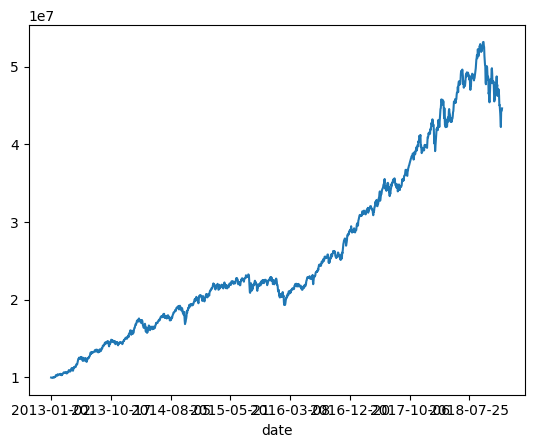

In [20]:
n_weight_df.invest.plot()